In [1]:
# 0828, 20pm
# Incoorporate training time padding to avoid problem in test time
# Train 12 epoch to see the results.
# If padding with mirror can help stable the performance, why do we use
# zero padding? That become same. If the 0 padding cannot work good. Then 
# go back to valid padding
#
# Try input dropout

In [65]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras.models import Sequential, Model
from keras.layers import (Dense, Conv2D, Input, MaxPool2D, 
                         UpSampling2D, Concatenate, Conv2DTranspose, 
                         Dropout, Cropping2D)
import tensorflow as tf
from keras.optimizers import Adam,SGD
from keras.initializers import he_normal
from keras.models import load_model
from scipy.misc import imresize
from PIL import Image
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from skimage.measure import label as label_shape
import os
from keras.preprocessing.image import (array_to_img, img_to_array, 
                                       load_img, ImageDataGenerator)
from keras.callbacks import (Callback, ModelCheckpoint, CSVLogger, 
                             ReduceLROnPlateau)
import keras.backend as K
import itchat
from wechat_utils import SendMessage
import random
from importlib import reload
import pickle

import pdb
import gc
import sys

In [3]:
import keras
keras.__version__

'2.0.6'

## Prepare the data

In [4]:
# Set the necessary directories
data_dir = '../data/train/'
mask_dir = '../data/train_masks/'
data2_dir = '../data2/'
all_images = os.listdir(data_dir)

In [5]:
!mkdir tmp

mkdir: cannot create directory ‘tmp’: File exists


In [6]:
tmp_dir = './tmp/u-net-same-padding-dropout/'

In [7]:
!mkdir ./tmp/u-net-same-padding-dropout/

mkdir: cannot create directory ‘./tmp/u-net-same-padding-dropout/’: File exists


In [8]:
# Train validation split
train_images, validation_images = train_test_split(
    all_images, train_size=0.8, test_size=0.2)

In [33]:
# original size 1280, 1918
image_size = [906, 640]
input_dims = [640, 640]
output_dims = [640, 640]
batch_size = 4

In [10]:
# Utility function to convert greyscale images to rgb
def grey2rgb(img):
    new_img = []
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            new_img.append(list(img[i][j]) * 3)
    new_img = np.array(new_img).reshape(img.shape[0], img.shape[1], 3)
    return new_img

In [11]:
def read_image_and_mask(data_dir, mask_dir, image):
    return (load_img(data_dir + image), 
            load_img(mask_dir + image.split('.')[0] + '_mask.gif'))

In [12]:
def show_image_and_mask(image, mask):
    plt.figure()
    plt.subplot(121)
    plt.imshow(image)
    plt.subplot(122)
    plt.imshow(mask)

(640, 640)
[[ 233.  233.  233.]
 [ 233.  233.  233.]
 [ 233.  233.  233.]
 ..., 
 [ 129.  126.  119.]
 [ 130.  127.  120.]
 [ 129.  126.  119.]]


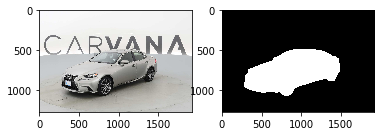

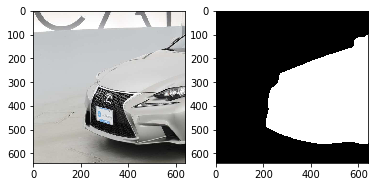

In [13]:
def random_crop(image_pair, dims):
    image, mask = image_pair
    w, h = image.size
    x_s = random.randint(0, w - dims[1])
    y_s = random.randint(0, h - dims[0])
    box = (x_s, y_s, x_s+dims[1], y_s+dims[0])
    image = image.crop(box)
    mask = mask.crop(box)
    return image, mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_, mask_ = random_crop((image_, mask_), input_dims)
show_image_and_mask(image_, mask_)
print (image_.size)
print (img_to_array(image_)[:, input_dims[1]-1])

In [14]:
%%time
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
image_ = image_.resize(image_size, resample=Image.BILINEAR)
mask_ = mask_.resize(image_size, resample=Image.BILINEAR)

CPU times: user 88 ms, sys: 4 ms, total: 92 ms
Wall time: 97.3 ms


In [15]:
%%time
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

CPU times: user 116 ms, sys: 12 ms, total: 128 ms
Wall time: 137 ms


(906, 640)
[[ 244.  244.  244.]
 [ 244.  244.  244.]
 [ 244.  244.  244.]
 ..., 
 [ 194.  195.  190.]
 [ 194.  195.  190.]
 [ 192.  193.  188.]]


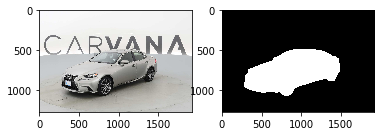

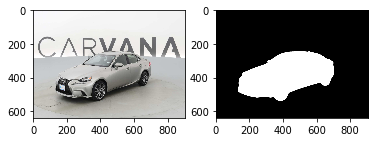

In [16]:
def resize_image(image_pair, dims):
    image, mask = image_pair
    image = image.resize(dims, resample=Image.BILINEAR)
    mask = mask.resize(dims, resample=Image.BILINEAR)
    return image, mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_, mask_ = resize_image((image_, mask_), image_size)
show_image_and_mask(image_, mask_)
print (image_.size)
print (img_to_array(image_)[:, input_dims[1]-1])

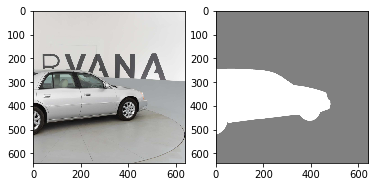

In [17]:
from data_utils import random_horizontal_flip
transform_resize = lambda image_pair: resize_image(image_pair, image_size)
transform_flip = lambda image_pair: random_horizontal_flip(image_pair, prob=0.5)
transform_crop = lambda image_pair: random_crop(image_pair, input_dims)
transforms = [transform_resize, transform_flip, transform_crop]

from data_utils import data_gen_small, threadsafe_iter
import data_utils
reload(data_utils)
del globals()['data_gen_small']
from data_utils import data_gen_small
            
# Example use
train_gen = data_gen_small(data_dir, mask_dir, train_images, batch_size, 
                          input_dims, transforms=transforms)
img, msk = next(train_gen)

plt.subplot(121)
plt.imshow(img[0])
plt.subplot(122)
plt.imshow(grey2rgb(msk[0]), alpha=0.5)

In [18]:
%%time
train_images_, train_masks_ = next(train_gen)

CPU times: user 376 ms, sys: 12 ms, total: 388 ms
Wall time: 437 ms


In [19]:
print (train_images_.shape)
print (train_masks_.shape)

(4, 640, 640, 3)
(4, 640, 640, 1)


In [20]:
val_gen = data_gen_small(data_dir, mask_dir, validation_images, 0, 
                         input_dims, transforms=transforms, in_order=True)

In [21]:
len(validation_images)

1018

In [22]:
val_images, val_masks = next(val_gen)

  0%|          | 1/1018 [00:00<01:50,  9.22it/s]

Build generator, this may take some time...
total number of images: 1018


100%|██████████| 1018/1018 [01:49<00:00,  9.44it/s]


In [23]:
print (val_images.shape)
print (val_masks.shape)

(1018, 640, 640, 3)
(1018, 640, 640, 1)


In [24]:
image_, mask_ = next(train_gen)
print (image_.shape)
print (mask_.shape)
print (mask_[0].shape)
print (mask_[0][150])
print (mask_[0].sum())

(4, 640, 640, 3)
(4, 640, 640, 1)
(640, 640, 1)
[[ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]
 [ 0.]


## Build the network

In [34]:
# First, let's define the two different types of layers that we will 
# be using
def down(input_layer, filters, pool=True, padding='same', verbose=1):
    conv1 = Conv2D(filters, (3, 3), padding=padding, 
                   kernel_initializer=he_normal(), activation='relu')(
                   input_layer)
    residual = Conv2D(filters, (3, 3), padding=padding, 
                      kernel_initializer=he_normal(), activation='relu')(
                      conv1)
    if pool:
        max_pool = MaxPool2D()(residual)
        if verbose:
            print ('Down output shape')
            print ('max_pool {}, residual {}'.format(K.int_shape(max_pool), K.int_shape(residual)))
        return max_pool,residual
    else:
        if verbose:
            print ('Down output shape')
            print ('residual {}'.format(K.int_shape(residual)))
        return residual
    
def up(input_layer, residual, filters, padding='same', cropping=0, verbose=1):
    filters=int(filters)
    upsample = UpSampling2D()(input_layer)
    upconv = Conv2D(filters, kernel_size=(2, 2), padding='same', 
                    kernel_initializer=he_normal(), activation='relu')(upsample)
    if cropping != 0:
        residual = Cropping2D(cropping=cropping)(residual)

    concat = Concatenate(axis=3)([residual, upconv])
    conv1 = Conv2D(filters, (3, 3), padding=padding,
                   kernel_initializer=he_normal(), activation='relu')(
                   concat)
    conv2 = Conv2D(filters, (3, 3), padding=padding, 
                   kernel_initializer=he_normal(), activation='relu')(
                   conv1)
    if verbose:
        print ('Up output dims')
        print (K.int_shape(conv2))
    return conv2


In [46]:
K.clear_session()
# Make a custom U-nets implementation
padding = 'same'
cropping = [0, 0, 0, 0]
filters = 64

input_layer = Input(shape=[None, None] + [3])
layers = [input_layer]
residuals = []

# Input_dropout
input_dropout = Dropout(0.2)(input_layer)

# Down 1, 128
d1, res1 = down(input_layer, filters, padding=padding)
residuals.append(res1)

# Down 2, 64
filters = filters * 2
d2, res2 = down(d1, filters, padding=padding)
residuals.append(res2)

# Down 3 32
filters = filters * 2
d3, res3 = down(d2, filters, padding=padding)
residuals.append(res3)

# Down 4, 16
filters = filters * 2
d4, res4 = down(d3, filters, padding=padding)
residuals.append(res4)

# Down 5, 8
filters = filters * 2
d4 = Dropout(0.5)(d4)
d5 = down(d4, filters, pool=False, padding=padding)
d5 = Dropout(0.5)(d5)

# Up 1
filters = filters / 2
up1 = up(d5, residual=residuals[-1], filters=filters, padding=padding, cropping=cropping[0])

# Up 2,3,4
up_ = up1
for layer_i in range(3):
    filters = filters / 2
    up_ = up(up_, residual=residuals[-(layer_i + 2)], filters=filters, 
             padding=padding, cropping=cropping[layer_i+1])
    
# Out, or up 5
out = Conv2D(filters=1, kernel_size=(1, 1), kernel_initializer=he_normal(), 
             activation='sigmoid', padding=padding)(up_)

model = Model(input_layer, out)
model.summary()

Down output shape
max_pool (None, None, None, 64), residual (None, None, None, 64)
Down output shape
max_pool (None, None, None, 128), residual (None, None, None, 128)
Down output shape
max_pool (None, None, None, 256), residual (None, None, None, 256)
Down output shape
max_pool (None, None, None, 512), residual (None, None, None, 512)
Down output shape
residual (None, None, None, 1024)
Up output dims
(None, None, None, 512)
Up output dims
(None, None, None, 256)
Up output dims
(None, None, None, 128)
Up output dims
(None, None, None, 64)
____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, None, None, 3) 0                                            
____________________________________________________________________________________________________
conv2d_1 (Conv2D)                (None, None, None,

In [36]:
# Parameters distribution
# For convnet, parameters number = size_w * size_h * pre_depth * 
# curr_depth
# increase intial depth by 2 will result 4x params 
# Down 
# 2k 37k
# 74k 148k
# 295k 590k
# 1180k 2400k
# 4720k 9438k
# Up
# 2098k 4719k 2360k
# 524k 1180k 590k
# 131k 295k 148k
# 33k 74k 37k
# 0k last 1x1 conv
# Total, 31032k

In [37]:
# Computation (multiply) 
# Down
# 3 * 64 * 9 * 570^2 = 561m
# 64 * 64 * 9 * 568^2 = 11893m
# 64 * 128 * 9 * 280^2 * 3 = 17340m
# 128 * 256 * 9 * 136^2 * 3 = 16264m
# 256 * 512 * 9 * 64^2 * 3 = 14496m
# 512 * 1024 * 9 * 28^2 * 3 = 11098m
# Down in all, 71652m
# Up
# 1024 * 512 * 4 * 56^2 = 6576m
# 1024 * 512 * 9 * 52^2 * 1.5 = 19139m
# 512 * 256 * 4 * 104^2 = 5671m
# 512 * 256 * 9 * 100^2 * 1.5 = 17695m
# 256 * 128 * 4 * 200^2 = 5243m
# 256 * 128 * 9 * 196^2 * 1.5 = 16994m
# 128 * 64 * 4 * 392^ 2 = 5035m
# 128 * 64 * 9 * 388^2 * 1.5 = 16648m
# Up in all, 93001m
# Omit last 1x1 conv and activation
# Total, 164653m ~ 0.16T
# Every layer, computation is almost the same, becasue the size decrease
# by a factor of 2, while filter increase by factor of 2
# Increase the filter size will significantly increase the computation
# Increase input size by 2, the number of multiplication will x4
# Increase intial depth by 2, the number of mutiplication will x4

In [25]:
# Now let's use Tensorflow to write our dice_coefficcient metric
def dice_coef(y_true, y_pred):
    smooth = 1e-5
    
    y_true = tf.round(tf.reshape((y_true), [-1]))
    y_pred = tf.round(tf.reshape((y_pred), [-1]))
    
    isct = tf.reduce_sum(y_true * y_pred)
    
    return 2 * isct / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred))

In [26]:
# Model checkpoint
checkpoint = ModelCheckpoint(filepath=tmp_dir + 'weights.hdf5',
                             verbose=1, save_best_only=True)
csv_logger = CSVLogger(tmp_dir + 'training.log')
reduce_lr = ReduceLROnPlateau(monitor='val_dice_coef')

In [47]:
#optimizer = SGD(lr=0.001, momentum=0.99)
optimizer = SGD(lr=0.001, momentum=0.99)
model.compile(optimizer=optimizer, loss='binary_crossentropy', 
             metrics=[dice_coef])

In [44]:
# For keras 2.0.5, the max_queue_size should be max_q_size
# no relu in 2x2 conv, no advanced initializer
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=2, 
                              callbacks=[checkpoint, csv_logger], 
                              validation_data=(val_images[0:2], val_masks[0:2]), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=2, 
                              initial_epoch=0)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:11: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., validation_data=(array([[[..., max_queue_size=6, callbacks=[<keras.ca..., validation_steps=inf, initial_epoch=0, steps_per_epoch=2, workers=1, epochs=2)`
  # This is added back by InteractiveShellApp.init_path()


Epoch 1/2
2/2 [==============================] - 10s - loss: 0.6881 - dice_coef: 0.3284 - val_loss: 0.6606 - val_dice_coef: 0.2440
Epoch 2/2
2/2 [==============================] - 2s - loss: 0.6567 - dice_coef: 0.1464 - val_loss: 0.6207 - val_dice_coef: 0.0924


In [ ]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, reduce_lr], 
                              validation_data=(val_images, val_masks), 
                              validation_steps=1019, 
                              max_q_size=6, 
                              workers=1, 
                              epochs=8, 
                              initial_epoch=0)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., validation_data=(array([[[..., max_queue_size=6, callbacks=[<keras.ca..., validation_steps=1019, initial_epoch=0, steps_per_epoch=1024.0, workers=1, epochs=8)`
  # Remove the CWD from sys.path while we load stuff.


Epoch 1/8
1024/1024 [==============================] - 2160s - loss: 0.3213 - dice_coef: 0.6764 - val_loss: 0.1349 - val_dice_coef: 0.9012
Epoch 2/8
1024/1024 [==============================] - 2143s - loss: 0.1160 - dice_coef: 0.9154 - val_loss: 0.0727 - val_dice_coef: 0.9486
Epoch 3/8
1024/1024 [==============================] - 2139s - loss: 0.0680 - dice_coef: 0.9523 - val_loss: 0.0486 - val_dice_coef: 0.9656
Epoch 4/8
1024/1024 [==============================] - 2137s - loss: 0.0464 - dice_coef: 0.9681 - val_loss: 0.0389 - val_dice_coef: 0.9723
Epoch 5/8
1024/1024 [==============================] - 2137s - loss: 0.0450 - dice_coef: 0.9694 - val_loss: 0.0353 - val_dice_coef: 0.9750
Epoch 6/8
1024/1024 [==============================] - 2139s - loss: 0.0330 - dice_coef: 0.9776 - val_loss: 0.0270 - val_dice_coef: 0.9817
Epoch 7/8
1024/1024 [==============================] - 2140s - loss: 0.0248 - dice_coef: 0.9830 - val_loss: 0.0234 - val_dice_coef: 0.9843
Epoch 8/8
1024/1024 [======

In [ ]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, reduce_lr], 
                              validation_data=(val_images, val_masks), 
                              validation_steps=1019, 
                              max_q_size=6, 
                              workers=1, 
                              epochs=30, 
                              initial_epoch=8)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., validation_data=(array([[[..., max_queue_size=6, callbacks=[<keras.ca..., validation_steps=1019, initial_epoch=8, steps_per_epoch=1024.0, workers=1, epochs=30)`
  # Remove the CWD from sys.path while we load stuff.


Epoch 9/30
1024/1024 [==============================] - 2136s - loss: 0.0195 - dice_coef: 0.9870 - val_loss: 0.0201 - val_dice_coef: 0.9863
Epoch 10/30
1024/1024 [==============================] - 2142s - loss: 0.0179 - dice_coef: 0.9881 - val_loss: 0.0164 - val_dice_coef: 0.9892
Epoch 11/30
1024/1024 [==============================] - 2142s - loss: 0.0168 - dice_coef: 0.9890 - val_loss: 0.0181 - val_dice_coef: 0.9882
Epoch 12/30
1024/1024 [==============================] - 2143s - loss: 0.0154 - dice_coef: 0.9897 - val_loss: 0.0144 - val_dice_coef: 0.9907
Epoch 13/30
1024/1024 [==============================] - 2142s - loss: 0.0181 - dice_coef: 0.9879 - val_loss: 0.0178 - val_dice_coef: 0.9882
Epoch 14/30
1024/1024 [==============================] - 2139s - loss: 0.0151 - dice_coef: 0.9899 - val_loss: 0.0132 - val_dice_coef: 0.9911
Epoch 15/30
1024/1024 [==============================] - 2140s - loss: 0.0145 - dice_coef: 0.9903 - val_loss: 0.0127 - val_dice_coef: 0.9916
Epoch 16/30
10

In [28]:
custom_objects = {'dice_coef': dice_coef}
model = load_model(tmp_dir + 'weights.hdf5', custom_objects=custom_objects)

In [29]:
tmp_dir

'./tmp/u-net-same-padding-dropout/'

In [ ]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, reduce_lr], 
                              validation_data=next(val_gen), 
                              validation_steps=float('inf'), 
                              max_q_size=6, 
                              workers=1, 
                              epochs=33, 
                              initial_epoch=30)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., validation_data=(array([[[..., workers=1, initial_epoch=30, steps_per_epoch=1024.0, callbacks=[<keras.ca..., validation_steps=inf, max_queue_size=6, epochs=33)`
  # Remove the CWD from sys.path while we load stuff.


Epoch 31/33
 670/1024 [==================>...........] - ETA: 2213s - loss: 0.0098 - dice_coef: 0.9936

KeyboardInterrupt: 

In [39]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, reduce_lr], 
                              validation_data=(val_images, val_masks), 
                              validation_steps=1019, 
                              max_q_size=6, 
                              workers=1, 
                              epochs=31, 
                              initial_epoch=30)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., validation_data=(array([[[..., workers=1, initial_epoch=30, steps_per_epoch=1024.0, callbacks=[<keras.ca..., validation_steps=1019, max_queue_size=6, epochs=31)`
  # Remove the CWD from sys.path while we load stuff.


Epoch 31/31
 753/1024 [=====================>........] - ETA: 1694s - loss: 0.0097 - dice_coef: 0.9937

KeyboardInterrupt: 

In [40]:
K.get_value(model.optimizer.lr)

0.0001

In [41]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, None, None, 3) 0                                            
____________________________________________________________________________________________________
conv2d_1 (Conv2D)                (None, None, None, 64 1792        input_1[0][0]                    
____________________________________________________________________________________________________
conv2d_2 (Conv2D)                (None, None, None, 64 36928       conv2d_1[0][0]                   
____________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)   (None, None, None, 64 0           conv2d_2[0][0]                   
___________________________________________________________________________________________

In [42]:
from keras.callbacks import TensorBoard
tensorboard = TensorBoard()

In [46]:
model.save('tmp-weights.hdf5')

In [27]:
custom_objects = {'dice_coef': dice_coef}
model = load_model('tmp-weights.hdf5', custom_objects=custom_objects)

In [ ]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, reduce_lr], 
                              validation_data=(val_images, val_masks), 
                              validation_steps=1019, 
                              max_q_size=6, 
                              workers=1, 
                              epochs=39, 
                              initial_epoch=30)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., callbacks=[<keras.ca..., validation_data=(array([[[..., epochs=39, max_queue_size=6, steps_per_epoch=1024.0, initial_epoch=30, workers=1, validation_steps=1019)`
  # Remove the CWD from sys.path while we load stuff.


Epoch 31/39
1024/1024 [==============================] - 6939s - loss: 0.0096 - dice_coef: 0.9938 - val_loss: 0.0098 - val_dice_coef: 0.9937
Epoch 32/39
1024/1024 [==============================] - 6928s - loss: 0.0095 - dice_coef: 0.9938 - val_loss: 0.0098 - val_dice_coef: 0.9937
Epoch 33/39
1024/1024 [==============================] - 6935s - loss: 0.0095 - dice_coef: 0.9939 - val_loss: 0.0099 - val_dice_coef: 0.9936
Epoch 34/39
1024/1024 [==============================] - 6911s - loss: 0.0093 - dice_coef: 0.9939 - val_loss: 0.0098 - val_dice_coef: 0.9937
Epoch 35/39
1024/1024 [==============================] - 6841s - loss: 0.0093 - dice_coef: 0.9939 - val_loss: 0.0097 - val_dice_coef: 0.9938
Epoch 36/39
1024/1024 [==============================] - 6830s - loss: 0.0092 - dice_coef: 0.9940 - val_loss: 0.0095 - val_dice_coef: 0.9939
Epoch 37/39
1024/1024 [==============================] - 6820s - loss: 0.0093 - dice_coef: 0.9940 - val_loss: 0.0095 - val_dice_coef: 0.9939
Epoch 38/39
1

In [ ]:
# For keras 2.0.5, the max_queue_size should be max_q_size
history = model.fit_generator(threadsafe_iter(train_gen), 
                              steps_per_epoch=4096 / batch_size, 
                              callbacks=[checkpoint, csv_logger, reduce_lr], 
                              validation_data=(val_images, val_masks), 
                              validation_steps=1019, 
                              max_q_size=6, 
                              workers=1, 
                              epochs=41, 
                              initial_epoch=39)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:10: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<data_util..., callbacks=[<keras.ca..., validation_data=(array([[[..., epochs=41, max_queue_size=6, steps_per_epoch=1024.0, initial_epoch=39, workers=1, validation_steps=1019)`
  # Remove the CWD from sys.path while we load stuff.


Epoch 40/41
1024/1024 [==============================] - 6828s - loss: 0.0090 - dice_coef: 0.9941 - val_loss: 0.0095 - val_dice_coef: 0.9939
Epoch 41/41
1004/1024 [============================>.] - ETA: 123s - loss: 0.0091 - dice_coef: 0.9941

In [36]:
custom_objects = {'dice_coef': dice_coef}
model = load_model(tmp_dir + 'weights.hdf5', custom_objects=custom_objects)

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 6.68 µs


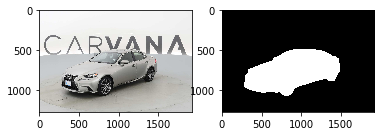

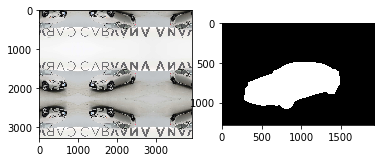

In [30]:
def pad_image(image, pad_width, mode='symmetric'):
    array = img_to_array(image)
    padding = ((pad_width, pad_width), (pad_width, pad_width), (0, 0))
    padded_array = np.pad(array, padding, mode=mode)
    padded_image = array_to_img(padded_array)
    return padded_image
%time
image_, mask_ = read_image_and_mask(data_dir, mask_dir, train_images[0])
show_image_and_mask(image_, mask_)
image_ = pad_image(image_, 1000)
show_image_and_mask(image_, mask_)

In [36]:
array_ = img_to_array(image_)
array_.shape

(640, 906, 3)

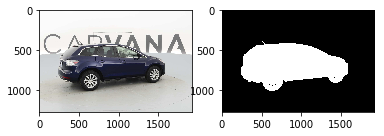

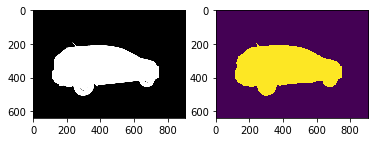

In [44]:
def predict_on_patch(model, image, pad_width, mode, image_size, input_size, output_size, verbose=0):
    """
    Predict the mask patch by patch since the valid padding is used in train
    
    # Args:
    image:      PIL Image
    mode:       Method to pading the image. The same as np.pad
    image_size: The size to perform prediction, (w, h). e.g (906, 640)
    input_size: The size of image to feed into the network
    output_size:The output mask size, which is smaller than input because the edge of the 
                input is discard gradually
    
    """
    image = imresize(image, image_size[::-1])
    image = pad_image(image, pad_width, mode)
    array = img_to_array(image) / 255
    mask = np.zeros(image_size[::-1])
    h, w = array.shape[0:2]
    mask_h, mask_w = mask.shape
    
    patch_width = output_size[0]
    patch_high = output_size[1]
    assert patch_width == patch_high, 'Output_size must be square'
    
    input_patch_width = input_size[0]
    input_patch_high = input_size[1]
    assert input_patch_width == input_patch_high, 'Input_size must be square'
    
    if verbose:
        plt.figure()
        plt.imshow(image)
        plt.show()
    
    # Function for judge the position of the patch
    def _is_last_col():
        return patch_width * i + input_patch_width > w
    def _is_last_row():
        return patch_high * j + input_patch_high > h
    
    # Predict patch by patch
    for i in range(int(np.ceil((w - input_patch_width) / patch_width)) + 1):
        for j in range(int(np.ceil((h - input_patch_high) / patch_high)) + 1):
            
            xs = i * patch_width
            xe = xs + input_patch_width
            ys = j * patch_high
            ye = ys + input_patch_high
            
            if (_is_last_row()):
                ys = h - input_patch_high - 1
                ye = h - 1
            if (_is_last_col()):
                xs = w - input_patch_width - 1
                xe = w - 1
                
            if verbose:
                print ('Now processing ({}, {}), ({}, {}).'.
                       format(xs, ys, xe, ye))
            
            # Predict the patch
            patch = array[ys:ye, xs:xe]
            patch = patch[None,:,:,:]
            output_patch = model.predict(patch, batch_size=1)
            
            if verbose:
                show_image_and_mask(patch[0], output_patch[0,:,:,0])
            
            # Fill the mask
            xs = i * patch_width
            xe = (i + 1) * patch_width
            ys = j * patch_high
            ye = (j + 1) * patch_high
            if (_is_last_row()):
                ys = mask_h - patch_high - 1
                ye = mask_h - 1
            if (_is_last_col()):
                xs = mask_w - patch_width - 1
                xe = mask_w - 1
            mask[ys:ye, xs:xe] = output_patch[0,:,:,0]
            
    return mask

image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[0])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

mask_pred_ = predict_on_patch(model, image_, 0, 'symmetric', image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_image_and_mask(mask_, mask_pred_)

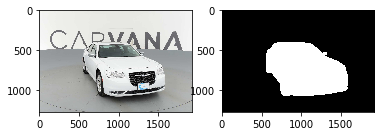

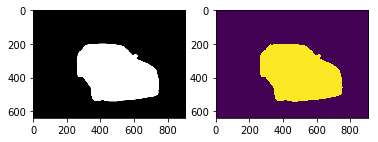

In [45]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[1])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Symmetric padding, (mirror)
mask_pred_ = predict_on_patch(model, image_, 0, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_image_and_mask(mask_, mask_pred_)

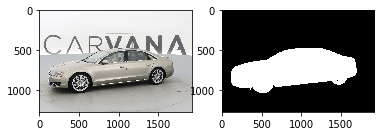

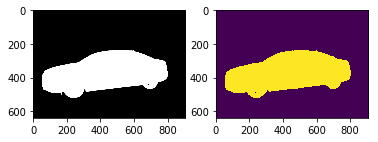

In [46]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[2])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

mask_pred_ = predict_on_patch(model, image_, 0, 'symmetric',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_image_and_mask(mask_, mask_pred_)

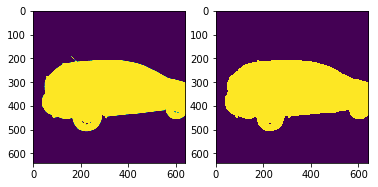

In [47]:
mask_pred_ = model.predict(val_images[0][None,:,:,:])
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_image_and_mask(val_masks[0][:,:,0], mask_pred_[0,:,:,0])

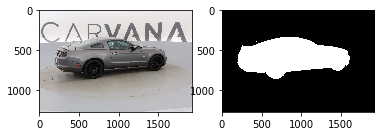

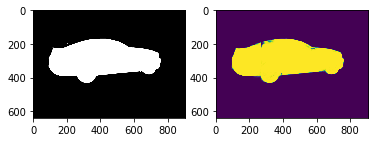

In [48]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[3])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

# Edge padding
mask_pred_ = predict_on_patch(model, image_, 0, 'edge',image_size, input_dims, output_dims)
show_image_and_mask(mask_, mask_pred_)

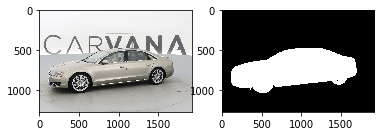

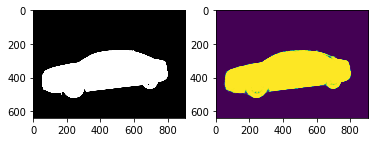

In [59]:
def mirror_average_prediction(model, image, pad_width, image_size, input_size, output_size):
    mode = 'edge'
    threshold = None
    image = pad_image(image, pad_width)
    image2 = image.transpose(Image.FLIP_LEFT_RIGHT)
    mask = predict_on_patch(model, image, pad_width, mode, image_size, input_size, output_size)
    mask2 = predict_on_patch(model, image2, pad_width, mode, image_size, input_size, output_size)
    mask = mask + np.fliplr(mask2)
    mask /= 2.
    if threshold:
        mask[mask>=threshold] = 1
        mask[mask<threshold] = 0
    return mask
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[2])
show_image_and_mask(image_, mask_)
mask_ = imresize(mask_, image_size[::-1])
mask_pred_ = mirror_average_prediction(model, image_, 0, image_size, input_dims, output_dims)
show_image_and_mask(mask_, mask_pred_)

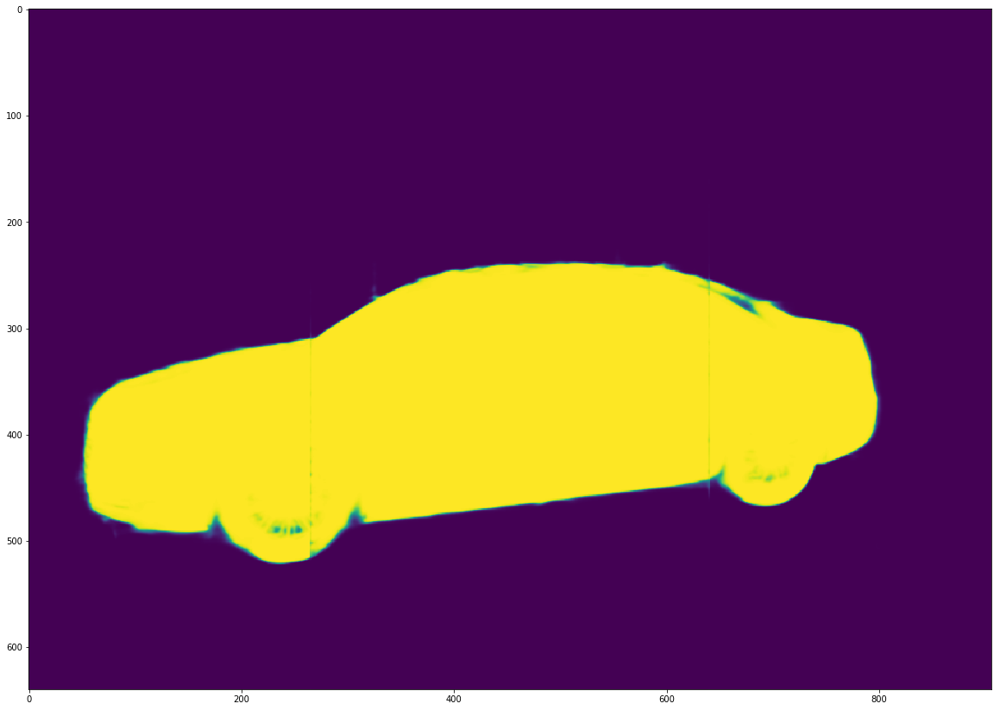

In [60]:
plt.figure(figsize=(20, 16))
plt.imshow(mask_pred_)
plt.show()

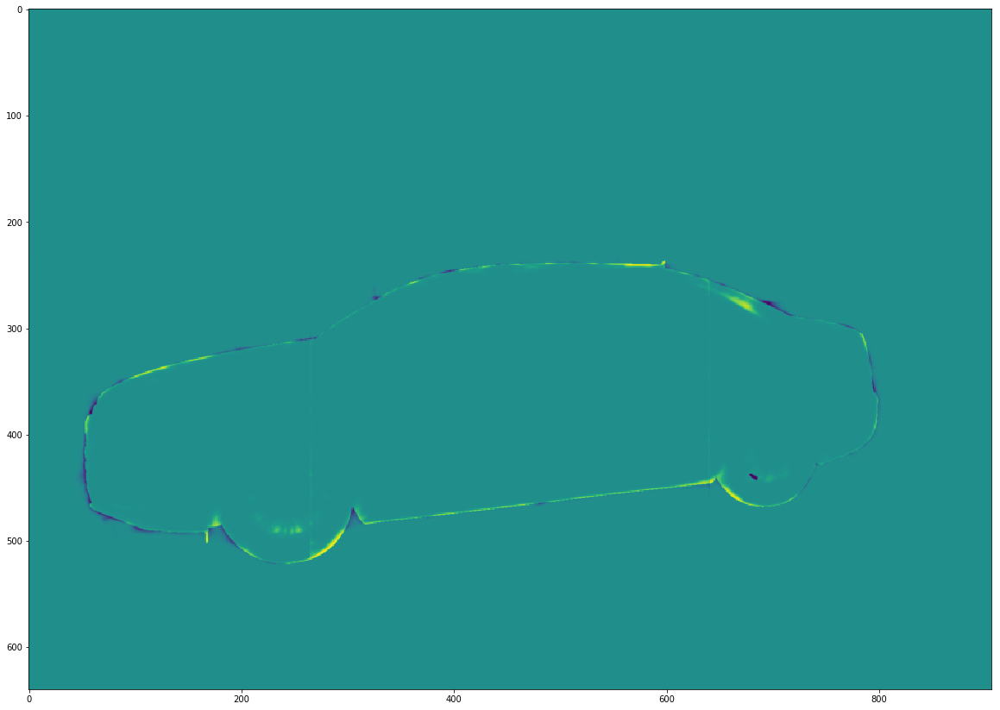

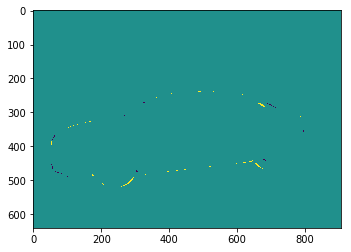

In [61]:
plt.figure(figsize=(20, 16))
plt.imshow(mask_[:,:,0] /255. - mask_pred_)
plt.show()
# Yellow: indicate fasle negtive
# Purper: indicate fasle positve
plt.figure()
plt.imshow(np.round(mask_[:,:,0] /255. - mask_pred_))
plt.show()

In [53]:
mask_[400,400]

array([255, 255, 255], dtype=uint8)

In [54]:
(mask_ / 255.)[400,400,1]

1.0

In [55]:
mask_pred_[400,400]

1.0

In [56]:
def cal_dice_coef(mask1, mask2):
    """
    calculate dice coefficient
    
    mask1:    Groundtruth lable, size + channel
    mask2:    Predicted lable, 
    """
    if mask1.max() > 1:
        mask1 = (mask1 / 255.)[:,:,0]
    mask1 = mask1.astype(int)
    threshold = 0.5
    if threshold:
        mask2[mask2>=threshold] = 1
        mask2[mask2<threshold] = 0
        mask2 = mask2.astype(int)
    intersection = mask1 * mask2
    return 2. * intersection.sum() / (mask1 + mask2).sum()
cal_dice_coef(mask_, mask_pred_)

0.99334112233268579

In [62]:
def show_3_images(i1, i2, i3):
    plt.figure()
    plt.subplot(131)
    plt.imshow(i1)
    plt.subplot(132)
    plt.imshow(i2)
    plt.subplot(133)
    plt.imshow(i3)
    plt.show()
def show_4_images(i1, i2, i3, i4):
    plt.figure()
    plt.subplot(141)
    plt.imshow(i1)
    plt.subplot(142)
    plt.imshow(i2)
    plt.subplot(143)
    plt.imshow(i3)
    plt.subplot(144)
    plt.imshow(i4)
    plt.show()

0it [00:00, ?it/s]

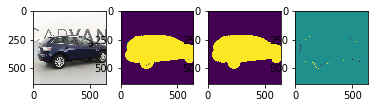

1it [00:01,  1.11s/it]

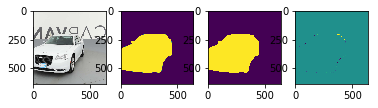

2it [00:02,  1.06s/it]

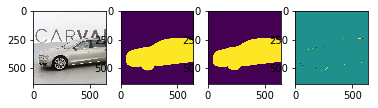

3it [00:02,  1.00s/it]

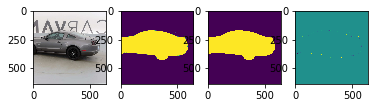

4it [00:03,  1.04it/s]

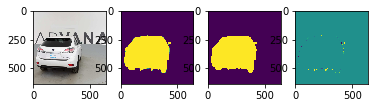

5it [00:04,  1.04it/s]

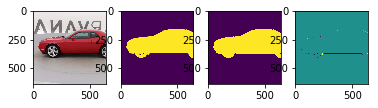

6it [00:05,  1.05it/s]

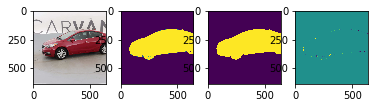

7it [00:06,  1.08it/s]

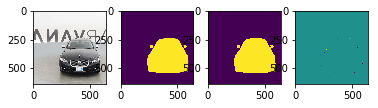

8it [00:07,  1.09it/s]

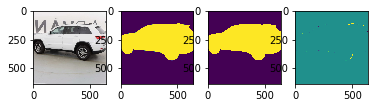

9it [00:08,  1.04it/s]

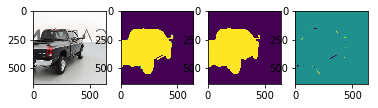

10it [00:09,  1.08it/s]

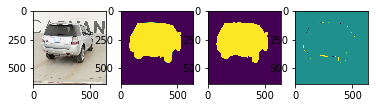

11it [00:10,  1.07it/s]

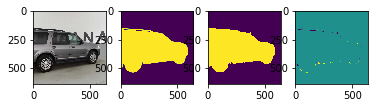

12it [00:11,  1.06it/s]

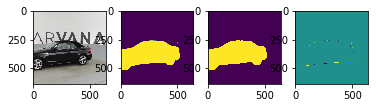

13it [00:12,  1.05it/s]

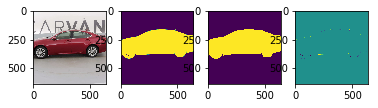

14it [00:13,  1.02it/s]

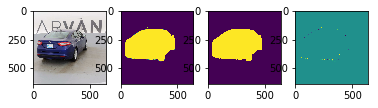

15it [00:14,  1.06it/s]

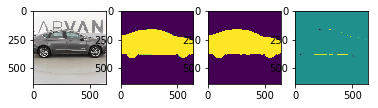

16it [00:15,  1.06it/s]

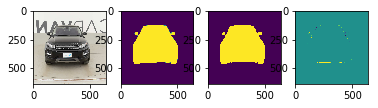

17it [00:15,  1.09it/s]

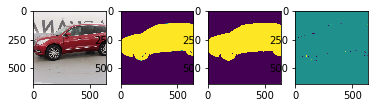

18it [00:16,  1.05it/s]

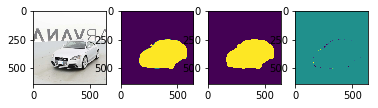

19it [00:17,  1.08it/s]

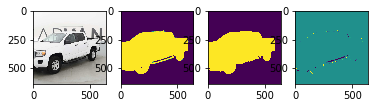

20it [00:18,  1.10it/s]

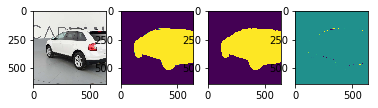

21it [00:19,  1.11it/s]

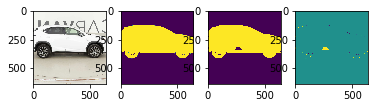

22it [00:20,  1.07it/s]

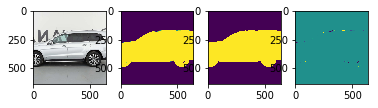

23it [00:21,  1.09it/s]

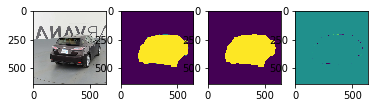

24it [00:22,  1.09it/s]

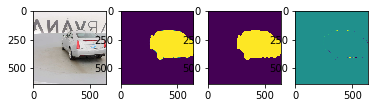

25it [00:23,  1.08it/s]

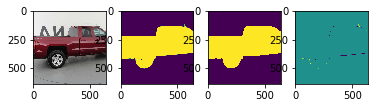

26it [00:24,  1.06it/s]

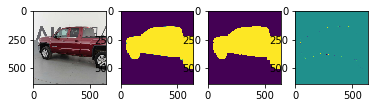

27it [00:25,  1.06it/s]

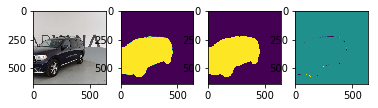

28it [00:26,  1.08it/s]

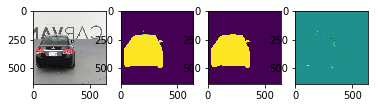

29it [00:27,  1.08it/s]

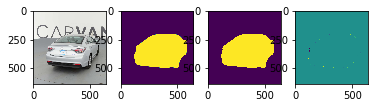

30it [00:28,  1.04it/s]

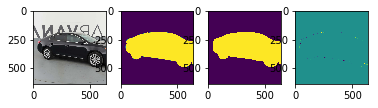

31it [00:29,  1.04it/s]

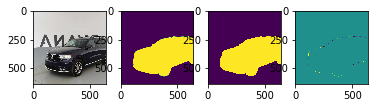

32it [00:30,  1.04it/s]

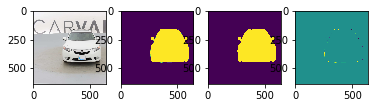

33it [00:30,  1.07it/s]

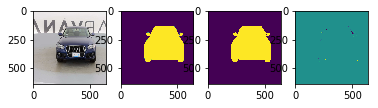

34it [00:31,  1.03it/s]

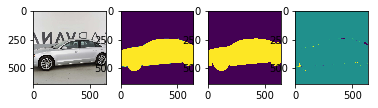

35it [00:32,  1.04it/s]

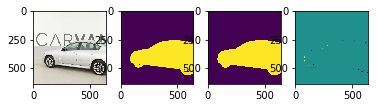

36it [00:33,  1.06it/s]

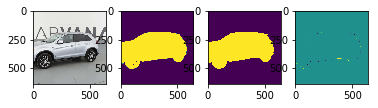

37it [00:34,  1.06it/s]

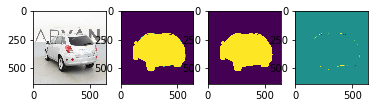

38it [00:35,  1.02it/s]

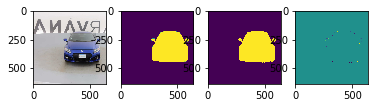

39it [00:36,  1.04it/s]

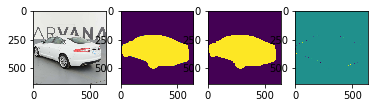

40it [00:37,  1.06it/s]

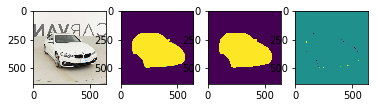

41it [00:38,  1.08it/s]

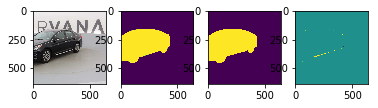

42it [00:39,  1.05it/s]

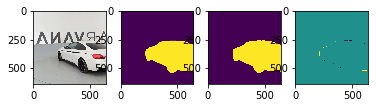

43it [00:40,  1.05it/s]

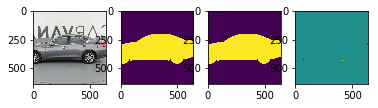

44it [00:41,  1.08it/s]

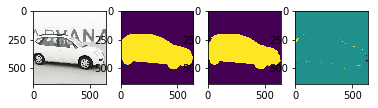

45it [00:42,  1.08it/s]

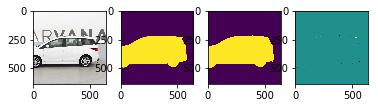

46it [00:43,  1.03it/s]

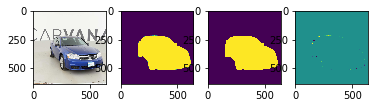

47it [00:44,  1.04it/s]

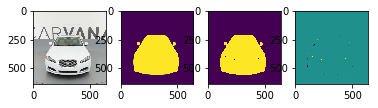

48it [00:45,  1.05it/s]

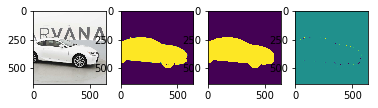

49it [00:46,  1.06it/s]

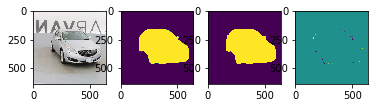

50it [00:47,  1.02it/s]

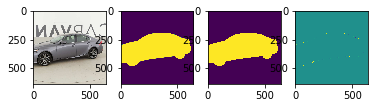

51it [00:48,  1.02it/s]

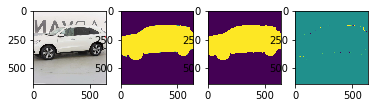

52it [00:49,  1.05it/s]

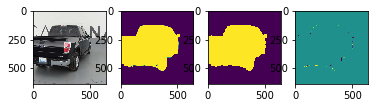

53it [00:50,  1.07it/s]

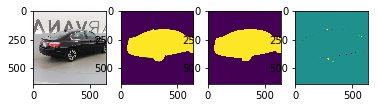

54it [00:51,  1.03it/s]

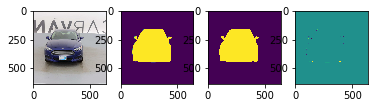

55it [00:52,  1.03it/s]

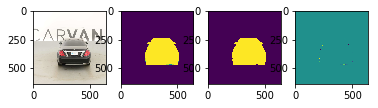

56it [00:52,  1.04it/s]

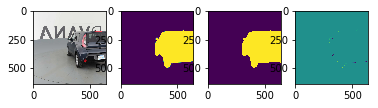

57it [00:53,  1.05it/s]

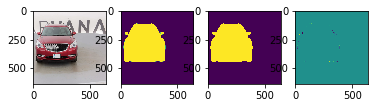

58it [00:54,  1.01it/s]

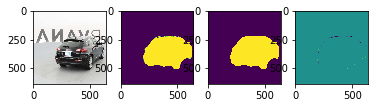

59it [00:55,  1.04it/s]

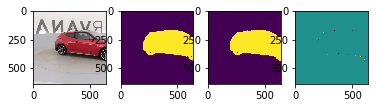

60it [00:56,  1.07it/s]

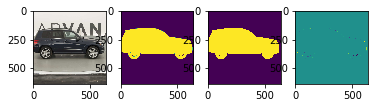

61it [00:57,  1.08it/s]

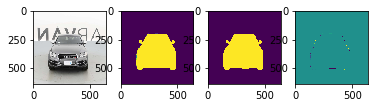

62it [00:58,  1.03it/s]

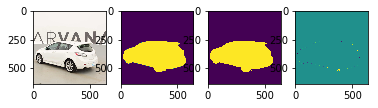

63it [00:59,  1.05it/s]

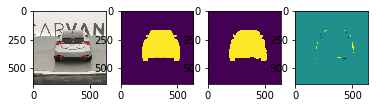

64it [01:00,  1.07it/s]

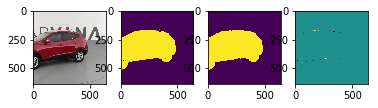

65it [01:01,  1.09it/s]

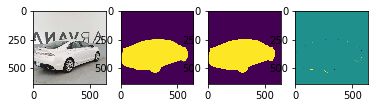

66it [01:02,  1.06it/s]

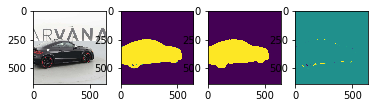

67it [01:03,  1.05it/s]

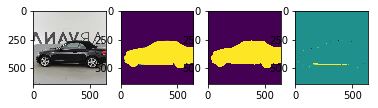

68it [01:04,  1.07it/s]

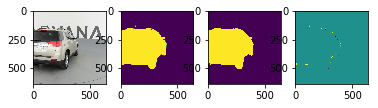

69it [01:05,  1.09it/s]

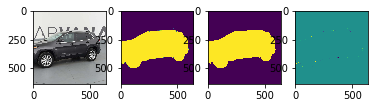

70it [01:06,  1.06it/s]

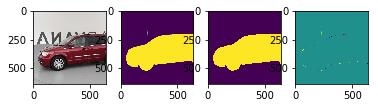

71it [01:07,  1.08it/s]

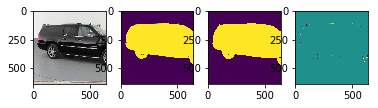

72it [01:07,  1.10it/s]

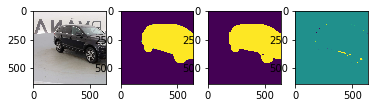

73it [01:08,  1.11it/s]

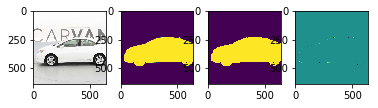

74it [01:09,  1.07it/s]

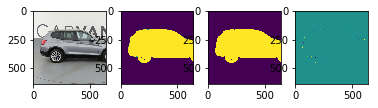

75it [01:10,  1.10it/s]

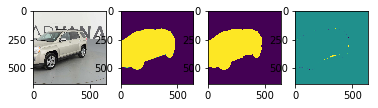

76it [01:11,  1.10it/s]

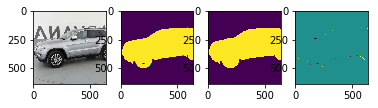

77it [01:12,  1.11it/s]

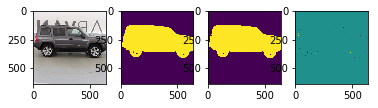

78it [01:13,  1.08it/s]

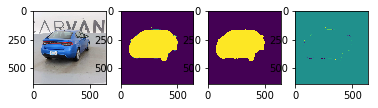

79it [01:14,  1.09it/s]

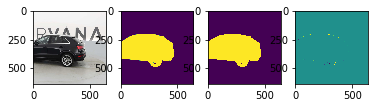

80it [01:15,  1.09it/s]

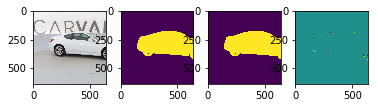

81it [01:16,  1.07it/s]

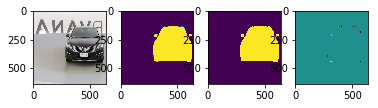

82it [01:17,  1.06it/s]

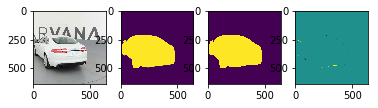

83it [01:18,  1.05it/s]

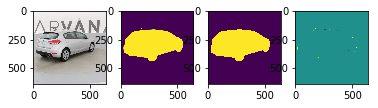

84it [01:19,  1.07it/s]

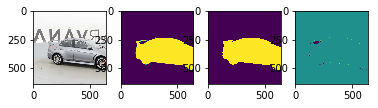

85it [01:19,  1.07it/s]

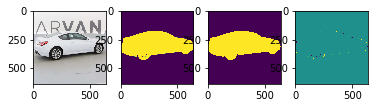

86it [01:20,  1.05it/s]

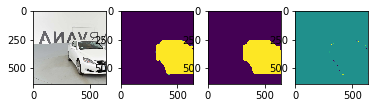

87it [01:21,  1.06it/s]

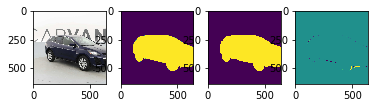

88it [01:22,  1.08it/s]

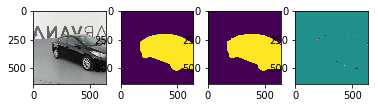

89it [01:23,  1.09it/s]

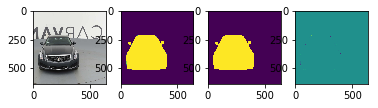

90it [01:24,  1.04it/s]

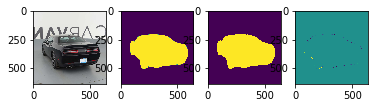

91it [01:25,  1.07it/s]

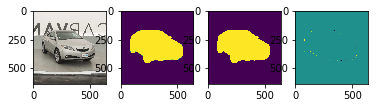

92it [01:26,  1.07it/s]

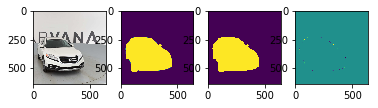

93it [01:27,  1.09it/s]

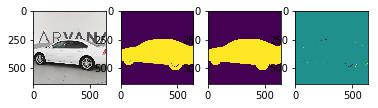

94it [01:28,  1.04it/s]

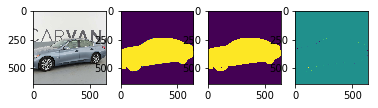

95it [01:29,  1.04it/s]

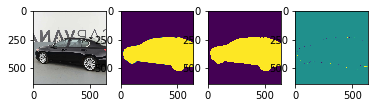

96it [01:30,  1.04it/s]

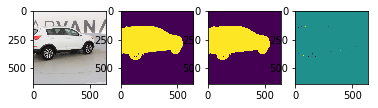

97it [01:31,  1.04it/s]

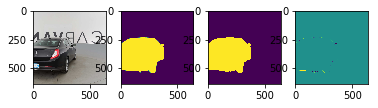

98it [01:32,  1.01it/s]

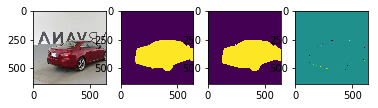

99it [01:33,  1.05it/s]

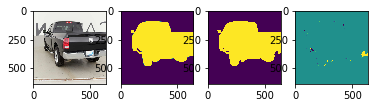

100it [01:34,  1.07it/s]

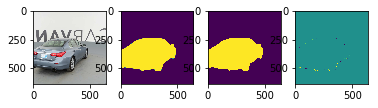

101it [01:35,  1.06it/s]

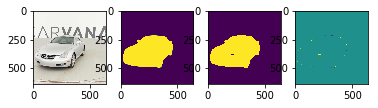

102it [01:36,  1.05it/s]

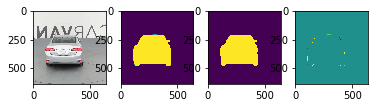

103it [01:37,  1.07it/s]

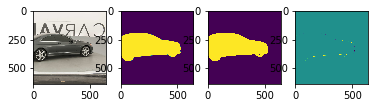

104it [01:38,  1.06it/s]

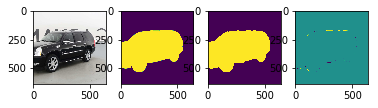

105it [01:38,  1.05it/s]

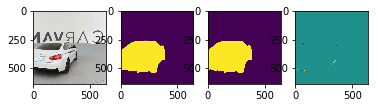

106it [01:40,  1.02it/s]

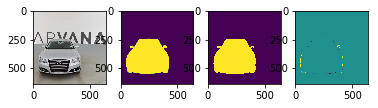

107it [01:40,  1.05it/s]

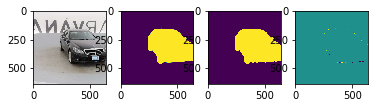

108it [01:41,  1.08it/s]

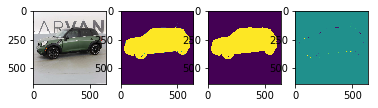

109it [01:42,  1.10it/s]

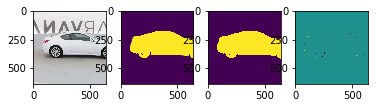

110it [01:43,  1.08it/s]

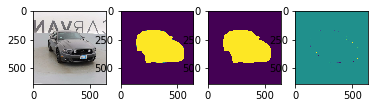

111it [01:44,  1.08it/s]

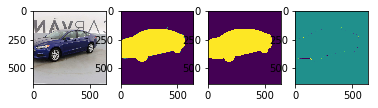

112it [01:45,  1.10it/s]

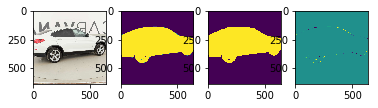

113it [01:46,  1.11it/s]

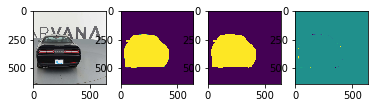

114it [01:47,  1.07it/s]

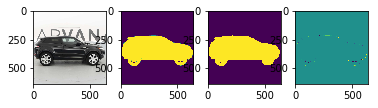

115it [01:48,  1.07it/s]

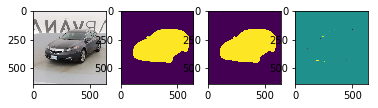

116it [01:49,  1.07it/s]

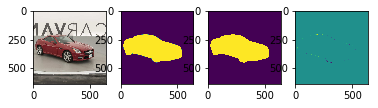

117it [01:50,  1.06it/s]

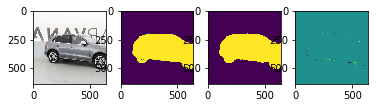

118it [01:51,  1.04it/s]

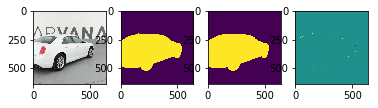

119it [01:52,  1.05it/s]

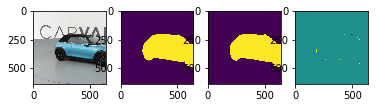

120it [01:53,  1.05it/s]

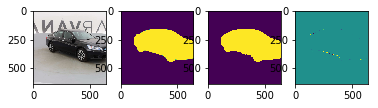

121it [01:53,  1.05it/s]

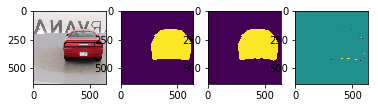

122it [01:54,  1.04it/s]

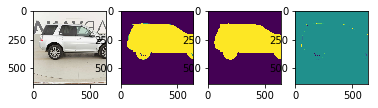

123it [01:55,  1.07it/s]

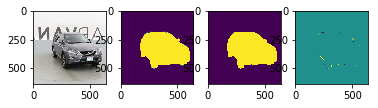

124it [01:56,  1.06it/s]

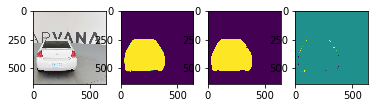

125it [01:57,  1.09it/s]

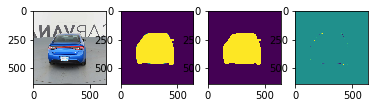

126it [01:58,  1.03it/s]

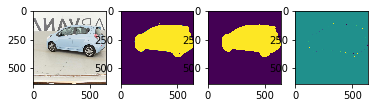

127it [01:59,  1.06it/s]

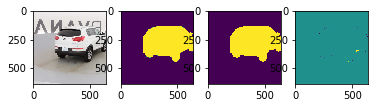

128it [02:00,  1.07it/s]

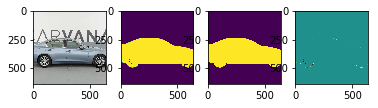

129it [02:01,  1.08it/s]

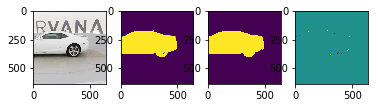

130it [02:02,  1.05it/s]

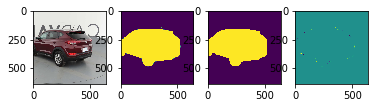

131it [02:03,  1.07it/s]

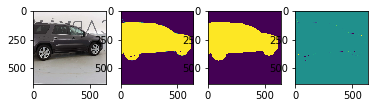

132it [02:04,  1.09it/s]

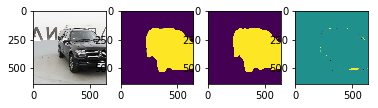

133it [02:05,  1.10it/s]

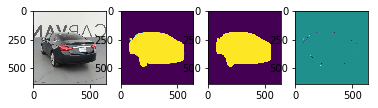

134it [02:06,  1.07it/s]

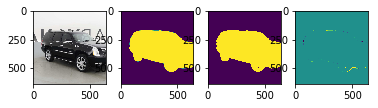

135it [02:07,  1.06it/s]

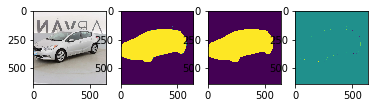

136it [02:07,  1.08it/s]

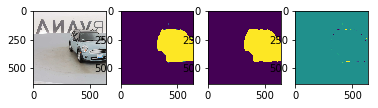

137it [02:08,  1.10it/s]

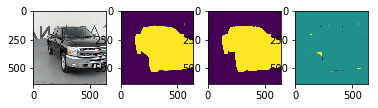

138it [02:09,  1.07it/s]

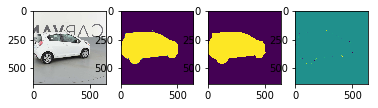

139it [02:10,  1.06it/s]

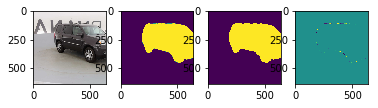

140it [02:11,  1.08it/s]

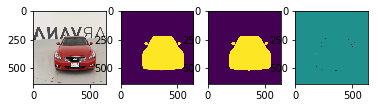

141it [02:12,  1.10it/s]

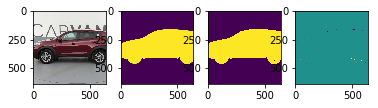

142it [02:13,  1.07it/s]

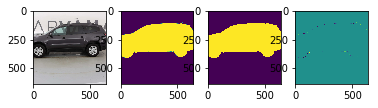

143it [02:14,  1.09it/s]

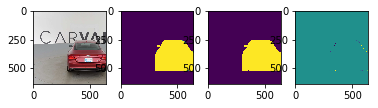

144it [02:15,  1.07it/s]

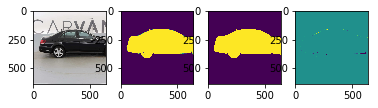

145it [02:16,  1.06it/s]

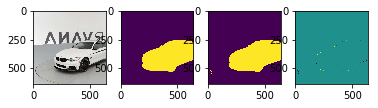

146it [02:17,  1.04it/s]

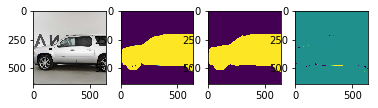

147it [02:18,  1.04it/s]

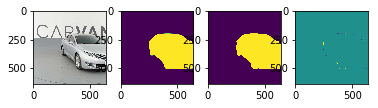

148it [02:19,  1.05it/s]

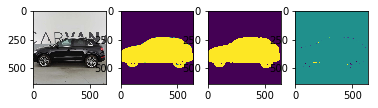

149it [02:20,  1.06it/s]

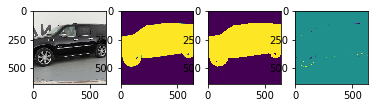

150it [02:21,  1.01it/s]

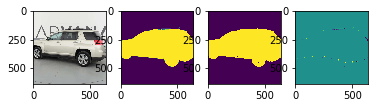

151it [02:22,  1.02it/s]

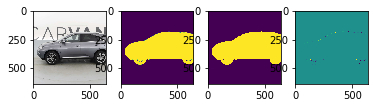

152it [02:23,  1.03it/s]

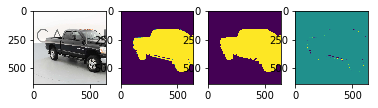

153it [02:24,  1.05it/s]

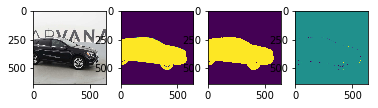

154it [02:25,  1.03it/s]

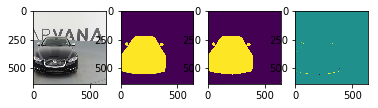

155it [02:25,  1.05it/s]

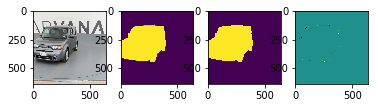

156it [02:26,  1.06it/s]

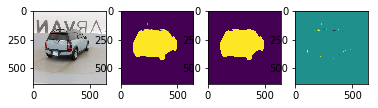

157it [02:27,  1.06it/s]

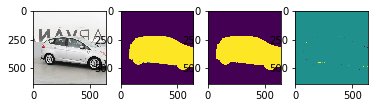

158it [02:28,  1.01it/s]

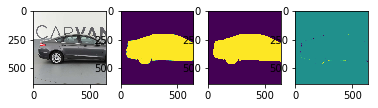

159it [02:29,  1.04it/s]

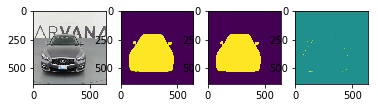

160it [02:30,  1.07it/s]

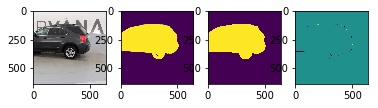

161it [02:31,  1.10it/s]

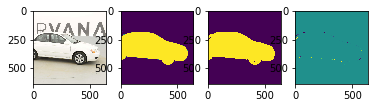

162it [02:32,  1.05it/s]

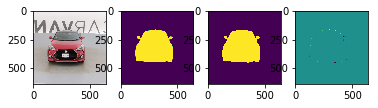

163it [02:33,  1.08it/s]

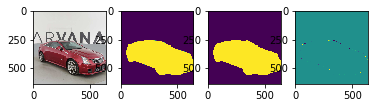

164it [02:34,  1.09it/s]

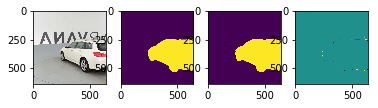

165it [02:35,  1.10it/s]

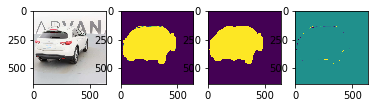

166it [02:36,  1.07it/s]

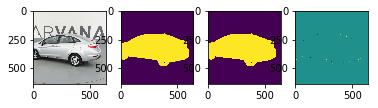

167it [02:37,  1.09it/s]

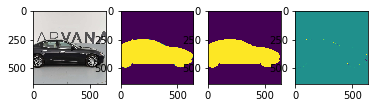

168it [02:38,  1.09it/s]

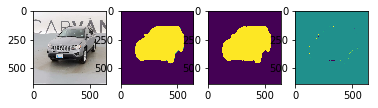

169it [02:39,  1.08it/s]

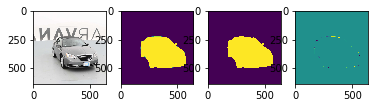

170it [02:40,  1.03it/s]

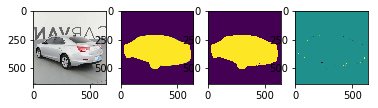

171it [02:41,  1.04it/s]

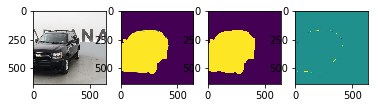

172it [02:41,  1.04it/s]

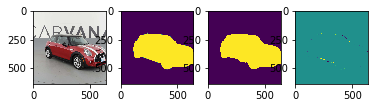

173it [02:42,  1.04it/s]

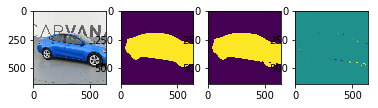

174it [02:43,  1.03it/s]

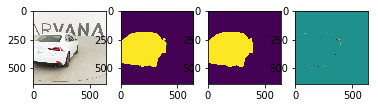

175it [02:44,  1.06it/s]

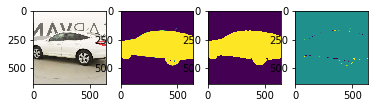

176it [02:45,  1.09it/s]

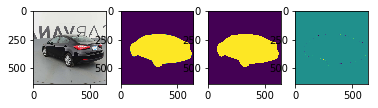

177it [02:46,  1.11it/s]

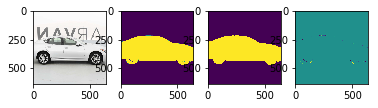

178it [02:47,  1.07it/s]

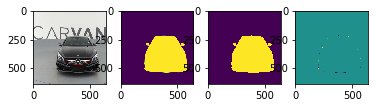

179it [02:48,  1.09it/s]

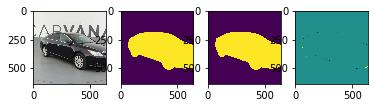

180it [02:49,  1.10it/s]

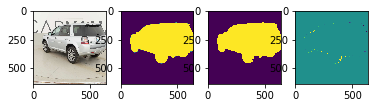

181it [02:50,  1.09it/s]

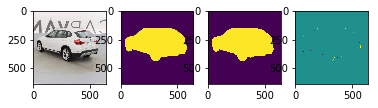

182it [02:51,  1.07it/s]

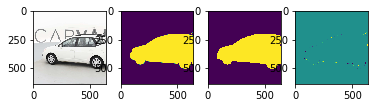

183it [02:52,  1.07it/s]

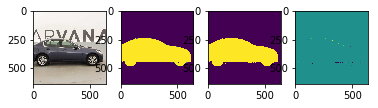

184it [02:53,  1.09it/s]

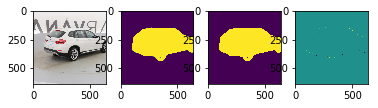

185it [02:53,  1.10it/s]

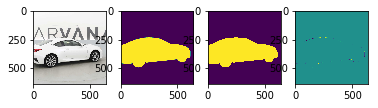

186it [02:54,  1.05it/s]

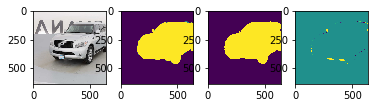

187it [02:55,  1.05it/s]

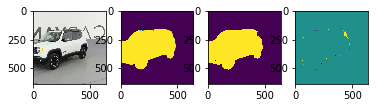

188it [02:56,  1.06it/s]

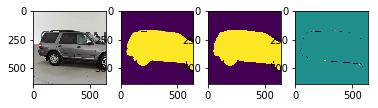

189it [02:57,  1.06it/s]

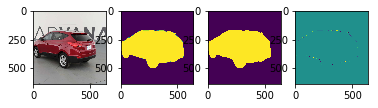

190it [02:58,  1.03it/s]

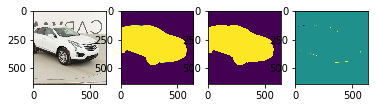

191it [02:59,  1.04it/s]

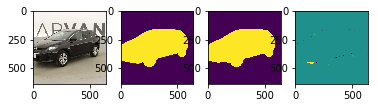

192it [03:00,  1.05it/s]

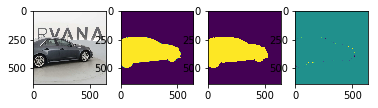

193it [03:01,  1.06it/s]

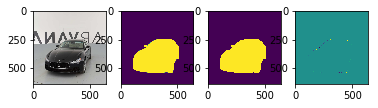

194it [03:02,  1.05it/s]

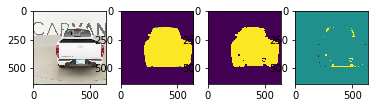

195it [03:03,  1.05it/s]

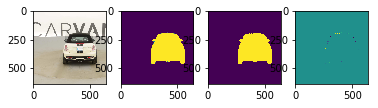

196it [03:04,  1.06it/s]

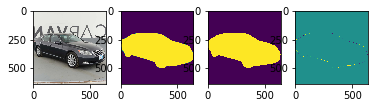

197it [03:05,  1.07it/s]

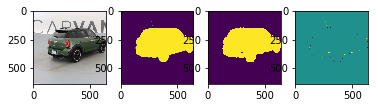

198it [03:06,  1.03it/s]

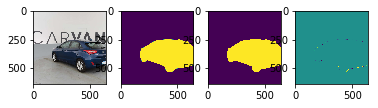

199it [03:07,  1.04it/s]

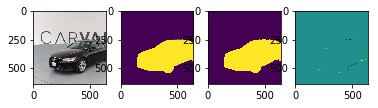

200it [03:08,  1.07it/s]

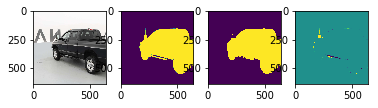

201it [03:09,  1.09it/s]

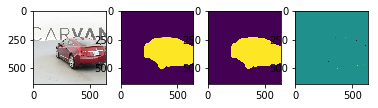

202it [03:10,  1.05it/s]

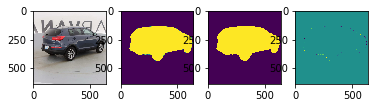

203it [03:11,  1.07it/s]

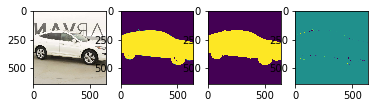

204it [03:12,  1.06it/s]

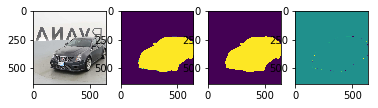

205it [03:12,  1.09it/s]

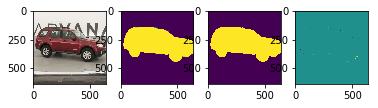

206it [03:13,  1.05it/s]

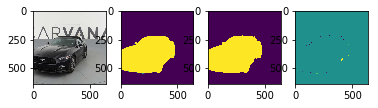

207it [03:14,  1.08it/s]

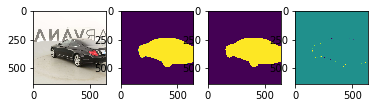

208it [03:15,  1.08it/s]

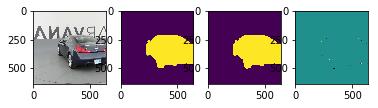

209it [03:16,  1.09it/s]

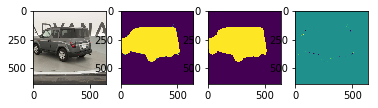

210it [03:17,  1.05it/s]

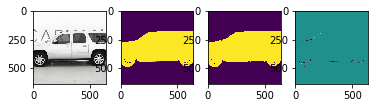

211it [03:18,  1.06it/s]

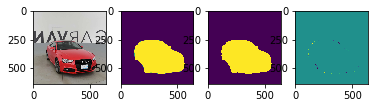

212it [03:19,  1.06it/s]

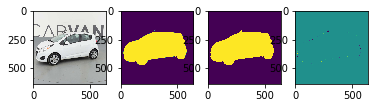

213it [03:20,  1.07it/s]

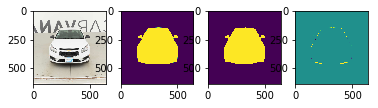

214it [03:21,  1.05it/s]

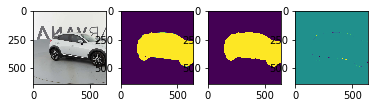

215it [03:22,  1.06it/s]

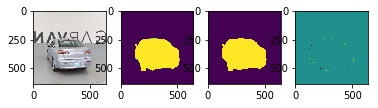

216it [03:23,  1.06it/s]

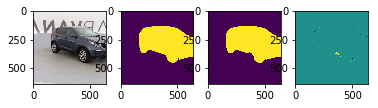

217it [03:24,  1.06it/s]

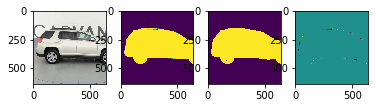

218it [03:25,  1.01it/s]

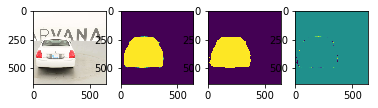

219it [03:26,  1.05it/s]

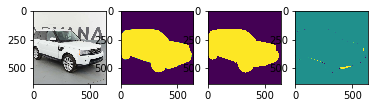

220it [03:27,  1.06it/s]

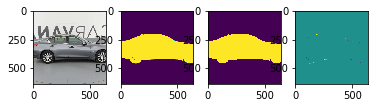

221it [03:27,  1.08it/s]

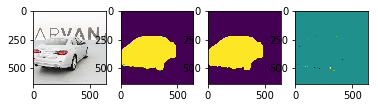

222it [03:29,  1.03it/s]

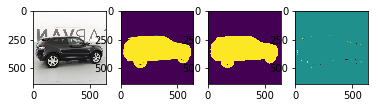

223it [03:29,  1.05it/s]

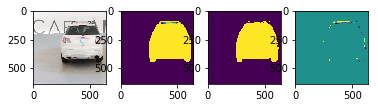

224it [03:30,  1.07it/s]

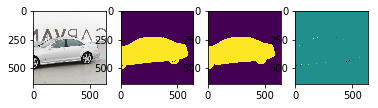

225it [03:31,  1.08it/s]

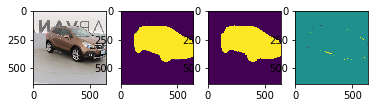

226it [03:32,  1.05it/s]

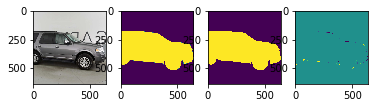

227it [03:33,  1.06it/s]

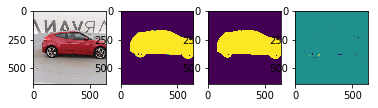

228it [03:34,  1.05it/s]

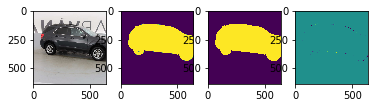

229it [03:35,  1.06it/s]

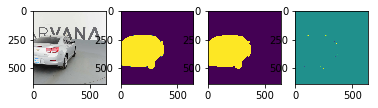

230it [03:36,  1.02it/s]

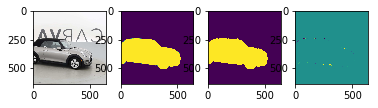

231it [03:37,  1.04it/s]

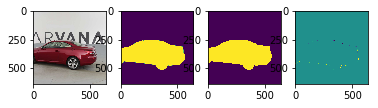

232it [03:38,  1.06it/s]

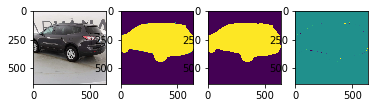

233it [03:39,  1.08it/s]

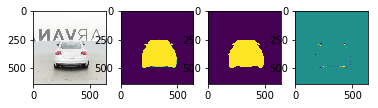

234it [03:40,  1.05it/s]

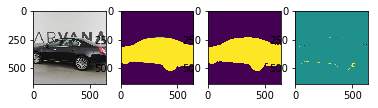

235it [03:41,  1.07it/s]

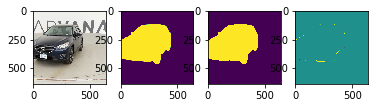

236it [03:42,  1.07it/s]

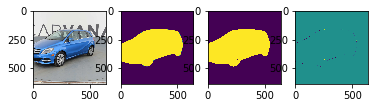

237it [03:43,  1.08it/s]

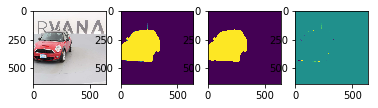

238it [03:44,  1.05it/s]

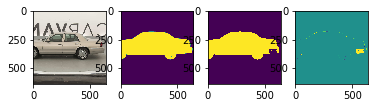

239it [03:44,  1.08it/s]

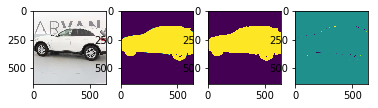

240it [03:45,  1.07it/s]

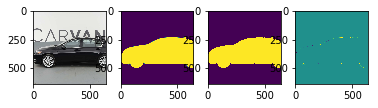

241it [03:46,  1.09it/s]

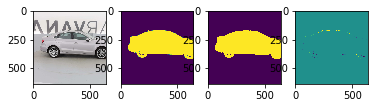

242it [03:47,  1.04it/s]

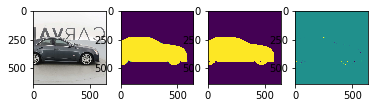

243it [03:48,  1.03it/s]

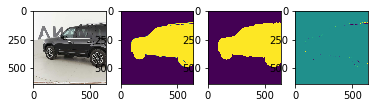

244it [03:49,  1.05it/s]

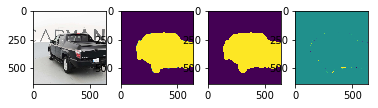

245it [03:50,  1.08it/s]

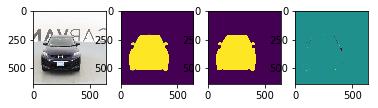

246it [03:51,  1.06it/s]

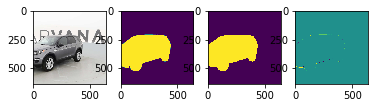

247it [03:52,  1.07it/s]

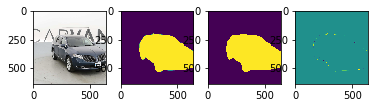

248it [03:53,  1.10it/s]

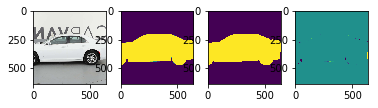

249it [03:54,  1.10it/s]

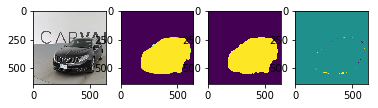

250it [03:55,  1.06it/s]

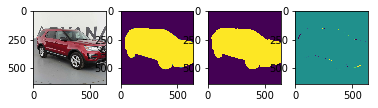

251it [03:56,  1.08it/s]

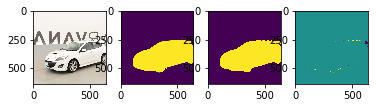

252it [03:57,  1.09it/s]

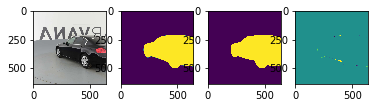

253it [03:57,  1.10it/s]

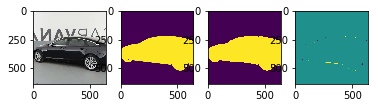

254it [03:58,  1.07it/s]

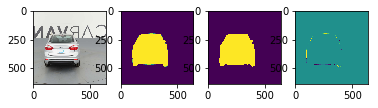

255it [03:59,  1.09it/s]

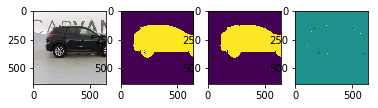

256it [04:00,  1.10it/s]

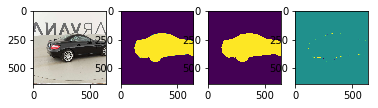

257it [04:01,  1.10it/s]

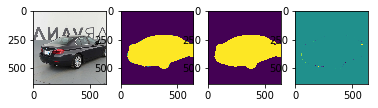

258it [04:02,  1.06it/s]

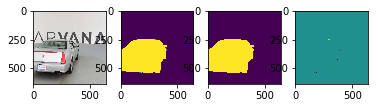

259it [04:03,  1.06it/s]

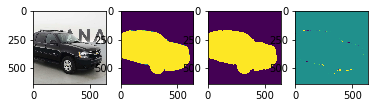

260it [04:04,  1.05it/s]

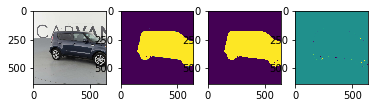

261it [04:05,  1.05it/s]

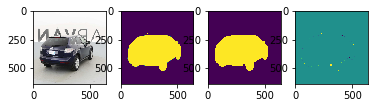

262it [04:06,  1.02it/s]

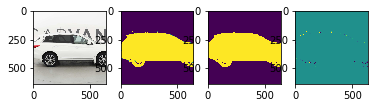

263it [04:07,  1.06it/s]

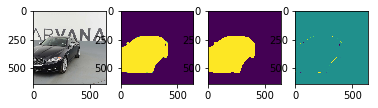

264it [04:08,  1.08it/s]

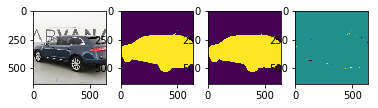

265it [04:09,  1.08it/s]

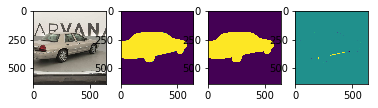

266it [04:10,  1.07it/s]

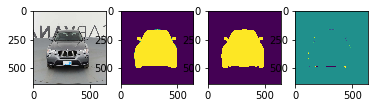

267it [04:11,  1.09it/s]

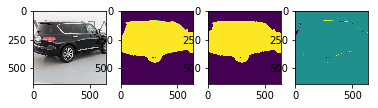

268it [04:12,  1.07it/s]

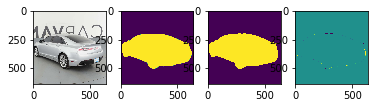

269it [04:13,  1.07it/s]

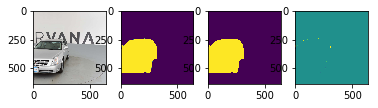

270it [04:14,  1.05it/s]

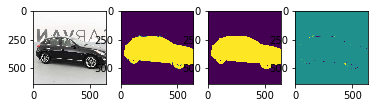

271it [04:14,  1.06it/s]

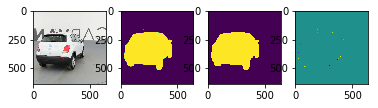

272it [04:15,  1.07it/s]

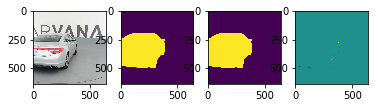

273it [04:16,  1.09it/s]

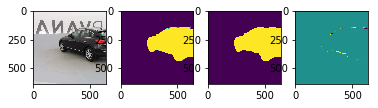

274it [04:17,  1.06it/s]

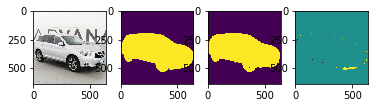

275it [04:18,  1.07it/s]

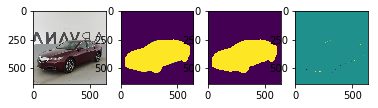

276it [04:19,  1.10it/s]

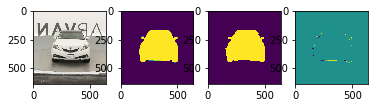

277it [04:20,  1.12it/s]

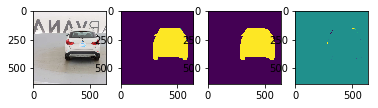

278it [04:21,  1.08it/s]

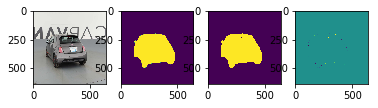

279it [04:22,  1.07it/s]

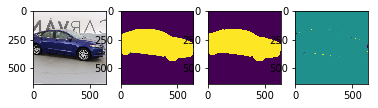

280it [04:23,  1.06it/s]

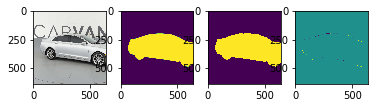

281it [04:24,  1.05it/s]

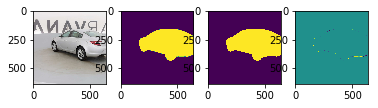

282it [04:25,  1.02it/s]

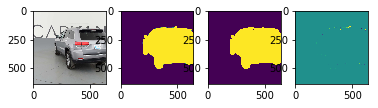

283it [04:26,  1.06it/s]

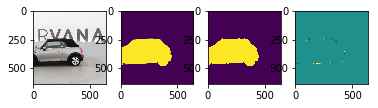

284it [04:27,  1.05it/s]

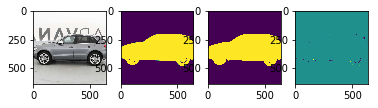

285it [04:28,  1.05it/s]

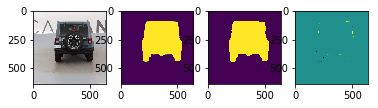

286it [04:29,  1.01it/s]

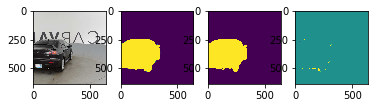

287it [04:30,  1.02it/s]

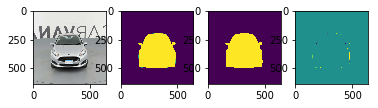

288it [04:30,  1.05it/s]

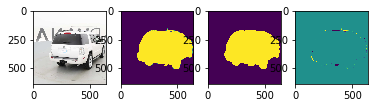

289it [04:31,  1.07it/s]

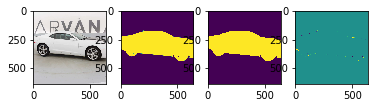

290it [04:32,  1.04it/s]

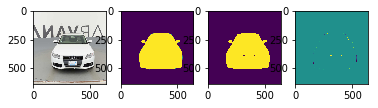

291it [04:33,  1.07it/s]

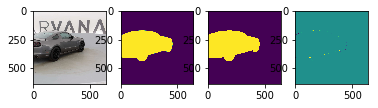

292it [04:34,  1.08it/s]

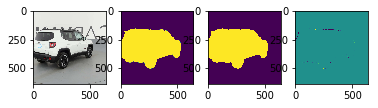

293it [04:35,  1.10it/s]

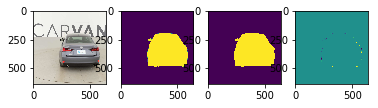

294it [04:36,  1.06it/s]

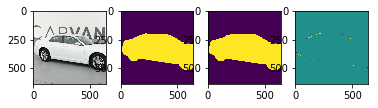

295it [04:37,  1.09it/s]

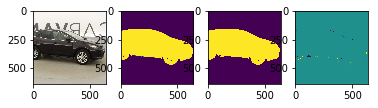

296it [04:38,  1.08it/s]

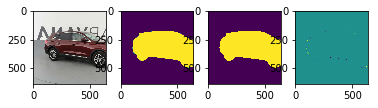

297it [04:39,  1.10it/s]

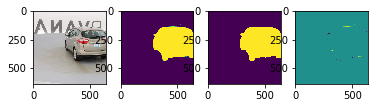

298it [04:40,  1.05it/s]

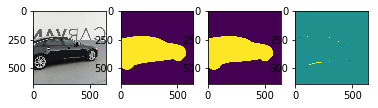

299it [04:41,  1.07it/s]

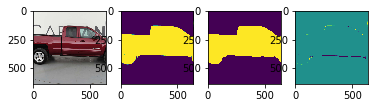

300it [04:42,  1.08it/s]

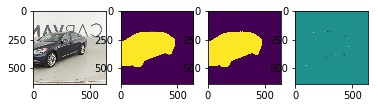

301it [04:42,  1.10it/s]

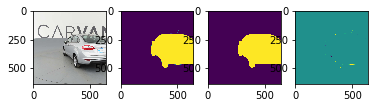

302it [04:44,  1.04it/s]

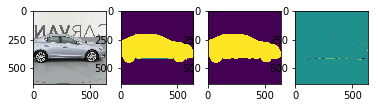

303it [04:44,  1.07it/s]

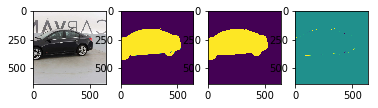

304it [04:45,  1.09it/s]

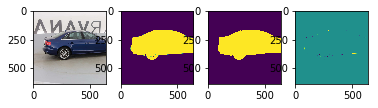

305it [04:46,  1.12it/s]

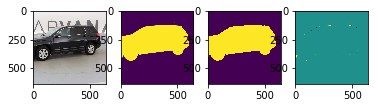

306it [04:47,  1.08it/s]

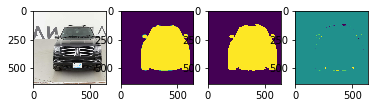

307it [04:48,  1.09it/s]

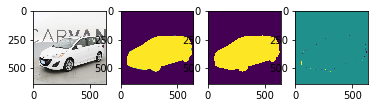

308it [04:49,  1.11it/s]

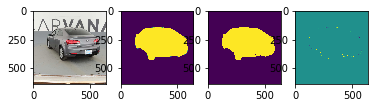

309it [04:50,  1.11it/s]

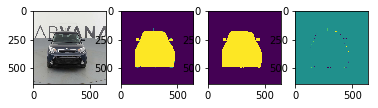

310it [04:51,  1.08it/s]

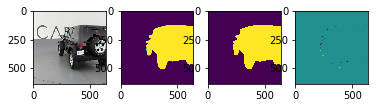

311it [04:52,  1.07it/s]

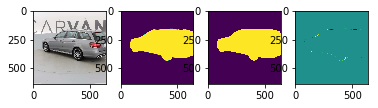

312it [04:53,  1.05it/s]

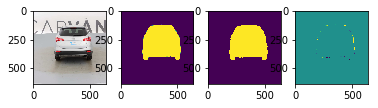

313it [04:54,  1.07it/s]

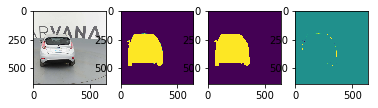

314it [04:55,  1.03it/s]

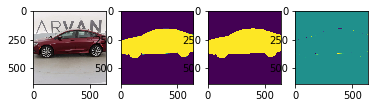

315it [04:56,  1.05it/s]

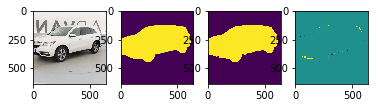

316it [04:57,  1.07it/s]

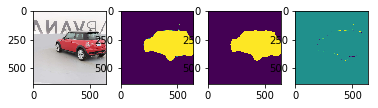

317it [04:57,  1.09it/s]

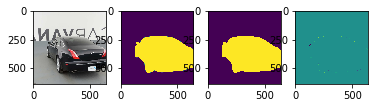

318it [04:58,  1.04it/s]

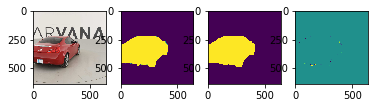

319it [04:59,  1.04it/s]

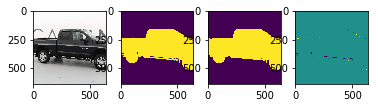

320it [05:00,  1.04it/s]

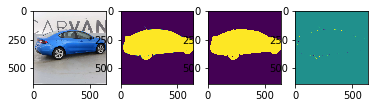

321it [05:01,  1.05it/s]

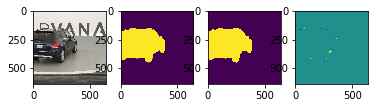

322it [05:02,  1.03it/s]

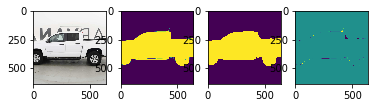

323it [05:03,  1.06it/s]

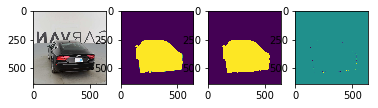

324it [05:04,  1.09it/s]

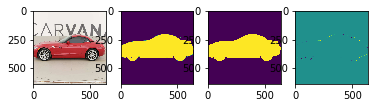

325it [05:05,  1.11it/s]

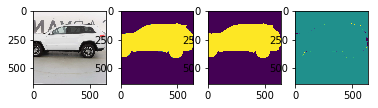

326it [05:06,  1.08it/s]

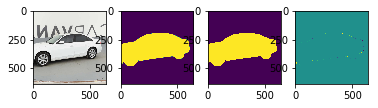

327it [05:07,  1.10it/s]

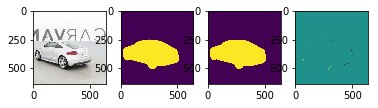

328it [05:08,  1.11it/s]

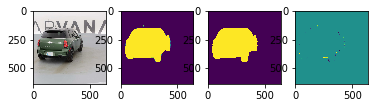

329it [05:09,  1.11it/s]

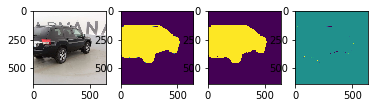

330it [05:10,  1.05it/s]

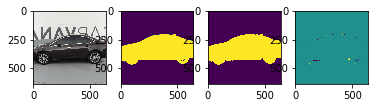

331it [05:11,  1.04it/s]

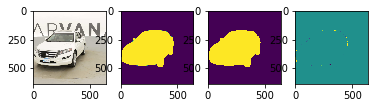

332it [05:12,  1.05it/s]

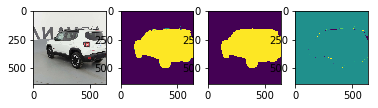

333it [05:12,  1.07it/s]

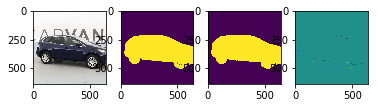

334it [05:13,  1.05it/s]

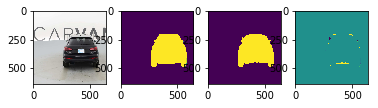

335it [05:14,  1.05it/s]

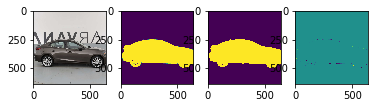

336it [05:15,  1.05it/s]

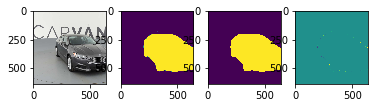

337it [05:16,  1.05it/s]

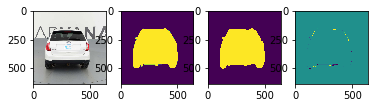

338it [05:17,  1.01it/s]

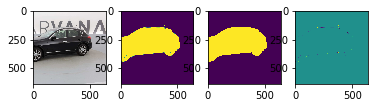

339it [05:18,  1.03it/s]

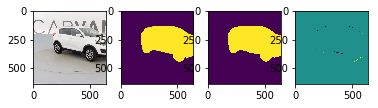

340it [05:19,  1.07it/s]

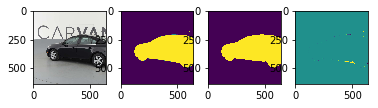

341it [05:20,  1.07it/s]

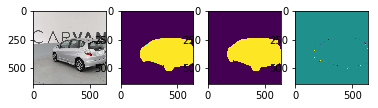

342it [05:21,  1.04it/s]

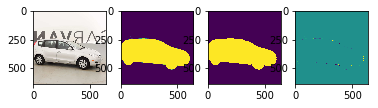

343it [05:22,  1.07it/s]

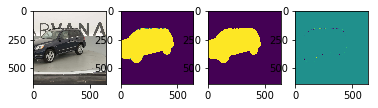

344it [05:23,  1.09it/s]

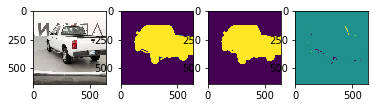

345it [05:24,  1.09it/s]

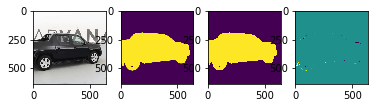

346it [05:25,  1.06it/s]

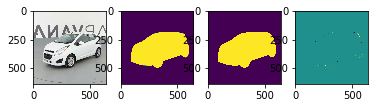

347it [05:26,  1.08it/s]

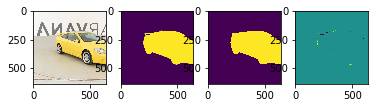

348it [05:27,  1.10it/s]

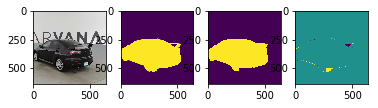

349it [05:27,  1.12it/s]

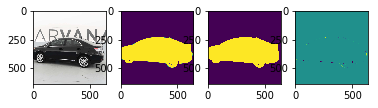

350it [05:28,  1.05it/s]

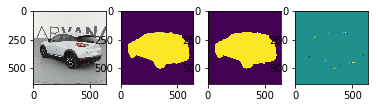

351it [05:29,  1.08it/s]

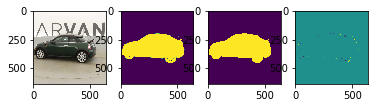

352it [05:30,  1.09it/s]

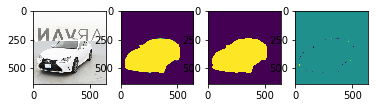

353it [05:31,  1.09it/s]

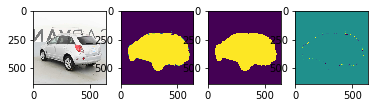

354it [05:32,  1.04it/s]

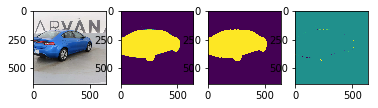

355it [05:33,  1.05it/s]

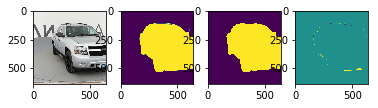

356it [05:34,  1.06it/s]

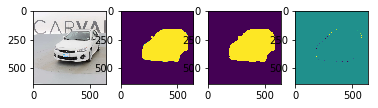

357it [05:35,  1.08it/s]

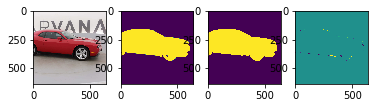

358it [05:36,  1.05it/s]

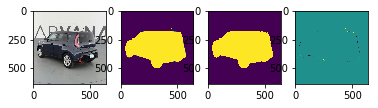

359it [05:37,  1.07it/s]

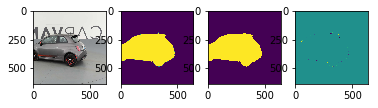

360it [05:38,  1.08it/s]

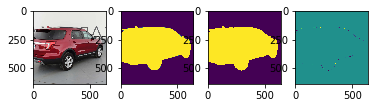

361it [05:39,  1.07it/s]

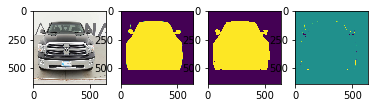

362it [05:40,  1.05it/s]

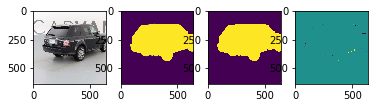

363it [05:41,  1.06it/s]

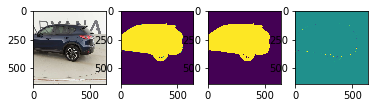

364it [05:42,  1.06it/s]

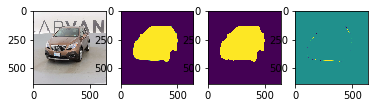

365it [05:42,  1.08it/s]

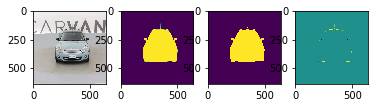

366it [05:43,  1.05it/s]

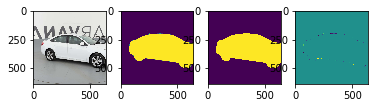

367it [05:44,  1.07it/s]

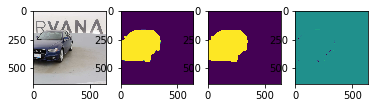

368it [05:45,  1.09it/s]

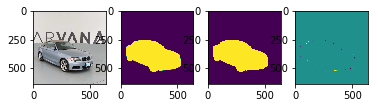

369it [05:46,  1.08it/s]

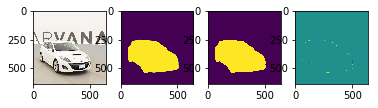

370it [05:47,  1.05it/s]

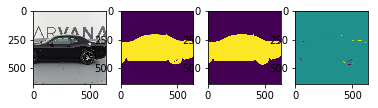

371it [05:48,  1.08it/s]

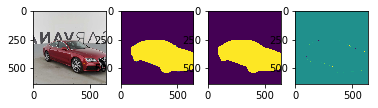

372it [05:49,  1.10it/s]

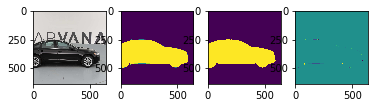

373it [05:50,  1.11it/s]

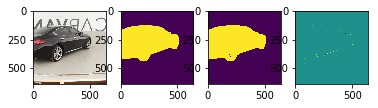

374it [05:51,  1.08it/s]

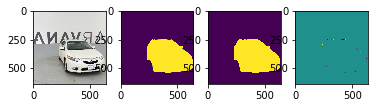

375it [05:52,  1.07it/s]

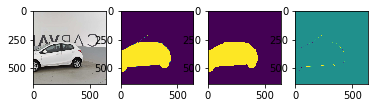

376it [05:53,  1.09it/s]

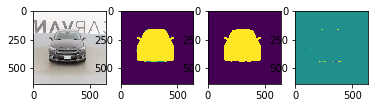

377it [05:54,  1.10it/s]

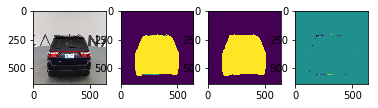

378it [05:55,  1.04it/s]

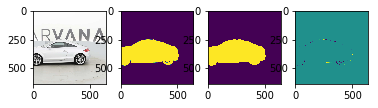

379it [05:56,  1.04it/s]

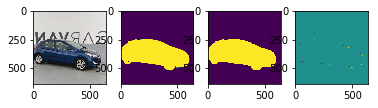

380it [05:56,  1.08it/s]

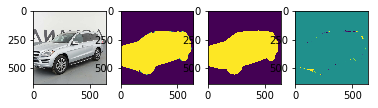

381it [05:57,  1.09it/s]

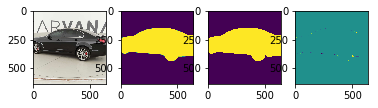

382it [05:58,  1.07it/s]

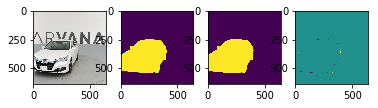

383it [05:59,  1.07it/s]

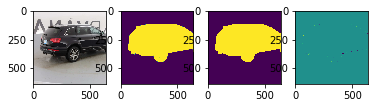

384it [06:00,  1.09it/s]

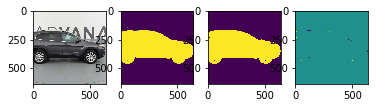

385it [06:01,  1.10it/s]

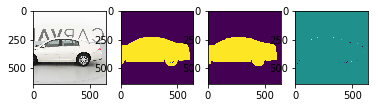

386it [06:02,  1.04it/s]

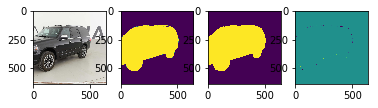

387it [06:03,  1.07it/s]

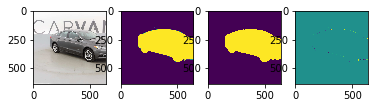

388it [06:04,  1.09it/s]

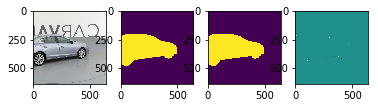

389it [06:05,  1.08it/s]

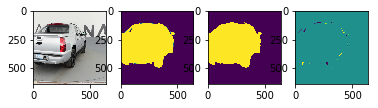

390it [06:06,  1.05it/s]

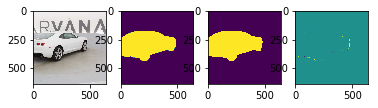

391it [06:07,  1.08it/s]

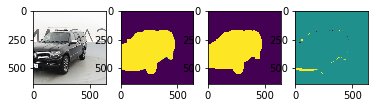

392it [06:08,  1.07it/s]

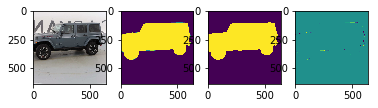

393it [06:09,  1.06it/s]

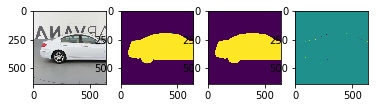

394it [06:10,  1.04it/s]

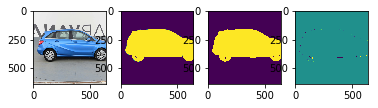

395it [06:10,  1.06it/s]

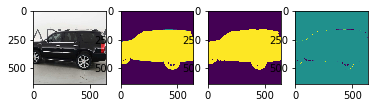

396it [06:11,  1.08it/s]

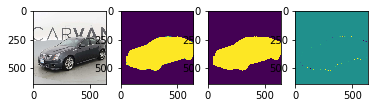

397it [06:12,  1.10it/s]

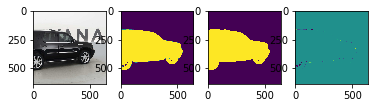

398it [06:13,  1.07it/s]

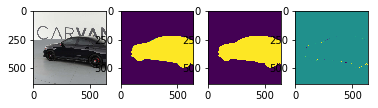

399it [06:14,  1.09it/s]

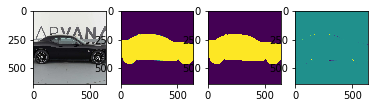

400it [06:15,  1.11it/s]

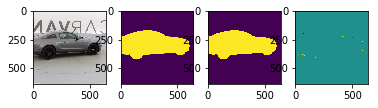

401it [06:16,  1.11it/s]

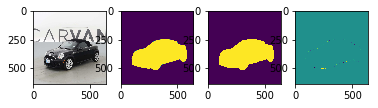

402it [06:17,  1.08it/s]

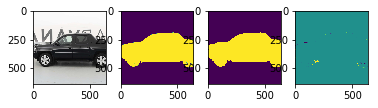

403it [06:18,  1.10it/s]

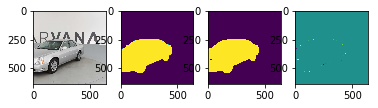

404it [06:19,  1.08it/s]

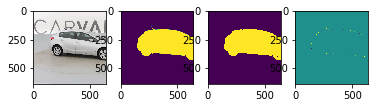

405it [06:20,  1.08it/s]

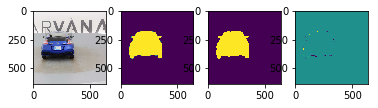

406it [06:21,  1.05it/s]

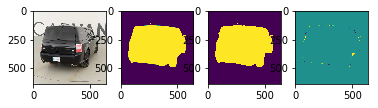

407it [06:22,  1.05it/s]

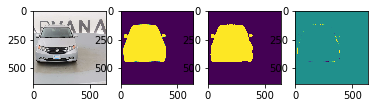

408it [06:22,  1.08it/s]

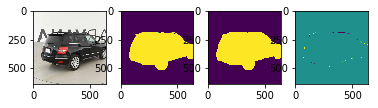

409it [06:23,  1.09it/s]

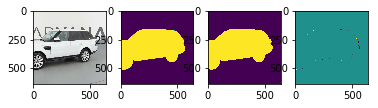

410it [06:24,  1.07it/s]

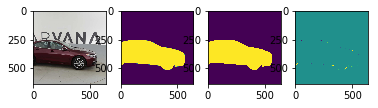

411it [06:25,  1.08it/s]

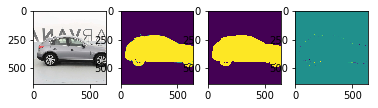

412it [06:26,  1.08it/s]

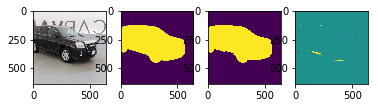

413it [06:27,  1.10it/s]

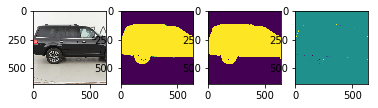

414it [06:28,  1.07it/s]

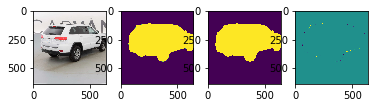

415it [06:29,  1.09it/s]

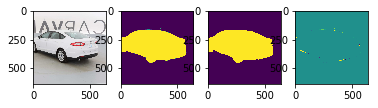

416it [06:30,  1.11it/s]

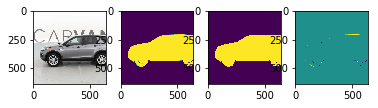

417it [06:31,  1.11it/s]

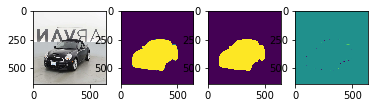

418it [06:32,  1.06it/s]

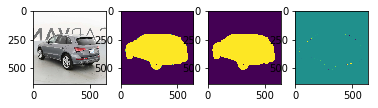

419it [06:33,  1.08it/s]

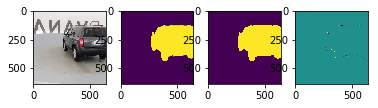

420it [06:33,  1.10it/s]

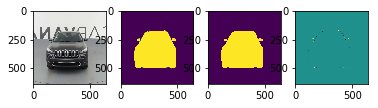

421it [06:34,  1.11it/s]

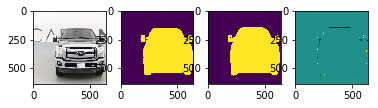

422it [06:35,  1.08it/s]

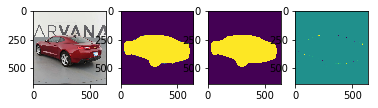

423it [06:36,  1.09it/s]

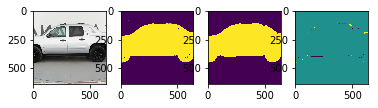

424it [06:37,  1.10it/s]

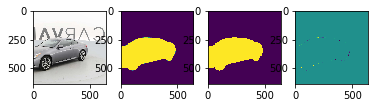

425it [06:38,  1.11it/s]

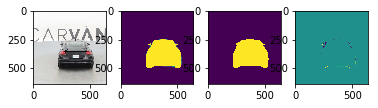

426it [06:39,  1.08it/s]

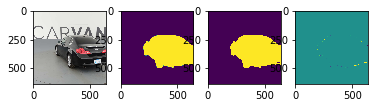

427it [06:40,  1.07it/s]

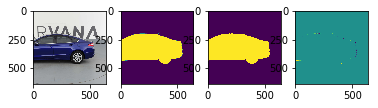

428it [06:41,  1.08it/s]

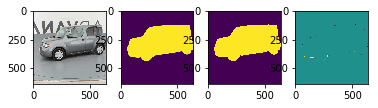

429it [06:42,  1.09it/s]

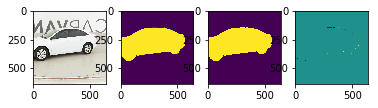

430it [06:43,  1.04it/s]

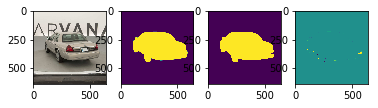

431it [06:44,  1.06it/s]

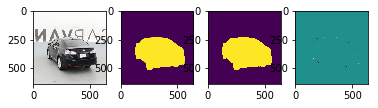

432it [06:45,  1.07it/s]

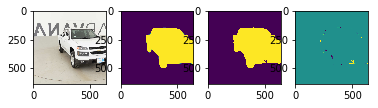

433it [06:45,  1.09it/s]

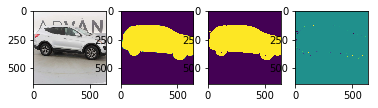

434it [06:46,  1.06it/s]

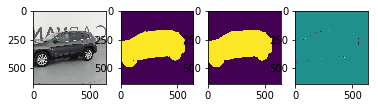

435it [06:47,  1.08it/s]

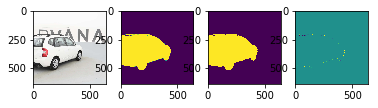

436it [06:48,  1.10it/s]

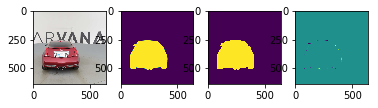

437it [06:49,  1.12it/s]

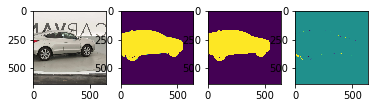

438it [06:50,  1.09it/s]

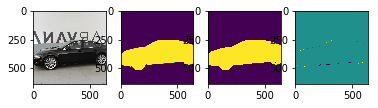

439it [06:51,  1.09it/s]

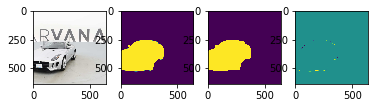

440it [06:52,  1.10it/s]

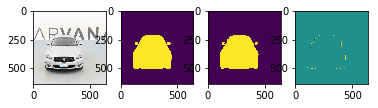

441it [06:53,  1.10it/s]

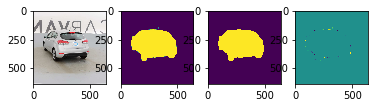

442it [06:54,  1.07it/s]

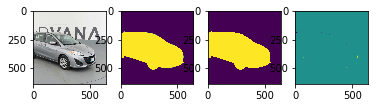

443it [06:55,  1.09it/s]

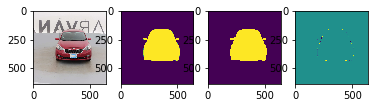

444it [06:56,  1.10it/s]

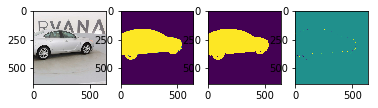

445it [06:56,  1.12it/s]

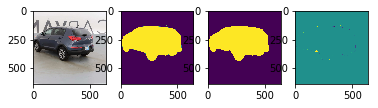

446it [06:57,  1.07it/s]

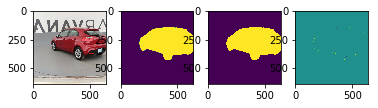

447it [06:58,  1.07it/s]

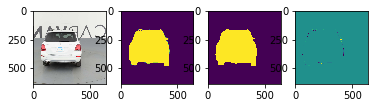

448it [06:59,  1.06it/s]

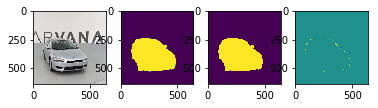

449it [07:00,  1.05it/s]

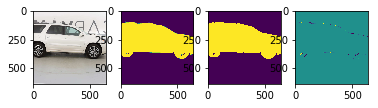

450it [07:01,  1.04it/s]

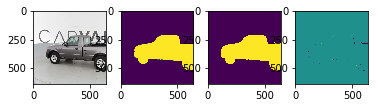

451it [07:02,  1.04it/s]

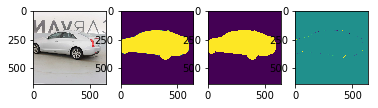

452it [07:03,  1.04it/s]

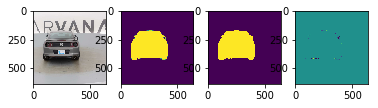

453it [07:04,  1.05it/s]

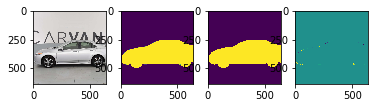

454it [07:05,  1.03it/s]

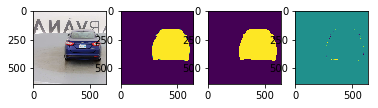

455it [07:06,  1.06it/s]

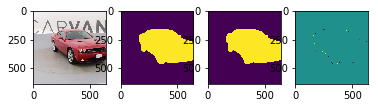

456it [07:07,  1.09it/s]

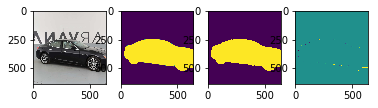

457it [07:08,  1.11it/s]

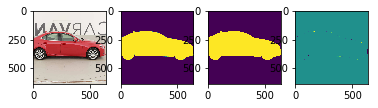

458it [07:09,  1.04it/s]

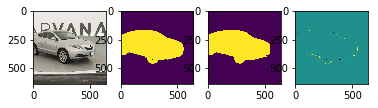

459it [07:10,  1.07it/s]

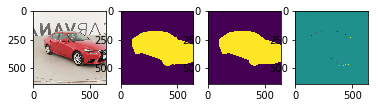

460it [07:11,  1.07it/s]

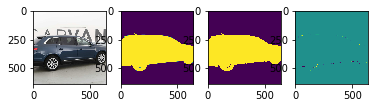

461it [07:12,  1.08it/s]

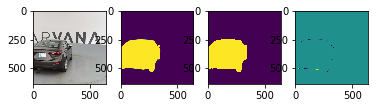

462it [07:13,  1.05it/s]

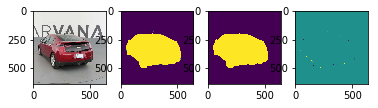

463it [07:13,  1.07it/s]

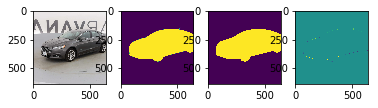

464it [07:14,  1.09it/s]

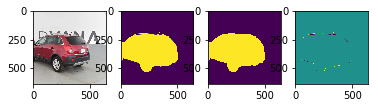

465it [07:15,  1.10it/s]

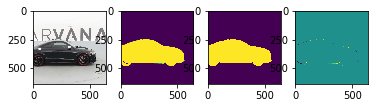

466it [07:16,  1.08it/s]

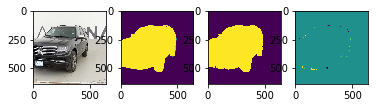

467it [07:17,  1.10it/s]

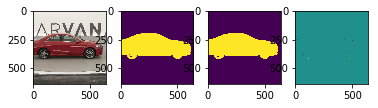

468it [07:18,  1.10it/s]

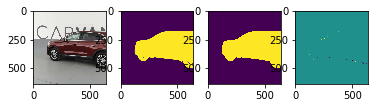

469it [07:19,  1.11it/s]

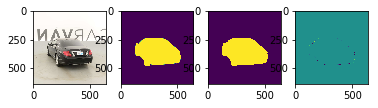

470it [07:20,  1.08it/s]

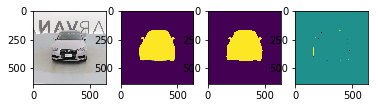

471it [07:21,  1.07it/s]

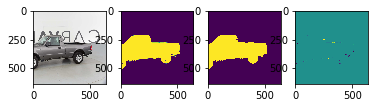

472it [07:22,  1.09it/s]

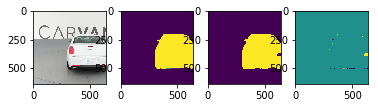

473it [07:23,  1.09it/s]

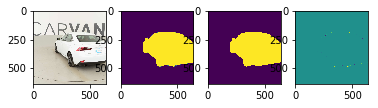

474it [07:24,  1.06it/s]

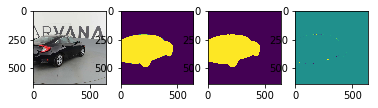

475it [07:25,  1.06it/s]

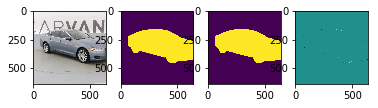

476it [07:26,  1.05it/s]

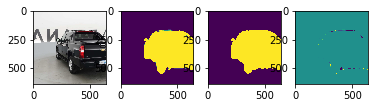

477it [07:27,  1.04it/s]

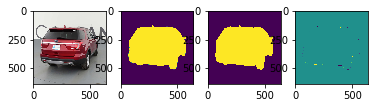

478it [07:28,  1.01it/s]

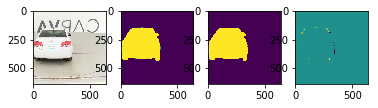

479it [07:29,  1.02it/s]

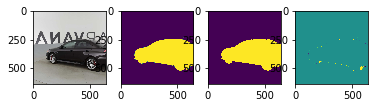

480it [07:29,  1.04it/s]

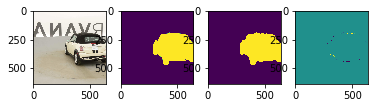

481it [07:30,  1.07it/s]

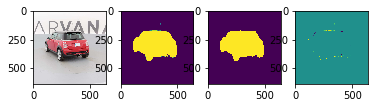

482it [07:31,  1.05it/s]

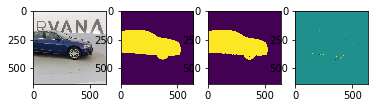

483it [07:32,  1.08it/s]

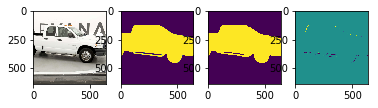

484it [07:33,  1.09it/s]

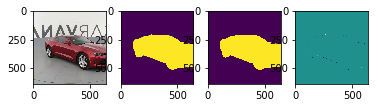

485it [07:34,  1.07it/s]

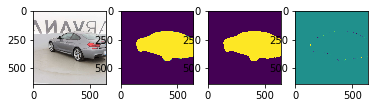

486it [07:35,  1.03it/s]

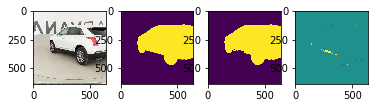

487it [07:36,  1.04it/s]

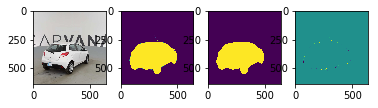

488it [07:37,  1.05it/s]

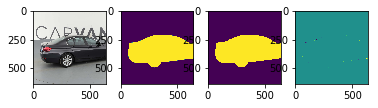

489it [07:38,  1.07it/s]

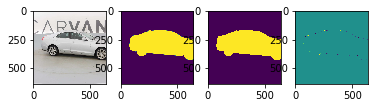

490it [07:39,  1.05it/s]

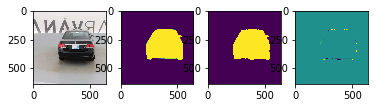

491it [07:40,  1.06it/s]

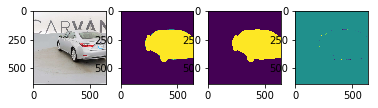

492it [07:41,  1.06it/s]

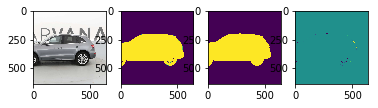

493it [07:42,  1.07it/s]

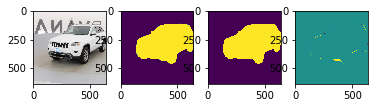

494it [07:43,  1.04it/s]

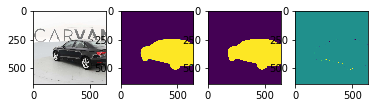

495it [07:44,  1.06it/s]

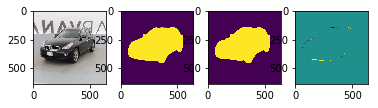

496it [07:44,  1.08it/s]

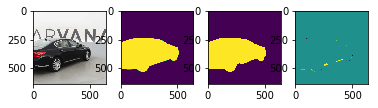

497it [07:45,  1.11it/s]

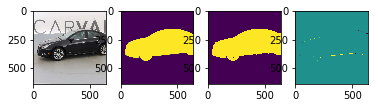

498it [07:46,  1.08it/s]

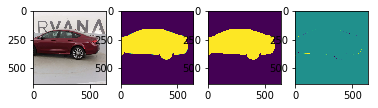

499it [07:47,  1.08it/s]

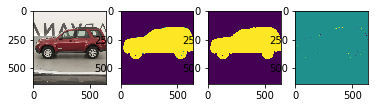

500it [07:48,  1.10it/s]

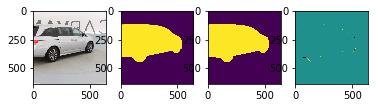

501it [07:49,  1.08it/s]

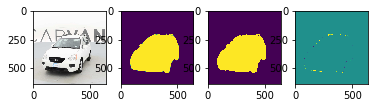

502it [07:50,  1.05it/s]

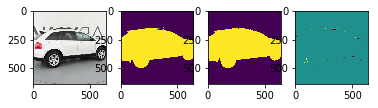

503it [07:51,  1.06it/s]

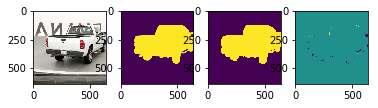

504it [07:52,  1.06it/s]

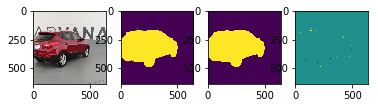

505it [07:53,  1.08it/s]

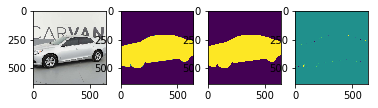

506it [07:54,  1.03it/s]

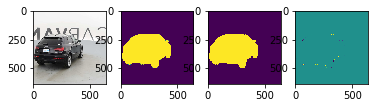

507it [07:55,  1.05it/s]

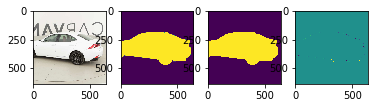

508it [07:56,  1.06it/s]

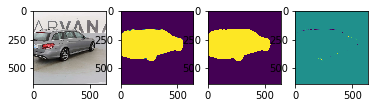

509it [07:57,  1.08it/s]

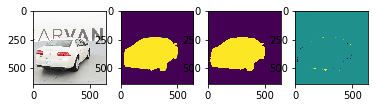

510it [07:58,  1.05it/s]

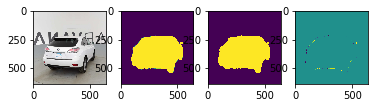

511it [07:58,  1.07it/s]

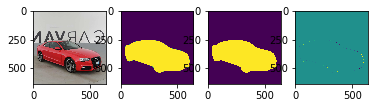

512it [07:59,  1.08it/s]

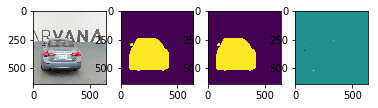

513it [08:00,  1.09it/s]

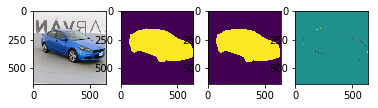

514it [08:01,  1.07it/s]

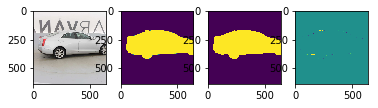

515it [08:02,  1.07it/s]

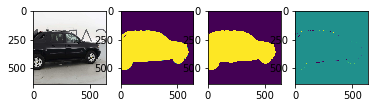

516it [08:03,  1.10it/s]

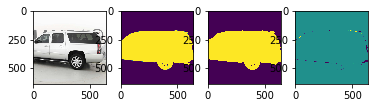

517it [08:04,  1.09it/s]

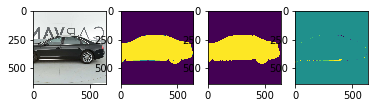

518it [08:05,  1.04it/s]

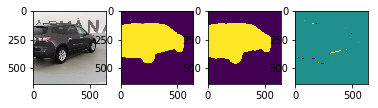

519it [08:06,  1.06it/s]

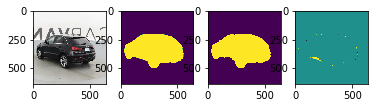

520it [08:07,  1.06it/s]

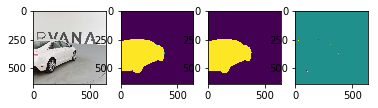

521it [08:08,  1.09it/s]

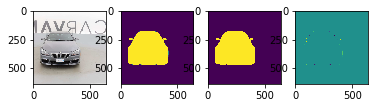

522it [08:09,  1.03it/s]

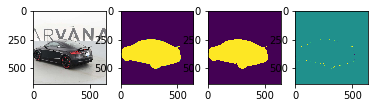

523it [08:10,  1.03it/s]

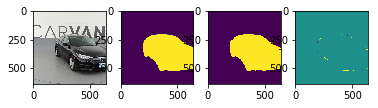

524it [08:11,  1.04it/s]

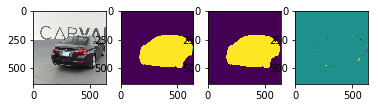

525it [08:12,  1.06it/s]

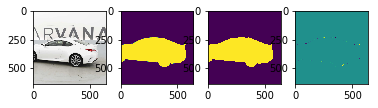

526it [08:13,  1.04it/s]

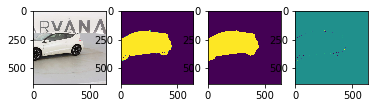

527it [08:14,  1.06it/s]

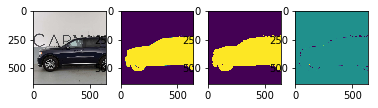

528it [08:14,  1.06it/s]

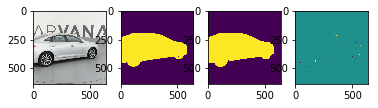

529it [08:15,  1.08it/s]

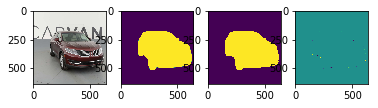

530it [08:16,  1.06it/s]

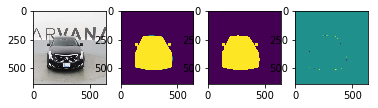

531it [08:17,  1.07it/s]

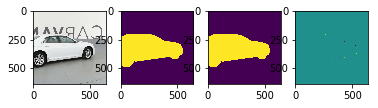

532it [08:18,  1.06it/s]

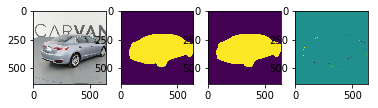

533it [08:19,  1.09it/s]

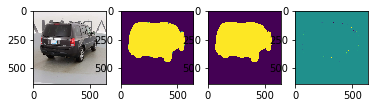

534it [08:20,  1.06it/s]

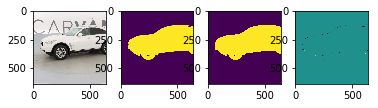

535it [08:21,  1.08it/s]

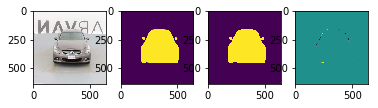

536it [08:22,  1.10it/s]

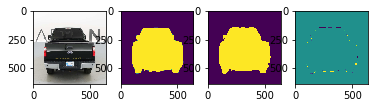

537it [08:23,  1.10it/s]

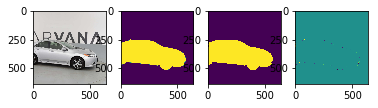

538it [08:24,  1.08it/s]

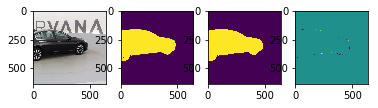

539it [08:25,  1.10it/s]

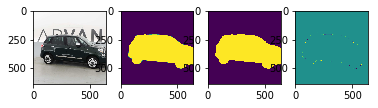

540it [08:25,  1.11it/s]

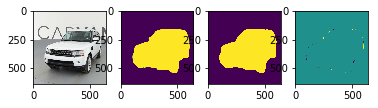

541it [08:26,  1.12it/s]

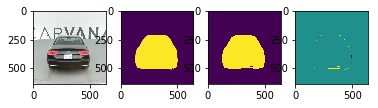

542it [08:27,  1.06it/s]

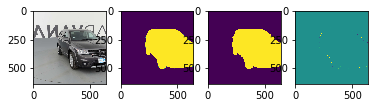

543it [08:28,  1.08it/s]

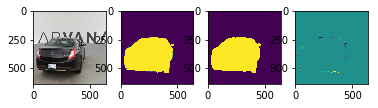

544it [08:29,  1.09it/s]

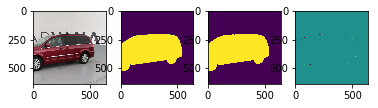

545it [08:30,  1.11it/s]

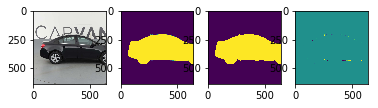

546it [08:31,  1.08it/s]

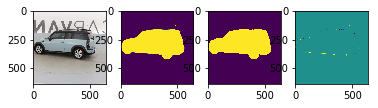

547it [08:32,  1.09it/s]

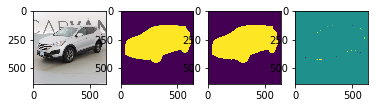

548it [08:33,  1.10it/s]

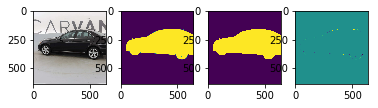

549it [08:34,  1.08it/s]

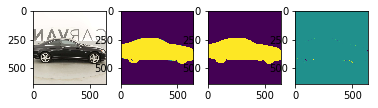

550it [08:35,  1.04it/s]

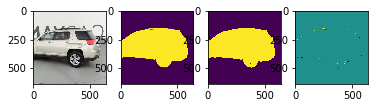

551it [08:36,  1.04it/s]

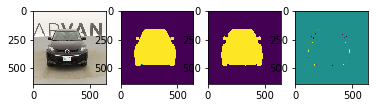

552it [08:37,  1.07it/s]

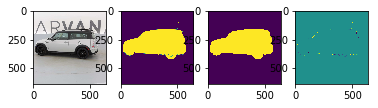

553it [08:38,  1.06it/s]

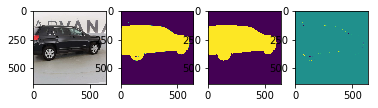

554it [08:39,  1.04it/s]

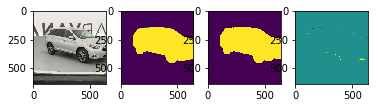

555it [08:40,  1.06it/s]

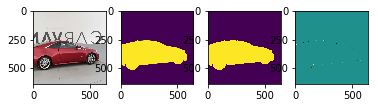

556it [08:40,  1.08it/s]

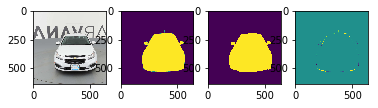

557it [08:41,  1.09it/s]

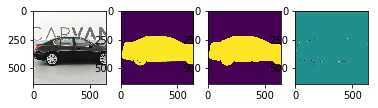

558it [08:42,  1.06it/s]

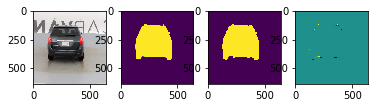

559it [08:43,  1.08it/s]

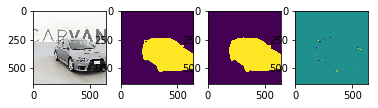

560it [08:44,  1.10it/s]

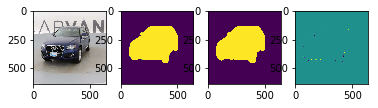

561it [08:45,  1.11it/s]

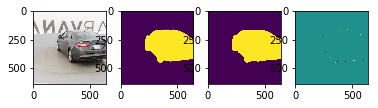

562it [08:46,  1.07it/s]

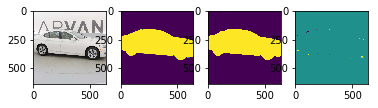

563it [08:47,  1.09it/s]

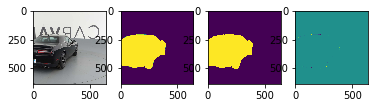

564it [08:48,  1.08it/s]

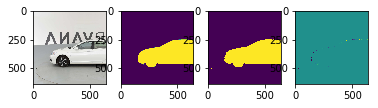

565it [08:49,  1.09it/s]

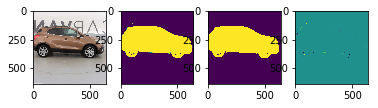

566it [08:50,  1.04it/s]

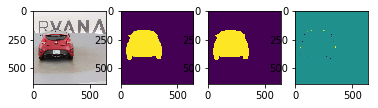

567it [08:51,  1.06it/s]

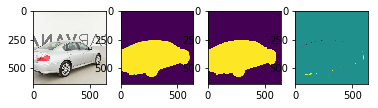

568it [08:52,  1.07it/s]

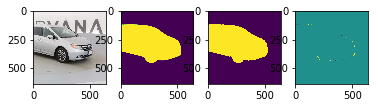

569it [08:52,  1.08it/s]

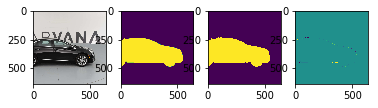

570it [08:54,  1.02it/s]

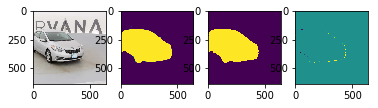

571it [08:55,  1.03it/s]

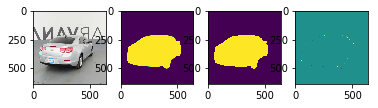

572it [08:55,  1.03it/s]

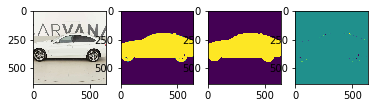

573it [08:56,  1.05it/s]

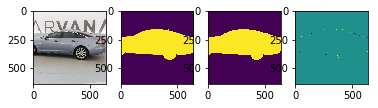

574it [08:57,  1.01it/s]

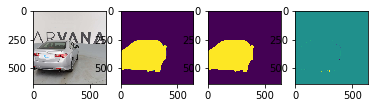

575it [08:58,  1.04it/s]

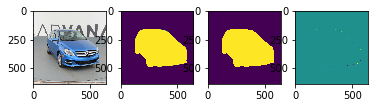

576it [08:59,  1.05it/s]

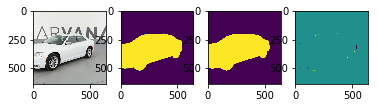

577it [09:00,  1.07it/s]

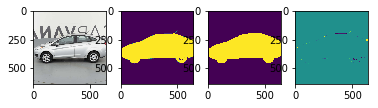

578it [09:01,  1.05it/s]

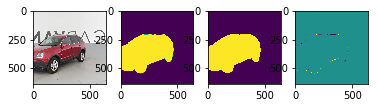

579it [09:02,  1.07it/s]

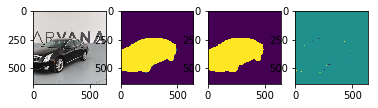

580it [09:03,  1.08it/s]

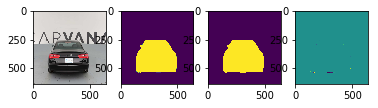

581it [09:04,  1.08it/s]

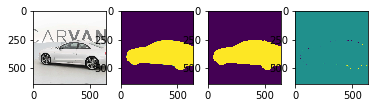

582it [09:05,  1.05it/s]

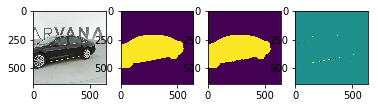

583it [09:06,  1.08it/s]

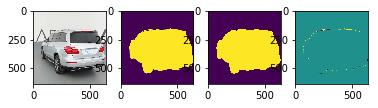

584it [09:07,  1.10it/s]

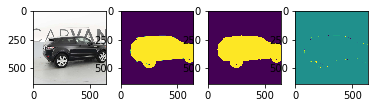

585it [09:08,  1.10it/s]

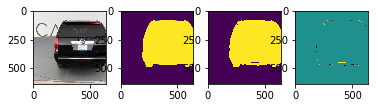

586it [09:09,  1.06it/s]

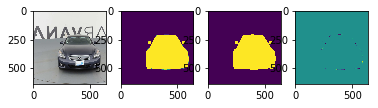

587it [09:09,  1.08it/s]

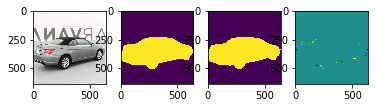

588it [09:10,  1.08it/s]

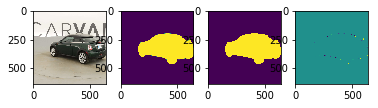

589it [09:11,  1.10it/s]

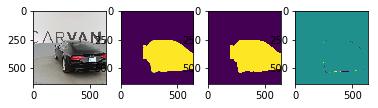

590it [09:12,  1.07it/s]

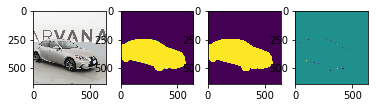

591it [09:13,  1.09it/s]

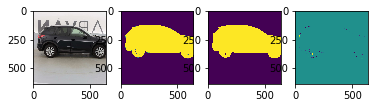

592it [09:14,  1.09it/s]

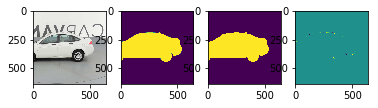

593it [09:15,  1.10it/s]

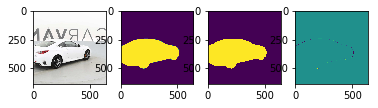

594it [09:16,  1.04it/s]

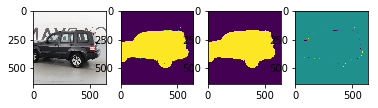

595it [09:17,  1.06it/s]

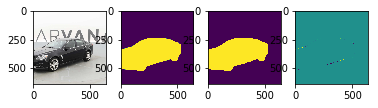

596it [09:18,  1.08it/s]

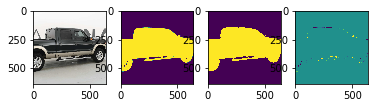

597it [09:19,  1.08it/s]

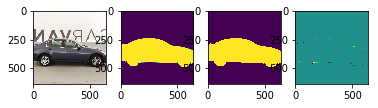

598it [09:20,  1.06it/s]

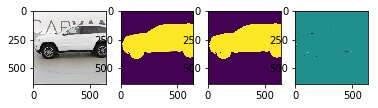

599it [09:21,  1.08it/s]

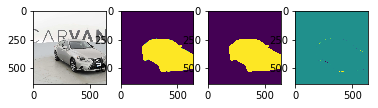

600it [09:22,  1.09it/s]

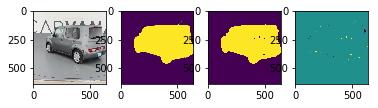

601it [09:22,  1.11it/s]

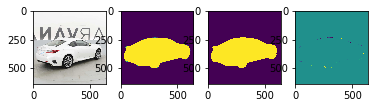

602it [09:23,  1.08it/s]

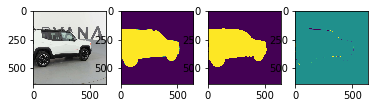

603it [09:24,  1.10it/s]

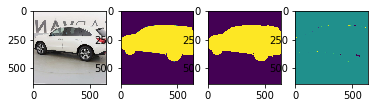

604it [09:25,  1.10it/s]

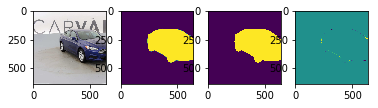

605it [09:26,  1.08it/s]

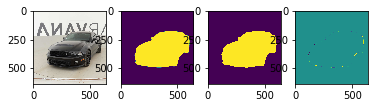

606it [09:27,  1.05it/s]

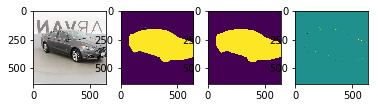

607it [09:28,  1.08it/s]

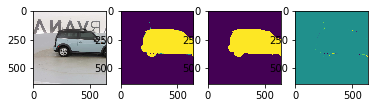

608it [09:29,  1.09it/s]

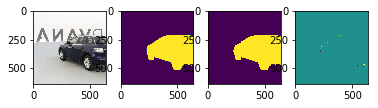

609it [09:30,  1.10it/s]

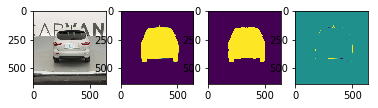

610it [09:31,  1.04it/s]

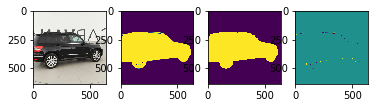

611it [09:32,  1.04it/s]

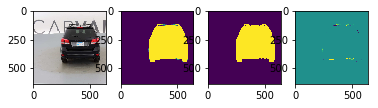

612it [09:33,  1.07it/s]

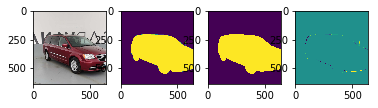

613it [09:34,  1.08it/s]

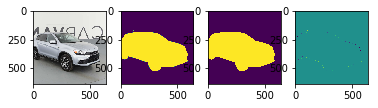

614it [09:35,  1.05it/s]

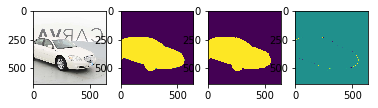

615it [09:36,  1.07it/s]

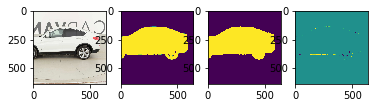

616it [09:36,  1.08it/s]

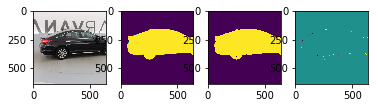

617it [09:37,  1.10it/s]

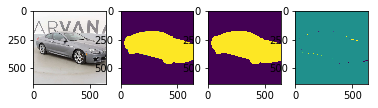

618it [09:38,  1.05it/s]

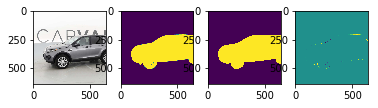

619it [09:39,  1.05it/s]

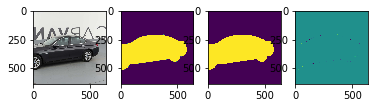

620it [09:40,  1.05it/s]

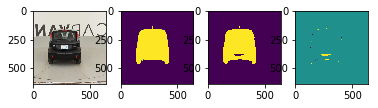

621it [09:41,  1.06it/s]

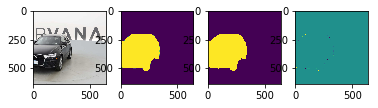

622it [09:42,  1.05it/s]

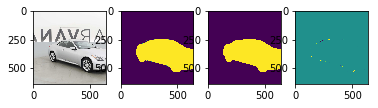

623it [09:43,  1.05it/s]

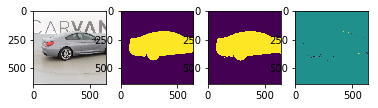

624it [09:44,  1.07it/s]

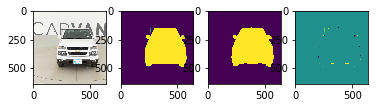

625it [09:45,  1.06it/s]

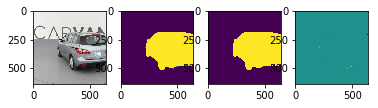

626it [09:46,  1.04it/s]

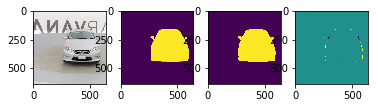

627it [09:47,  1.06it/s]

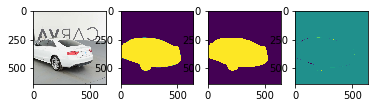

628it [09:48,  1.05it/s]

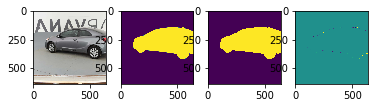

629it [09:49,  1.06it/s]

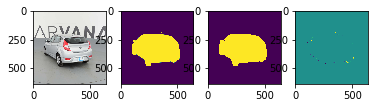

630it [09:50,  1.04it/s]

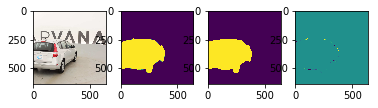

631it [09:51,  1.07it/s]

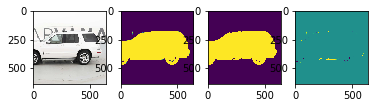

632it [09:52,  1.09it/s]

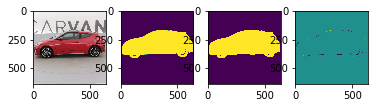

633it [09:52,  1.07it/s]

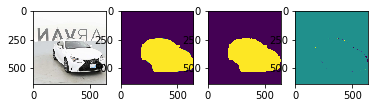

634it [09:54,  1.03it/s]

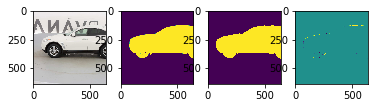

635it [09:54,  1.05it/s]

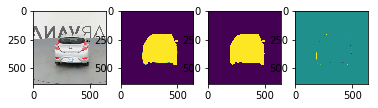

636it [09:55,  1.06it/s]

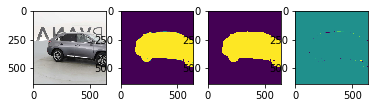

637it [09:56,  1.08it/s]

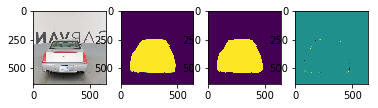

638it [09:57,  1.06it/s]

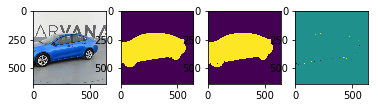

639it [09:58,  1.08it/s]

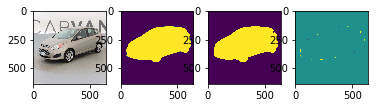

640it [09:59,  1.07it/s]

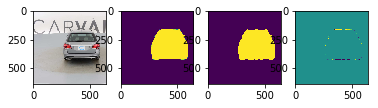

641it [10:00,  1.06it/s]

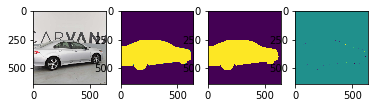

642it [10:01,  1.05it/s]

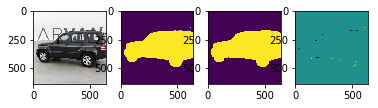

643it [10:02,  1.05it/s]

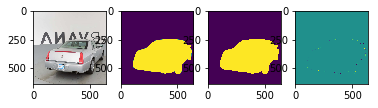

644it [10:03,  1.07it/s]

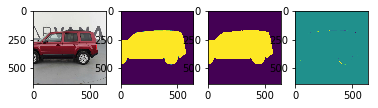

645it [10:04,  1.09it/s]

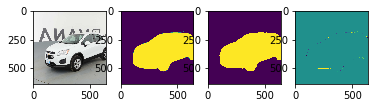

646it [10:05,  1.06it/s]

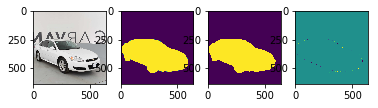

647it [10:06,  1.08it/s]

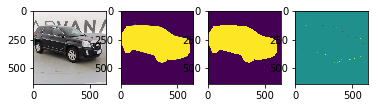

648it [10:07,  1.08it/s]

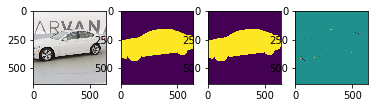

649it [10:07,  1.08it/s]

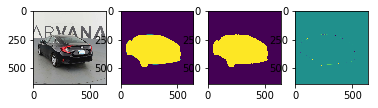

650it [10:08,  1.06it/s]

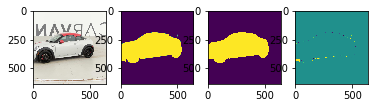

651it [10:09,  1.07it/s]

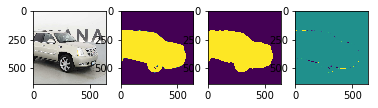

652it [10:10,  1.06it/s]

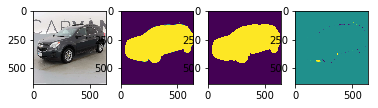

653it [10:11,  1.07it/s]

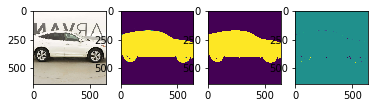

654it [10:12,  1.02it/s]

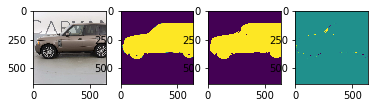

655it [10:13,  1.03it/s]

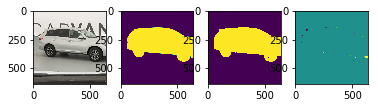

656it [10:14,  1.02s/it]

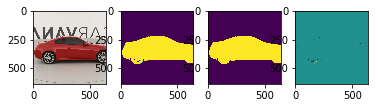

657it [10:15,  1.00s/it]

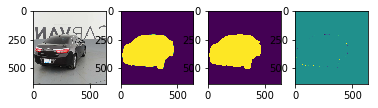

658it [10:16,  1.02s/it]

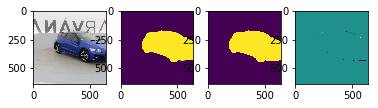

659it [10:17,  1.01it/s]

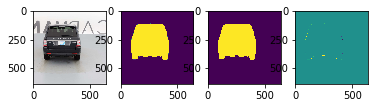

660it [10:18,  1.02it/s]

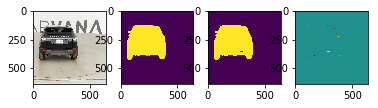

661it [10:19,  1.05it/s]

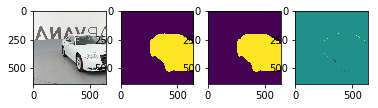

662it [10:20,  1.05it/s]

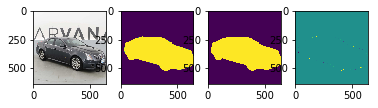

663it [10:21,  1.07it/s]

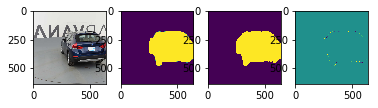

664it [10:22,  1.07it/s]

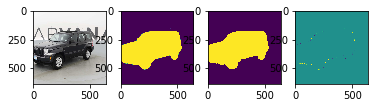

665it [10:23,  1.07it/s]

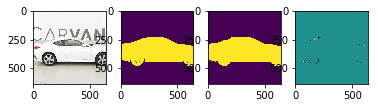

666it [10:24,  1.04it/s]

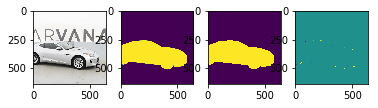

667it [10:25,  1.03it/s]

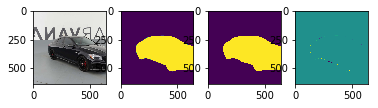

668it [10:26,  1.05it/s]

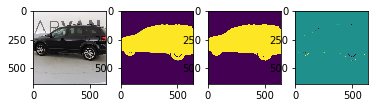

669it [10:27,  1.07it/s]

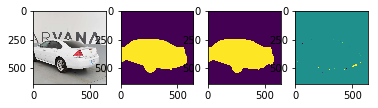

670it [10:28,  1.06it/s]

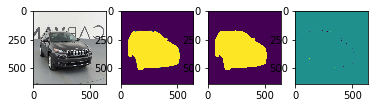

671it [10:29,  1.07it/s]

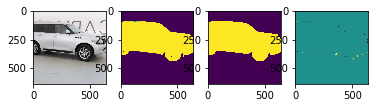

672it [10:30,  1.07it/s]

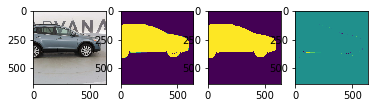

673it [10:30,  1.08it/s]

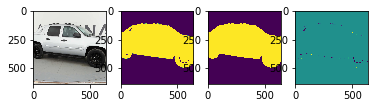

674it [10:32,  1.04it/s]

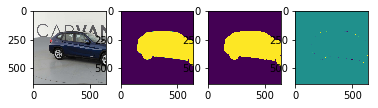

675it [10:32,  1.04it/s]

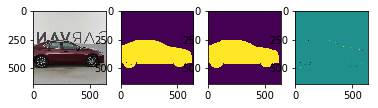

676it [10:33,  1.06it/s]

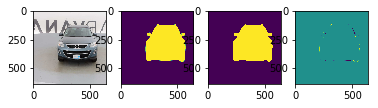

677it [10:34,  1.07it/s]

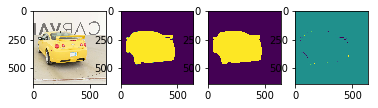

678it [10:35,  1.04it/s]

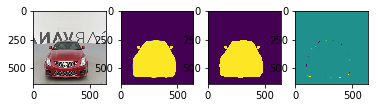

679it [10:36,  1.06it/s]

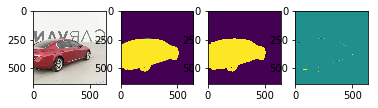

680it [10:37,  1.08it/s]

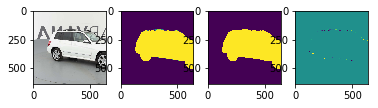

681it [10:38,  1.09it/s]

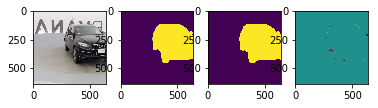

682it [10:39,  1.06it/s]

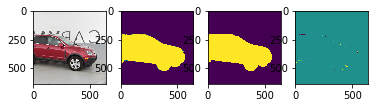

683it [10:40,  1.07it/s]

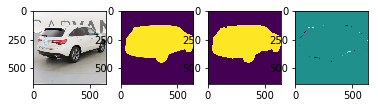

684it [10:41,  1.06it/s]

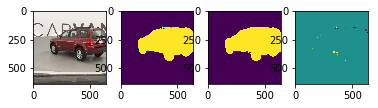

685it [10:42,  1.07it/s]

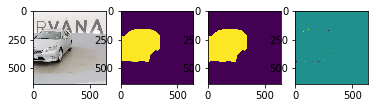

686it [10:43,  1.05it/s]

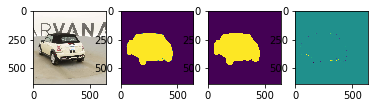

687it [10:44,  1.04it/s]

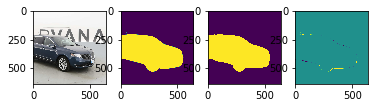

688it [10:45,  1.07it/s]

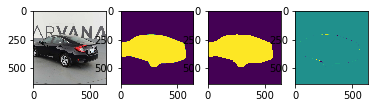

689it [10:46,  1.07it/s]

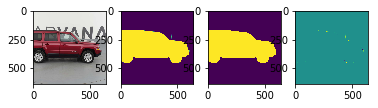

690it [10:47,  1.04it/s]

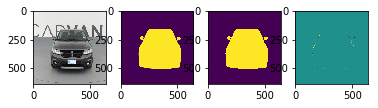

691it [10:48,  1.04it/s]

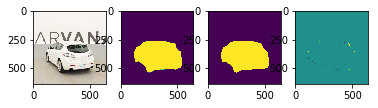

692it [10:48,  1.06it/s]

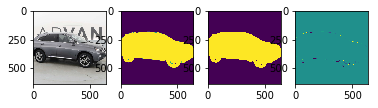

693it [10:49,  1.08it/s]

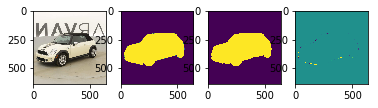

694it [10:50,  1.06it/s]

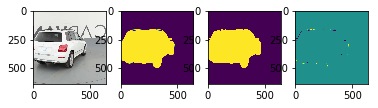

695it [10:51,  1.07it/s]

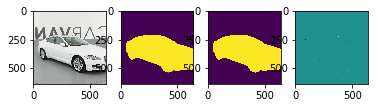

696it [10:52,  1.08it/s]

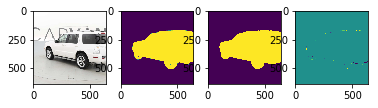

697it [10:53,  1.09it/s]

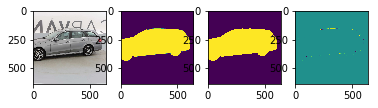

698it [10:54,  1.06it/s]

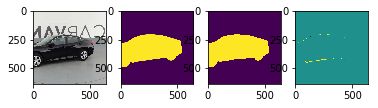

699it [10:55,  1.08it/s]

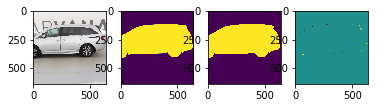

700it [10:56,  1.08it/s]

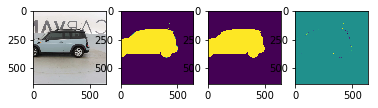

701it [10:57,  1.10it/s]

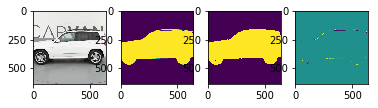

702it [10:58,  1.08it/s]

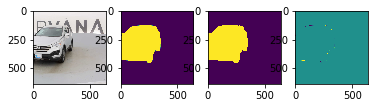

703it [10:59,  1.09it/s]

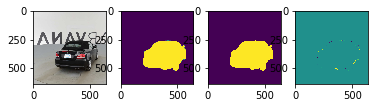

704it [10:59,  1.11it/s]

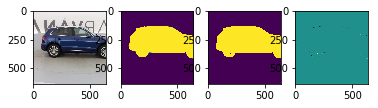

705it [11:00,  1.11it/s]

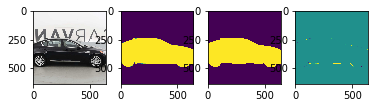

706it [11:01,  1.07it/s]

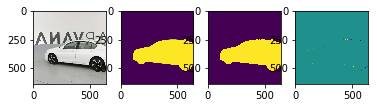

707it [11:02,  1.09it/s]

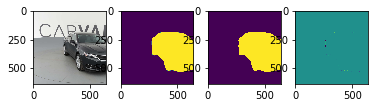

708it [11:03,  1.11it/s]

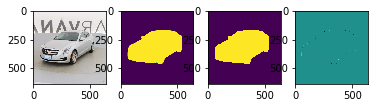

709it [11:04,  1.10it/s]

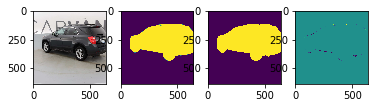

710it [11:05,  1.04it/s]

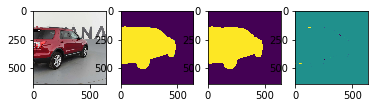

711it [11:06,  1.04it/s]

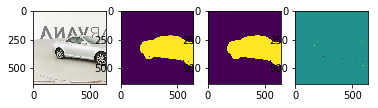

712it [11:07,  1.06it/s]

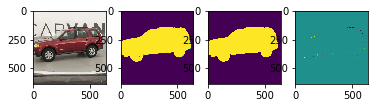

713it [11:08,  1.09it/s]

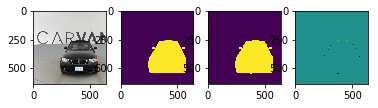

714it [11:09,  1.04it/s]

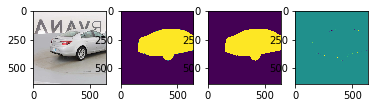

715it [11:10,  1.07it/s]

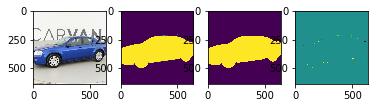

716it [11:11,  1.06it/s]

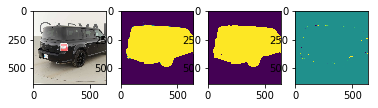

717it [11:12,  1.08it/s]

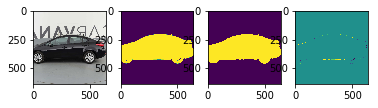

718it [11:13,  1.05it/s]

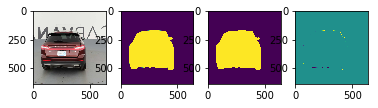

719it [11:13,  1.07it/s]

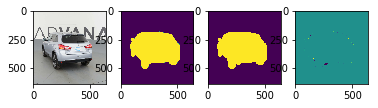

720it [11:14,  1.10it/s]

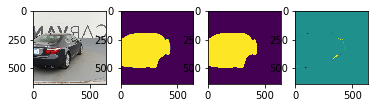

721it [11:15,  1.10it/s]

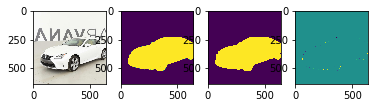

722it [11:16,  1.05it/s]

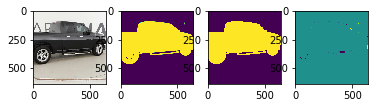

723it [11:17,  1.05it/s]

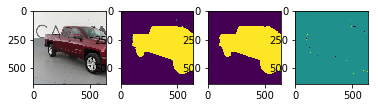

724it [11:18,  1.06it/s]

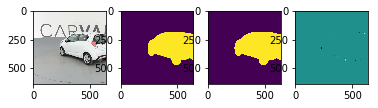

725it [11:19,  1.07it/s]

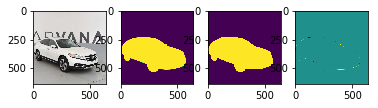

726it [11:20,  1.02it/s]

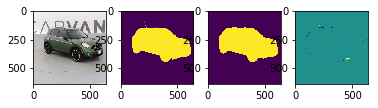

727it [11:21,  1.04it/s]

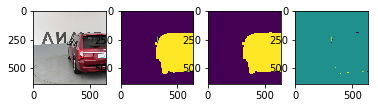

728it [11:22,  1.07it/s]

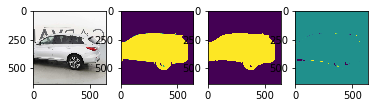

729it [11:23,  1.09it/s]

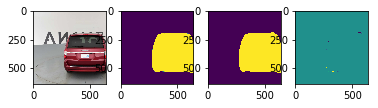

730it [11:24,  1.07it/s]

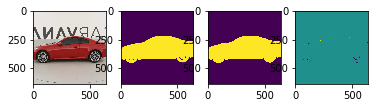

731it [11:25,  1.06it/s]

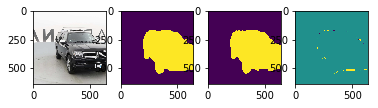

732it [11:26,  1.06it/s]

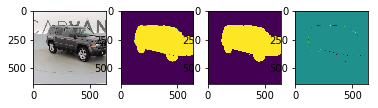

733it [11:27,  1.08it/s]

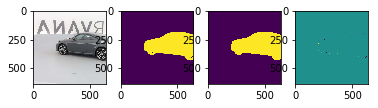

734it [11:28,  1.04it/s]

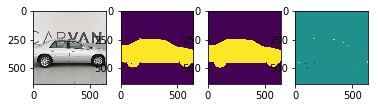

735it [11:29,  1.05it/s]

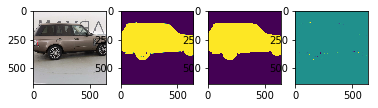

736it [11:30,  1.05it/s]

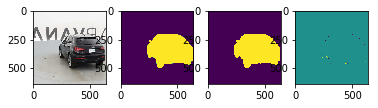

737it [11:30,  1.07it/s]

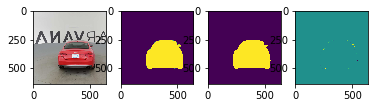

738it [11:31,  1.05it/s]

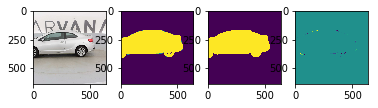

739it [11:32,  1.08it/s]

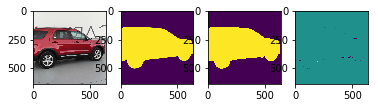

740it [11:33,  1.09it/s]

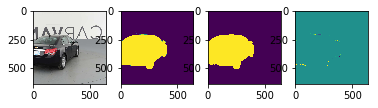

741it [11:34,  1.09it/s]

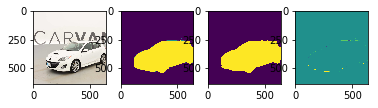

742it [11:35,  1.07it/s]

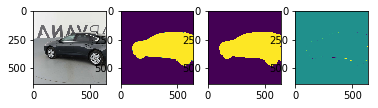

743it [11:36,  1.06it/s]

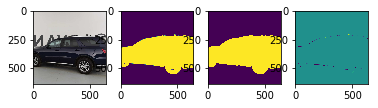

744it [11:37,  1.05it/s]

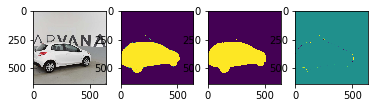

745it [11:38,  1.05it/s]

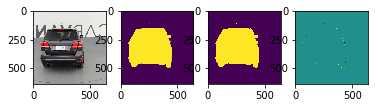

746it [11:39,  1.01it/s]

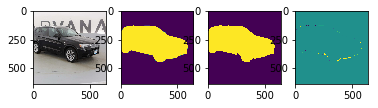

747it [11:40,  1.04it/s]

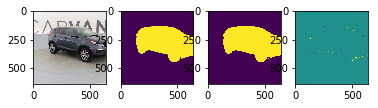

748it [11:41,  1.05it/s]

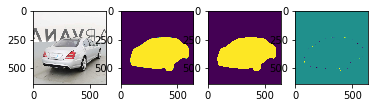

749it [11:42,  1.07it/s]

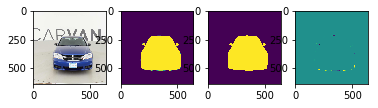

750it [11:43,  1.05it/s]

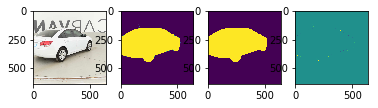

751it [11:44,  1.07it/s]

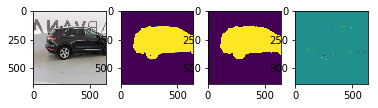

752it [11:45,  1.07it/s]

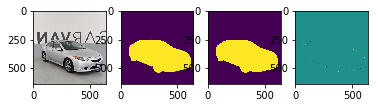

753it [11:46,  1.06it/s]

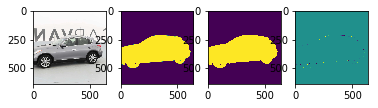

754it [11:47,  1.03it/s]

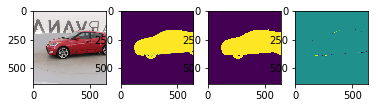

755it [11:48,  1.04it/s]

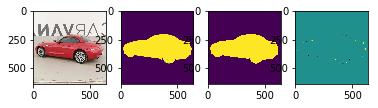

756it [11:48,  1.05it/s]

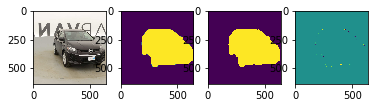

757it [11:49,  1.08it/s]

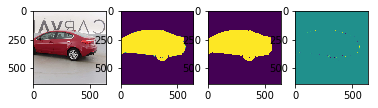

758it [11:50,  1.06it/s]

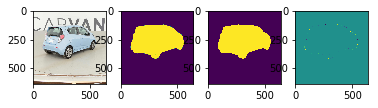

759it [11:51,  1.09it/s]

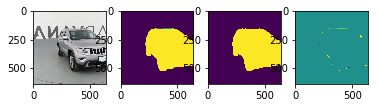

760it [11:52,  1.10it/s]

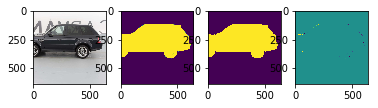

761it [11:53,  1.09it/s]

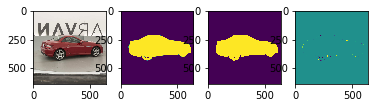

762it [11:54,  1.03it/s]

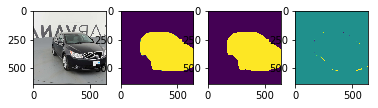

763it [11:55,  1.05it/s]

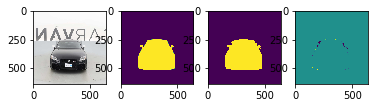

764it [11:56,  1.06it/s]

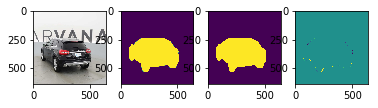

765it [11:57,  1.08it/s]

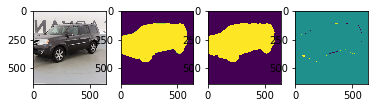

766it [11:58,  1.04it/s]

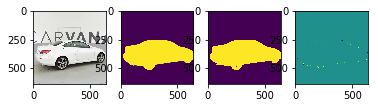

767it [11:59,  1.07it/s]

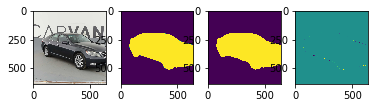

768it [12:00,  1.09it/s]

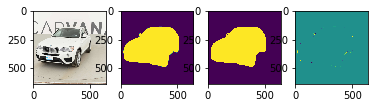

769it [12:01,  1.07it/s]

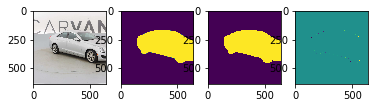

770it [12:02,  1.04it/s]

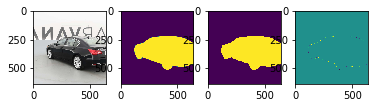

771it [12:02,  1.07it/s]

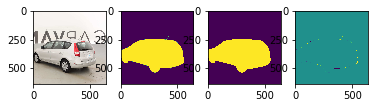

772it [12:03,  1.07it/s]

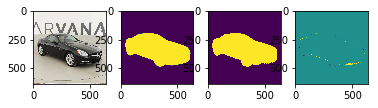

773it [12:04,  1.09it/s]

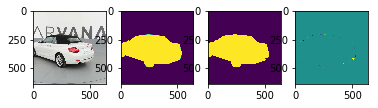

774it [12:05,  1.06it/s]

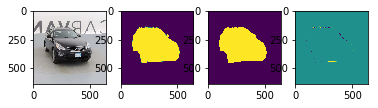

775it [12:06,  1.06it/s]

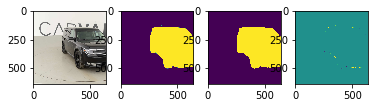

776it [12:07,  1.09it/s]

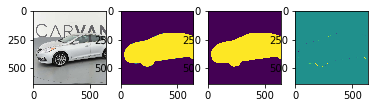

777it [12:08,  1.10it/s]

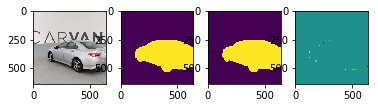

778it [12:09,  1.08it/s]

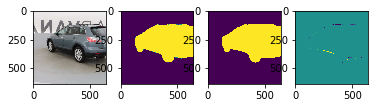

779it [12:10,  1.10it/s]

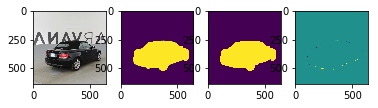

780it [12:11,  1.08it/s]

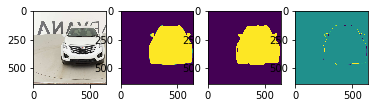

781it [12:12,  1.10it/s]

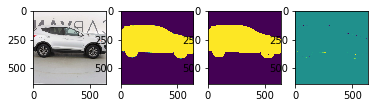

782it [12:13,  1.06it/s]

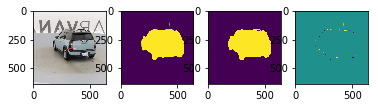

783it [12:14,  1.07it/s]

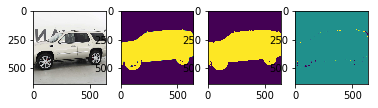

784it [12:14,  1.08it/s]

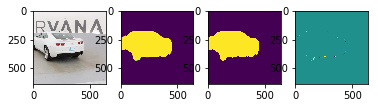

785it [12:15,  1.09it/s]

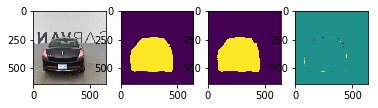

786it [12:16,  1.05it/s]

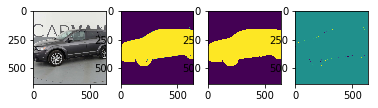

787it [12:17,  1.08it/s]

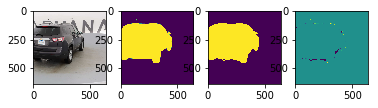

788it [12:18,  1.09it/s]

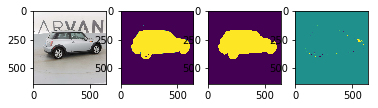

789it [12:19,  1.09it/s]

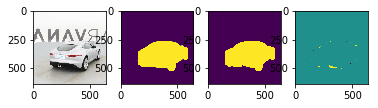

790it [12:20,  1.05it/s]

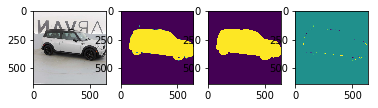

791it [12:21,  1.05it/s]

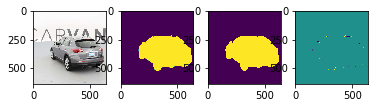

792it [12:22,  1.07it/s]

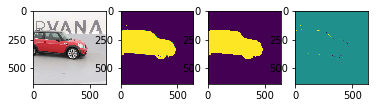

793it [12:23,  1.10it/s]

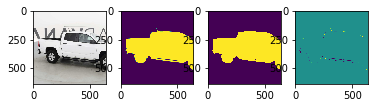

794it [12:24,  1.07it/s]

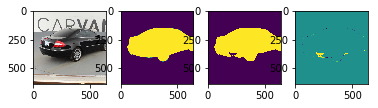

795it [12:25,  1.07it/s]

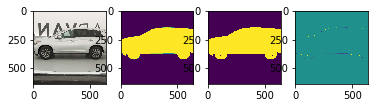

796it [12:26,  1.08it/s]

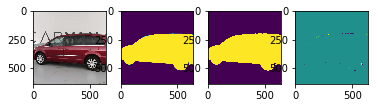

797it [12:27,  1.09it/s]

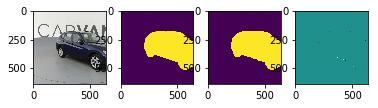

798it [12:28,  1.06it/s]

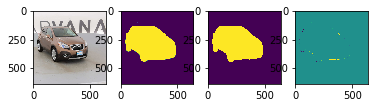

799it [12:29,  1.05it/s]

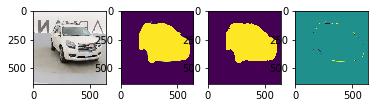

800it [12:29,  1.05it/s]

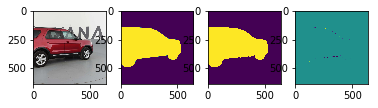

801it [12:30,  1.07it/s]

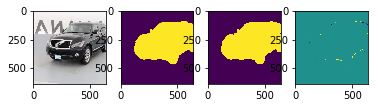

802it [12:31,  1.04it/s]

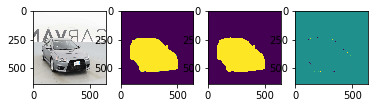

803it [12:32,  1.05it/s]

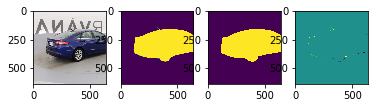

804it [12:33,  1.04it/s]

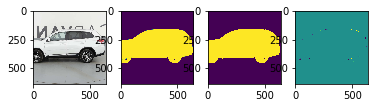

805it [12:34,  1.06it/s]

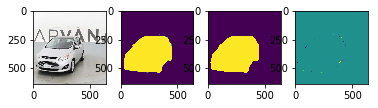

806it [12:35,  1.04it/s]

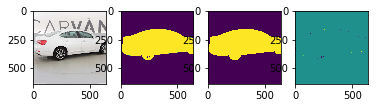

807it [12:36,  1.06it/s]

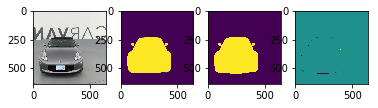

808it [12:37,  1.08it/s]

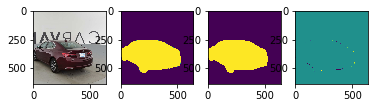

809it [12:38,  1.10it/s]

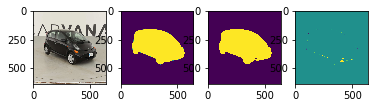

810it [12:39,  1.04it/s]

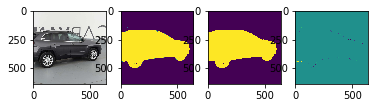

811it [12:40,  1.04it/s]

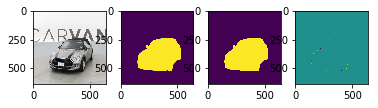

812it [12:41,  1.04it/s]

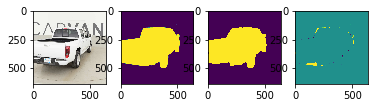

813it [12:42,  1.05it/s]

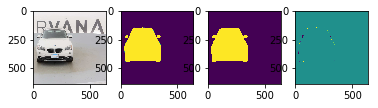

814it [12:43,  1.01it/s]

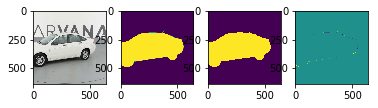

815it [12:44,  1.05it/s]

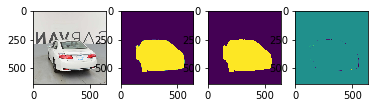

816it [12:45,  1.07it/s]

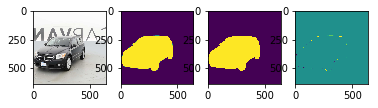

817it [12:46,  1.08it/s]

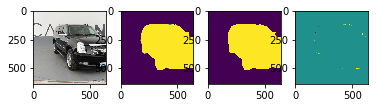

818it [12:47,  1.04it/s]

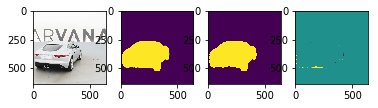

819it [12:48,  1.06it/s]

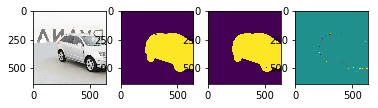

820it [12:48,  1.07it/s]

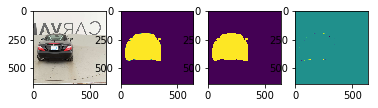

821it [12:49,  1.06it/s]

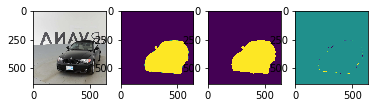

822it [12:50,  1.03it/s]

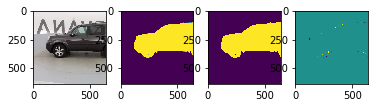

823it [12:51,  1.05it/s]

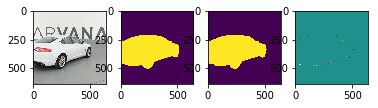

824it [12:52,  1.07it/s]

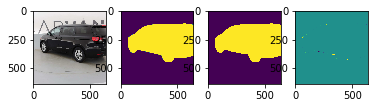

825it [12:53,  1.06it/s]

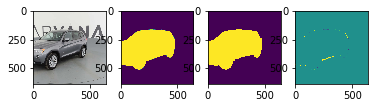

826it [12:54,  1.02it/s]

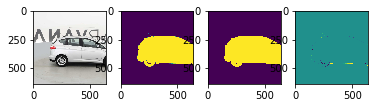

827it [12:55,  1.04it/s]

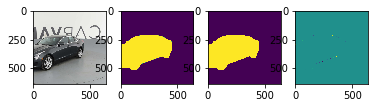

828it [12:56,  1.07it/s]

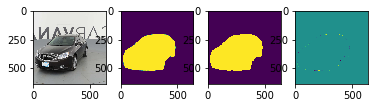

829it [12:57,  1.10it/s]

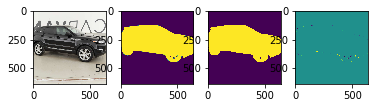

830it [12:58,  1.07it/s]

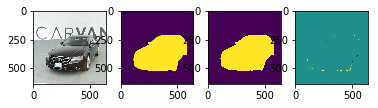

831it [12:59,  1.06it/s]

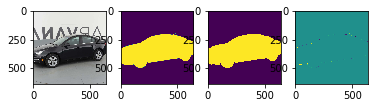

832it [13:00,  1.05it/s]

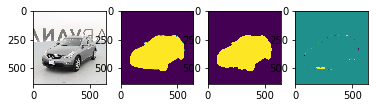

833it [13:01,  1.07it/s]

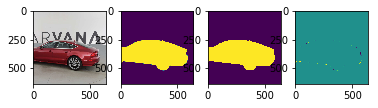

834it [13:02,  1.05it/s]

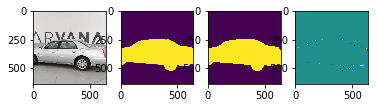

835it [13:03,  1.05it/s]

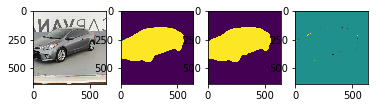

836it [13:04,  1.07it/s]

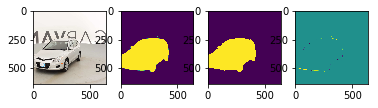

837it [13:04,  1.10it/s]

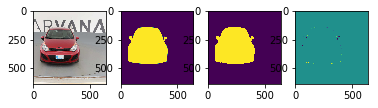

838it [13:05,  1.04it/s]

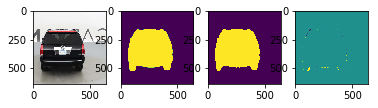

839it [13:06,  1.07it/s]

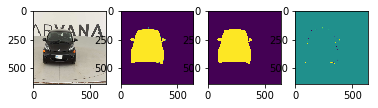

840it [13:07,  1.06it/s]

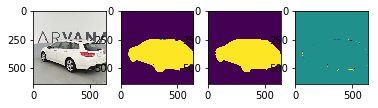

841it [13:08,  1.07it/s]

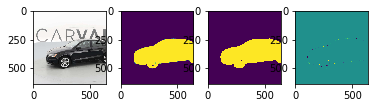

842it [13:09,  1.04it/s]

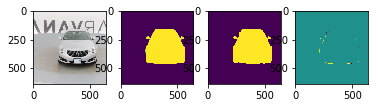

843it [13:10,  1.07it/s]

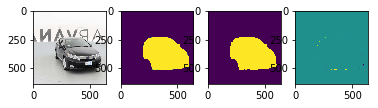

844it [13:11,  1.08it/s]

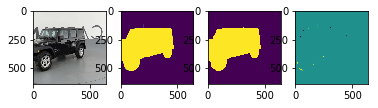

845it [13:12,  1.10it/s]

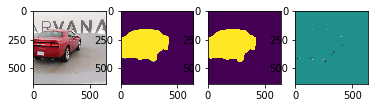

846it [13:13,  1.06it/s]

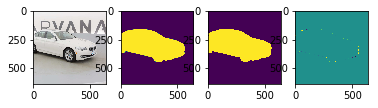

847it [13:14,  1.08it/s]

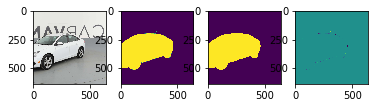

848it [13:15,  1.07it/s]

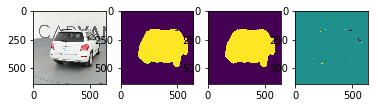

849it [13:16,  1.06it/s]

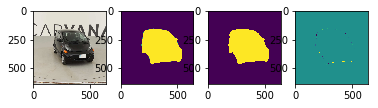

850it [13:17,  1.04it/s]

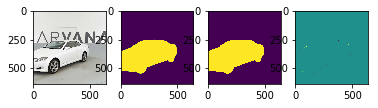

851it [13:18,  1.07it/s]

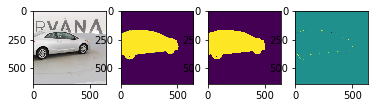

852it [13:19,  1.07it/s]

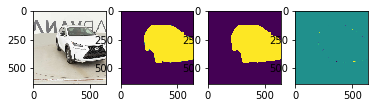

853it [13:19,  1.08it/s]

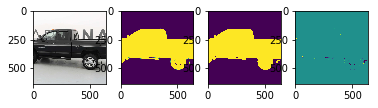

854it [13:21,  1.05it/s]

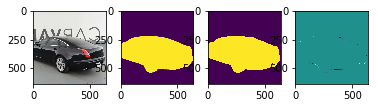

855it [13:21,  1.07it/s]

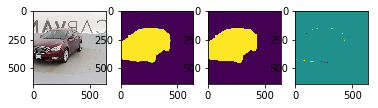

856it [13:22,  1.09it/s]

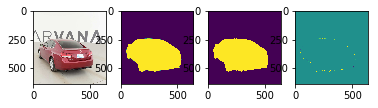

857it [13:23,  1.11it/s]

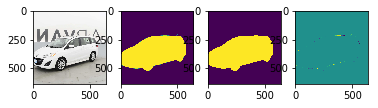

858it [13:24,  1.07it/s]

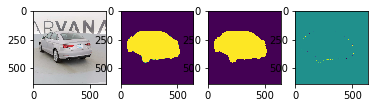

859it [13:25,  1.06it/s]

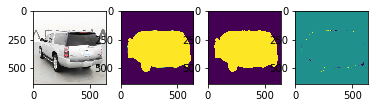

860it [13:26,  1.09it/s]

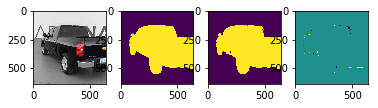

861it [13:27,  1.07it/s]

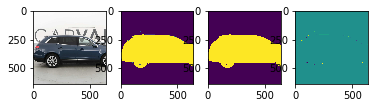

862it [13:28,  1.02it/s]

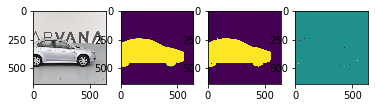

863it [13:29,  1.04it/s]

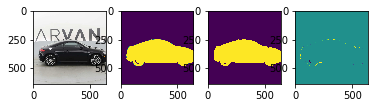

864it [13:30,  1.07it/s]

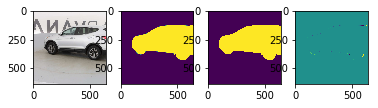

865it [13:31,  1.09it/s]

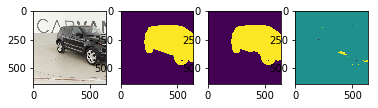

866it [13:32,  1.06it/s]

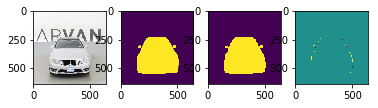

867it [13:33,  1.08it/s]

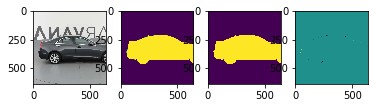

868it [13:33,  1.09it/s]

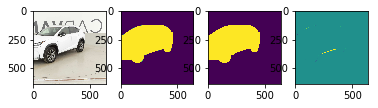

869it [13:34,  1.08it/s]

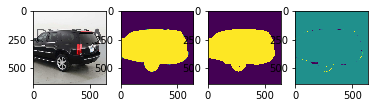

870it [13:35,  1.03it/s]

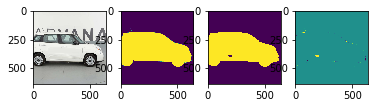

871it [13:36,  1.05it/s]

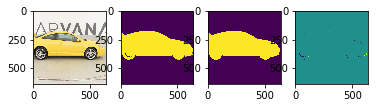

872it [13:37,  1.05it/s]

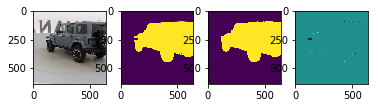

873it [13:38,  1.07it/s]

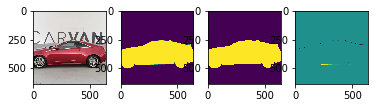

874it [13:39,  1.03it/s]

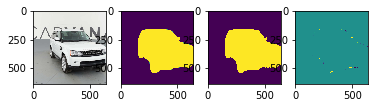

875it [13:40,  1.03it/s]

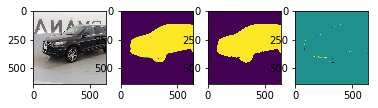

876it [13:41,  1.05it/s]

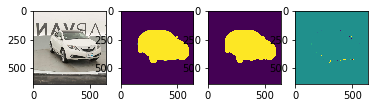

877it [13:42,  1.05it/s]

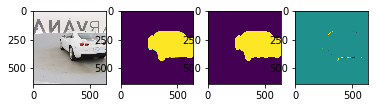

878it [13:43,  1.03it/s]

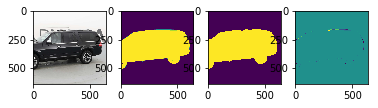

879it [13:44,  1.06it/s]

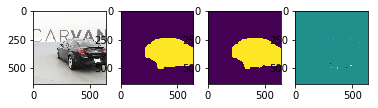

880it [13:45,  1.08it/s]

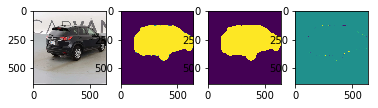

881it [13:46,  1.10it/s]

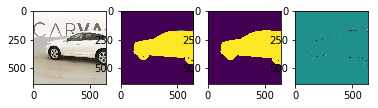

882it [13:47,  1.07it/s]

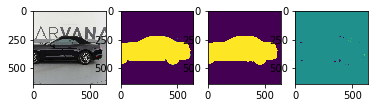

883it [13:48,  1.06it/s]

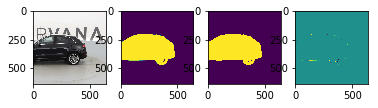

884it [13:49,  1.06it/s]

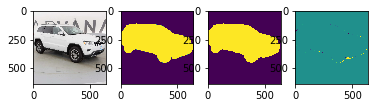

885it [13:50,  1.07it/s]

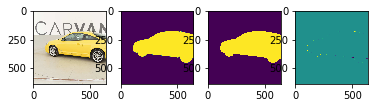

886it [13:51,  1.04it/s]

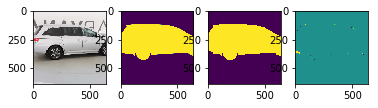

887it [13:51,  1.07it/s]

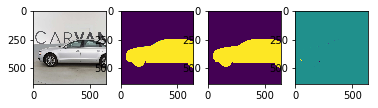

888it [13:52,  1.06it/s]

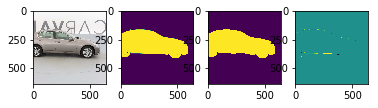

889it [13:53,  1.06it/s]

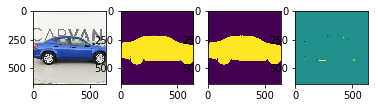

890it [13:54,  1.03it/s]

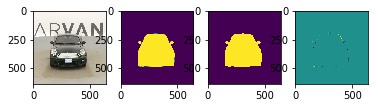

891it [13:55,  1.04it/s]

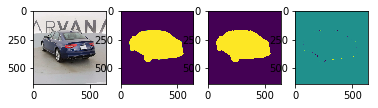

892it [13:56,  1.05it/s]

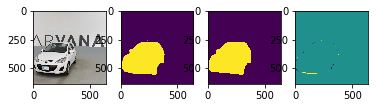

893it [13:57,  1.08it/s]

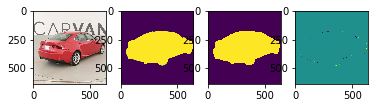

894it [13:58,  1.06it/s]

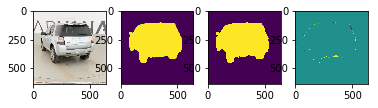

895it [13:59,  1.07it/s]

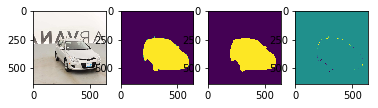

896it [14:00,  1.08it/s]

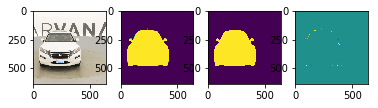

897it [14:01,  1.07it/s]

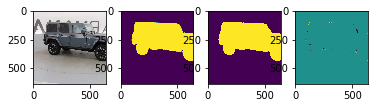

898it [14:02,  1.04it/s]

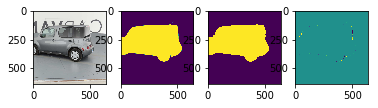

899it [14:03,  1.07it/s]

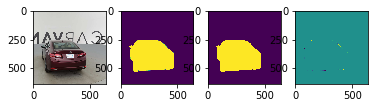

900it [14:04,  1.09it/s]

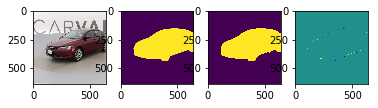

901it [14:05,  1.08it/s]

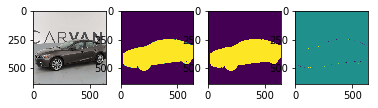

902it [14:06,  1.04it/s]

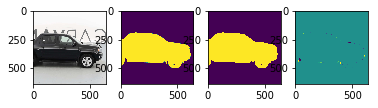

903it [14:07,  1.06it/s]

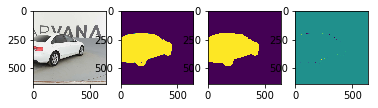

904it [14:07,  1.08it/s]

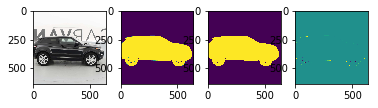

905it [14:08,  1.10it/s]

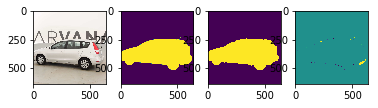

906it [14:09,  1.08it/s]

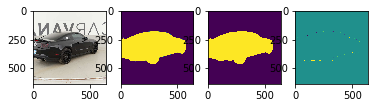

907it [14:10,  1.08it/s]

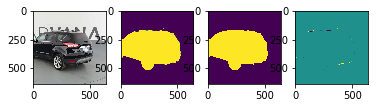

908it [14:11,  1.08it/s]

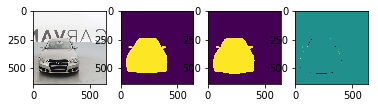

909it [14:12,  1.07it/s]

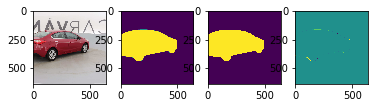

910it [14:13,  1.03it/s]

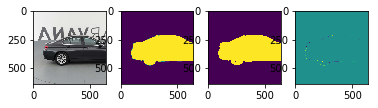

911it [14:14,  1.05it/s]

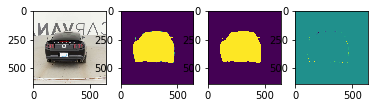

912it [14:15,  1.05it/s]

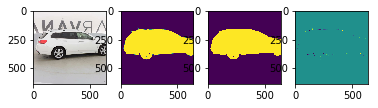

913it [14:16,  1.07it/s]

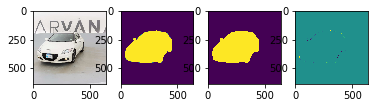

914it [14:17,  1.05it/s]

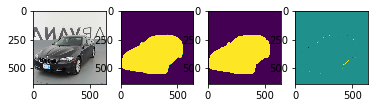

915it [14:18,  1.05it/s]

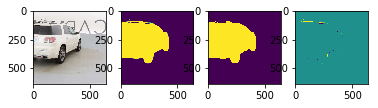

916it [14:19,  1.08it/s]

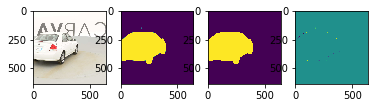

917it [14:20,  1.09it/s]

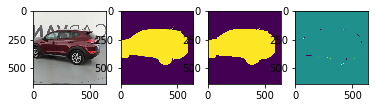

918it [14:21,  1.05it/s]

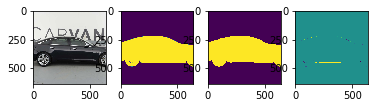

919it [14:22,  1.07it/s]

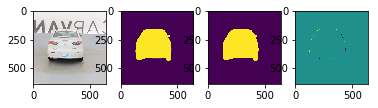

920it [14:22,  1.07it/s]

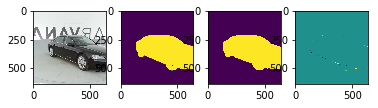

921it [14:23,  1.08it/s]

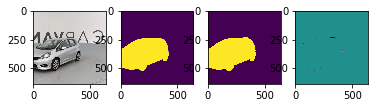

922it [14:24,  1.06it/s]

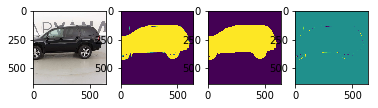

923it [14:25,  1.08it/s]

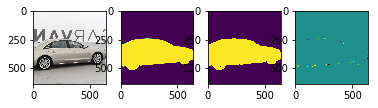

924it [14:26,  1.10it/s]

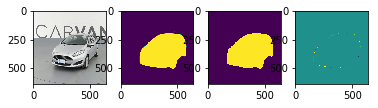

925it [14:27,  1.09it/s]

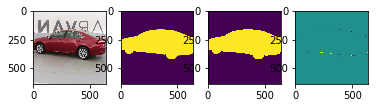

926it [14:28,  1.06it/s]

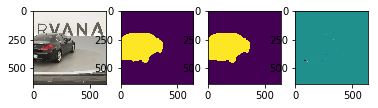

927it [14:29,  1.07it/s]

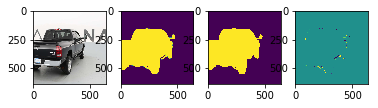

928it [14:30,  1.09it/s]

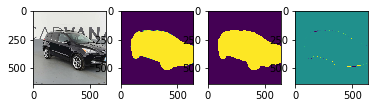

929it [14:31,  1.11it/s]

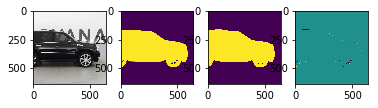

930it [14:32,  1.08it/s]

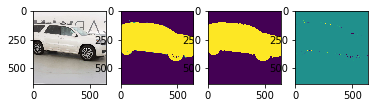

931it [14:33,  1.08it/s]

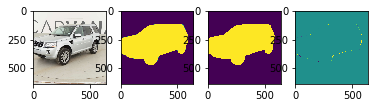

932it [14:34,  1.07it/s]

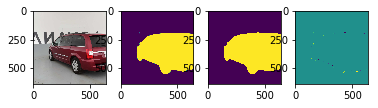

933it [14:34,  1.08it/s]

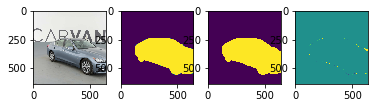

934it [14:36,  1.03it/s]

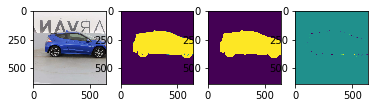

935it [14:37,  1.04it/s]

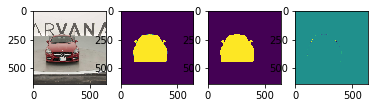

936it [14:37,  1.04it/s]

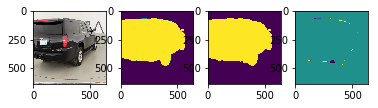

937it [14:38,  1.06it/s]

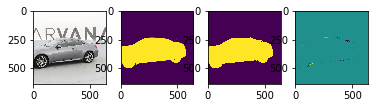

938it [14:39,  1.03it/s]

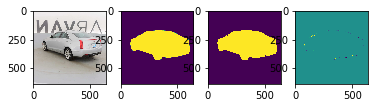

939it [14:40,  1.07it/s]

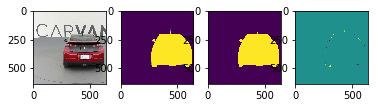

940it [14:41,  1.09it/s]

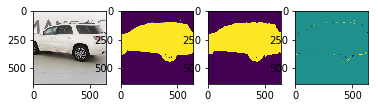

941it [14:42,  1.09it/s]

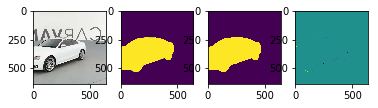

942it [14:43,  1.04it/s]

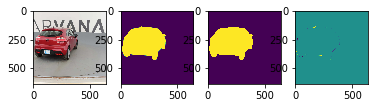

943it [14:44,  1.04it/s]

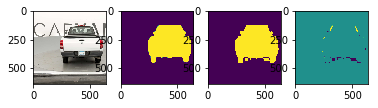

944it [14:45,  1.04it/s]

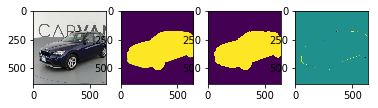

945it [14:46,  1.07it/s]

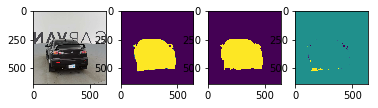

946it [14:47,  1.05it/s]

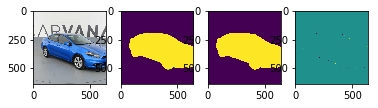

947it [14:48,  1.08it/s]

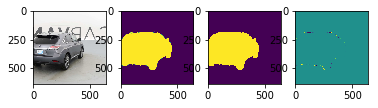

948it [14:49,  1.10it/s]

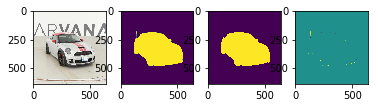

949it [14:50,  1.10it/s]

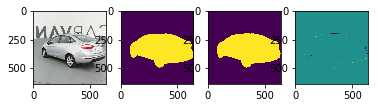

950it [14:51,  1.06it/s]

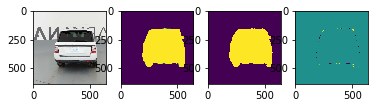

951it [14:51,  1.07it/s]

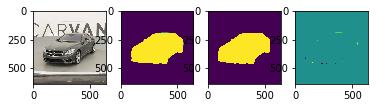

952it [14:52,  1.06it/s]

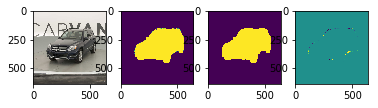

953it [14:53,  1.08it/s]

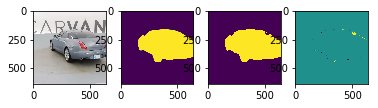

954it [14:54,  1.04it/s]

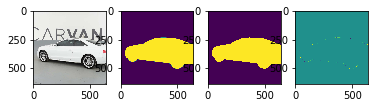

955it [14:55,  1.06it/s]

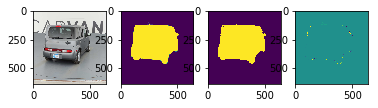

956it [14:56,  1.08it/s]

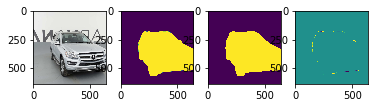

957it [14:57,  1.11it/s]

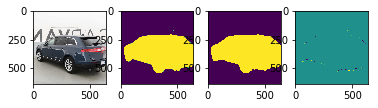

958it [14:58,  1.06it/s]

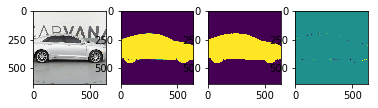

959it [14:59,  1.08it/s]

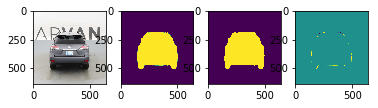

960it [15:00,  1.07it/s]

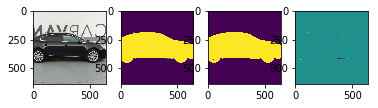

961it [15:01,  1.07it/s]

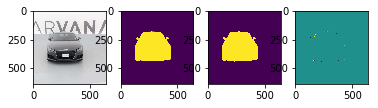

962it [15:02,  1.05it/s]

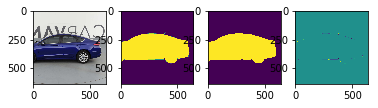

963it [15:03,  1.07it/s]

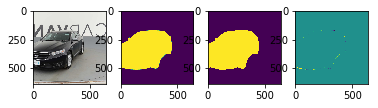

964it [15:04,  1.09it/s]

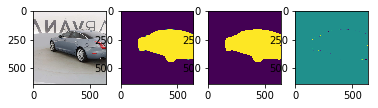

965it [15:04,  1.10it/s]

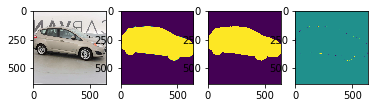

966it [15:06,  1.06it/s]

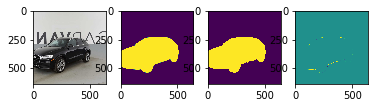

967it [15:06,  1.06it/s]

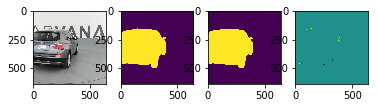

968it [15:07,  1.06it/s]

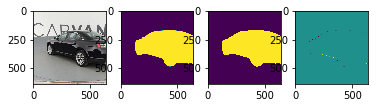

969it [15:08,  1.07it/s]

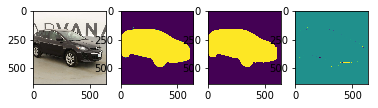

970it [15:09,  1.05it/s]

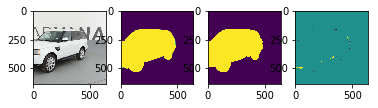

971it [15:10,  1.08it/s]

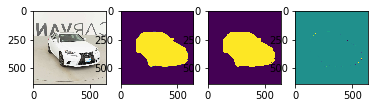

972it [15:11,  1.10it/s]

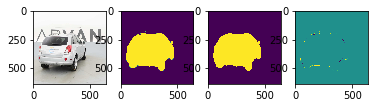

973it [15:12,  1.10it/s]

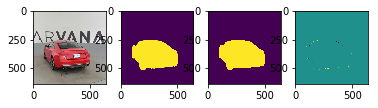

974it [15:13,  1.04it/s]

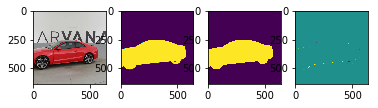

975it [15:14,  1.07it/s]

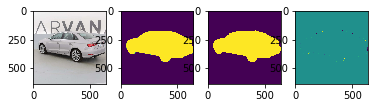

976it [15:15,  1.09it/s]

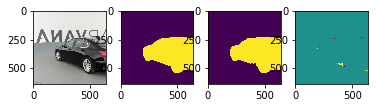

977it [15:16,  1.10it/s]

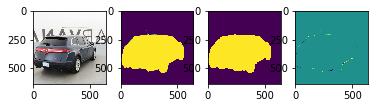

978it [15:17,  1.04it/s]

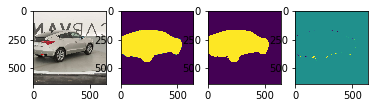

979it [15:18,  1.05it/s]

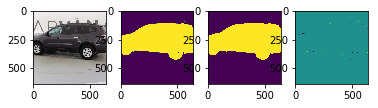

980it [15:19,  1.06it/s]

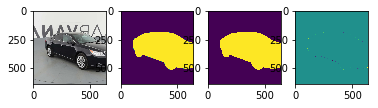

981it [15:19,  1.09it/s]

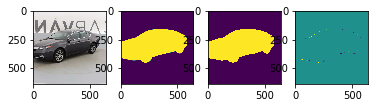

982it [15:20,  1.05it/s]

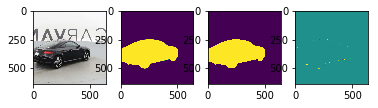

983it [15:21,  1.08it/s]

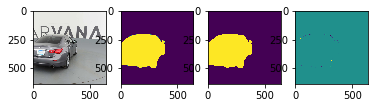

984it [15:22,  1.10it/s]

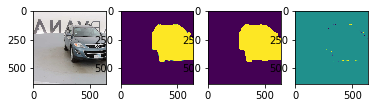

985it [15:23,  1.11it/s]

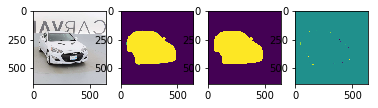

986it [15:24,  1.08it/s]

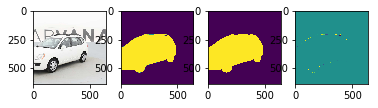

987it [15:25,  1.10it/s]

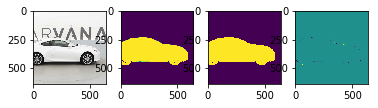

988it [15:26,  1.10it/s]

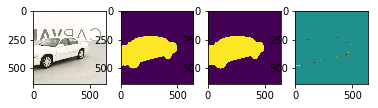

989it [15:27,  1.10it/s]

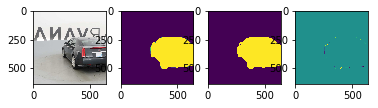

990it [15:28,  1.07it/s]

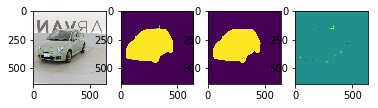

991it [15:29,  1.08it/s]

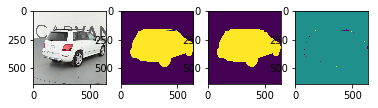

992it [15:30,  1.07it/s]

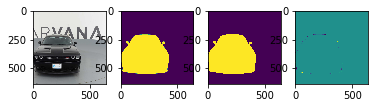

993it [15:31,  1.07it/s]

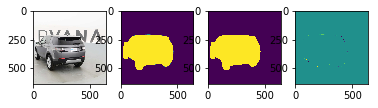

994it [15:32,  1.05it/s]

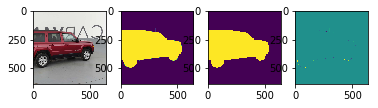

995it [15:33,  1.05it/s]

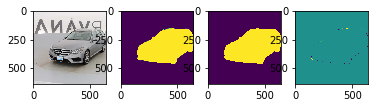

996it [15:33,  1.06it/s]

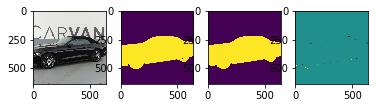

997it [15:34,  1.06it/s]

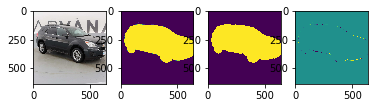

998it [15:35,  1.04it/s]

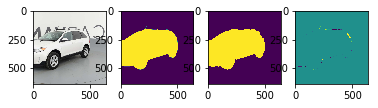

999it [15:36,  1.07it/s]

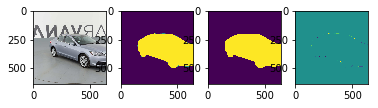

1000it [15:37,  1.08it/s]

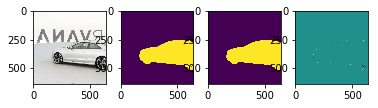

1001it [15:38,  1.10it/s]

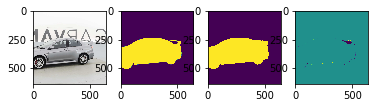

1002it [15:39,  1.07it/s]

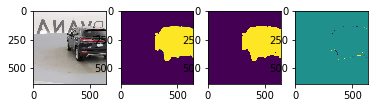

1003it [15:40,  1.06it/s]

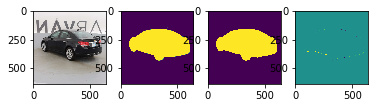

1004it [15:41,  1.05it/s]

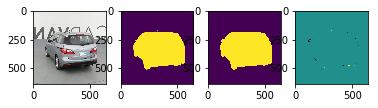

1005it [15:42,  1.05it/s]

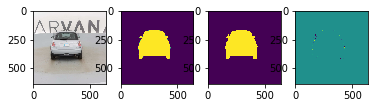

1006it [15:43,  1.02it/s]

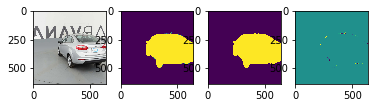

1007it [15:44,  1.05it/s]

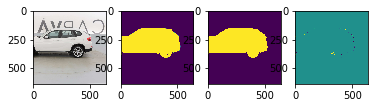

1008it [15:45,  1.06it/s]

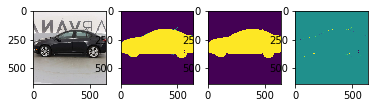

1009it [15:46,  1.08it/s]

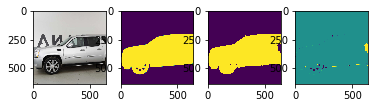

1010it [15:47,  1.02it/s]

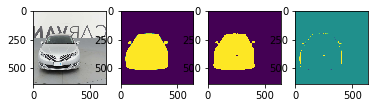

1011it [15:48,  1.06it/s]

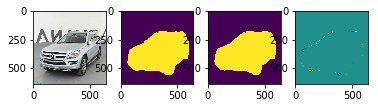

1012it [15:49,  1.06it/s]

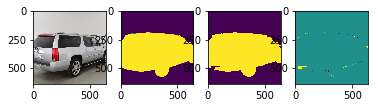

1013it [15:50,  1.05it/s]

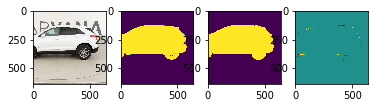

1014it [15:51,  1.02it/s]

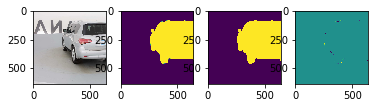

1015it [15:52,  1.03it/s]

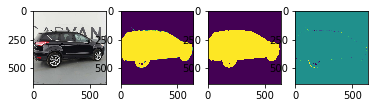

1016it [15:52,  1.03it/s]

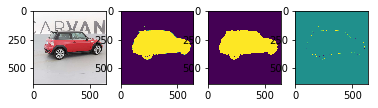

1017it [15:53,  1.03it/s]

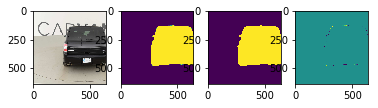

1018it [15:54,  1.02it/s]


In [79]:
# Calculate the dice coefficient on the validation set. The mask is smaller than the image.
def val_dice_coef(model, images, masks, 
                  pad_width, image_size, input_size, output_size):
    dices = []
    masks_pred = []
    for image, mask in tqdm(zip(images, masks)):
        mask_pred = model.predict(image[None,:,:,:])
        mask_pred = mask_pred[0,:,:,:]
        dice = cal_dice_coef(mask, mask_pred)
        dices.append(dice)
        masks_pred.append([image, mask, mask_pred])
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred[:,:,0], mask[:,:,0]-mask_pred[:,:,0])
    dices = np.array(dices)
    return dices, mask_pred
mean, mask_pred = val_dice_coef(model, val_images, val_masks, 
                                     0, image_size, input_dims, output_dims)

In [81]:
dices = mean

In [82]:
sort_by_most_error = sorted(range(dices.size), key=lambda k: dices[k])

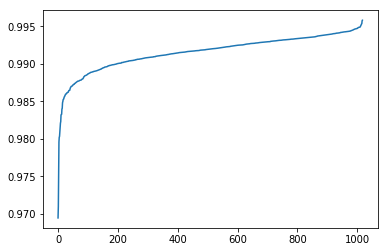

In [86]:
sorted_dices = sorted(dices)
plt.figure()
plt.plot(sorted_dices)
plt.show()

Dice coef for the image is 0.9824520523391289.


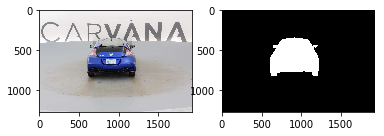

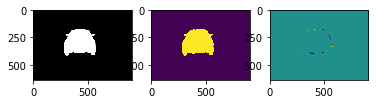

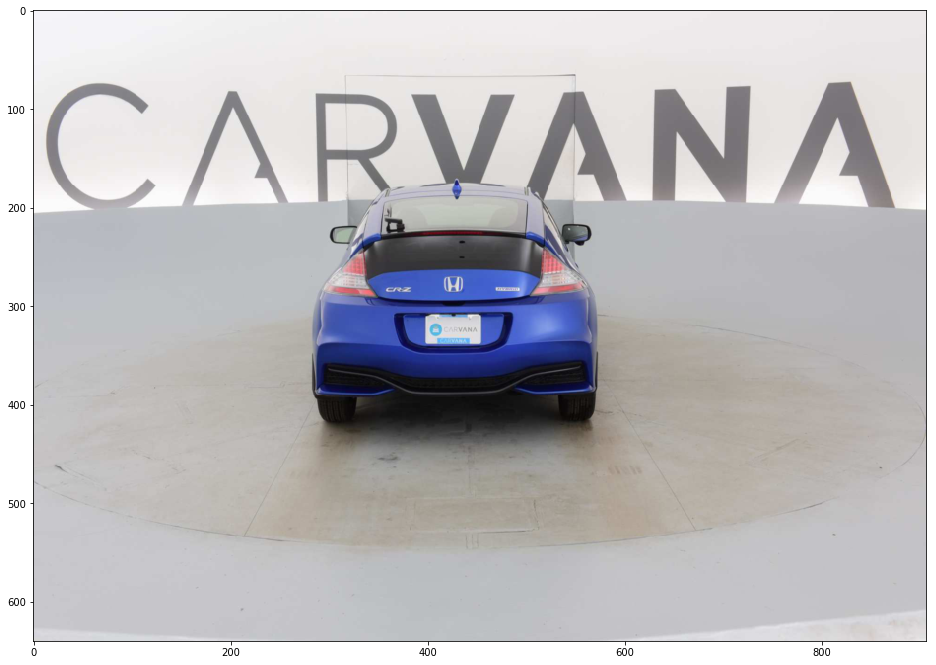

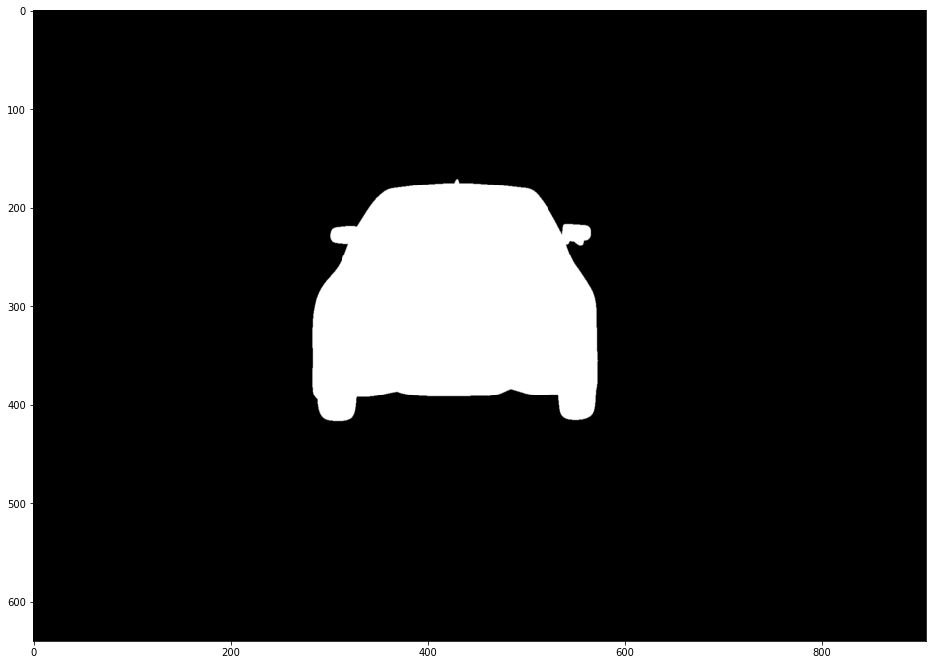

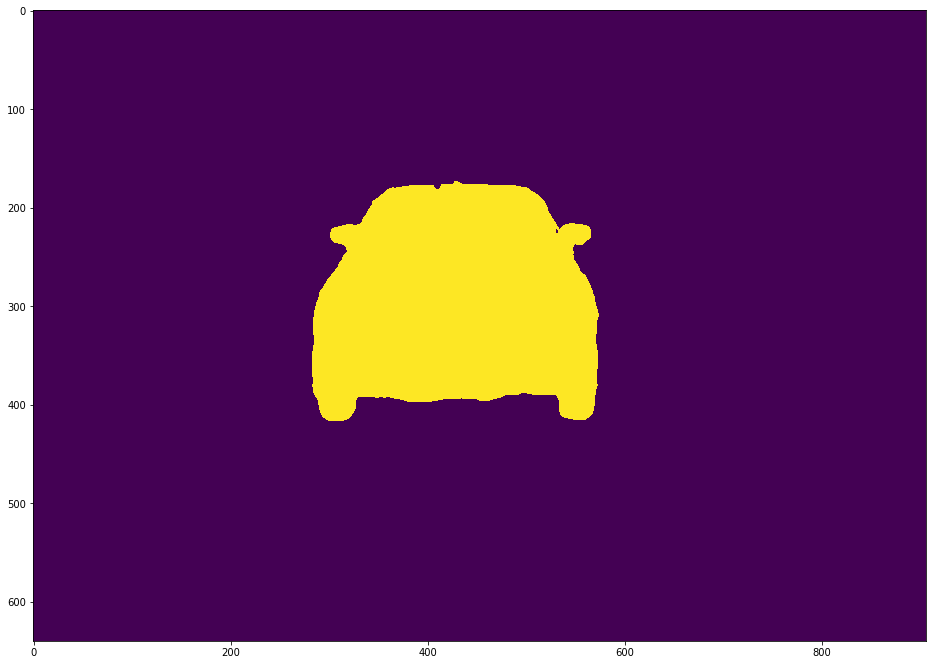

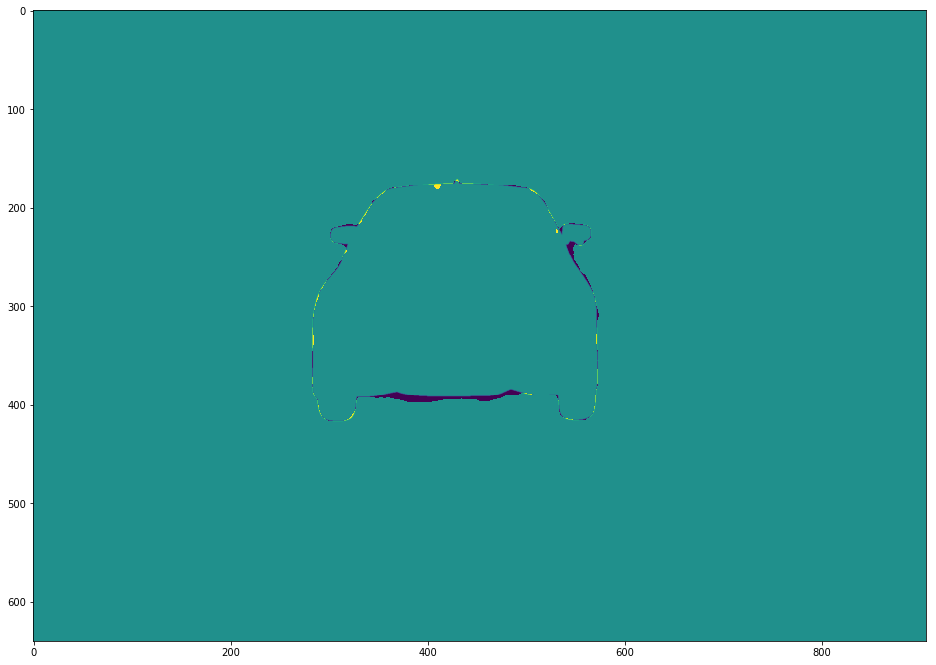

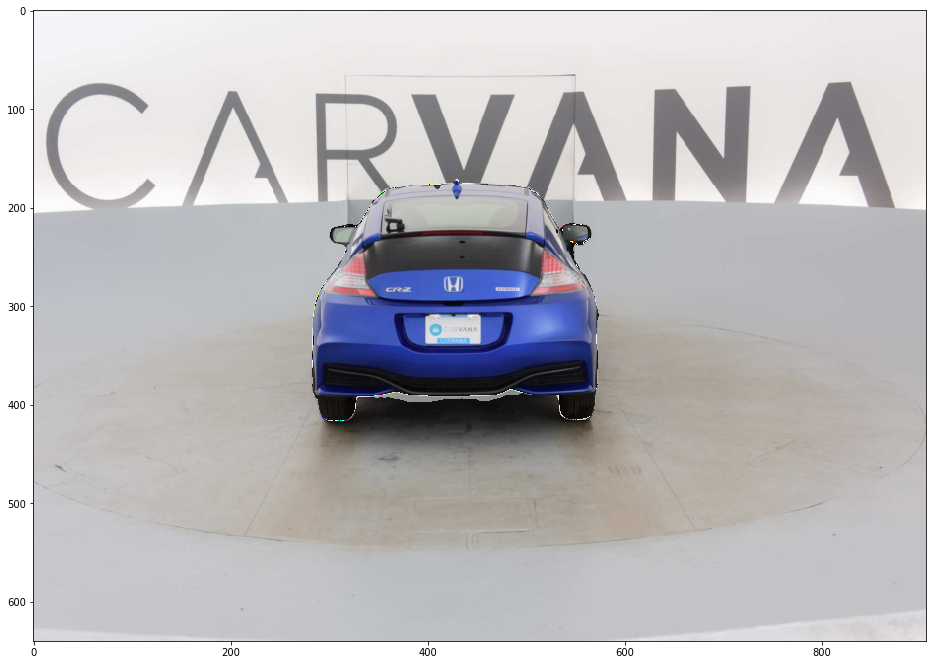

In [107]:
image_, mask_ = read_image_and_mask(data_dir, mask_dir, 
                                    validation_images[sort_by_most_error[9]])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

mask_pred_ = predict_on_patch(model, image_, 0, 'edge',image_size, input_dims, output_dims)
dice_ = cal_dice_coef(mask_, mask_pred_)
print ('Dice coef for the image is {}.'.format(dice_))
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

plt.figure(figsize=(16, 12))
plt.imshow(image_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_pred_)
plt.show()
differences_ = mask_[:,:,0] / 255. - mask_pred_
plt.figure(figsize=(16, 12))
plt.imshow(differences_)
plt.show()

masked_image_ = image_ / 255. + (differences_[:,:,None]) / 2
plt.figure(figsize=(16, 12))
plt.imshow(image_)
plt.imshow(masked_image_)
plt.show()
# Yellow: indicate fasle negtive, should be mask but fail to detect
# Purper: indicate fasle positve, is not car but labeled as car

#0 black region in the bottom of car
#1 same as 0
#2 logo and black region in white make the network fall to classify it as car
#3 black region under the car and the rear wings
#4 hole in the tire, some area inside the car was left unlabeled
#5 black region under the car
#6 white car cannot be distinguished from the white floor
#7 dark area near rear wheel and the hole in the rear wing
#8 Side of the car near the door and where showdow in the background confused the net

In [ ]:
# Dice coefficient 0.99404688814624165
# When training, the validation 
# It seems if the hole cannot be predicted properly. Try to put more weight on hole
# The outer egde is also not so correct.
# Some area are dark, which make it hard to predict
# Can try input dropout
# Boundry --> input dropout
# Hole --> weighted loss


  0%|          | 0/1018 [00:00<?, ?it/s]

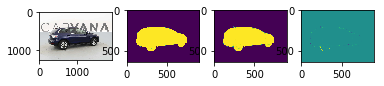


  0%|          | 1/1018 [00:02<45:56,  2.71s/it]

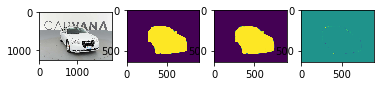


  0%|          | 2/1018 [00:05<45:57,  2.71s/it]


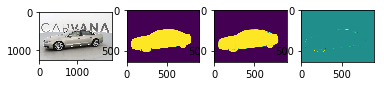

  0%|          | 3/1018 [00:08<45:59,  2.72s/it]

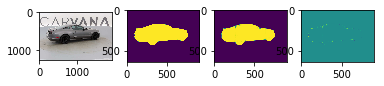

  0%|          | 4/1018 [00:10<45:43,  2.71s/it]

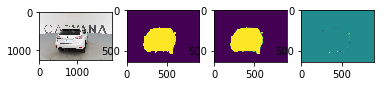

  0%|          | 5/1018 [00:13<46:27,  2.75s/it]

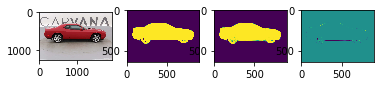

  1%|          | 6/1018 [00:16<46:01,  2.73s/it]

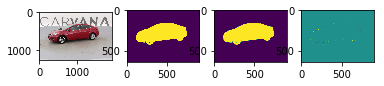

  1%|          | 7/1018 [00:19<45:47,  2.72s/it]

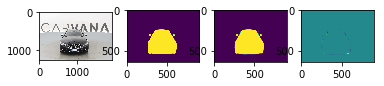

  1%|          | 8/1018 [00:21<45:38,  2.71s/it]

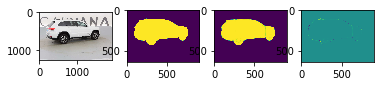

  1%|          | 9/1018 [00:24<46:19,  2.75s/it]

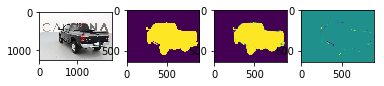

  1%|          | 10/1018 [00:27<46:03,  2.74s/it]

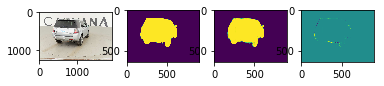

  1%|          | 11/1018 [00:30<46:04,  2.75s/it]

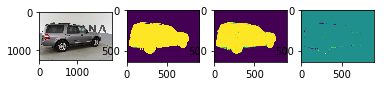

  1%|          | 12/1018 [00:32<45:54,  2.74s/it]

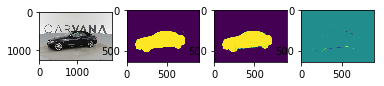

  1%|▏         | 13/1018 [00:35<46:19,  2.77s/it]

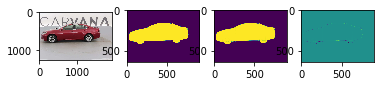

  1%|▏         | 14/1018 [00:38<46:23,  2.77s/it]

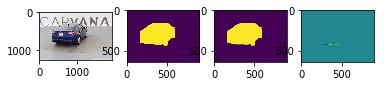

  1%|▏         | 15/1018 [00:41<45:54,  2.75s/it]

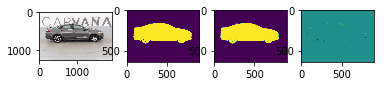

  2%|▏         | 16/1018 [00:43<45:53,  2.75s/it]

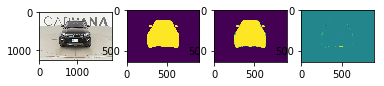

  2%|▏         | 17/1018 [00:46<45:38,  2.74s/it]

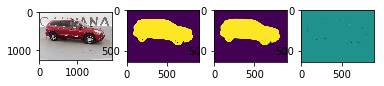

  2%|▏         | 18/1018 [00:49<45:57,  2.76s/it]

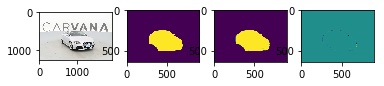

  2%|▏         | 19/1018 [00:52<45:30,  2.73s/it]

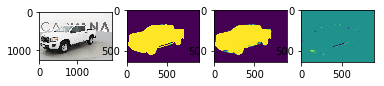

  2%|▏         | 20/1018 [00:54<45:30,  2.74s/it]

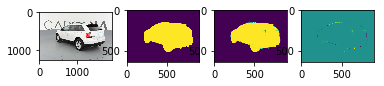

  2%|▏         | 21/1018 [00:57<45:23,  2.73s/it]

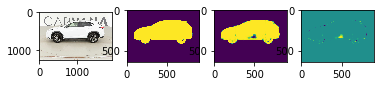

  2%|▏         | 22/1018 [01:00<46:13,  2.78s/it]

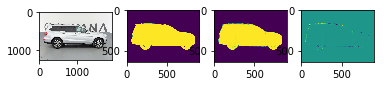

  2%|▏         | 23/1018 [01:03<46:12,  2.79s/it]

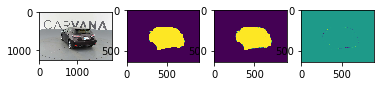

  2%|▏         | 24/1018 [01:05<45:43,  2.76s/it]

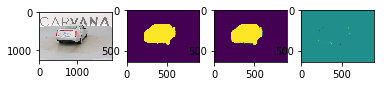

  2%|▏         | 25/1018 [01:08<45:11,  2.73s/it]

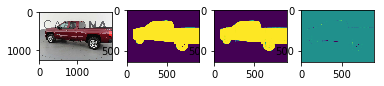

  3%|▎         | 26/1018 [01:11<45:58,  2.78s/it]

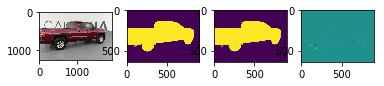

  3%|▎         | 27/1018 [01:14<45:36,  2.76s/it]

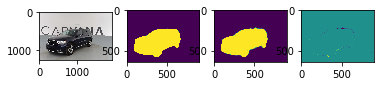

  3%|▎         | 28/1018 [01:16<45:43,  2.77s/it]

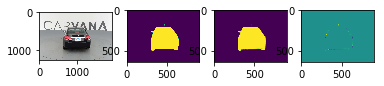

  3%|▎         | 29/1018 [01:19<45:25,  2.76s/it]

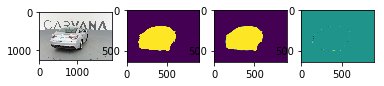

  3%|▎         | 30/1018 [01:22<45:06,  2.74s/it]

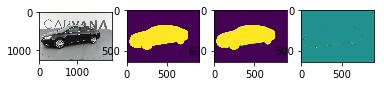

  3%|▎         | 31/1018 [01:25<45:36,  2.77s/it]

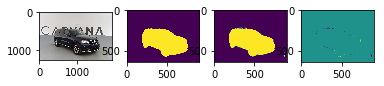

  3%|▎         | 32/1018 [01:27<45:05,  2.74s/it]

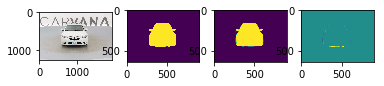

  3%|▎         | 33/1018 [01:30<44:42,  2.72s/it]

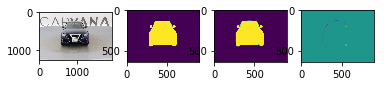

  3%|▎         | 34/1018 [01:33<44:44,  2.73s/it]

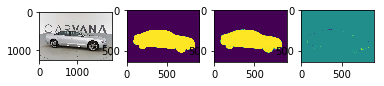

  3%|▎         | 35/1018 [01:36<45:03,  2.75s/it]

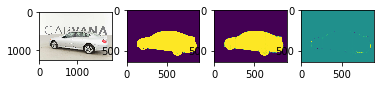

  4%|▎         | 36/1018 [01:38<44:43,  2.73s/it]

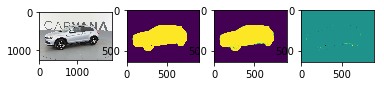

  4%|▎         | 37/1018 [01:41<44:48,  2.74s/it]

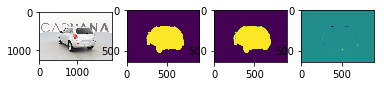

  4%|▎         | 38/1018 [01:44<44:28,  2.72s/it]

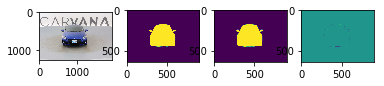

  4%|▍         | 39/1018 [01:47<44:50,  2.75s/it]

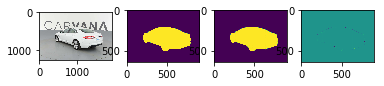

  4%|▍         | 40/1018 [01:49<44:45,  2.75s/it]

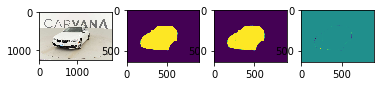

  4%|▍         | 41/1018 [01:52<44:46,  2.75s/it]

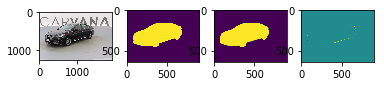

  4%|▍         | 42/1018 [01:55<44:26,  2.73s/it]

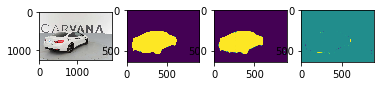

  4%|▍         | 43/1018 [01:57<44:17,  2.73s/it]

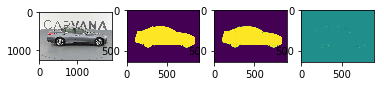

  4%|▍         | 44/1018 [02:00<44:55,  2.77s/it]

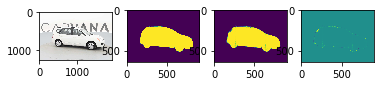

  4%|▍         | 45/1018 [02:03<45:02,  2.78s/it]

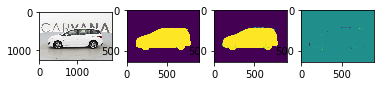

  5%|▍         | 46/1018 [02:06<44:43,  2.76s/it]

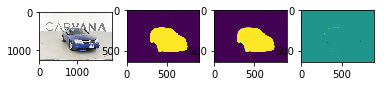

  5%|▍         | 47/1018 [02:09<44:28,  2.75s/it]

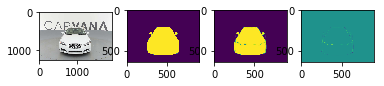

  5%|▍         | 48/1018 [02:11<44:45,  2.77s/it]

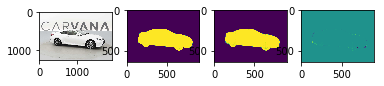

  5%|▍         | 49/1018 [02:14<44:47,  2.77s/it]

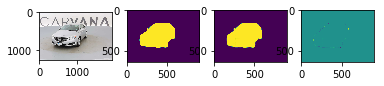

  5%|▍         | 50/1018 [02:17<44:18,  2.75s/it]

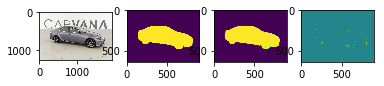

  5%|▌         | 51/1018 [02:20<43:56,  2.73s/it]

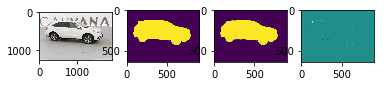

  5%|▌         | 52/1018 [02:22<44:19,  2.75s/it]

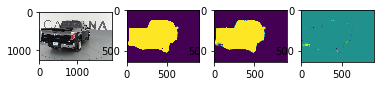

  5%|▌         | 53/1018 [02:25<44:22,  2.76s/it]

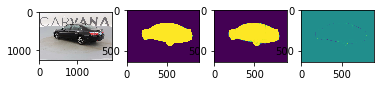

  5%|▌         | 54/1018 [02:28<44:05,  2.74s/it]

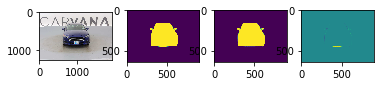

  5%|▌         | 55/1018 [02:31<44:11,  2.75s/it]

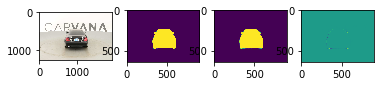

  6%|▌         | 56/1018 [02:33<44:02,  2.75s/it]

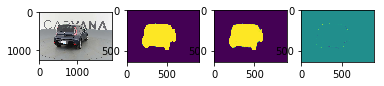

  6%|▌         | 57/1018 [02:36<44:16,  2.76s/it]

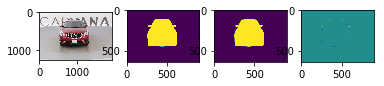

  6%|▌         | 58/1018 [02:39<43:55,  2.74s/it]

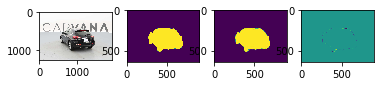

  6%|▌         | 59/1018 [02:42<44:01,  2.75s/it]

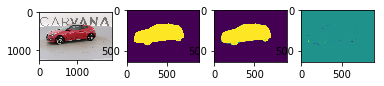

  6%|▌         | 60/1018 [02:44<43:55,  2.75s/it]

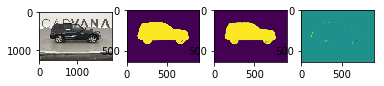

  6%|▌         | 61/1018 [02:47<44:21,  2.78s/it]

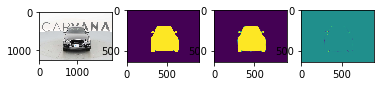

  6%|▌         | 62/1018 [02:50<44:01,  2.76s/it]

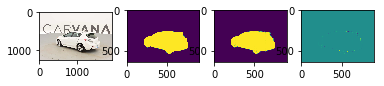

  6%|▌         | 63/1018 [02:53<43:42,  2.75s/it]

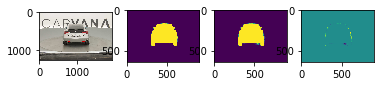

  6%|▋         | 64/1018 [02:55<43:53,  2.76s/it]

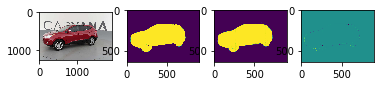

  6%|▋         | 65/1018 [02:58<44:21,  2.79s/it]

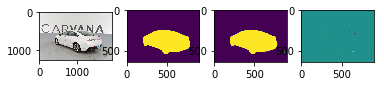

  6%|▋         | 66/1018 [03:01<44:00,  2.77s/it]

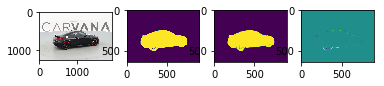

  7%|▋         | 67/1018 [03:04<43:39,  2.75s/it]

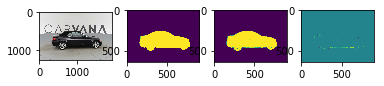

  7%|▋         | 68/1018 [03:06<43:29,  2.75s/it]

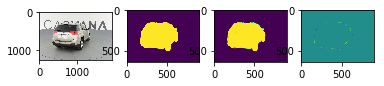

  7%|▋         | 69/1018 [03:09<43:13,  2.73s/it]

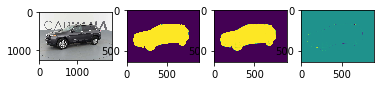

  7%|▋         | 70/1018 [03:12<43:51,  2.78s/it]

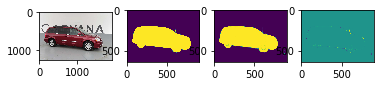

  7%|▋         | 71/1018 [03:15<43:37,  2.76s/it]

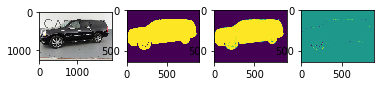

  7%|▋         | 72/1018 [03:18<43:34,  2.76s/it]

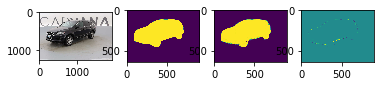

  7%|▋         | 73/1018 [03:20<43:40,  2.77s/it]

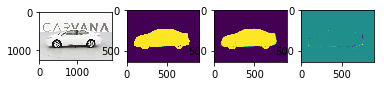

  7%|▋         | 74/1018 [03:23<43:46,  2.78s/it]

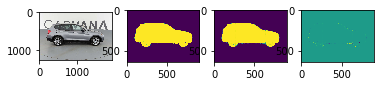

  7%|▋         | 75/1018 [03:26<43:44,  2.78s/it]

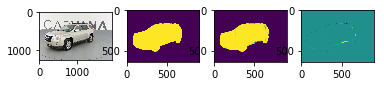

  7%|▋         | 76/1018 [03:29<43:42,  2.78s/it]

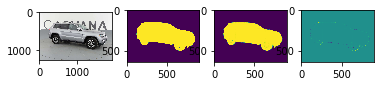

  8%|▊         | 77/1018 [03:32<43:40,  2.78s/it]

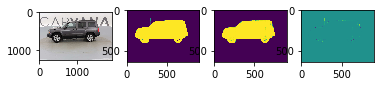

  8%|▊         | 78/1018 [03:34<44:10,  2.82s/it]

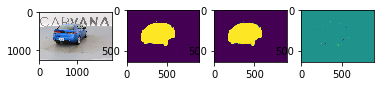

  8%|▊         | 79/1018 [03:37<43:40,  2.79s/it]

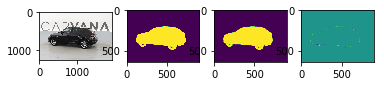

  8%|▊         | 80/1018 [03:40<43:26,  2.78s/it]

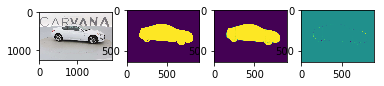

  8%|▊         | 81/1018 [03:43<43:06,  2.76s/it]

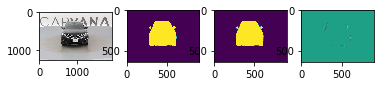

  8%|▊         | 82/1018 [03:45<42:49,  2.75s/it]

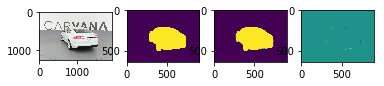

  8%|▊         | 83/1018 [03:48<43:12,  2.77s/it]

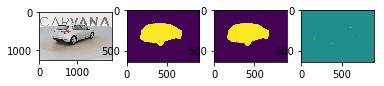

  8%|▊         | 84/1018 [03:51<43:08,  2.77s/it]

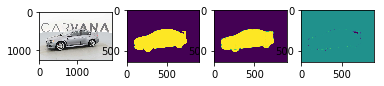

  8%|▊         | 85/1018 [03:54<43:10,  2.78s/it]

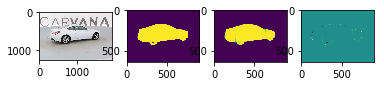

  8%|▊         | 86/1018 [03:57<43:07,  2.78s/it]

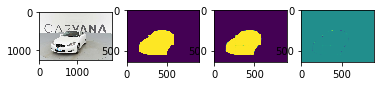

  9%|▊         | 87/1018 [03:59<43:22,  2.80s/it]

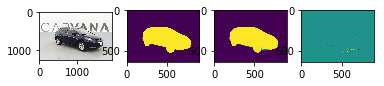

  9%|▊         | 88/1018 [04:02<42:51,  2.76s/it]

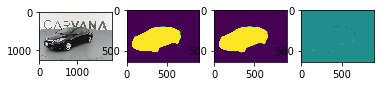

  9%|▊         | 89/1018 [04:05<42:54,  2.77s/it]

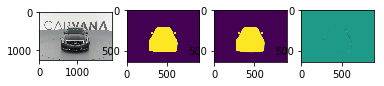

  9%|▉         | 90/1018 [04:08<42:36,  2.75s/it]

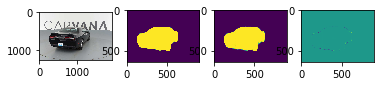

  9%|▉         | 91/1018 [04:10<42:59,  2.78s/it]

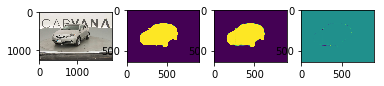

  9%|▉         | 92/1018 [04:13<42:39,  2.76s/it]

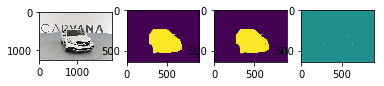

  9%|▉         | 93/1018 [04:16<42:25,  2.75s/it]

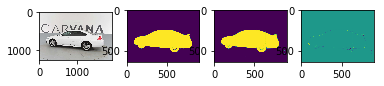

  9%|▉         | 94/1018 [04:19<42:12,  2.74s/it]

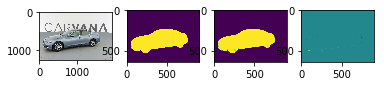

  9%|▉         | 95/1018 [04:21<42:13,  2.75s/it]

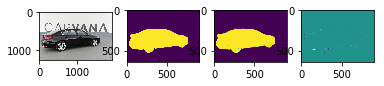

  9%|▉         | 96/1018 [04:24<42:30,  2.77s/it]

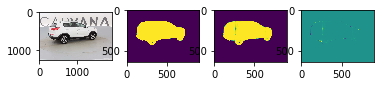

 10%|▉         | 97/1018 [04:27<42:30,  2.77s/it]

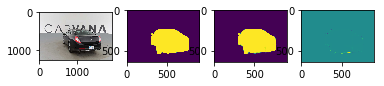

 10%|▉         | 98/1018 [04:30<42:34,  2.78s/it]

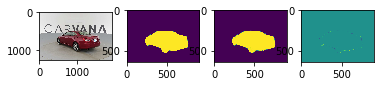

 10%|▉         | 99/1018 [04:32<42:27,  2.77s/it]

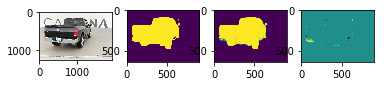

 10%|▉         | 100/1018 [04:35<42:45,  2.79s/it]

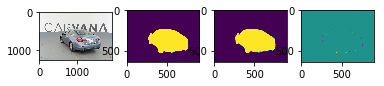

 10%|▉         | 101/1018 [04:38<42:17,  2.77s/it]

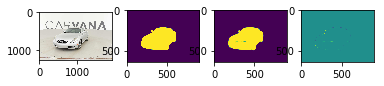

 10%|█         | 102/1018 [04:41<42:14,  2.77s/it]

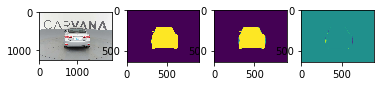

 10%|█         | 103/1018 [04:44<42:13,  2.77s/it]

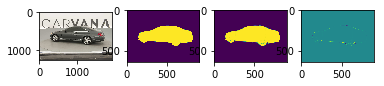

 10%|█         | 104/1018 [04:46<42:40,  2.80s/it]

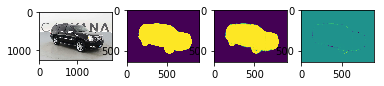

 10%|█         | 105/1018 [04:49<42:24,  2.79s/it]

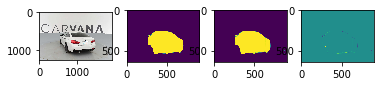

 10%|█         | 106/1018 [04:52<42:08,  2.77s/it]

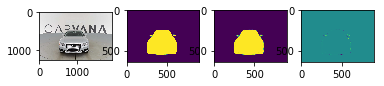

 11%|█         | 107/1018 [04:55<42:06,  2.77s/it]

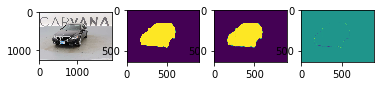

 11%|█         | 108/1018 [04:57<41:48,  2.76s/it]

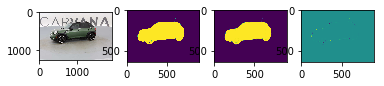

 11%|█         | 109/1018 [05:00<41:53,  2.77s/it]

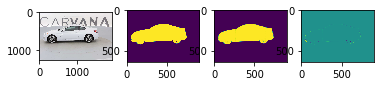

 11%|█         | 110/1018 [05:03<41:40,  2.75s/it]

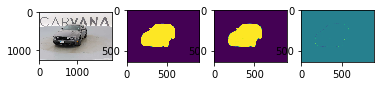

 11%|█         | 111/1018 [05:06<41:39,  2.76s/it]

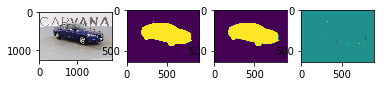

 11%|█         | 112/1018 [05:08<41:27,  2.75s/it]

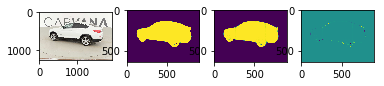

 11%|█         | 113/1018 [05:11<41:43,  2.77s/it]

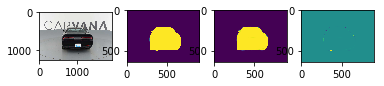

 11%|█         | 114/1018 [05:14<41:24,  2.75s/it]

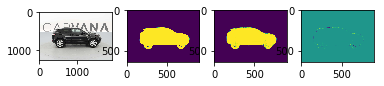

 11%|█▏        | 115/1018 [05:17<41:29,  2.76s/it]

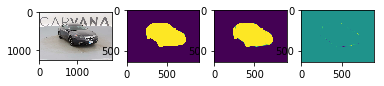

 11%|█▏        | 116/1018 [05:19<41:34,  2.77s/it]

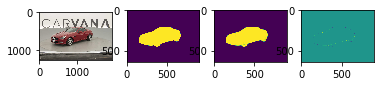

 11%|█▏        | 117/1018 [05:22<41:48,  2.78s/it]

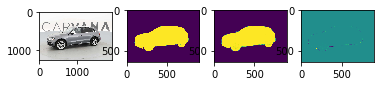

 12%|█▏        | 118/1018 [05:25<41:25,  2.76s/it]

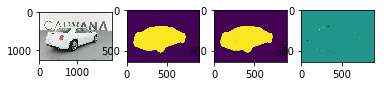

 12%|█▏        | 119/1018 [05:28<41:11,  2.75s/it]

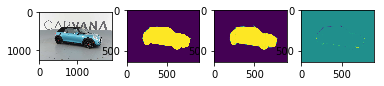

 12%|█▏        | 120/1018 [05:30<41:10,  2.75s/it]

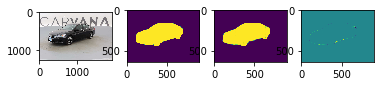

 12%|█▏        | 121/1018 [05:33<41:04,  2.75s/it]

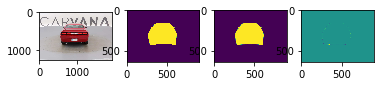

 12%|█▏        | 122/1018 [05:36<41:13,  2.76s/it]

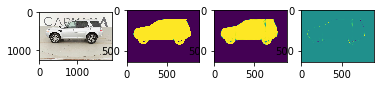

 12%|█▏        | 123/1018 [05:39<40:46,  2.73s/it]

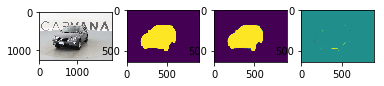

 12%|█▏        | 124/1018 [05:41<40:33,  2.72s/it]

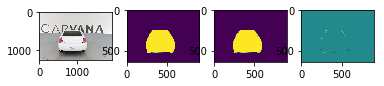

 12%|█▏        | 125/1018 [05:44<40:19,  2.71s/it]

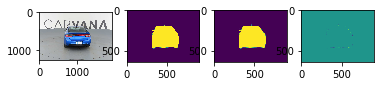

 12%|█▏        | 126/1018 [05:47<40:46,  2.74s/it]

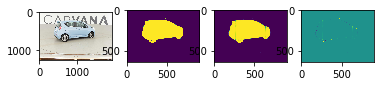

 12%|█▏        | 127/1018 [05:50<40:30,  2.73s/it]

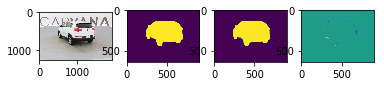

 13%|█▎        | 128/1018 [05:52<40:39,  2.74s/it]

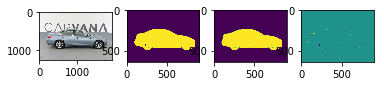

 13%|█▎        | 129/1018 [05:55<40:35,  2.74s/it]

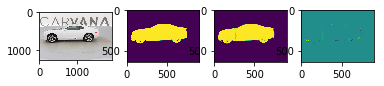

 13%|█▎        | 130/1018 [05:58<41:07,  2.78s/it]

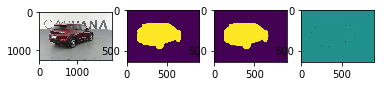

 13%|█▎        | 131/1018 [06:01<41:05,  2.78s/it]

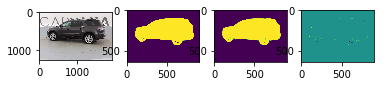

 13%|█▎        | 132/1018 [06:03<40:47,  2.76s/it]

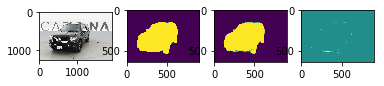

 13%|█▎        | 133/1018 [06:06<40:22,  2.74s/it]

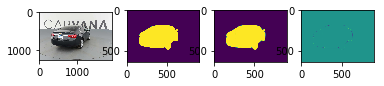

 13%|█▎        | 134/1018 [06:09<40:07,  2.72s/it]

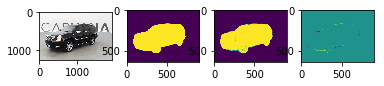

 13%|█▎        | 135/1018 [06:12<40:19,  2.74s/it]

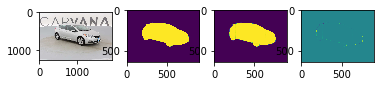

 13%|█▎        | 136/1018 [06:14<40:21,  2.75s/it]

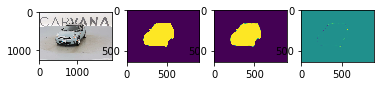

 13%|█▎        | 137/1018 [06:17<39:59,  2.72s/it]

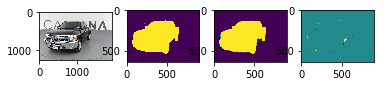

 14%|█▎        | 138/1018 [06:20<40:00,  2.73s/it]

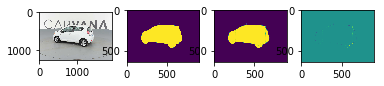

 14%|█▎        | 139/1018 [06:23<40:19,  2.75s/it]

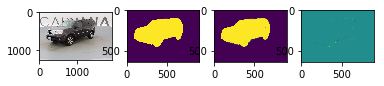

 14%|█▍        | 140/1018 [06:25<40:13,  2.75s/it]

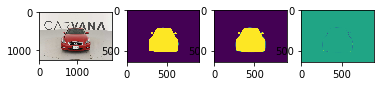

 14%|█▍        | 141/1018 [06:28<40:02,  2.74s/it]

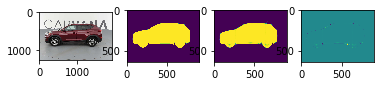

 14%|█▍        | 142/1018 [06:31<40:04,  2.74s/it]

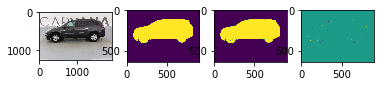

 14%|█▍        | 143/1018 [06:34<40:15,  2.76s/it]

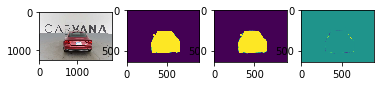

 14%|█▍        | 144/1018 [06:36<40:04,  2.75s/it]

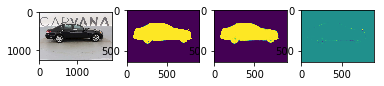

 14%|█▍        | 145/1018 [06:39<39:48,  2.74s/it]

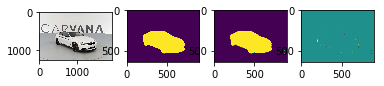

 14%|█▍        | 146/1018 [06:42<39:56,  2.75s/it]

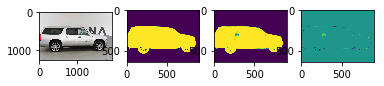

 14%|█▍        | 147/1018 [06:45<39:45,  2.74s/it]

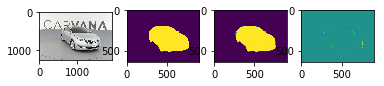

 15%|█▍        | 148/1018 [06:47<40:03,  2.76s/it]

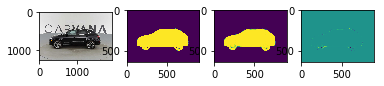

 15%|█▍        | 149/1018 [06:50<39:49,  2.75s/it]

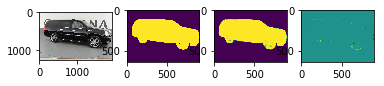

 15%|█▍        | 150/1018 [06:53<39:40,  2.74s/it]

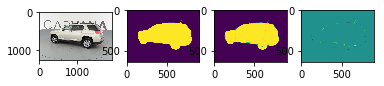

 15%|█▍        | 151/1018 [06:56<39:50,  2.76s/it]

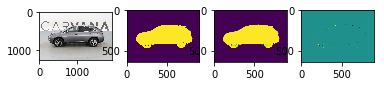

 15%|█▍        | 152/1018 [06:58<40:17,  2.79s/it]

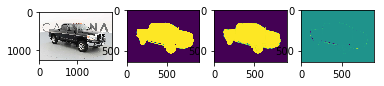

 15%|█▌        | 153/1018 [07:01<39:59,  2.77s/it]

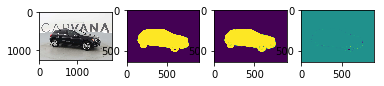

 15%|█▌        | 154/1018 [07:04<39:57,  2.77s/it]

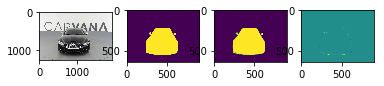

 15%|█▌        | 155/1018 [07:07<39:41,  2.76s/it]

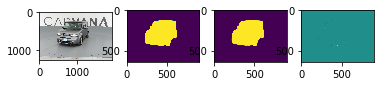

 15%|█▌        | 156/1018 [07:10<39:54,  2.78s/it]

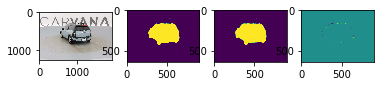

 15%|█▌        | 157/1018 [07:12<39:37,  2.76s/it]

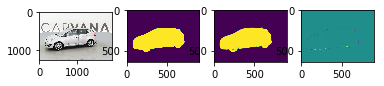

 16%|█▌        | 158/1018 [07:15<39:35,  2.76s/it]

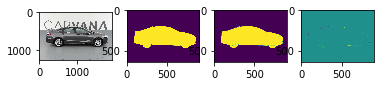

 16%|█▌        | 159/1018 [07:18<39:11,  2.74s/it]

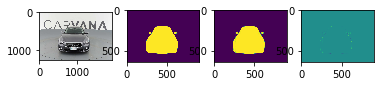

 16%|█▌        | 160/1018 [07:20<39:08,  2.74s/it]

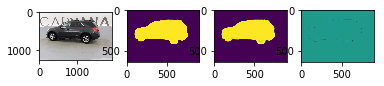

 16%|█▌        | 161/1018 [07:23<39:24,  2.76s/it]

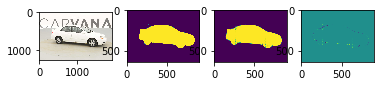

 16%|█▌        | 162/1018 [07:26<39:11,  2.75s/it]

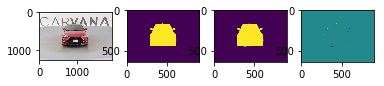

 16%|█▌        | 163/1018 [07:29<39:18,  2.76s/it]

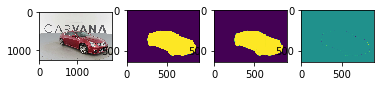

 16%|█▌        | 164/1018 [07:31<39:07,  2.75s/it]

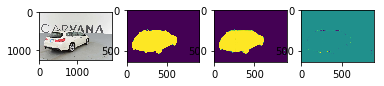

 16%|█▌        | 165/1018 [07:34<39:16,  2.76s/it]

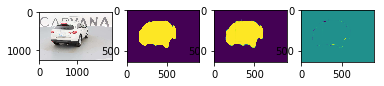

 16%|█▋        | 166/1018 [07:37<39:10,  2.76s/it]

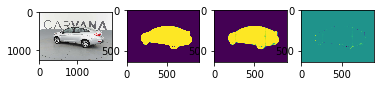

 16%|█▋        | 167/1018 [07:40<39:00,  2.75s/it]

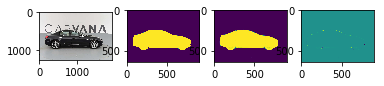

 17%|█▋        | 168/1018 [07:43<39:04,  2.76s/it]

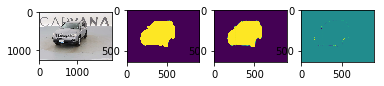

 17%|█▋        | 169/1018 [07:45<39:37,  2.80s/it]

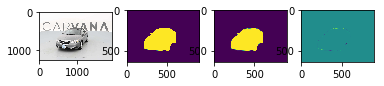

 17%|█▋        | 170/1018 [07:48<39:17,  2.78s/it]

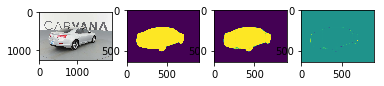

 17%|█▋        | 171/1018 [07:51<39:01,  2.76s/it]

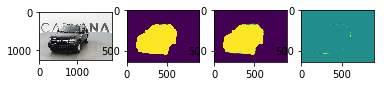

 17%|█▋        | 172/1018 [07:54<39:01,  2.77s/it]

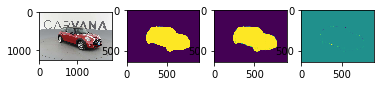

 17%|█▋        | 173/1018 [07:56<38:42,  2.75s/it]

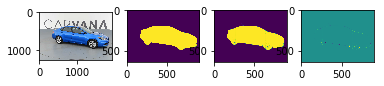

 17%|█▋        | 174/1018 [07:59<38:59,  2.77s/it]

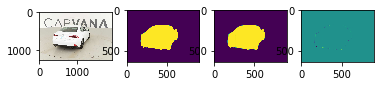

 17%|█▋        | 175/1018 [08:02<38:52,  2.77s/it]

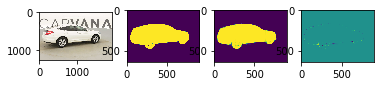

 17%|█▋        | 176/1018 [08:05<38:42,  2.76s/it]

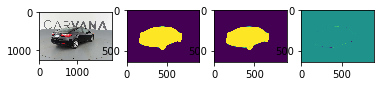

 17%|█▋        | 177/1018 [08:07<38:34,  2.75s/it]

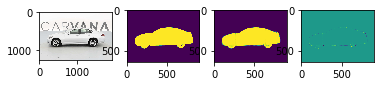

 17%|█▋        | 178/1018 [08:10<38:47,  2.77s/it]

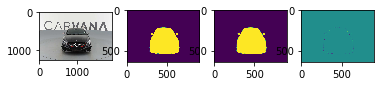

 18%|█▊        | 179/1018 [08:13<38:21,  2.74s/it]

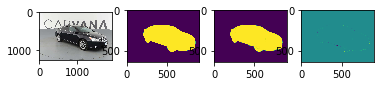

 18%|█▊        | 180/1018 [08:16<38:16,  2.74s/it]

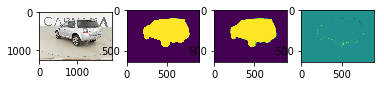

 18%|█▊        | 181/1018 [08:18<37:53,  2.72s/it]

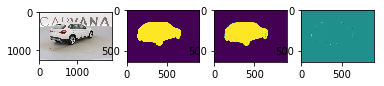

 18%|█▊        | 182/1018 [08:21<38:19,  2.75s/it]

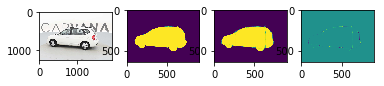

 18%|█▊        | 183/1018 [08:24<37:59,  2.73s/it]

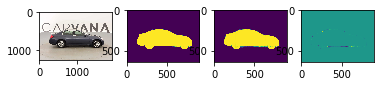

 18%|█▊        | 184/1018 [08:26<37:47,  2.72s/it]

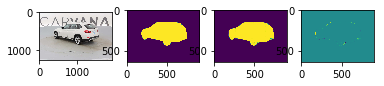

 18%|█▊        | 185/1018 [08:29<37:40,  2.71s/it]

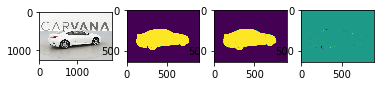

 18%|█▊        | 186/1018 [08:32<37:37,  2.71s/it]

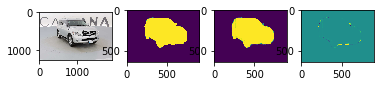

 18%|█▊        | 187/1018 [08:35<38:04,  2.75s/it]

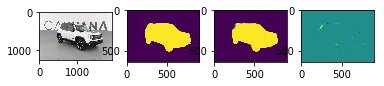

 18%|█▊        | 188/1018 [08:37<38:04,  2.75s/it]

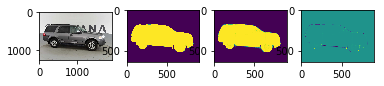

 19%|█▊        | 189/1018 [08:40<38:01,  2.75s/it]

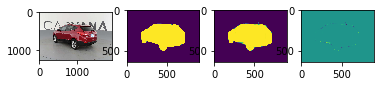

 19%|█▊        | 190/1018 [08:43<38:06,  2.76s/it]

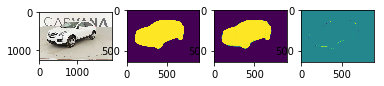

 19%|█▉        | 191/1018 [08:46<38:14,  2.77s/it]

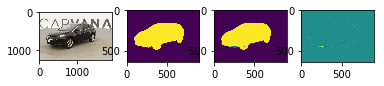

 19%|█▉        | 192/1018 [08:49<38:02,  2.76s/it]

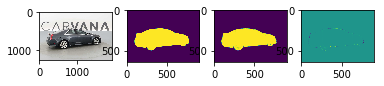

 19%|█▉        | 193/1018 [08:51<37:57,  2.76s/it]

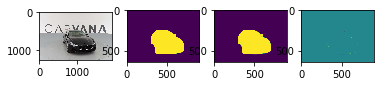

 19%|█▉        | 194/1018 [08:54<38:06,  2.77s/it]

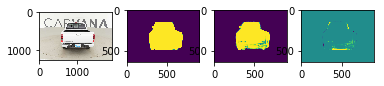

 19%|█▉        | 195/1018 [08:57<38:24,  2.80s/it]

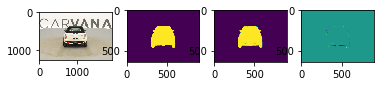

 19%|█▉        | 196/1018 [09:00<37:54,  2.77s/it]

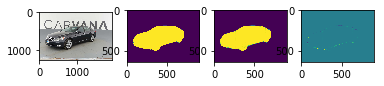

 19%|█▉        | 197/1018 [09:02<37:37,  2.75s/it]

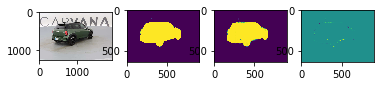

 19%|█▉        | 198/1018 [09:05<37:17,  2.73s/it]

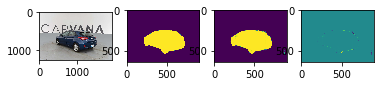

 20%|█▉        | 199/1018 [09:08<37:29,  2.75s/it]

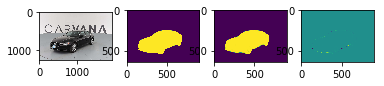

 20%|█▉        | 200/1018 [09:11<38:03,  2.79s/it]

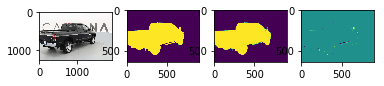

 20%|█▉        | 201/1018 [09:13<37:47,  2.78s/it]

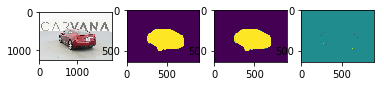

 20%|█▉        | 202/1018 [09:16<37:21,  2.75s/it]

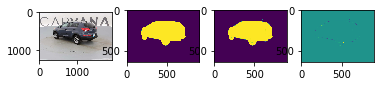

 20%|█▉        | 203/1018 [09:19<37:11,  2.74s/it]

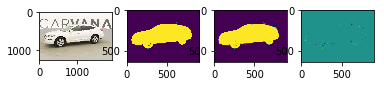

 20%|██        | 204/1018 [09:22<37:43,  2.78s/it]

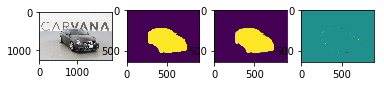

 20%|██        | 205/1018 [09:25<37:38,  2.78s/it]

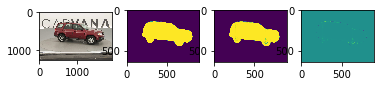

 20%|██        | 206/1018 [09:27<37:12,  2.75s/it]

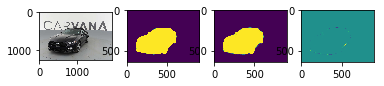

 20%|██        | 207/1018 [09:30<37:17,  2.76s/it]

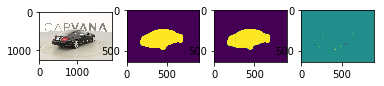

 20%|██        | 208/1018 [09:33<37:49,  2.80s/it]

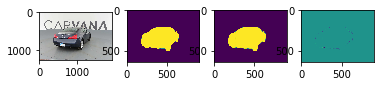

 21%|██        | 209/1018 [09:36<37:33,  2.79s/it]

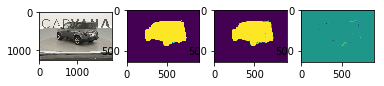

 21%|██        | 210/1018 [09:38<37:34,  2.79s/it]

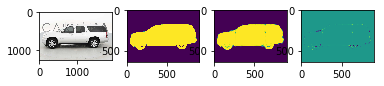

 21%|██        | 211/1018 [09:41<37:09,  2.76s/it]

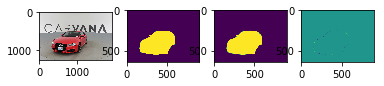

 21%|██        | 212/1018 [09:44<37:14,  2.77s/it]

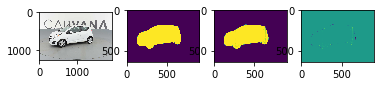

 21%|██        | 213/1018 [09:47<37:22,  2.79s/it]

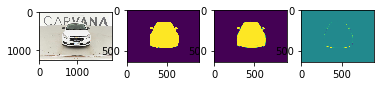

 21%|██        | 214/1018 [09:50<37:06,  2.77s/it]

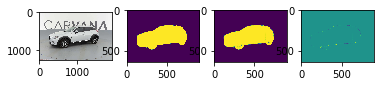

 21%|██        | 215/1018 [09:52<37:05,  2.77s/it]

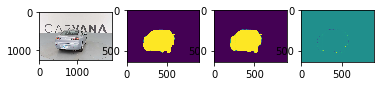

 21%|██        | 216/1018 [09:55<36:45,  2.75s/it]

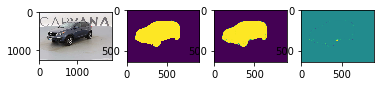

 21%|██▏       | 217/1018 [09:58<37:14,  2.79s/it]

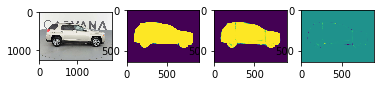

 21%|██▏       | 218/1018 [10:01<37:09,  2.79s/it]

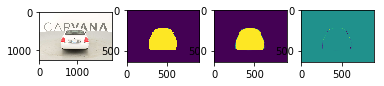

 22%|██▏       | 219/1018 [10:03<37:02,  2.78s/it]

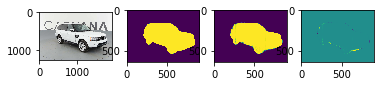

 22%|██▏       | 220/1018 [10:06<36:38,  2.75s/it]

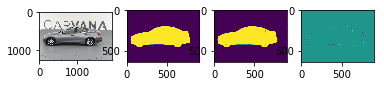

 22%|██▏       | 221/1018 [10:09<36:58,  2.78s/it]

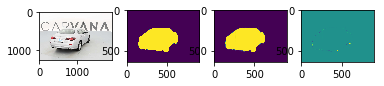

 22%|██▏       | 222/1018 [10:12<36:37,  2.76s/it]

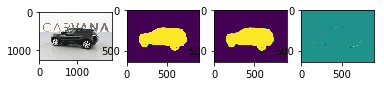

 22%|██▏       | 223/1018 [10:14<36:23,  2.75s/it]

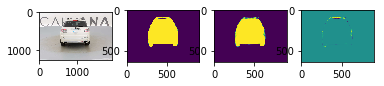

 22%|██▏       | 224/1018 [10:17<36:04,  2.73s/it]

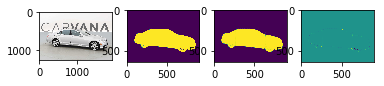

 22%|██▏       | 225/1018 [10:20<36:11,  2.74s/it]

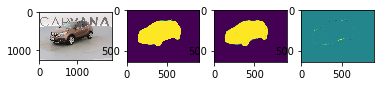

 22%|██▏       | 226/1018 [10:23<36:33,  2.77s/it]

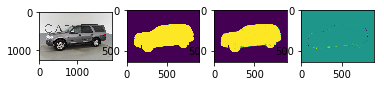

 22%|██▏       | 227/1018 [10:25<36:18,  2.75s/it]

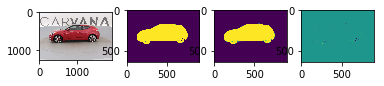

 22%|██▏       | 228/1018 [10:28<35:51,  2.72s/it]

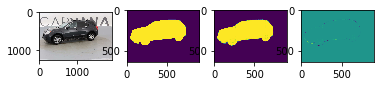

 22%|██▏       | 229/1018 [10:31<36:02,  2.74s/it]

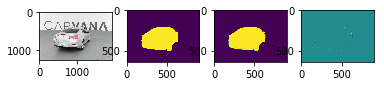

 23%|██▎       | 230/1018 [10:34<36:39,  2.79s/it]

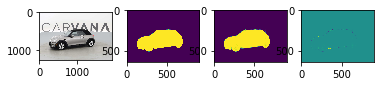

 23%|██▎       | 231/1018 [10:36<36:25,  2.78s/it]

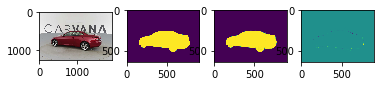

 23%|██▎       | 232/1018 [10:39<36:22,  2.78s/it]

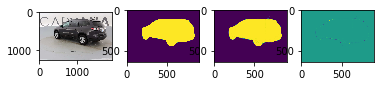

 23%|██▎       | 233/1018 [10:42<36:11,  2.77s/it]

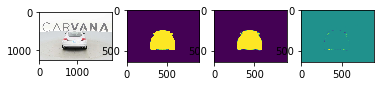

 23%|██▎       | 234/1018 [10:45<36:27,  2.79s/it]

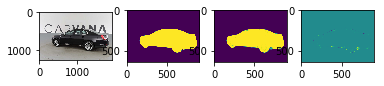

 23%|██▎       | 235/1018 [10:48<36:02,  2.76s/it]

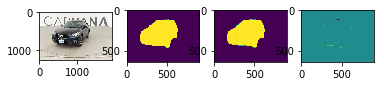

 23%|██▎       | 236/1018 [10:50<36:00,  2.76s/it]

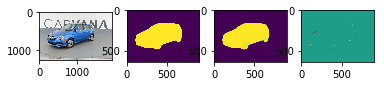

 23%|██▎       | 237/1018 [10:53<35:43,  2.74s/it]

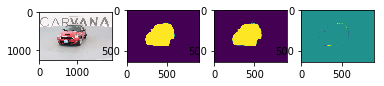

 23%|██▎       | 238/1018 [10:56<35:44,  2.75s/it]

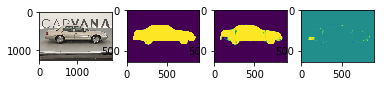

 23%|██▎       | 239/1018 [10:59<36:21,  2.80s/it]

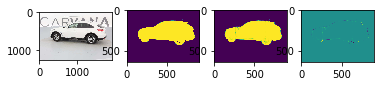

 24%|██▎       | 240/1018 [11:01<36:10,  2.79s/it]

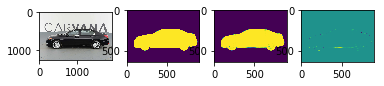

 24%|██▎       | 241/1018 [11:04<35:40,  2.75s/it]

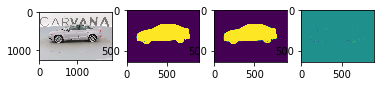

 24%|██▍       | 242/1018 [11:07<35:18,  2.73s/it]

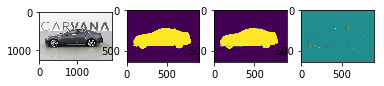

 24%|██▍       | 243/1018 [11:10<35:53,  2.78s/it]

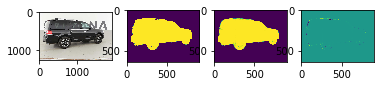

 24%|██▍       | 244/1018 [11:12<35:41,  2.77s/it]

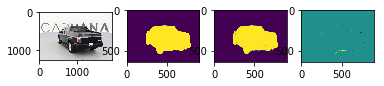

 24%|██▍       | 245/1018 [11:15<35:09,  2.73s/it]

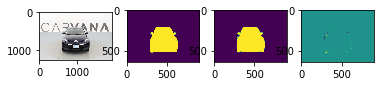

 24%|██▍       | 246/1018 [11:18<35:04,  2.73s/it]

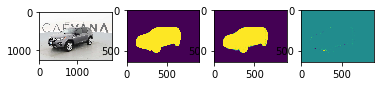

 24%|██▍       | 247/1018 [11:21<35:47,  2.78s/it]

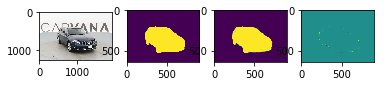

 24%|██▍       | 248/1018 [11:23<35:38,  2.78s/it]

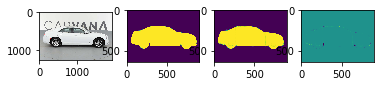

 24%|██▍       | 249/1018 [11:26<35:15,  2.75s/it]

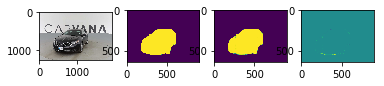

 25%|██▍       | 250/1018 [11:29<35:01,  2.74s/it]

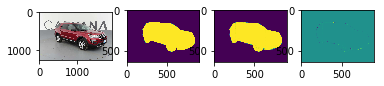

 25%|██▍       | 251/1018 [11:32<34:55,  2.73s/it]

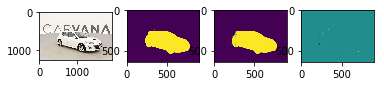

 25%|██▍       | 252/1018 [11:34<35:27,  2.78s/it]

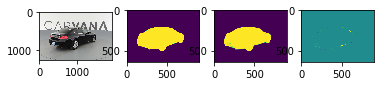

 25%|██▍       | 253/1018 [11:37<35:13,  2.76s/it]

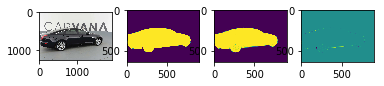

 25%|██▍       | 254/1018 [11:40<35:03,  2.75s/it]

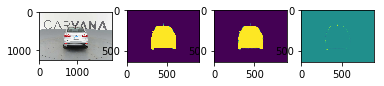

 25%|██▌       | 255/1018 [11:43<34:39,  2.73s/it]

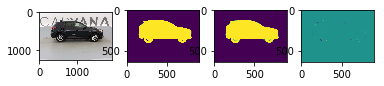

 25%|██▌       | 256/1018 [11:45<34:55,  2.75s/it]

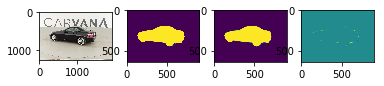

 25%|██▌       | 257/1018 [11:48<34:49,  2.75s/it]

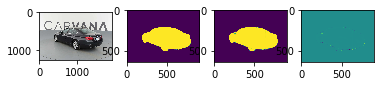

 25%|██▌       | 258/1018 [11:51<34:40,  2.74s/it]

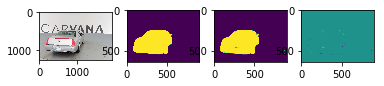

 25%|██▌       | 259/1018 [11:54<34:30,  2.73s/it]

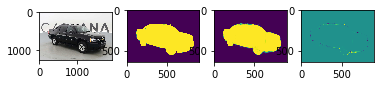

 26%|██▌       | 260/1018 [11:56<35:04,  2.78s/it]

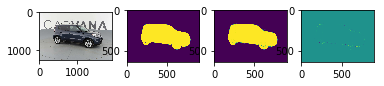

 26%|██▌       | 261/1018 [11:59<34:46,  2.76s/it]

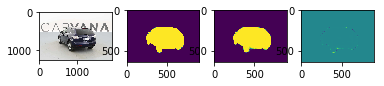

 26%|██▌       | 262/1018 [12:02<34:53,  2.77s/it]

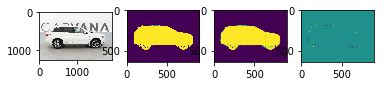

 26%|██▌       | 263/1018 [12:05<34:55,  2.78s/it]

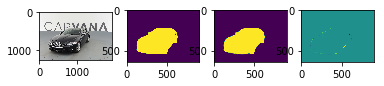

 26%|██▌       | 264/1018 [12:07<34:37,  2.76s/it]

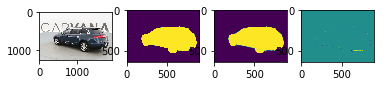

 26%|██▌       | 265/1018 [12:10<35:08,  2.80s/it]

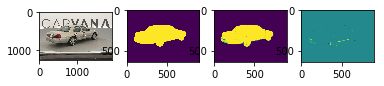

 26%|██▌       | 266/1018 [12:13<34:44,  2.77s/it]

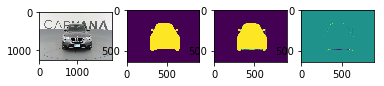

 26%|██▌       | 267/1018 [12:16<34:17,  2.74s/it]

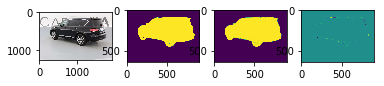

 26%|██▋       | 268/1018 [12:18<33:57,  2.72s/it]

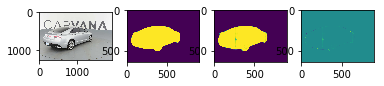

 26%|██▋       | 269/1018 [12:21<34:25,  2.76s/it]

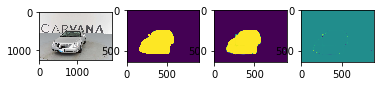

 27%|██▋       | 270/1018 [12:24<34:20,  2.75s/it]

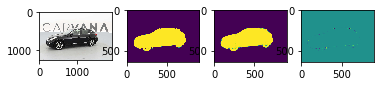

 27%|██▋       | 271/1018 [12:27<33:52,  2.72s/it]

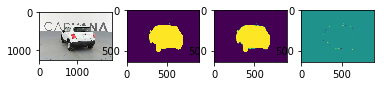

 27%|██▋       | 272/1018 [12:29<33:47,  2.72s/it]

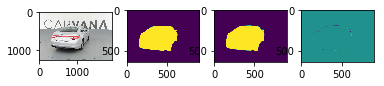

 27%|██▋       | 273/1018 [12:32<34:17,  2.76s/it]

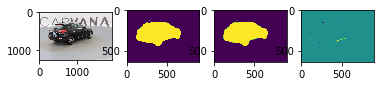

 27%|██▋       | 274/1018 [12:35<34:19,  2.77s/it]

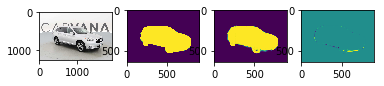

 27%|██▋       | 275/1018 [12:38<34:00,  2.75s/it]

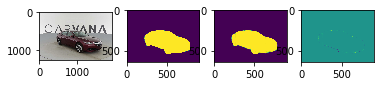

 27%|██▋       | 276/1018 [12:40<33:50,  2.74s/it]

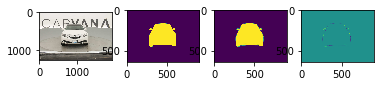

 27%|██▋       | 277/1018 [12:43<33:33,  2.72s/it]

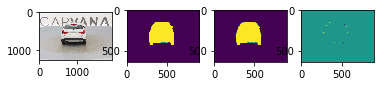

 27%|██▋       | 278/1018 [12:46<33:48,  2.74s/it]

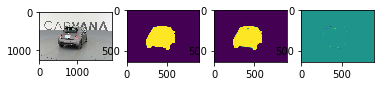

 27%|██▋       | 279/1018 [12:49<33:35,  2.73s/it]

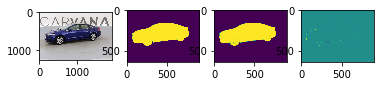

 28%|██▊       | 280/1018 [12:51<33:47,  2.75s/it]

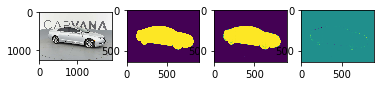

 28%|██▊       | 281/1018 [12:54<33:41,  2.74s/it]

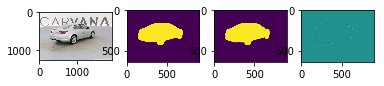

 28%|██▊       | 282/1018 [12:57<33:59,  2.77s/it]

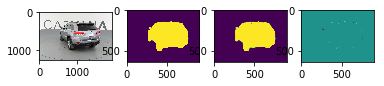

 28%|██▊       | 283/1018 [13:00<33:39,  2.75s/it]

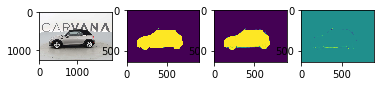

 28%|██▊       | 284/1018 [13:02<33:24,  2.73s/it]

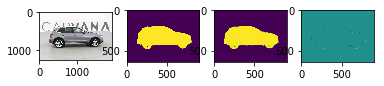

 28%|██▊       | 285/1018 [13:05<33:33,  2.75s/it]

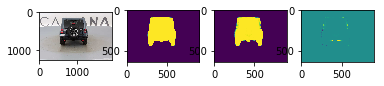

 28%|██▊       | 286/1018 [13:08<33:51,  2.78s/it]

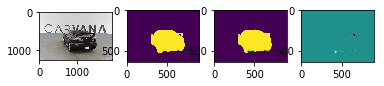

 28%|██▊       | 287/1018 [13:11<33:54,  2.78s/it]

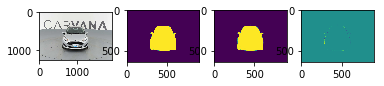

 28%|██▊       | 288/1018 [13:14<33:52,  2.78s/it]

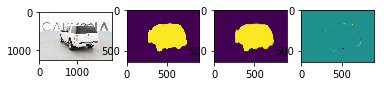

 28%|██▊       | 289/1018 [13:16<33:34,  2.76s/it]

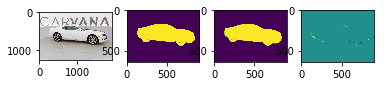

 28%|██▊       | 290/1018 [13:19<33:18,  2.75s/it]

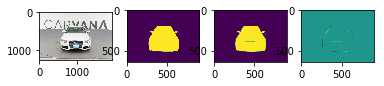

 29%|██▊       | 291/1018 [13:22<33:44,  2.79s/it]

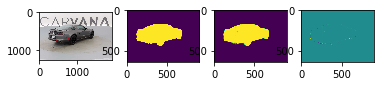

 29%|██▊       | 292/1018 [13:25<33:42,  2.79s/it]

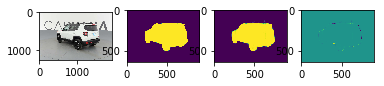

 29%|██▉       | 293/1018 [13:27<33:21,  2.76s/it]

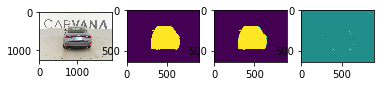

 29%|██▉       | 294/1018 [13:30<33:03,  2.74s/it]

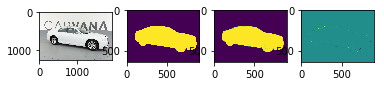

 29%|██▉       | 295/1018 [13:33<33:30,  2.78s/it]

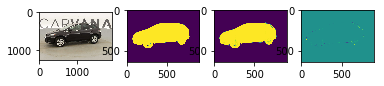

 29%|██▉       | 296/1018 [13:36<33:09,  2.76s/it]

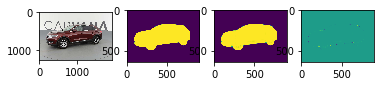

 29%|██▉       | 297/1018 [13:38<32:54,  2.74s/it]

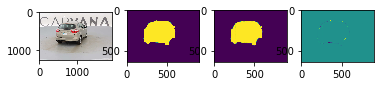

 29%|██▉       | 298/1018 [13:41<32:44,  2.73s/it]

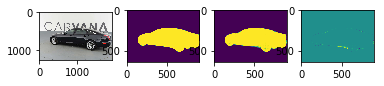

 29%|██▉       | 299/1018 [13:44<33:01,  2.76s/it]

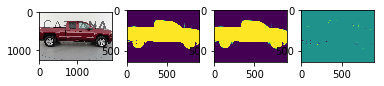

 29%|██▉       | 300/1018 [13:47<32:56,  2.75s/it]

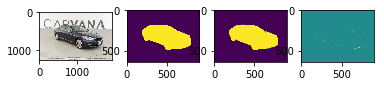

 30%|██▉       | 301/1018 [13:49<32:54,  2.75s/it]

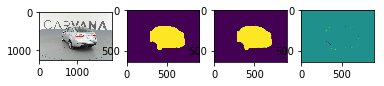

 30%|██▉       | 302/1018 [13:52<32:34,  2.73s/it]

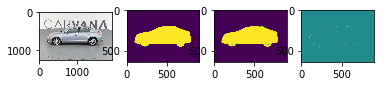

 30%|██▉       | 303/1018 [13:55<32:17,  2.71s/it]

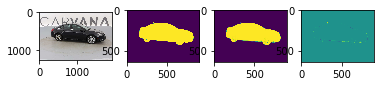

 30%|██▉       | 304/1018 [13:57<32:45,  2.75s/it]

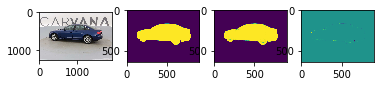

 30%|██▉       | 305/1018 [14:00<32:35,  2.74s/it]

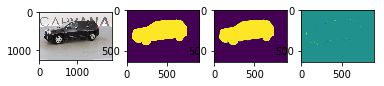

 30%|███       | 306/1018 [14:03<32:23,  2.73s/it]

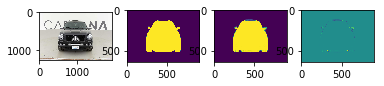

 30%|███       | 307/1018 [14:06<32:17,  2.73s/it]

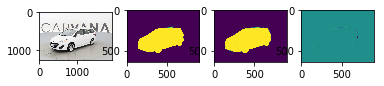

 30%|███       | 308/1018 [14:09<32:52,  2.78s/it]

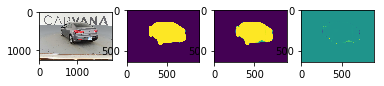

 30%|███       | 309/1018 [14:11<32:45,  2.77s/it]

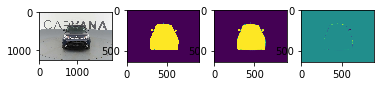

 30%|███       | 310/1018 [14:14<32:31,  2.76s/it]

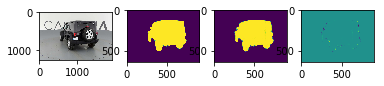

 31%|███       | 311/1018 [14:17<32:18,  2.74s/it]

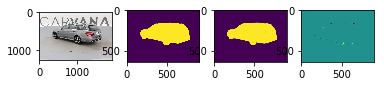

 31%|███       | 312/1018 [14:20<32:54,  2.80s/it]

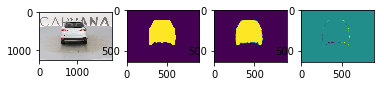

 31%|███       | 313/1018 [14:22<32:45,  2.79s/it]

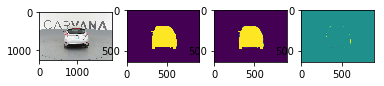

 31%|███       | 314/1018 [14:25<32:22,  2.76s/it]

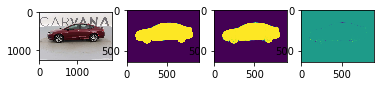

 31%|███       | 315/1018 [14:28<32:21,  2.76s/it]

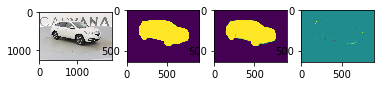

 31%|███       | 316/1018 [14:31<32:06,  2.74s/it]

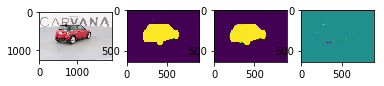

 31%|███       | 317/1018 [14:33<32:23,  2.77s/it]

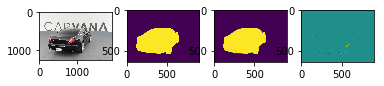

 31%|███       | 318/1018 [14:36<32:13,  2.76s/it]

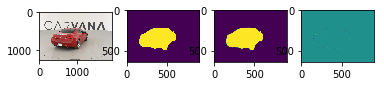

 31%|███▏      | 319/1018 [14:39<31:51,  2.73s/it]

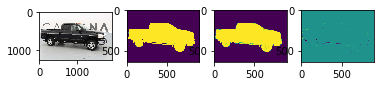

 31%|███▏      | 320/1018 [14:41<31:40,  2.72s/it]

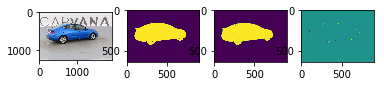

 32%|███▏      | 321/1018 [14:44<31:48,  2.74s/it]

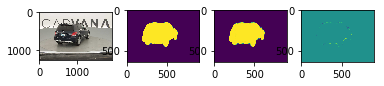

 32%|███▏      | 322/1018 [14:47<31:48,  2.74s/it]

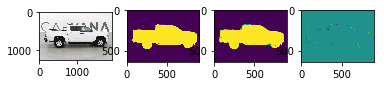

 32%|███▏      | 323/1018 [14:50<31:53,  2.75s/it]

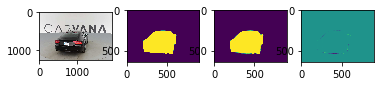

 32%|███▏      | 324/1018 [14:53<31:56,  2.76s/it]

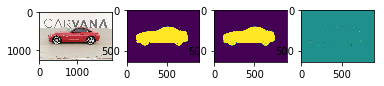

 32%|███▏      | 325/1018 [14:55<32:23,  2.80s/it]

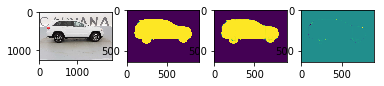

 32%|███▏      | 326/1018 [14:58<31:59,  2.77s/it]

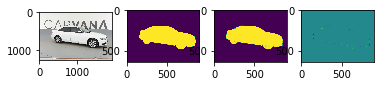

 32%|███▏      | 327/1018 [15:01<31:54,  2.77s/it]

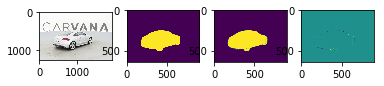

 32%|███▏      | 328/1018 [15:04<31:52,  2.77s/it]

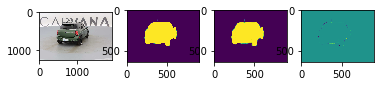

 32%|███▏      | 329/1018 [15:06<31:41,  2.76s/it]

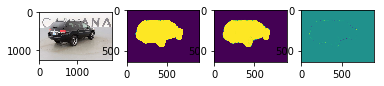

 32%|███▏      | 330/1018 [15:09<31:51,  2.78s/it]

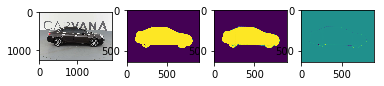

 33%|███▎      | 331/1018 [15:12<31:45,  2.77s/it]

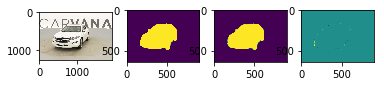

 33%|███▎      | 332/1018 [15:15<31:29,  2.75s/it]

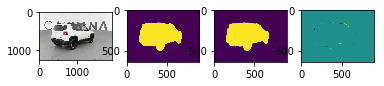

 33%|███▎      | 333/1018 [15:17<31:18,  2.74s/it]

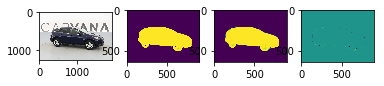

 33%|███▎      | 334/1018 [15:20<31:24,  2.76s/it]

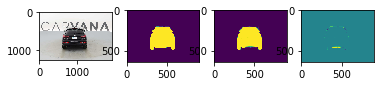

 33%|███▎      | 335/1018 [15:23<31:19,  2.75s/it]

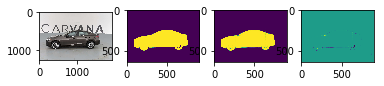

 33%|███▎      | 336/1018 [15:26<31:22,  2.76s/it]

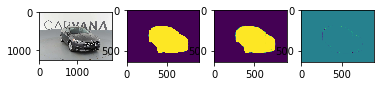

 33%|███▎      | 337/1018 [15:29<31:14,  2.75s/it]

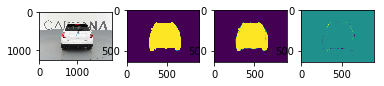

 33%|███▎      | 338/1018 [15:31<31:36,  2.79s/it]

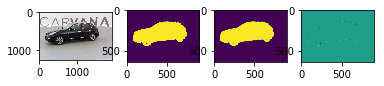

 33%|███▎      | 339/1018 [15:34<31:33,  2.79s/it]

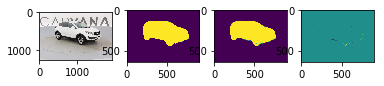

 33%|███▎      | 340/1018 [15:37<31:22,  2.78s/it]

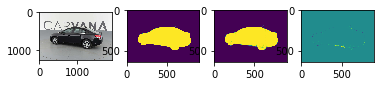

 33%|███▎      | 341/1018 [15:40<31:06,  2.76s/it]

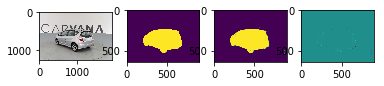

 34%|███▎      | 342/1018 [15:42<30:53,  2.74s/it]

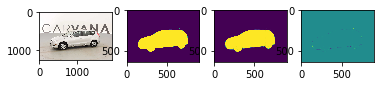

 34%|███▎      | 343/1018 [15:45<30:59,  2.75s/it]

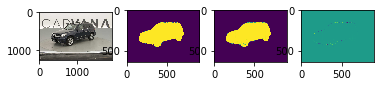

 34%|███▍      | 344/1018 [15:48<30:57,  2.76s/it]

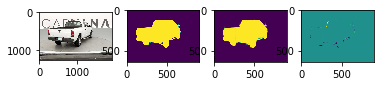

 34%|███▍      | 345/1018 [15:51<30:44,  2.74s/it]

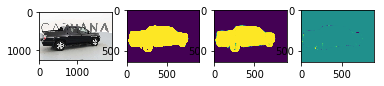

 34%|███▍      | 346/1018 [15:53<30:25,  2.72s/it]

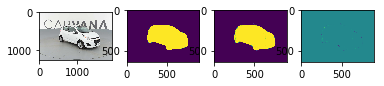

 34%|███▍      | 347/1018 [15:56<30:38,  2.74s/it]

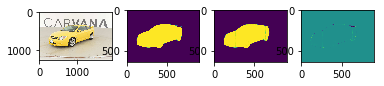

 34%|███▍      | 348/1018 [15:59<30:23,  2.72s/it]

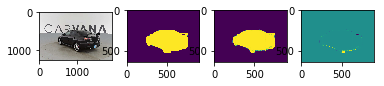

 34%|███▍      | 349/1018 [16:01<30:27,  2.73s/it]

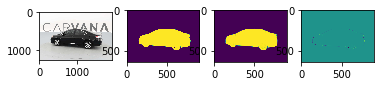

 34%|███▍      | 350/1018 [16:04<30:35,  2.75s/it]

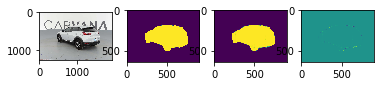

 34%|███▍      | 351/1018 [16:07<30:44,  2.76s/it]

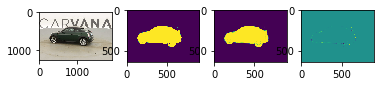

 35%|███▍      | 352/1018 [16:10<30:30,  2.75s/it]

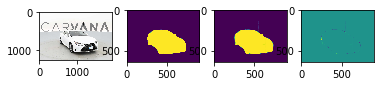

 35%|███▍      | 353/1018 [16:12<30:22,  2.74s/it]

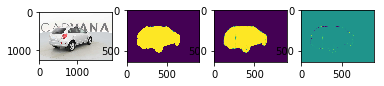

 35%|███▍      | 354/1018 [16:15<30:12,  2.73s/it]

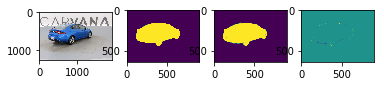

 35%|███▍      | 355/1018 [16:18<30:21,  2.75s/it]

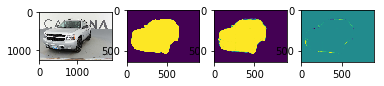

 35%|███▍      | 356/1018 [16:21<30:39,  2.78s/it]

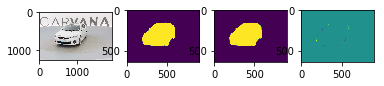

 35%|███▌      | 357/1018 [16:24<30:22,  2.76s/it]

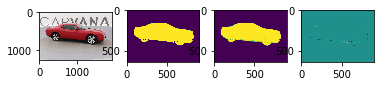

 35%|███▌      | 358/1018 [16:26<30:03,  2.73s/it]

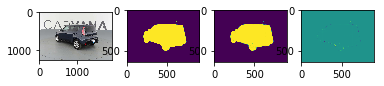

 35%|███▌      | 359/1018 [16:29<29:51,  2.72s/it]

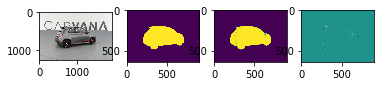

 35%|███▌      | 360/1018 [16:32<30:11,  2.75s/it]

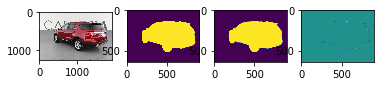

 35%|███▌      | 361/1018 [16:34<29:54,  2.73s/it]

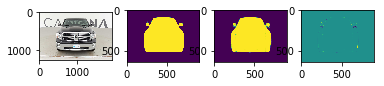

 36%|███▌      | 362/1018 [16:37<29:59,  2.74s/it]

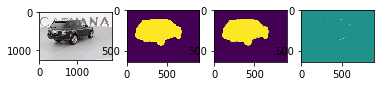

 36%|███▌      | 363/1018 [16:40<29:54,  2.74s/it]

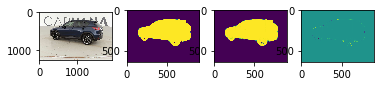

 36%|███▌      | 364/1018 [16:43<30:17,  2.78s/it]

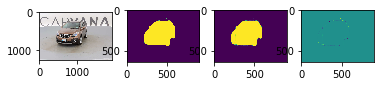

 36%|███▌      | 365/1018 [16:46<30:07,  2.77s/it]

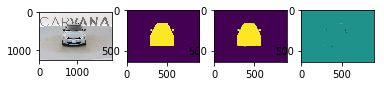

 36%|███▌      | 366/1018 [16:48<30:01,  2.76s/it]

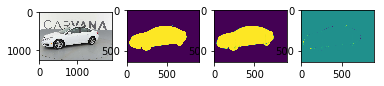

 36%|███▌      | 367/1018 [16:51<29:39,  2.73s/it]

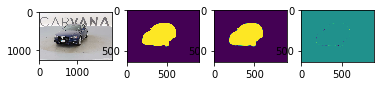

 36%|███▌      | 368/1018 [16:54<29:50,  2.75s/it]

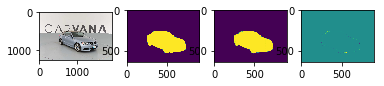

 36%|███▌      | 369/1018 [16:57<30:13,  2.79s/it]

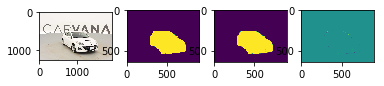

 36%|███▋      | 370/1018 [16:59<30:11,  2.80s/it]

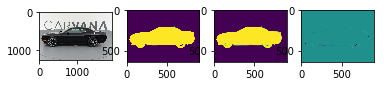

 36%|███▋      | 371/1018 [17:02<29:55,  2.78s/it]

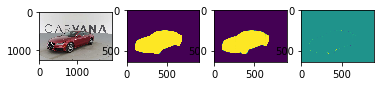

 37%|███▋      | 372/1018 [17:05<29:43,  2.76s/it]

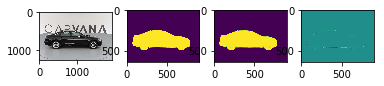

 37%|███▋      | 373/1018 [17:08<29:57,  2.79s/it]

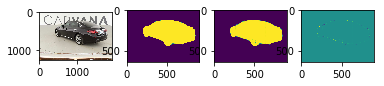

 37%|███▋      | 374/1018 [17:10<29:44,  2.77s/it]

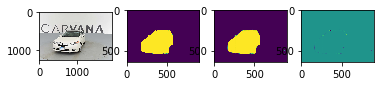

 37%|███▋      | 375/1018 [17:13<29:29,  2.75s/it]

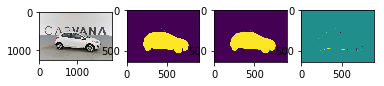

 37%|███▋      | 376/1018 [17:16<29:19,  2.74s/it]

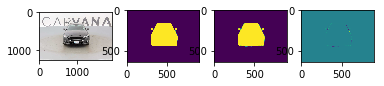

 37%|███▋      | 377/1018 [17:19<29:43,  2.78s/it]

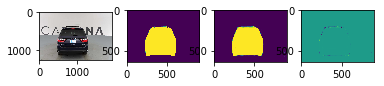

 37%|███▋      | 378/1018 [17:22<29:29,  2.76s/it]

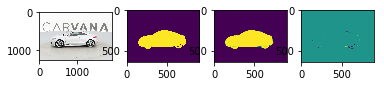

 37%|███▋      | 379/1018 [17:24<29:14,  2.75s/it]

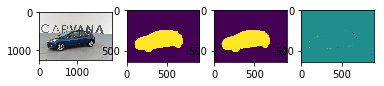

 37%|███▋      | 380/1018 [17:27<29:21,  2.76s/it]

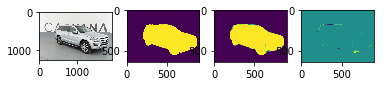

 37%|███▋      | 381/1018 [17:30<29:27,  2.77s/it]

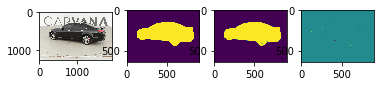

 38%|███▊      | 382/1018 [17:33<29:46,  2.81s/it]

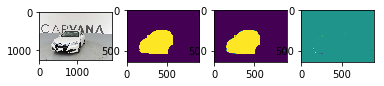

 38%|███▊      | 383/1018 [17:35<29:26,  2.78s/it]

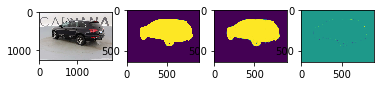

 38%|███▊      | 384/1018 [17:38<29:05,  2.75s/it]

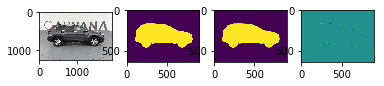

 38%|███▊      | 385/1018 [17:41<28:43,  2.72s/it]

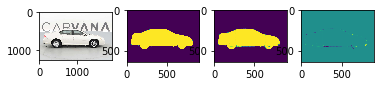

 38%|███▊      | 386/1018 [17:44<29:02,  2.76s/it]

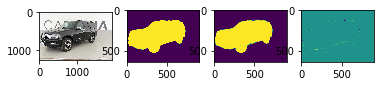

 38%|███▊      | 387/1018 [17:46<28:49,  2.74s/it]

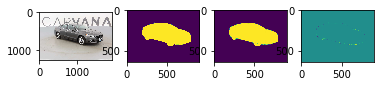

 38%|███▊      | 388/1018 [17:49<28:42,  2.73s/it]

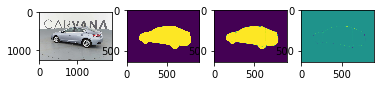

 38%|███▊      | 389/1018 [17:52<28:33,  2.72s/it]

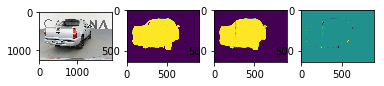

 38%|███▊      | 390/1018 [17:55<29:00,  2.77s/it]

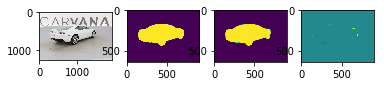

 38%|███▊      | 391/1018 [17:57<29:03,  2.78s/it]

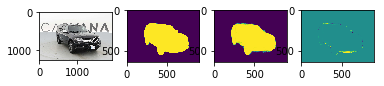

 39%|███▊      | 392/1018 [18:00<29:02,  2.78s/it]

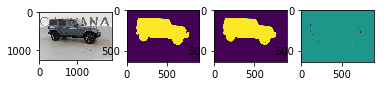

 39%|███▊      | 393/1018 [18:03<28:48,  2.77s/it]

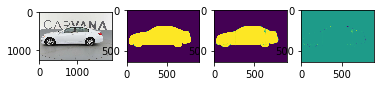

 39%|███▊      | 394/1018 [18:06<28:49,  2.77s/it]

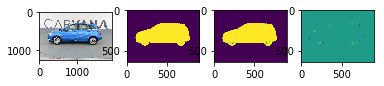

 39%|███▉      | 395/1018 [18:09<28:58,  2.79s/it]

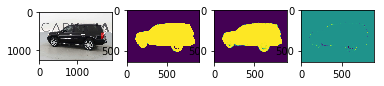

 39%|███▉      | 396/1018 [18:11<28:32,  2.75s/it]

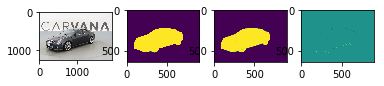

 39%|███▉      | 397/1018 [18:14<28:23,  2.74s/it]

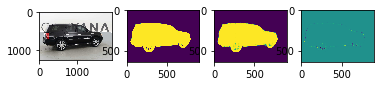

 39%|███▉      | 398/1018 [18:17<28:23,  2.75s/it]

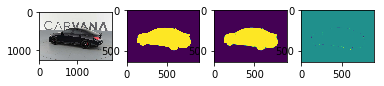

 39%|███▉      | 399/1018 [18:20<28:41,  2.78s/it]

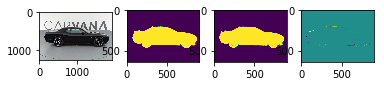

 39%|███▉      | 400/1018 [18:22<28:28,  2.76s/it]

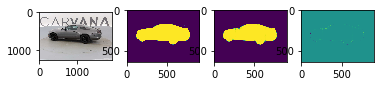

 39%|███▉      | 401/1018 [18:25<28:25,  2.76s/it]

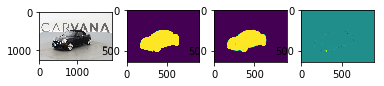

 39%|███▉      | 402/1018 [18:28<28:22,  2.76s/it]

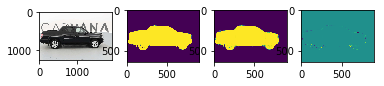

 40%|███▉      | 403/1018 [18:31<28:40,  2.80s/it]

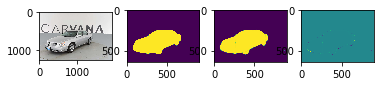

 40%|███▉      | 404/1018 [18:33<28:20,  2.77s/it]

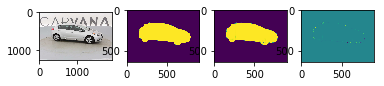

 40%|███▉      | 405/1018 [18:36<28:10,  2.76s/it]

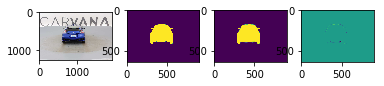

 40%|███▉      | 406/1018 [18:39<27:55,  2.74s/it]

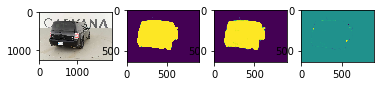

 40%|███▉      | 407/1018 [18:41<27:40,  2.72s/it]

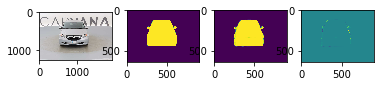

 40%|████      | 408/1018 [18:44<28:11,  2.77s/it]

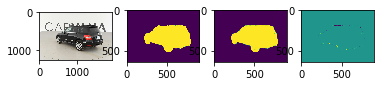

 40%|████      | 409/1018 [18:47<27:56,  2.75s/it]

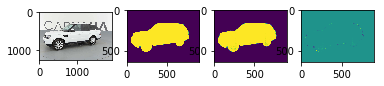

 40%|████      | 410/1018 [18:50<27:49,  2.75s/it]

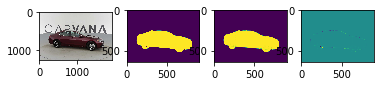

 40%|████      | 411/1018 [18:53<27:54,  2.76s/it]

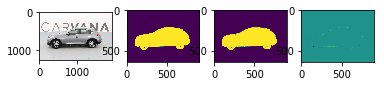

 40%|████      | 412/1018 [18:55<28:07,  2.78s/it]

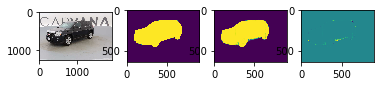

 41%|████      | 413/1018 [18:58<27:48,  2.76s/it]

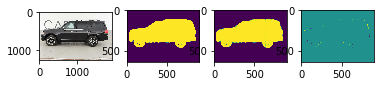

 41%|████      | 414/1018 [19:01<27:36,  2.74s/it]

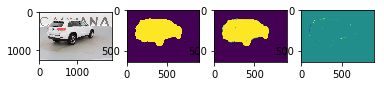

 41%|████      | 415/1018 [19:04<27:28,  2.73s/it]

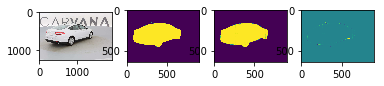

 41%|████      | 416/1018 [19:06<27:57,  2.79s/it]

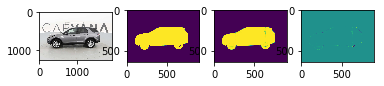

 41%|████      | 417/1018 [19:09<27:46,  2.77s/it]

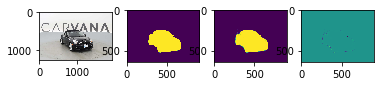

 41%|████      | 418/1018 [19:12<27:28,  2.75s/it]

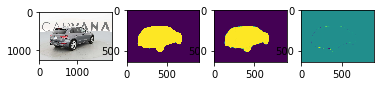

 41%|████      | 419/1018 [19:15<27:30,  2.76s/it]

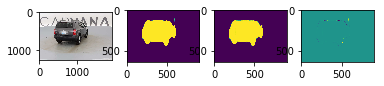

 41%|████▏     | 420/1018 [19:17<27:39,  2.78s/it]

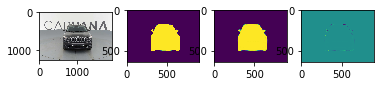

 41%|████▏     | 421/1018 [19:20<27:19,  2.75s/it]

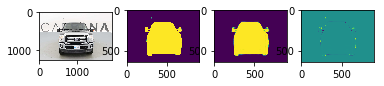

 41%|████▏     | 422/1018 [19:23<27:16,  2.75s/it]

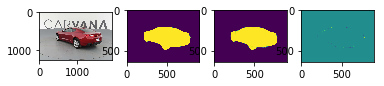

 42%|████▏     | 423/1018 [19:26<27:21,  2.76s/it]

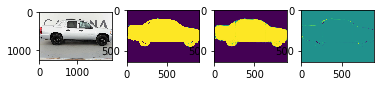

 42%|████▏     | 424/1018 [19:28<27:23,  2.77s/it]

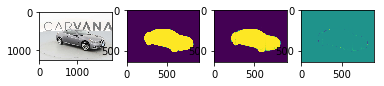

 42%|████▏     | 425/1018 [19:31<27:35,  2.79s/it]

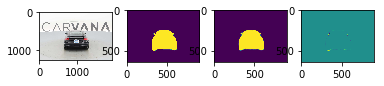

 42%|████▏     | 426/1018 [19:34<27:11,  2.76s/it]

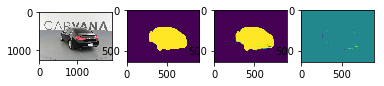

 42%|████▏     | 427/1018 [19:37<27:11,  2.76s/it]

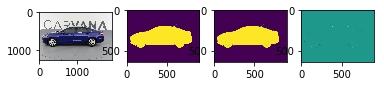

 42%|████▏     | 428/1018 [19:39<27:01,  2.75s/it]

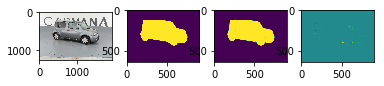

 42%|████▏     | 429/1018 [19:42<27:08,  2.77s/it]

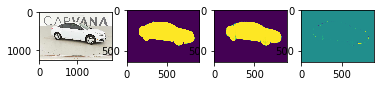

 42%|████▏     | 430/1018 [19:45<26:53,  2.74s/it]

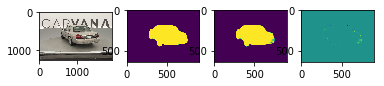

 42%|████▏     | 431/1018 [19:48<26:40,  2.73s/it]

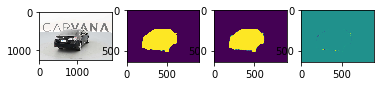

 42%|████▏     | 432/1018 [19:50<26:40,  2.73s/it]

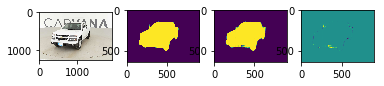

 43%|████▎     | 433/1018 [19:53<26:54,  2.76s/it]

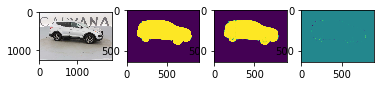

 43%|████▎     | 434/1018 [19:56<26:38,  2.74s/it]

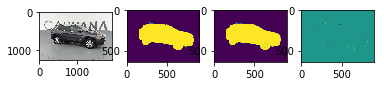

 43%|████▎     | 435/1018 [19:59<26:44,  2.75s/it]

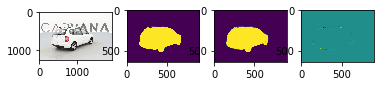

 43%|████▎     | 436/1018 [20:01<26:36,  2.74s/it]

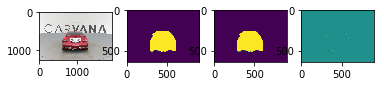

 43%|████▎     | 437/1018 [20:04<26:18,  2.72s/it]

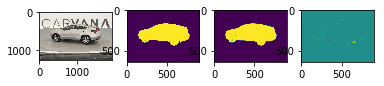

 43%|████▎     | 438/1018 [20:07<26:32,  2.75s/it]

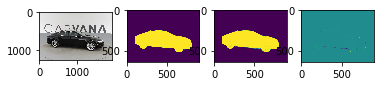

 43%|████▎     | 439/1018 [20:10<26:38,  2.76s/it]

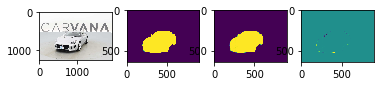

 43%|████▎     | 440/1018 [20:12<26:40,  2.77s/it]

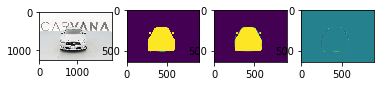

 43%|████▎     | 441/1018 [20:15<26:22,  2.74s/it]

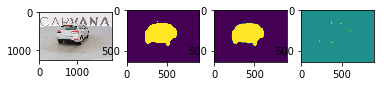

 43%|████▎     | 442/1018 [20:18<26:50,  2.80s/it]

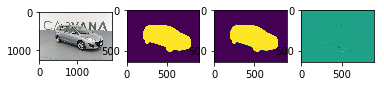

 44%|████▎     | 443/1018 [20:21<26:48,  2.80s/it]

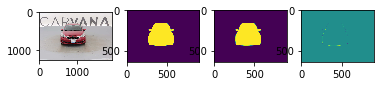

 44%|████▎     | 444/1018 [20:24<26:29,  2.77s/it]

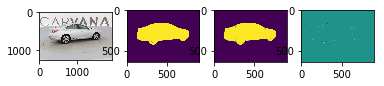

 44%|████▎     | 445/1018 [20:26<26:18,  2.76s/it]

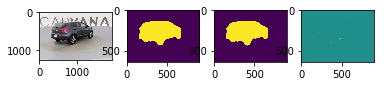

 44%|████▍     | 446/1018 [20:29<26:29,  2.78s/it]

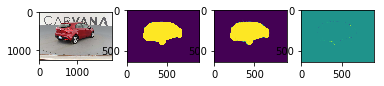

 44%|████▍     | 447/1018 [20:32<26:27,  2.78s/it]

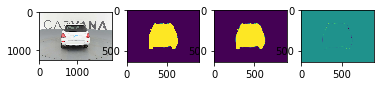

 44%|████▍     | 448/1018 [20:35<26:24,  2.78s/it]

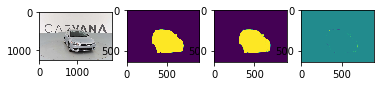

 44%|████▍     | 449/1018 [20:38<26:23,  2.78s/it]

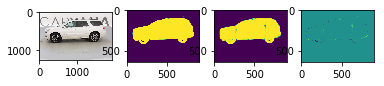

 44%|████▍     | 450/1018 [20:40<26:23,  2.79s/it]

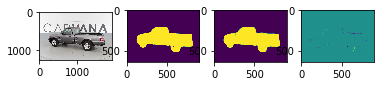

 44%|████▍     | 451/1018 [20:43<26:26,  2.80s/it]

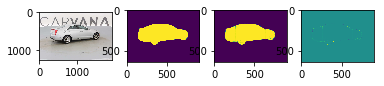

 44%|████▍     | 452/1018 [20:46<26:18,  2.79s/it]

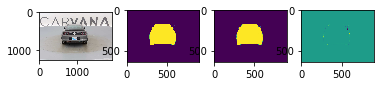

 44%|████▍     | 453/1018 [20:49<26:13,  2.79s/it]

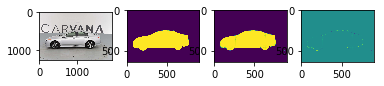

 45%|████▍     | 454/1018 [20:51<26:06,  2.78s/it]

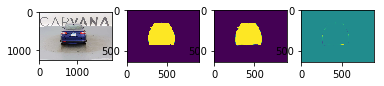

 45%|████▍     | 455/1018 [20:54<26:14,  2.80s/it]

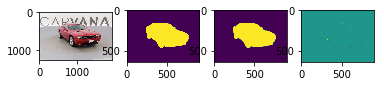

 45%|████▍     | 456/1018 [20:57<25:57,  2.77s/it]

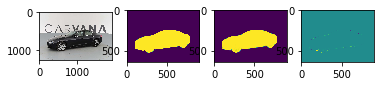

 45%|████▍     | 457/1018 [21:00<25:38,  2.74s/it]

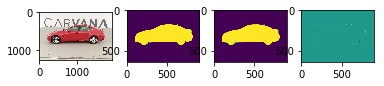

 45%|████▍     | 458/1018 [21:02<25:30,  2.73s/it]

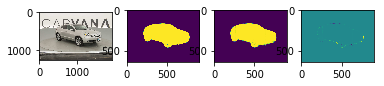

 45%|████▌     | 459/1018 [21:05<25:44,  2.76s/it]

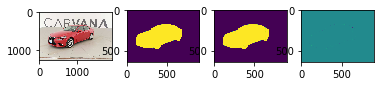

 45%|████▌     | 460/1018 [21:08<25:36,  2.75s/it]

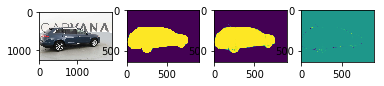

 45%|████▌     | 461/1018 [21:11<25:21,  2.73s/it]

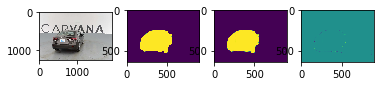

 45%|████▌     | 462/1018 [21:13<25:08,  2.71s/it]

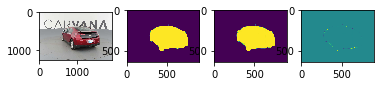

 45%|████▌     | 463/1018 [21:16<25:02,  2.71s/it]

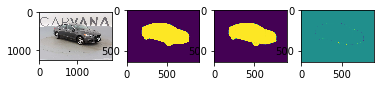

 46%|████▌     | 464/1018 [21:19<25:23,  2.75s/it]

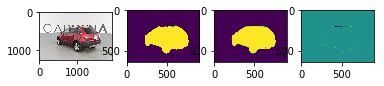

 46%|████▌     | 465/1018 [21:22<25:17,  2.74s/it]

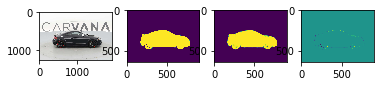

 46%|████▌     | 466/1018 [21:24<25:12,  2.74s/it]

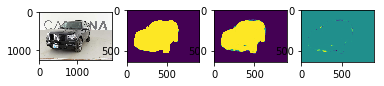

 46%|████▌     | 467/1018 [21:27<25:12,  2.75s/it]

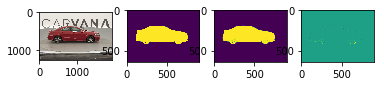

 46%|████▌     | 468/1018 [21:30<25:25,  2.77s/it]

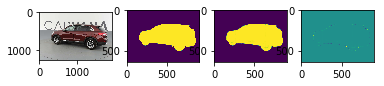

 46%|████▌     | 469/1018 [21:33<25:26,  2.78s/it]

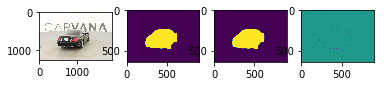

 46%|████▌     | 470/1018 [21:35<25:18,  2.77s/it]

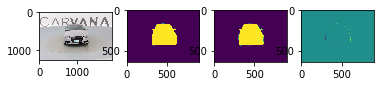

 46%|████▋     | 471/1018 [21:38<25:09,  2.76s/it]

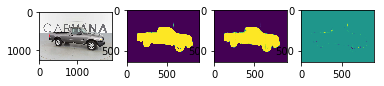

 46%|████▋     | 472/1018 [21:41<25:18,  2.78s/it]

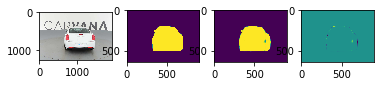

 46%|████▋     | 473/1018 [21:44<25:04,  2.76s/it]

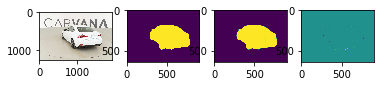

 47%|████▋     | 474/1018 [21:46<24:49,  2.74s/it]

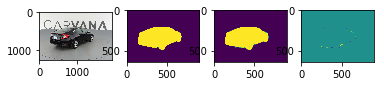

 47%|████▋     | 475/1018 [21:49<24:41,  2.73s/it]

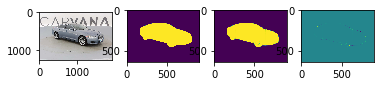

 47%|████▋     | 476/1018 [21:52<25:06,  2.78s/it]

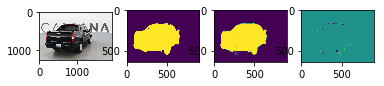

 47%|████▋     | 477/1018 [21:55<24:56,  2.77s/it]

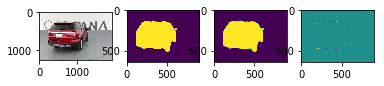

 47%|████▋     | 478/1018 [21:57<24:45,  2.75s/it]

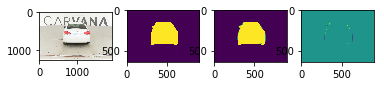

 47%|████▋     | 479/1018 [22:00<24:41,  2.75s/it]

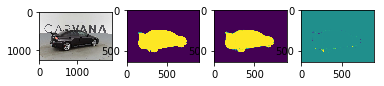

 47%|████▋     | 480/1018 [22:03<24:31,  2.74s/it]

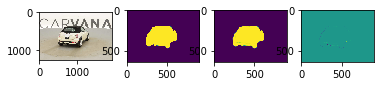

 47%|████▋     | 481/1018 [22:06<24:48,  2.77s/it]

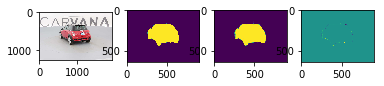

 47%|████▋     | 482/1018 [22:08<24:33,  2.75s/it]

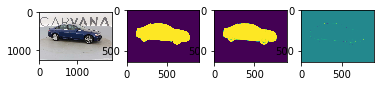

 47%|████▋     | 483/1018 [22:11<24:38,  2.76s/it]

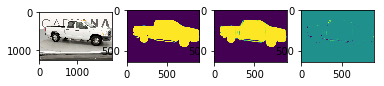

 48%|████▊     | 484/1018 [22:14<24:36,  2.76s/it]

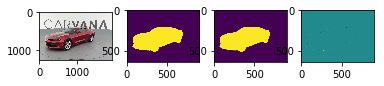

 48%|████▊     | 485/1018 [22:17<24:41,  2.78s/it]

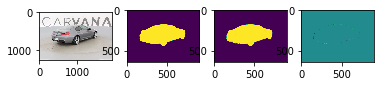

 48%|████▊     | 486/1018 [22:20<24:31,  2.77s/it]

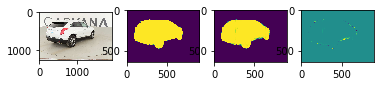

 48%|████▊     | 487/1018 [22:22<24:20,  2.75s/it]

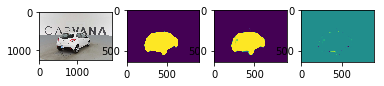

 48%|████▊     | 488/1018 [22:25<24:14,  2.74s/it]

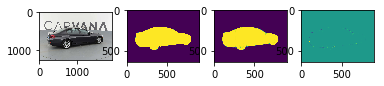

 48%|████▊     | 489/1018 [22:28<24:21,  2.76s/it]

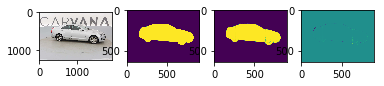

 48%|████▊     | 490/1018 [22:31<24:11,  2.75s/it]

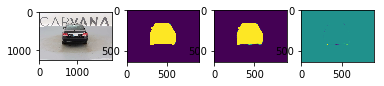

 48%|████▊     | 491/1018 [22:33<24:21,  2.77s/it]

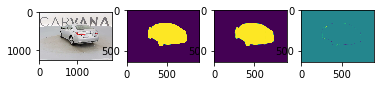

 48%|████▊     | 492/1018 [22:36<24:10,  2.76s/it]

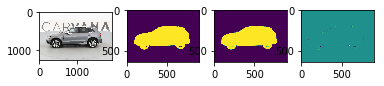

 48%|████▊     | 493/1018 [22:39<24:09,  2.76s/it]

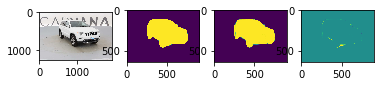

 49%|████▊     | 494/1018 [22:42<24:21,  2.79s/it]

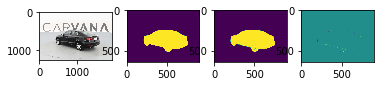

 49%|████▊     | 495/1018 [22:44<24:01,  2.76s/it]

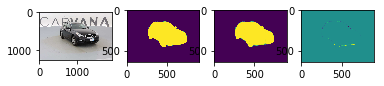

 49%|████▊     | 496/1018 [22:47<24:01,  2.76s/it]

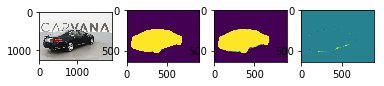

 49%|████▉     | 497/1018 [22:50<23:53,  2.75s/it]

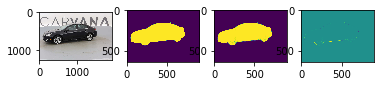

 49%|████▉     | 498/1018 [22:53<24:06,  2.78s/it]

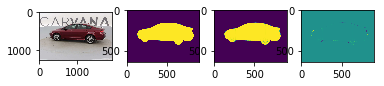

 49%|████▉     | 499/1018 [22:55<23:57,  2.77s/it]

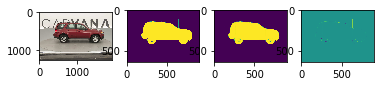

 49%|████▉     | 500/1018 [22:58<23:45,  2.75s/it]

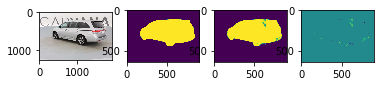

 49%|████▉     | 501/1018 [23:01<23:37,  2.74s/it]

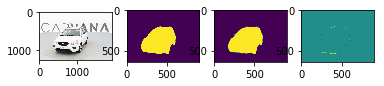

 49%|████▉     | 502/1018 [23:04<23:44,  2.76s/it]

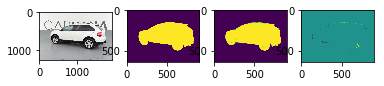

 49%|████▉     | 503/1018 [23:07<23:50,  2.78s/it]

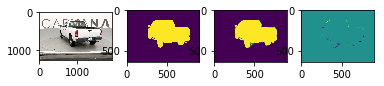

 50%|████▉     | 504/1018 [23:09<23:48,  2.78s/it]

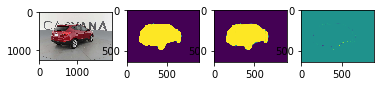

 50%|████▉     | 505/1018 [23:12<23:41,  2.77s/it]

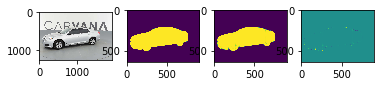

 50%|████▉     | 506/1018 [23:15<23:26,  2.75s/it]

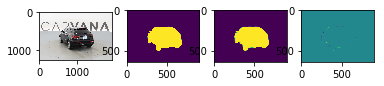

 50%|████▉     | 507/1018 [23:18<23:48,  2.79s/it]

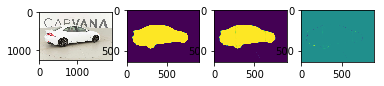

 50%|████▉     | 508/1018 [23:20<23:43,  2.79s/it]

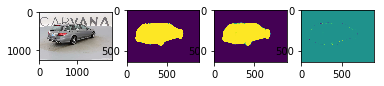

 50%|█████     | 509/1018 [23:23<23:24,  2.76s/it]

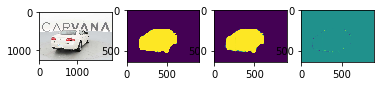

 50%|█████     | 510/1018 [23:26<23:23,  2.76s/it]

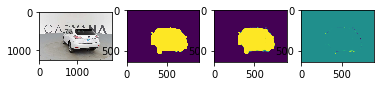

 50%|█████     | 511/1018 [23:29<23:28,  2.78s/it]

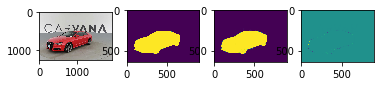

 50%|█████     | 512/1018 [23:31<23:16,  2.76s/it]

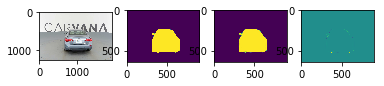

 50%|█████     | 513/1018 [23:34<23:14,  2.76s/it]

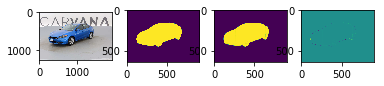

 50%|█████     | 514/1018 [23:37<23:08,  2.75s/it]

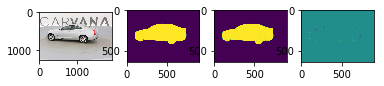

 51%|█████     | 515/1018 [23:40<23:27,  2.80s/it]

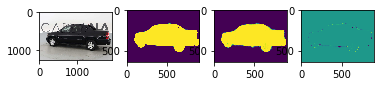

 51%|█████     | 516/1018 [23:43<23:26,  2.80s/it]

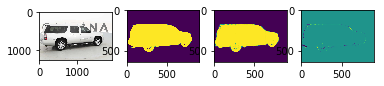

 51%|█████     | 517/1018 [23:45<23:13,  2.78s/it]

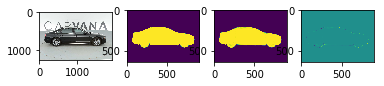

 51%|█████     | 518/1018 [23:48<22:57,  2.76s/it]

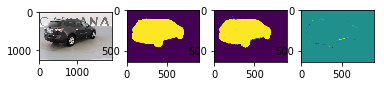

 51%|█████     | 519/1018 [23:51<22:45,  2.74s/it]

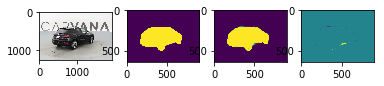

 51%|█████     | 520/1018 [23:54<22:52,  2.76s/it]

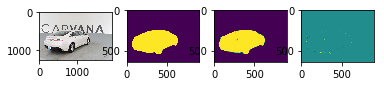

 51%|█████     | 521/1018 [23:56<22:42,  2.74s/it]

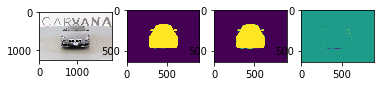

 51%|█████▏    | 522/1018 [23:59<22:43,  2.75s/it]

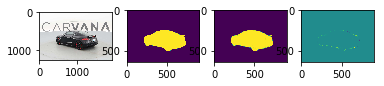

 51%|█████▏    | 523/1018 [24:02<22:43,  2.76s/it]

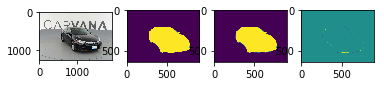

 51%|█████▏    | 524/1018 [24:05<22:55,  2.78s/it]

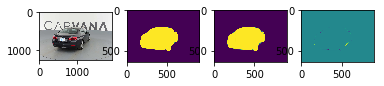

 52%|█████▏    | 525/1018 [24:07<22:46,  2.77s/it]

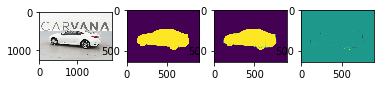

 52%|█████▏    | 526/1018 [24:10<22:32,  2.75s/it]

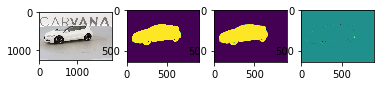

 52%|█████▏    | 527/1018 [24:13<22:23,  2.74s/it]

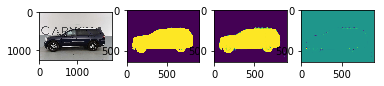

 52%|█████▏    | 528/1018 [24:16<22:35,  2.77s/it]

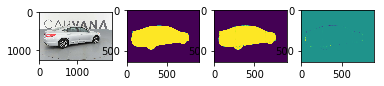

 52%|█████▏    | 529/1018 [24:18<22:28,  2.76s/it]

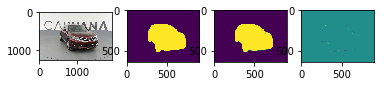

 52%|█████▏    | 530/1018 [24:21<22:22,  2.75s/it]

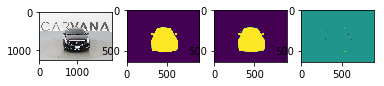

 52%|█████▏    | 531/1018 [24:24<22:12,  2.74s/it]

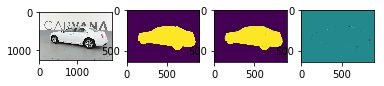

 52%|█████▏    | 532/1018 [24:27<22:11,  2.74s/it]

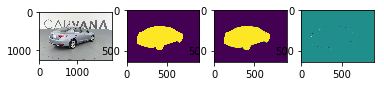

 52%|█████▏    | 533/1018 [24:29<22:29,  2.78s/it]

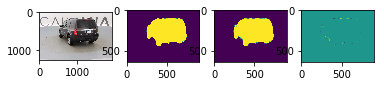

 52%|█████▏    | 534/1018 [24:32<22:19,  2.77s/it]

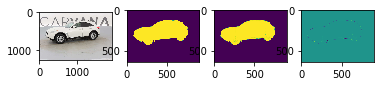

 53%|█████▎    | 535/1018 [24:35<22:11,  2.76s/it]

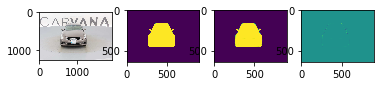

 53%|█████▎    | 536/1018 [24:38<22:07,  2.75s/it]

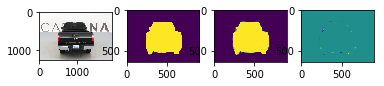

 53%|█████▎    | 537/1018 [24:40<22:12,  2.77s/it]

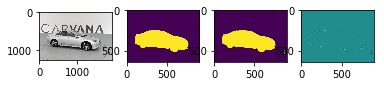

 53%|█████▎    | 538/1018 [24:43<21:54,  2.74s/it]

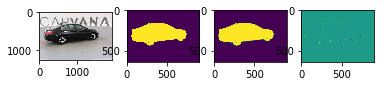

 53%|█████▎    | 539/1018 [24:46<21:41,  2.72s/it]

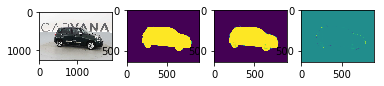

 53%|█████▎    | 540/1018 [24:49<21:39,  2.72s/it]

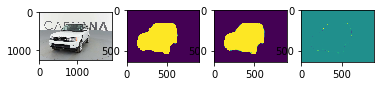

 53%|█████▎    | 541/1018 [24:51<22:02,  2.77s/it]

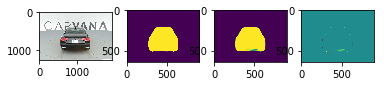

 53%|█████▎    | 542/1018 [24:54<21:52,  2.76s/it]

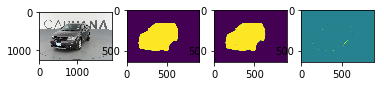

 53%|█████▎    | 543/1018 [24:57<21:42,  2.74s/it]

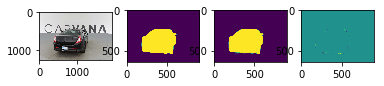

 53%|█████▎    | 544/1018 [25:00<21:43,  2.75s/it]

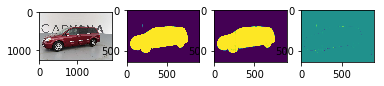

 54%|█████▎    | 545/1018 [25:02<21:39,  2.75s/it]

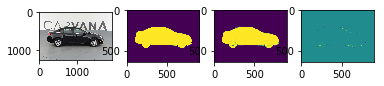

 54%|█████▎    | 546/1018 [25:05<21:46,  2.77s/it]

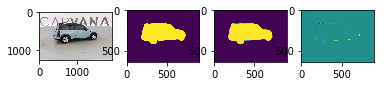

 54%|█████▎    | 547/1018 [25:08<21:45,  2.77s/it]

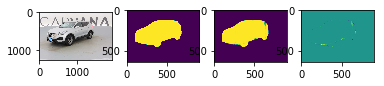

 54%|█████▍    | 548/1018 [25:11<21:34,  2.75s/it]

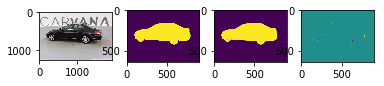

 54%|█████▍    | 549/1018 [25:13<21:22,  2.73s/it]

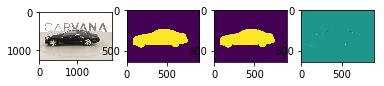

 54%|█████▍    | 550/1018 [25:16<21:32,  2.76s/it]

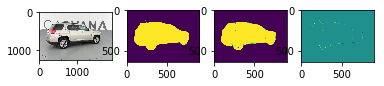

 54%|█████▍    | 551/1018 [25:19<21:25,  2.75s/it]

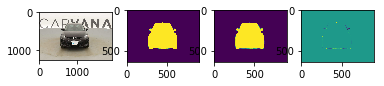

 54%|█████▍    | 552/1018 [25:22<21:15,  2.74s/it]

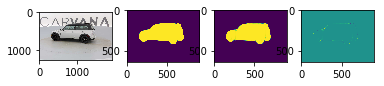

 54%|█████▍    | 553/1018 [25:24<21:22,  2.76s/it]

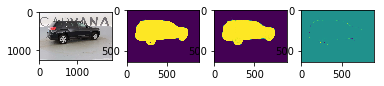

 54%|█████▍    | 554/1018 [25:27<21:29,  2.78s/it]

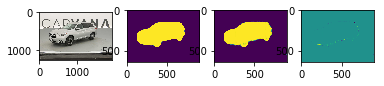

 55%|█████▍    | 555/1018 [25:30<21:21,  2.77s/it]

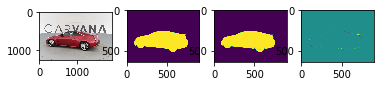

 55%|█████▍    | 556/1018 [25:33<21:24,  2.78s/it]

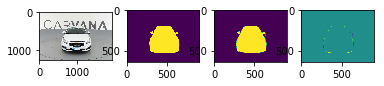

 55%|█████▍    | 557/1018 [25:36<21:19,  2.78s/it]

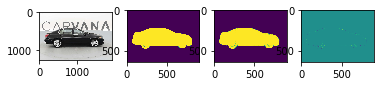

 55%|█████▍    | 558/1018 [25:38<21:17,  2.78s/it]

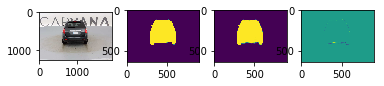

 55%|█████▍    | 559/1018 [25:41<21:31,  2.81s/it]

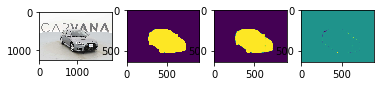

 55%|█████▌    | 560/1018 [25:44<21:21,  2.80s/it]

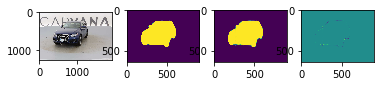

 55%|█████▌    | 561/1018 [25:47<21:01,  2.76s/it]

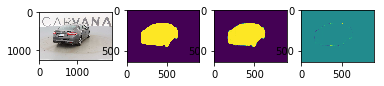

 55%|█████▌    | 562/1018 [25:49<21:00,  2.77s/it]

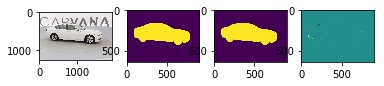

 55%|█████▌    | 563/1018 [25:52<21:09,  2.79s/it]

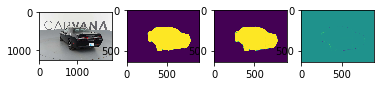

 55%|█████▌    | 564/1018 [25:55<20:59,  2.77s/it]

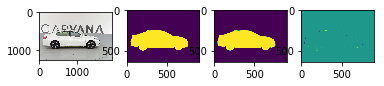

 56%|█████▌    | 565/1018 [25:58<20:54,  2.77s/it]

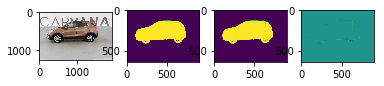

 56%|█████▌    | 566/1018 [26:01<20:53,  2.77s/it]

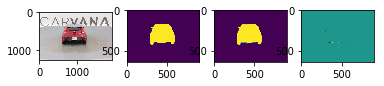

 56%|█████▌    | 567/1018 [26:03<21:07,  2.81s/it]

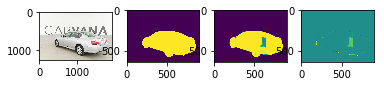

 56%|█████▌    | 568/1018 [26:06<20:54,  2.79s/it]

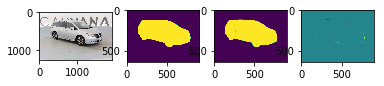

 56%|█████▌    | 569/1018 [26:09<20:52,  2.79s/it]

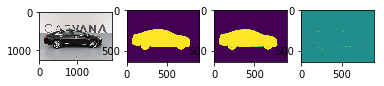

 56%|█████▌    | 570/1018 [26:12<20:33,  2.75s/it]

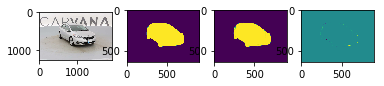

 56%|█████▌    | 571/1018 [26:14<20:28,  2.75s/it]

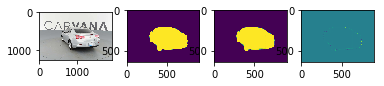

 56%|█████▌    | 572/1018 [26:17<20:47,  2.80s/it]

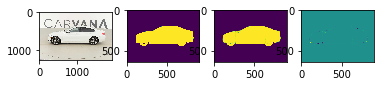

 56%|█████▋    | 573/1018 [26:20<20:41,  2.79s/it]

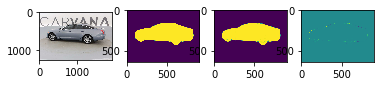

 56%|█████▋    | 574/1018 [26:23<20:26,  2.76s/it]

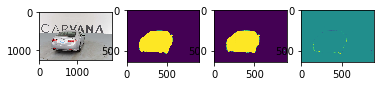

 56%|█████▋    | 575/1018 [26:26<20:27,  2.77s/it]

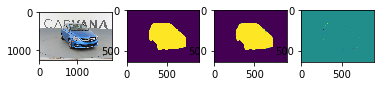

 57%|█████▋    | 576/1018 [26:28<20:36,  2.80s/it]

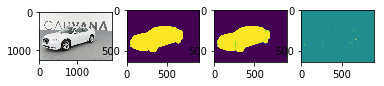

 57%|█████▋    | 577/1018 [26:31<20:19,  2.77s/it]

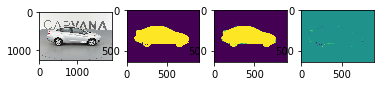

 57%|█████▋    | 578/1018 [26:34<20:16,  2.76s/it]

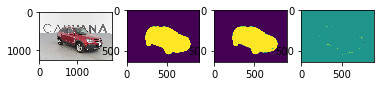

 57%|█████▋    | 579/1018 [26:37<20:04,  2.74s/it]

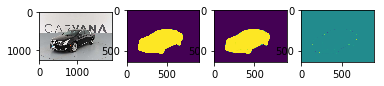

 57%|█████▋    | 580/1018 [26:39<20:22,  2.79s/it]

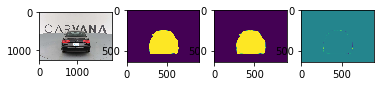

 57%|█████▋    | 581/1018 [26:42<20:19,  2.79s/it]

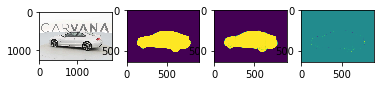

 57%|█████▋    | 582/1018 [26:45<20:15,  2.79s/it]

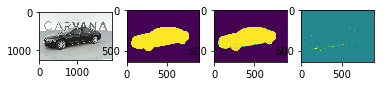

 57%|█████▋    | 583/1018 [26:48<20:15,  2.79s/it]

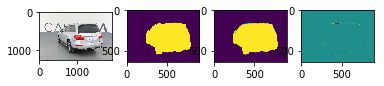

 57%|█████▋    | 584/1018 [26:51<20:00,  2.77s/it]

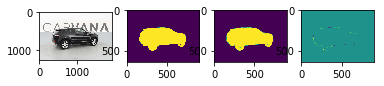

 57%|█████▋    | 585/1018 [26:53<20:11,  2.80s/it]

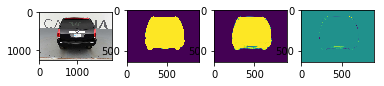

 58%|█████▊    | 586/1018 [26:56<20:06,  2.79s/it]

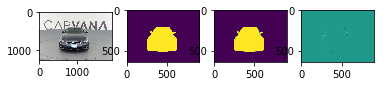

 58%|█████▊    | 587/1018 [26:59<19:55,  2.77s/it]

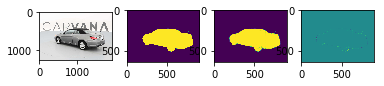

 58%|█████▊    | 588/1018 [27:02<19:43,  2.75s/it]

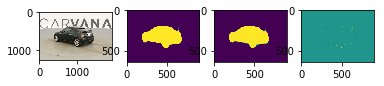

 58%|█████▊    | 589/1018 [27:05<19:52,  2.78s/it]

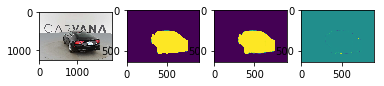

 58%|█████▊    | 590/1018 [27:07<19:38,  2.75s/it]

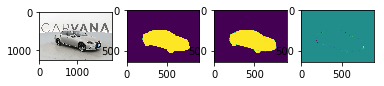

 58%|█████▊    | 591/1018 [27:10<19:32,  2.74s/it]

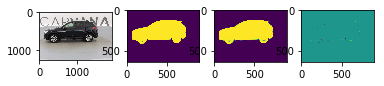

 58%|█████▊    | 592/1018 [27:13<19:28,  2.74s/it]

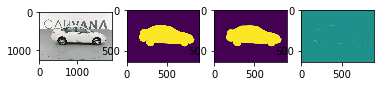

 58%|█████▊    | 593/1018 [27:16<19:43,  2.79s/it]

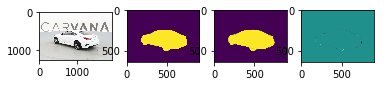

 58%|█████▊    | 594/1018 [27:18<19:34,  2.77s/it]

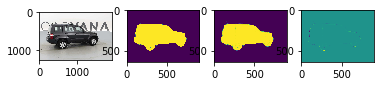

 58%|█████▊    | 595/1018 [27:21<19:28,  2.76s/it]

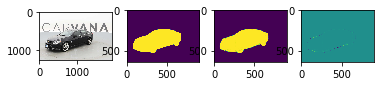

 59%|█████▊    | 596/1018 [27:24<19:24,  2.76s/it]

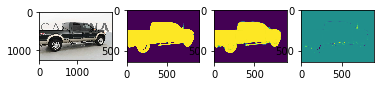

 59%|█████▊    | 597/1018 [27:26<19:14,  2.74s/it]

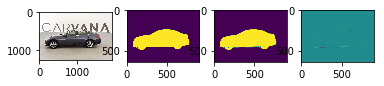

 59%|█████▊    | 598/1018 [27:29<19:28,  2.78s/it]

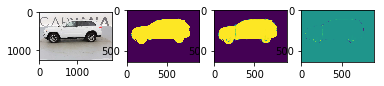

 59%|█████▉    | 599/1018 [27:32<19:17,  2.76s/it]

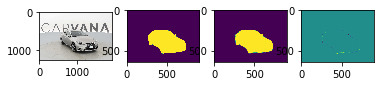

 59%|█████▉    | 600/1018 [27:35<19:04,  2.74s/it]

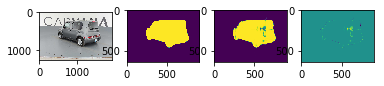

 59%|█████▉    | 601/1018 [27:38<19:08,  2.75s/it]

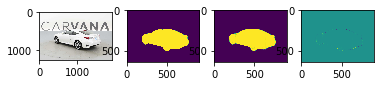

 59%|█████▉    | 602/1018 [27:40<19:17,  2.78s/it]

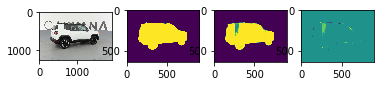

 59%|█████▉    | 603/1018 [27:43<19:16,  2.79s/it]

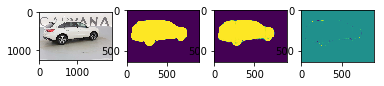

 59%|█████▉    | 604/1018 [27:46<19:06,  2.77s/it]

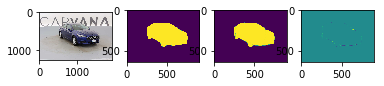

 59%|█████▉    | 605/1018 [27:49<19:07,  2.78s/it]

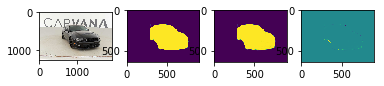

 60%|█████▉    | 606/1018 [27:52<19:12,  2.80s/it]

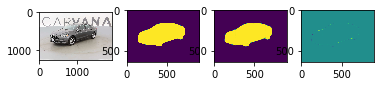

 60%|█████▉    | 607/1018 [27:54<19:04,  2.78s/it]

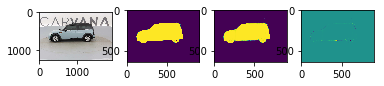

 60%|█████▉    | 608/1018 [27:57<18:48,  2.75s/it]

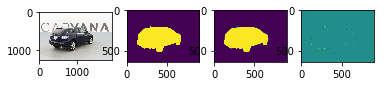

 60%|█████▉    | 609/1018 [28:00<18:41,  2.74s/it]

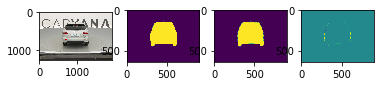

 60%|█████▉    | 610/1018 [28:02<18:35,  2.73s/it]

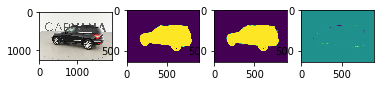

 60%|██████    | 611/1018 [28:05<18:53,  2.79s/it]

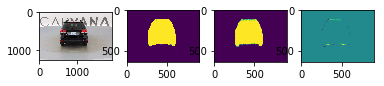

 60%|██████    | 612/1018 [28:08<18:46,  2.78s/it]

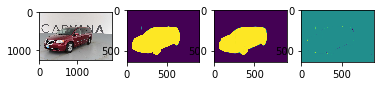

 60%|██████    | 613/1018 [28:11<18:34,  2.75s/it]

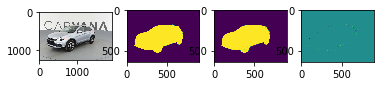

 60%|██████    | 614/1018 [28:13<18:27,  2.74s/it]

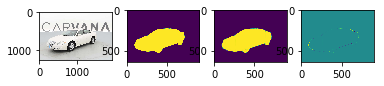

 60%|██████    | 615/1018 [28:16<18:29,  2.75s/it]

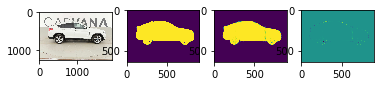

 61%|██████    | 616/1018 [28:19<18:19,  2.74s/it]

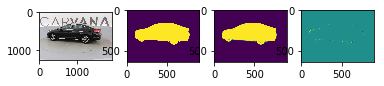

 61%|██████    | 617/1018 [28:22<18:14,  2.73s/it]

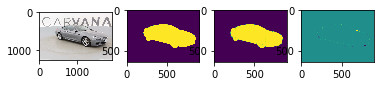

 61%|██████    | 618/1018 [28:24<18:18,  2.75s/it]

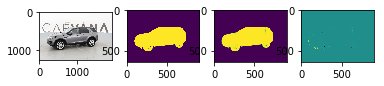

 61%|██████    | 619/1018 [28:27<18:29,  2.78s/it]

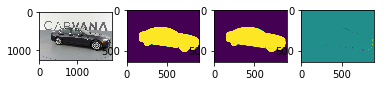

 61%|██████    | 620/1018 [28:30<18:28,  2.78s/it]

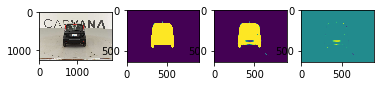

 61%|██████    | 621/1018 [28:33<18:16,  2.76s/it]

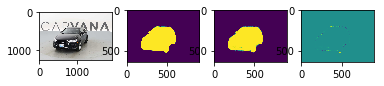

 61%|██████    | 622/1018 [28:36<18:15,  2.77s/it]

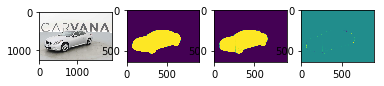

 61%|██████    | 623/1018 [28:38<18:11,  2.76s/it]

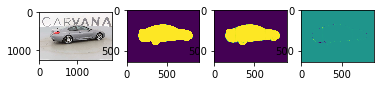

 61%|██████▏   | 624/1018 [28:41<18:21,  2.80s/it]

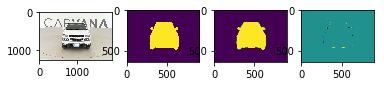

 61%|██████▏   | 625/1018 [28:44<18:12,  2.78s/it]

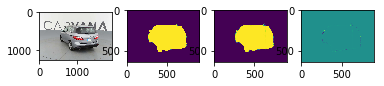

 61%|██████▏   | 626/1018 [28:47<17:58,  2.75s/it]

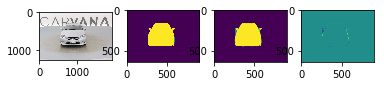

 62%|██████▏   | 627/1018 [28:49<17:55,  2.75s/it]

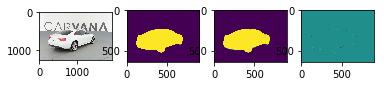

 62%|██████▏   | 628/1018 [28:52<18:05,  2.78s/it]

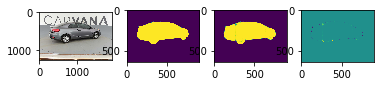

 62%|██████▏   | 629/1018 [28:55<17:58,  2.77s/it]

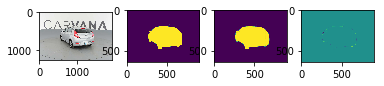

 62%|██████▏   | 630/1018 [28:58<17:49,  2.76s/it]

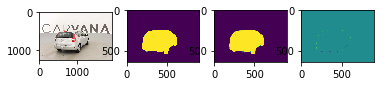

 62%|██████▏   | 631/1018 [29:00<17:45,  2.75s/it]

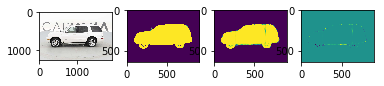

 62%|██████▏   | 632/1018 [29:03<18:03,  2.81s/it]

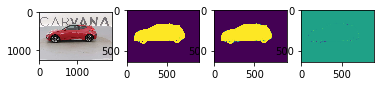

 62%|██████▏   | 633/1018 [29:06<17:55,  2.79s/it]

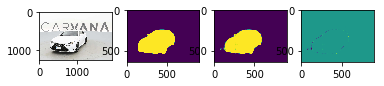

 62%|██████▏   | 634/1018 [29:09<17:45,  2.77s/it]

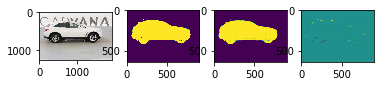

 62%|██████▏   | 635/1018 [29:12<17:41,  2.77s/it]

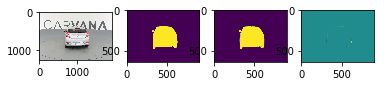

 62%|██████▏   | 636/1018 [29:14<17:36,  2.77s/it]

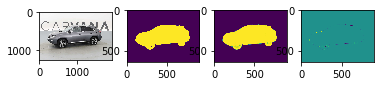

 63%|██████▎   | 637/1018 [29:17<17:39,  2.78s/it]

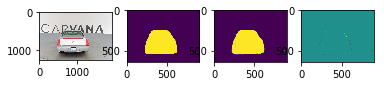

 63%|██████▎   | 638/1018 [29:20<17:26,  2.75s/it]

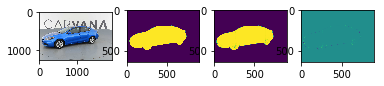

 63%|██████▎   | 639/1018 [29:23<17:26,  2.76s/it]

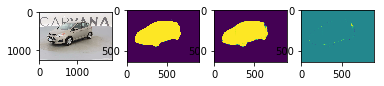

 63%|██████▎   | 640/1018 [29:25<17:22,  2.76s/it]

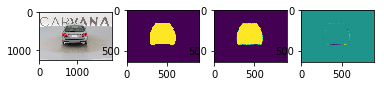

 63%|██████▎   | 641/1018 [29:28<17:28,  2.78s/it]

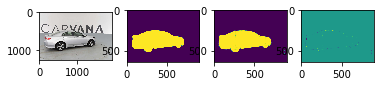

 63%|██████▎   | 642/1018 [29:31<17:27,  2.79s/it]

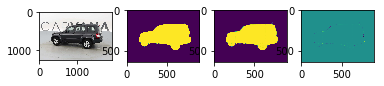

 63%|██████▎   | 643/1018 [29:34<17:25,  2.79s/it]

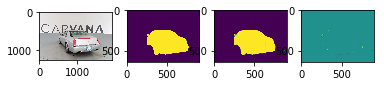

 63%|██████▎   | 644/1018 [29:37<17:20,  2.78s/it]

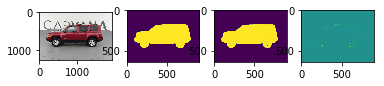

 63%|██████▎   | 645/1018 [29:40<17:30,  2.82s/it]

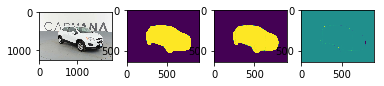

 63%|██████▎   | 646/1018 [29:42<17:17,  2.79s/it]

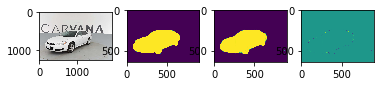

 64%|██████▎   | 647/1018 [29:45<17:10,  2.78s/it]

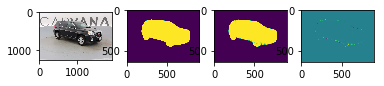

 64%|██████▎   | 648/1018 [29:48<16:59,  2.76s/it]

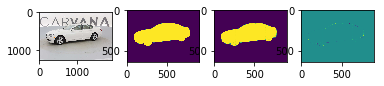

 64%|██████▍   | 649/1018 [29:50<16:53,  2.75s/it]

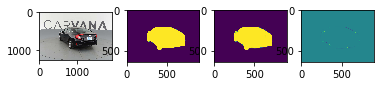

 64%|██████▍   | 650/1018 [29:53<17:09,  2.80s/it]

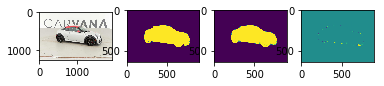

 64%|██████▍   | 651/1018 [29:56<16:56,  2.77s/it]

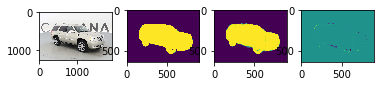

 64%|██████▍   | 652/1018 [29:59<16:56,  2.78s/it]

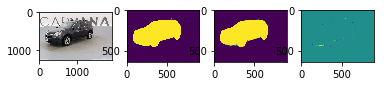

 64%|██████▍   | 653/1018 [30:02<16:49,  2.77s/it]

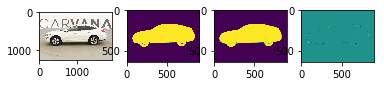

 64%|██████▍   | 654/1018 [30:04<16:51,  2.78s/it]

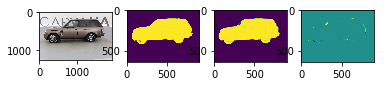

 64%|██████▍   | 655/1018 [30:07<16:36,  2.74s/it]

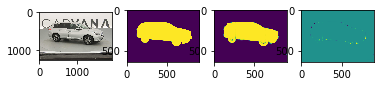

 64%|██████▍   | 656/1018 [30:10<16:28,  2.73s/it]

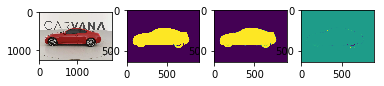

 65%|██████▍   | 657/1018 [30:13<16:25,  2.73s/it]

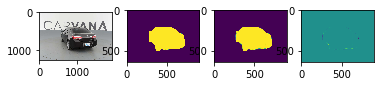

 65%|██████▍   | 658/1018 [30:15<16:32,  2.76s/it]

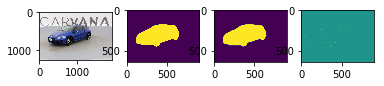

 65%|██████▍   | 659/1018 [30:18<16:27,  2.75s/it]

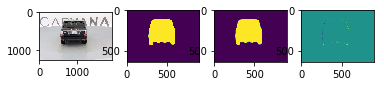

 65%|██████▍   | 660/1018 [30:21<16:23,  2.75s/it]

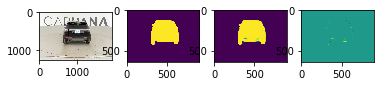

 65%|██████▍   | 661/1018 [30:24<16:17,  2.74s/it]

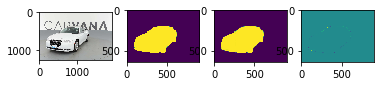

 65%|██████▌   | 662/1018 [30:26<16:19,  2.75s/it]

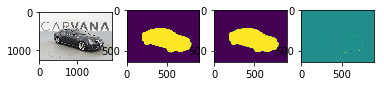

 65%|██████▌   | 663/1018 [30:29<16:30,  2.79s/it]

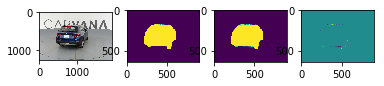

 65%|██████▌   | 664/1018 [30:32<16:19,  2.77s/it]

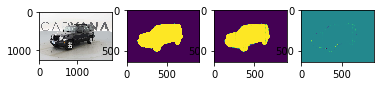

 65%|██████▌   | 665/1018 [30:35<16:05,  2.74s/it]

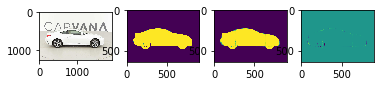

 65%|██████▌   | 666/1018 [30:37<16:06,  2.75s/it]

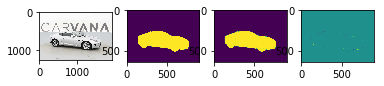

 66%|██████▌   | 667/1018 [30:40<16:14,  2.78s/it]

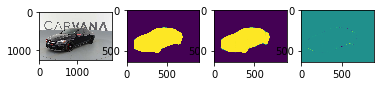

 66%|██████▌   | 668/1018 [30:43<16:07,  2.76s/it]

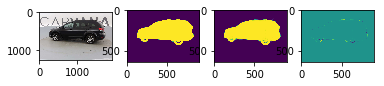

 66%|██████▌   | 669/1018 [30:46<16:05,  2.77s/it]

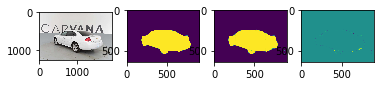

 66%|██████▌   | 670/1018 [30:48<16:04,  2.77s/it]

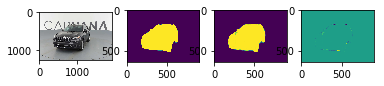

 66%|██████▌   | 671/1018 [30:51<16:12,  2.80s/it]

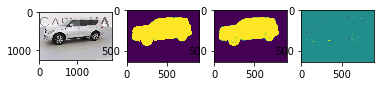

 66%|██████▌   | 672/1018 [30:54<15:57,  2.77s/it]

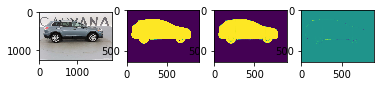

 66%|██████▌   | 673/1018 [30:57<15:47,  2.75s/it]

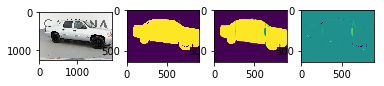

 66%|██████▌   | 674/1018 [31:00<15:49,  2.76s/it]

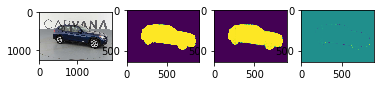

 66%|██████▋   | 675/1018 [31:02<15:49,  2.77s/it]

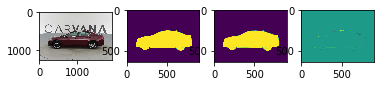

 66%|██████▋   | 676/1018 [31:05<16:01,  2.81s/it]

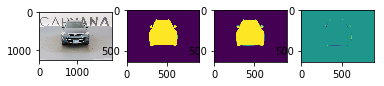

 67%|██████▋   | 677/1018 [31:08<15:50,  2.79s/it]

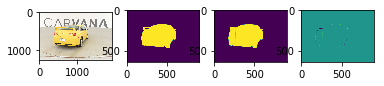

 67%|██████▋   | 678/1018 [31:11<15:48,  2.79s/it]

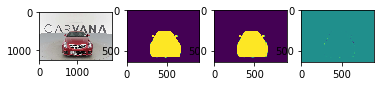

 67%|██████▋   | 679/1018 [31:13<15:39,  2.77s/it]

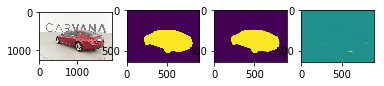

 67%|██████▋   | 680/1018 [31:16<15:42,  2.79s/it]

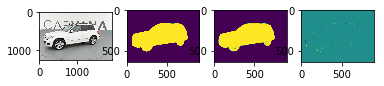

 67%|██████▋   | 681/1018 [31:19<15:32,  2.77s/it]

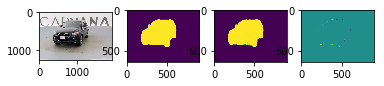

 67%|██████▋   | 682/1018 [31:22<15:20,  2.74s/it]

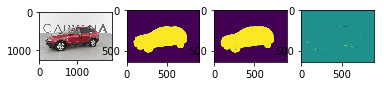

 67%|██████▋   | 683/1018 [31:24<15:10,  2.72s/it]

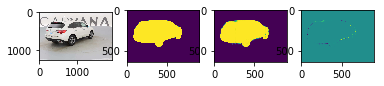

 67%|██████▋   | 684/1018 [31:27<15:15,  2.74s/it]

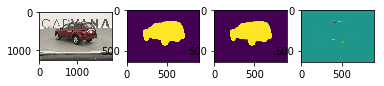

 67%|██████▋   | 685/1018 [31:30<15:07,  2.72s/it]

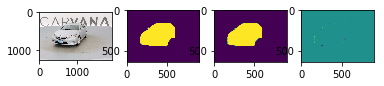

 67%|██████▋   | 686/1018 [31:33<15:10,  2.74s/it]

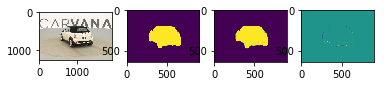

 67%|██████▋   | 687/1018 [31:35<15:11,  2.75s/it]

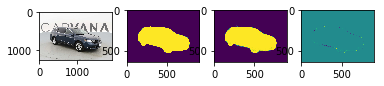

 68%|██████▊   | 688/1018 [31:38<15:04,  2.74s/it]

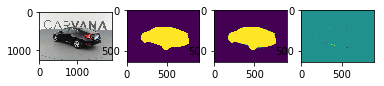

 68%|██████▊   | 689/1018 [31:41<15:14,  2.78s/it]

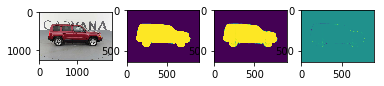

 68%|██████▊   | 690/1018 [31:44<15:11,  2.78s/it]

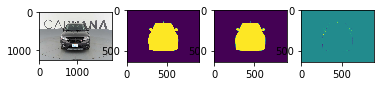

 68%|██████▊   | 691/1018 [31:47<15:06,  2.77s/it]

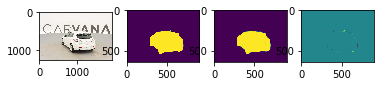

 68%|██████▊   | 692/1018 [31:49<15:03,  2.77s/it]

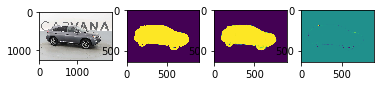

 68%|██████▊   | 693/1018 [31:52<15:13,  2.81s/it]

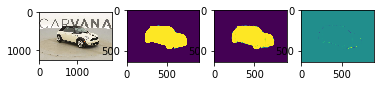

 68%|██████▊   | 694/1018 [31:55<15:09,  2.81s/it]

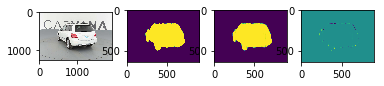

 68%|██████▊   | 695/1018 [31:58<15:04,  2.80s/it]

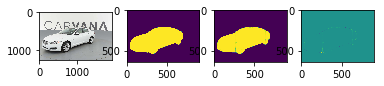

 68%|██████▊   | 696/1018 [32:01<14:59,  2.79s/it]

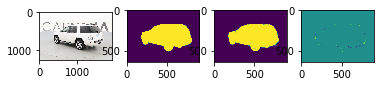

 68%|██████▊   | 697/1018 [32:03<15:01,  2.81s/it]

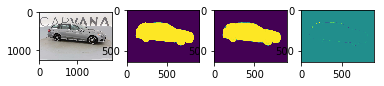

 69%|██████▊   | 698/1018 [32:06<14:45,  2.77s/it]

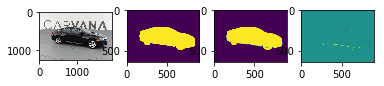

 69%|██████▊   | 699/1018 [32:09<14:33,  2.74s/it]

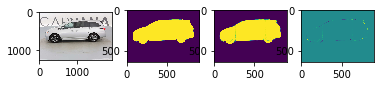

 69%|██████▉   | 700/1018 [32:12<14:34,  2.75s/it]

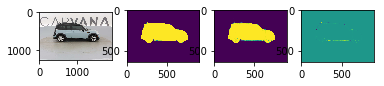

 69%|██████▉   | 701/1018 [32:14<14:31,  2.75s/it]

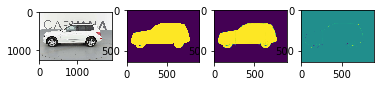

 69%|██████▉   | 702/1018 [32:17<14:37,  2.78s/it]

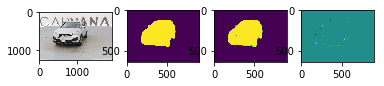

 69%|██████▉   | 703/1018 [32:20<14:35,  2.78s/it]

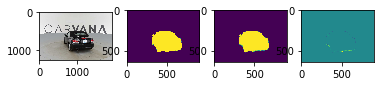

 69%|██████▉   | 704/1018 [32:23<14:27,  2.76s/it]

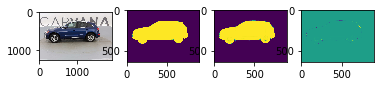

 69%|██████▉   | 705/1018 [32:25<14:21,  2.75s/it]

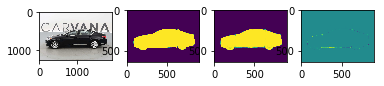

 69%|██████▉   | 706/1018 [32:28<14:26,  2.78s/it]

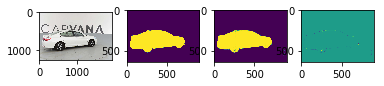

 69%|██████▉   | 707/1018 [32:31<14:13,  2.74s/it]

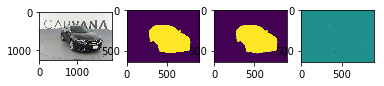

 70%|██████▉   | 708/1018 [32:34<14:06,  2.73s/it]

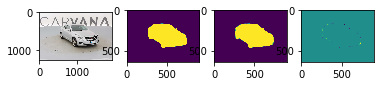

 70%|██████▉   | 709/1018 [32:36<14:02,  2.73s/it]

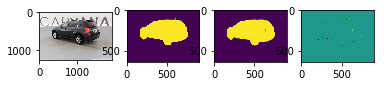

 70%|██████▉   | 710/1018 [32:39<14:16,  2.78s/it]

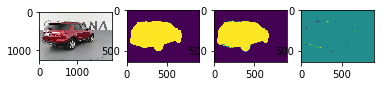

 70%|██████▉   | 711/1018 [32:42<14:11,  2.77s/it]

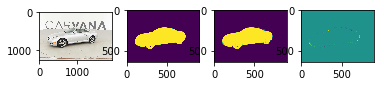

 70%|██████▉   | 712/1018 [32:45<14:07,  2.77s/it]

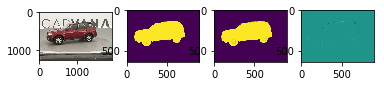

 70%|███████   | 713/1018 [32:47<14:05,  2.77s/it]

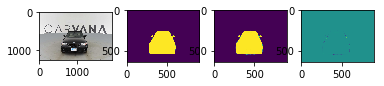

 70%|███████   | 714/1018 [32:50<13:57,  2.75s/it]

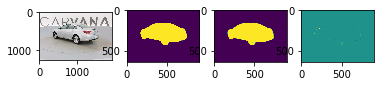

 70%|███████   | 715/1018 [32:53<14:02,  2.78s/it]

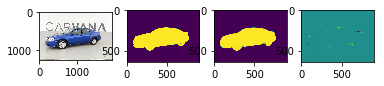

 70%|███████   | 716/1018 [32:56<13:57,  2.77s/it]

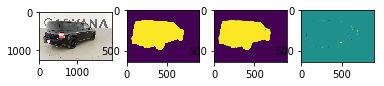

 70%|███████   | 717/1018 [32:59<13:57,  2.78s/it]

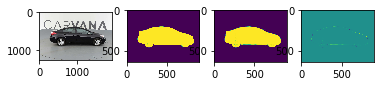

 71%|███████   | 718/1018 [33:01<13:56,  2.79s/it]

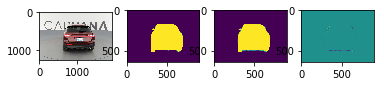

 71%|███████   | 719/1018 [33:04<14:01,  2.81s/it]

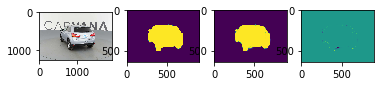

 71%|███████   | 720/1018 [33:07<13:47,  2.78s/it]

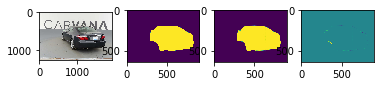

 71%|███████   | 721/1018 [33:10<13:37,  2.75s/it]

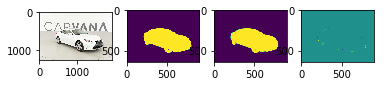

 71%|███████   | 722/1018 [33:12<13:30,  2.74s/it]

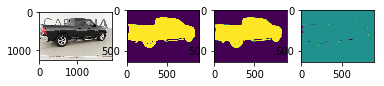

 71%|███████   | 723/1018 [33:15<13:32,  2.76s/it]

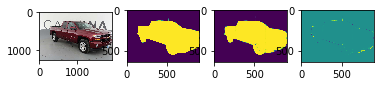

 71%|███████   | 724/1018 [33:18<13:27,  2.75s/it]

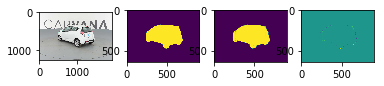

 71%|███████   | 725/1018 [33:21<13:27,  2.76s/it]

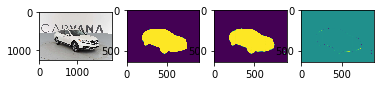

 71%|███████▏  | 726/1018 [33:23<13:28,  2.77s/it]

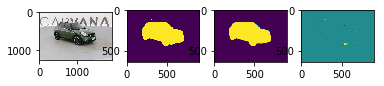

 71%|███████▏  | 727/1018 [33:26<13:22,  2.76s/it]

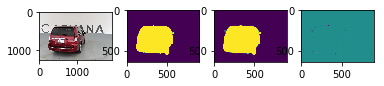

 72%|███████▏  | 728/1018 [33:29<13:30,  2.79s/it]

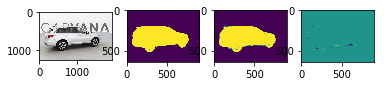

 72%|███████▏  | 729/1018 [33:32<13:28,  2.80s/it]

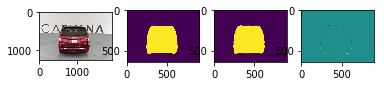

 72%|███████▏  | 730/1018 [33:35<13:19,  2.77s/it]

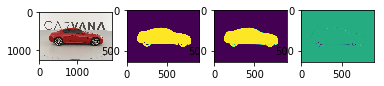

 72%|███████▏  | 731/1018 [33:37<13:10,  2.75s/it]

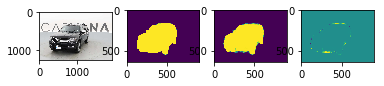

 72%|███████▏  | 732/1018 [33:40<13:12,  2.77s/it]

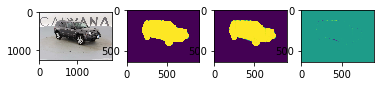

 72%|███████▏  | 733/1018 [33:43<13:03,  2.75s/it]

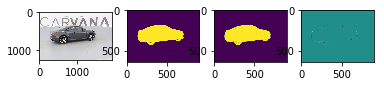

 72%|███████▏  | 734/1018 [33:46<12:56,  2.73s/it]

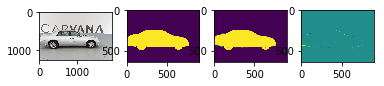

 72%|███████▏  | 735/1018 [33:48<12:51,  2.73s/it]

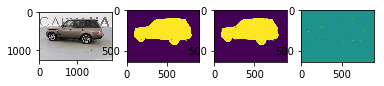

 72%|███████▏  | 736/1018 [33:51<12:53,  2.74s/it]

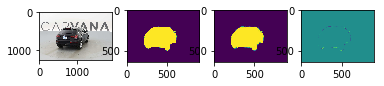

 72%|███████▏  | 737/1018 [33:54<12:53,  2.75s/it]

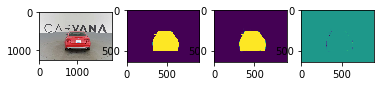

 72%|███████▏  | 738/1018 [33:57<12:50,  2.75s/it]

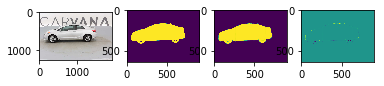

 73%|███████▎  | 739/1018 [33:59<12:49,  2.76s/it]

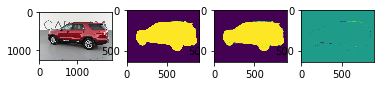

 73%|███████▎  | 740/1018 [34:02<12:48,  2.76s/it]

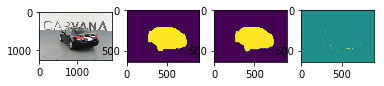

 73%|███████▎  | 741/1018 [34:05<12:56,  2.80s/it]

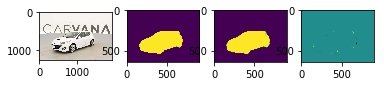

 73%|███████▎  | 742/1018 [34:08<12:46,  2.78s/it]

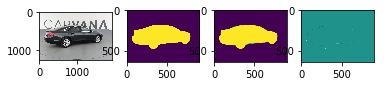

 73%|███████▎  | 743/1018 [34:10<12:43,  2.78s/it]

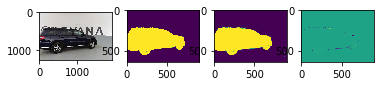

 73%|███████▎  | 744/1018 [34:13<12:33,  2.75s/it]

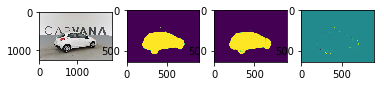

 73%|███████▎  | 745/1018 [34:16<12:43,  2.80s/it]

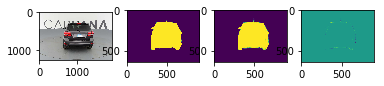

 73%|███████▎  | 746/1018 [34:19<12:33,  2.77s/it]

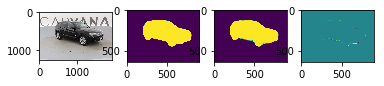

 73%|███████▎  | 747/1018 [34:21<12:26,  2.76s/it]

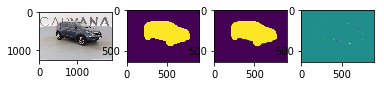

 73%|███████▎  | 748/1018 [34:24<12:18,  2.74s/it]

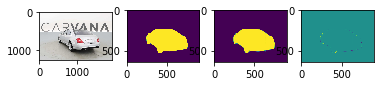

 74%|███████▎  | 749/1018 [34:27<12:25,  2.77s/it]

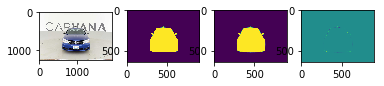

 74%|███████▎  | 750/1018 [34:30<12:25,  2.78s/it]

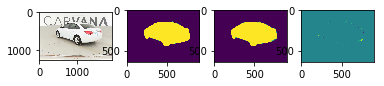

 74%|███████▍  | 751/1018 [34:33<12:16,  2.76s/it]

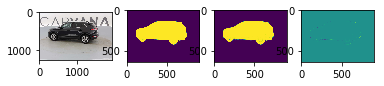

 74%|███████▍  | 752/1018 [34:35<12:11,  2.75s/it]

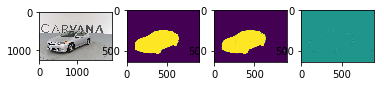

 74%|███████▍  | 753/1018 [34:38<12:04,  2.74s/it]

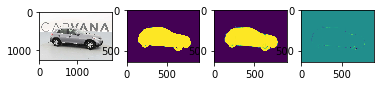

 74%|███████▍  | 754/1018 [34:41<12:14,  2.78s/it]

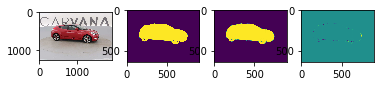

 74%|███████▍  | 755/1018 [34:44<12:09,  2.77s/it]

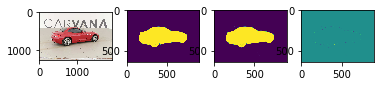

 74%|███████▍  | 756/1018 [34:46<12:00,  2.75s/it]

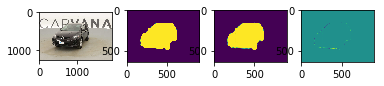

 74%|███████▍  | 757/1018 [34:49<11:55,  2.74s/it]

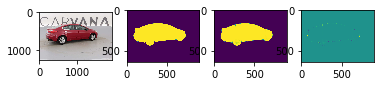

 74%|███████▍  | 758/1018 [34:52<11:56,  2.76s/it]

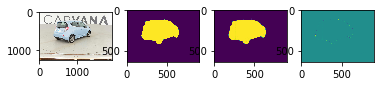

 75%|███████▍  | 759/1018 [34:55<11:48,  2.74s/it]

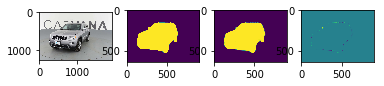

 75%|███████▍  | 760/1018 [34:57<11:43,  2.73s/it]

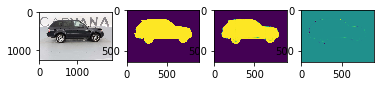

 75%|███████▍  | 761/1018 [35:00<11:37,  2.71s/it]

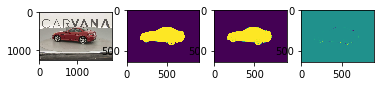

 75%|███████▍  | 762/1018 [35:03<11:46,  2.76s/it]

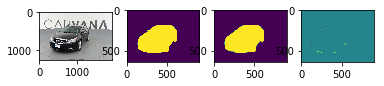

 75%|███████▍  | 763/1018 [35:05<11:40,  2.75s/it]

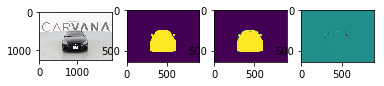

 75%|███████▌  | 764/1018 [35:08<11:36,  2.74s/it]

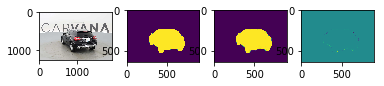

 75%|███████▌  | 765/1018 [35:11<11:32,  2.74s/it]

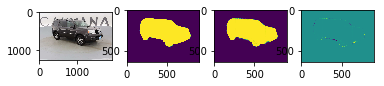

 75%|███████▌  | 766/1018 [35:14<11:33,  2.75s/it]

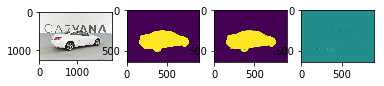

 75%|███████▌  | 767/1018 [35:17<11:40,  2.79s/it]

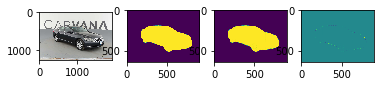

 75%|███████▌  | 768/1018 [35:19<11:38,  2.79s/it]

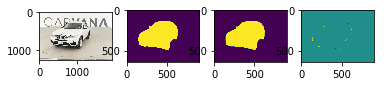

 76%|███████▌  | 769/1018 [35:22<11:31,  2.78s/it]

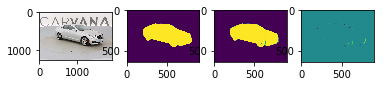

 76%|███████▌  | 770/1018 [35:25<11:23,  2.76s/it]

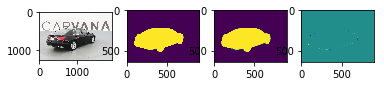

 76%|███████▌  | 771/1018 [35:28<11:27,  2.78s/it]

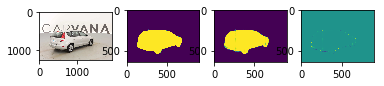

 76%|███████▌  | 772/1018 [35:30<11:25,  2.79s/it]

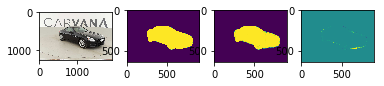

 76%|███████▌  | 773/1018 [35:33<11:17,  2.77s/it]

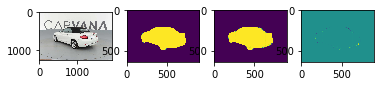

 76%|███████▌  | 774/1018 [35:36<11:11,  2.75s/it]

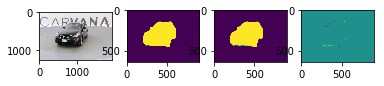

 76%|███████▌  | 775/1018 [35:39<11:17,  2.79s/it]

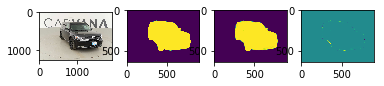

 76%|███████▌  | 776/1018 [35:42<11:13,  2.78s/it]

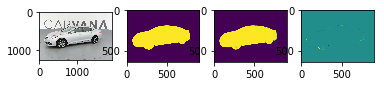

 76%|███████▋  | 777/1018 [35:44<11:04,  2.76s/it]

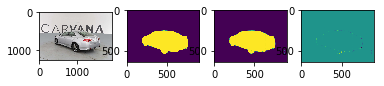

 76%|███████▋  | 778/1018 [35:47<10:59,  2.75s/it]

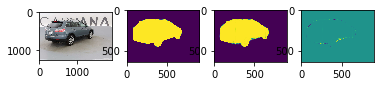

 77%|███████▋  | 779/1018 [35:50<10:56,  2.75s/it]

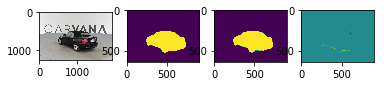

 77%|███████▋  | 780/1018 [35:53<11:02,  2.78s/it]

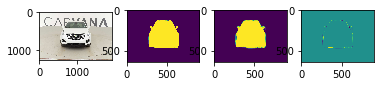

 77%|███████▋  | 781/1018 [35:55<10:54,  2.76s/it]

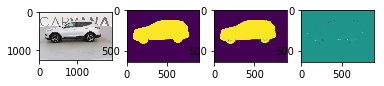

 77%|███████▋  | 782/1018 [35:58<10:48,  2.75s/it]

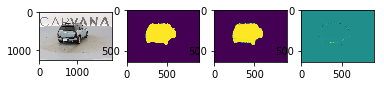

 77%|███████▋  | 783/1018 [36:01<10:46,  2.75s/it]

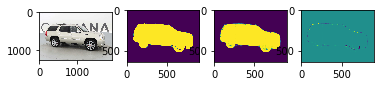

 77%|███████▋  | 784/1018 [36:04<10:52,  2.79s/it]

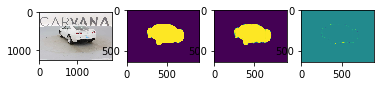

 77%|███████▋  | 785/1018 [36:06<10:50,  2.79s/it]

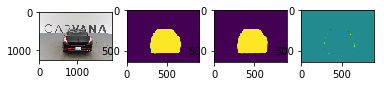

 77%|███████▋  | 786/1018 [36:09<10:43,  2.77s/it]

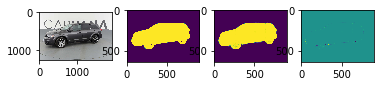

 77%|███████▋  | 787/1018 [36:12<10:34,  2.75s/it]

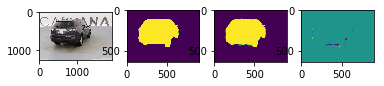

 77%|███████▋  | 788/1018 [36:15<10:36,  2.77s/it]

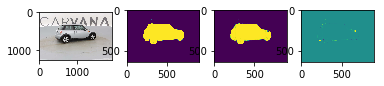

 78%|███████▊  | 789/1018 [36:17<10:33,  2.77s/it]

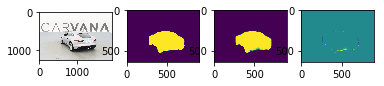

 78%|███████▊  | 790/1018 [36:20<10:29,  2.76s/it]

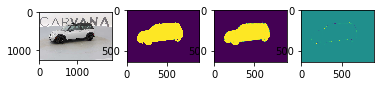

 78%|███████▊  | 791/1018 [36:23<10:22,  2.74s/it]

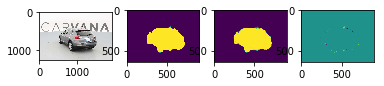

 78%|███████▊  | 792/1018 [36:26<10:19,  2.74s/it]

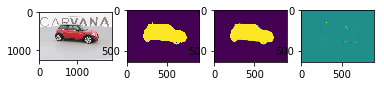

 78%|███████▊  | 793/1018 [36:28<10:22,  2.77s/it]

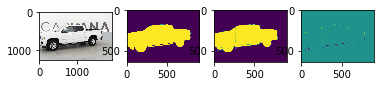

 78%|███████▊  | 794/1018 [36:31<10:18,  2.76s/it]

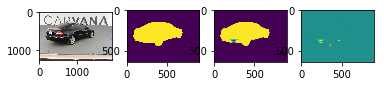

 78%|███████▊  | 795/1018 [36:34<10:16,  2.76s/it]

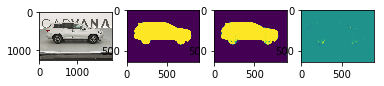

 78%|███████▊  | 796/1018 [36:37<10:14,  2.77s/it]

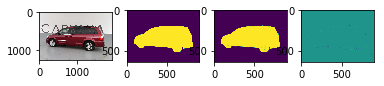

 78%|███████▊  | 797/1018 [36:40<10:14,  2.78s/it]

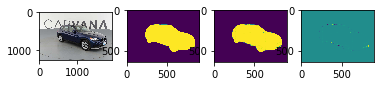

 78%|███████▊  | 798/1018 [36:42<10:07,  2.76s/it]

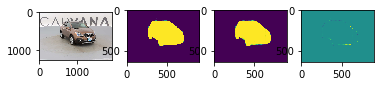

 78%|███████▊  | 799/1018 [36:45<09:59,  2.74s/it]

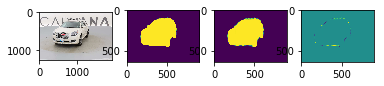

 79%|███████▊  | 800/1018 [36:48<09:54,  2.73s/it]

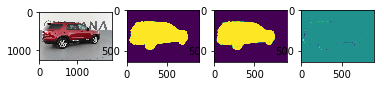

 79%|███████▊  | 801/1018 [36:51<10:03,  2.78s/it]

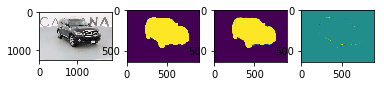

 79%|███████▉  | 802/1018 [36:53<10:01,  2.78s/it]

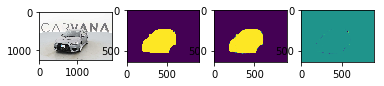

 79%|███████▉  | 803/1018 [36:56<09:54,  2.77s/it]

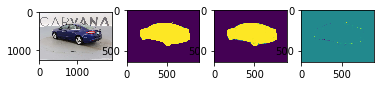

 79%|███████▉  | 804/1018 [36:59<09:53,  2.77s/it]

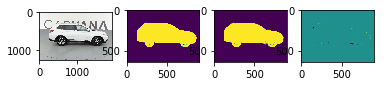

 79%|███████▉  | 805/1018 [37:02<09:51,  2.78s/it]

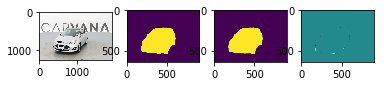

 79%|███████▉  | 806/1018 [37:05<09:57,  2.82s/it]

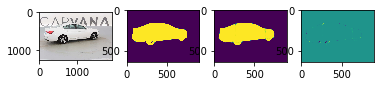

 79%|███████▉  | 807/1018 [37:07<09:53,  2.81s/it]

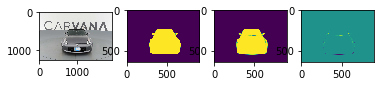

 79%|███████▉  | 808/1018 [37:10<09:42,  2.77s/it]

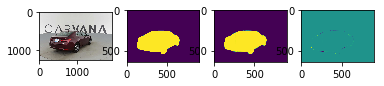

 79%|███████▉  | 809/1018 [37:13<09:33,  2.74s/it]

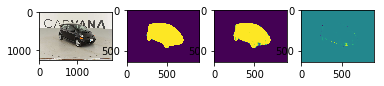

 80%|███████▉  | 810/1018 [37:16<09:42,  2.80s/it]

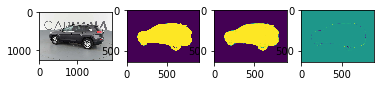

 80%|███████▉  | 811/1018 [37:18<09:33,  2.77s/it]

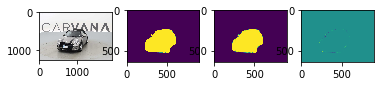

 80%|███████▉  | 812/1018 [37:21<09:31,  2.78s/it]

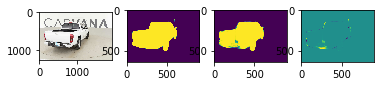

 80%|███████▉  | 813/1018 [37:24<09:26,  2.77s/it]

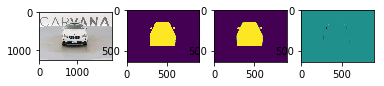

 80%|███████▉  | 814/1018 [37:27<09:32,  2.80s/it]

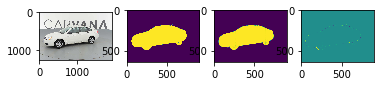

 80%|████████  | 815/1018 [37:30<09:23,  2.78s/it]

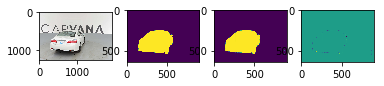

 80%|████████  | 816/1018 [37:32<09:18,  2.76s/it]

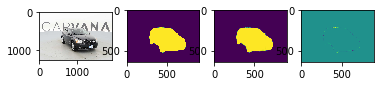

 80%|████████  | 817/1018 [37:35<09:16,  2.77s/it]

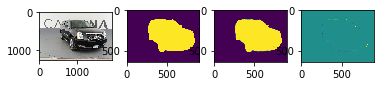

 80%|████████  | 818/1018 [37:38<09:11,  2.76s/it]

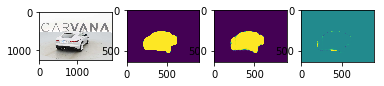

 80%|████████  | 819/1018 [37:41<09:12,  2.78s/it]

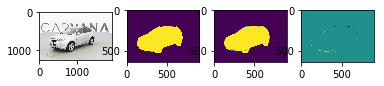

 81%|████████  | 820/1018 [37:43<09:05,  2.75s/it]

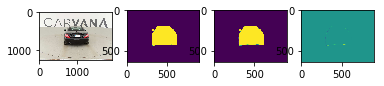

 81%|████████  | 821/1018 [37:46<08:58,  2.73s/it]

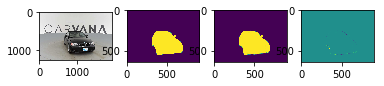

 81%|████████  | 822/1018 [37:49<08:52,  2.71s/it]

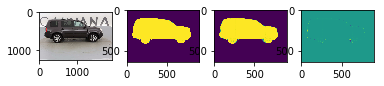

 81%|████████  | 823/1018 [37:52<08:57,  2.76s/it]

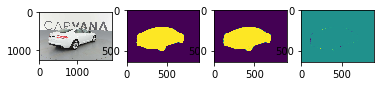

 81%|████████  | 824/1018 [37:54<08:51,  2.74s/it]

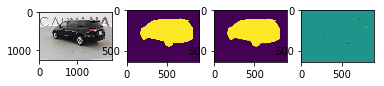

 81%|████████  | 825/1018 [37:57<08:52,  2.76s/it]

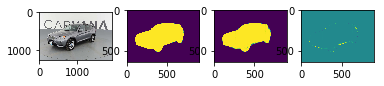

 81%|████████  | 826/1018 [38:00<08:47,  2.75s/it]

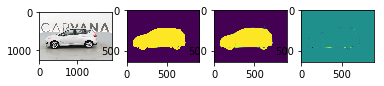

 81%|████████  | 827/1018 [38:03<08:53,  2.79s/it]

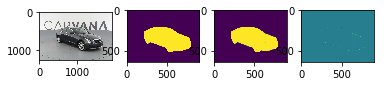

 81%|████████▏ | 828/1018 [38:05<08:45,  2.76s/it]

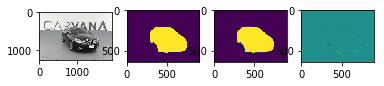

 81%|████████▏ | 829/1018 [38:08<08:38,  2.74s/it]

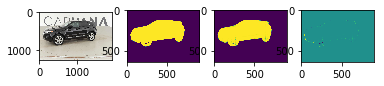

 82%|████████▏ | 830/1018 [38:11<08:32,  2.72s/it]

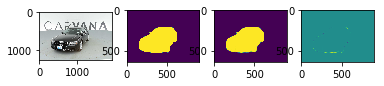

 82%|████████▏ | 831/1018 [38:13<08:30,  2.73s/it]

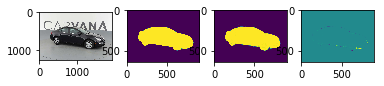

 82%|████████▏ | 832/1018 [38:16<08:32,  2.76s/it]

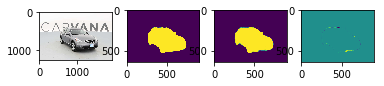

 82%|████████▏ | 833/1018 [38:19<08:26,  2.74s/it]

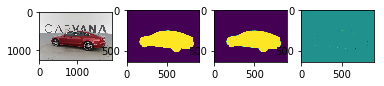

 82%|████████▏ | 834/1018 [38:22<08:20,  2.72s/it]

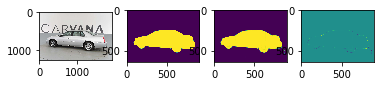

 82%|████████▏ | 835/1018 [38:24<08:16,  2.71s/it]

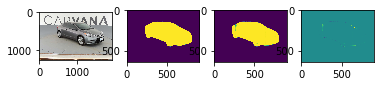

 82%|████████▏ | 836/1018 [38:27<08:19,  2.74s/it]

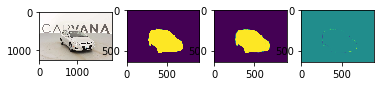

 82%|████████▏ | 837/1018 [38:30<08:14,  2.73s/it]

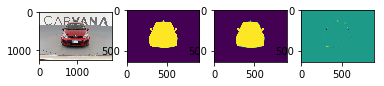

 82%|████████▏ | 838/1018 [38:33<08:10,  2.73s/it]

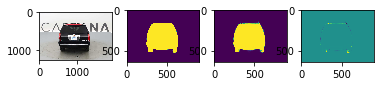

 82%|████████▏ | 839/1018 [38:35<08:04,  2.71s/it]

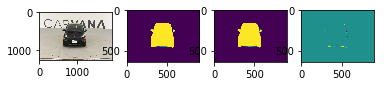

 83%|████████▎ | 840/1018 [38:38<08:09,  2.75s/it]

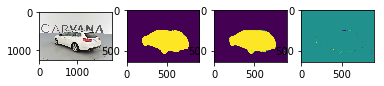

 83%|████████▎ | 841/1018 [38:41<08:05,  2.74s/it]

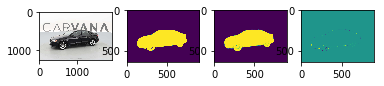

 83%|████████▎ | 842/1018 [38:44<08:03,  2.75s/it]

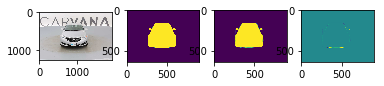

 83%|████████▎ | 843/1018 [38:46<08:01,  2.75s/it]

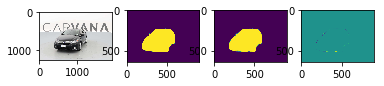

 83%|████████▎ | 844/1018 [38:49<07:55,  2.74s/it]

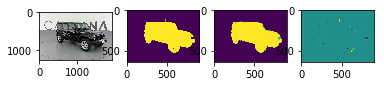

 83%|████████▎ | 845/1018 [38:52<07:59,  2.77s/it]

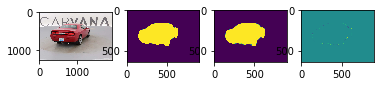

 83%|████████▎ | 846/1018 [38:55<07:53,  2.75s/it]

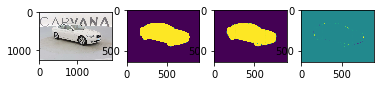

 83%|████████▎ | 847/1018 [38:57<07:51,  2.75s/it]

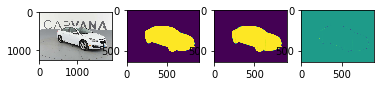

 83%|████████▎ | 848/1018 [39:00<07:44,  2.73s/it]

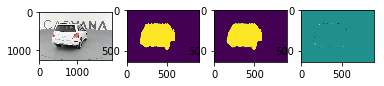

 83%|████████▎ | 849/1018 [39:03<07:44,  2.75s/it]

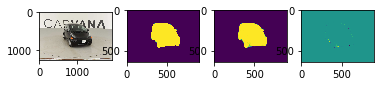

 83%|████████▎ | 850/1018 [39:06<07:42,  2.75s/it]

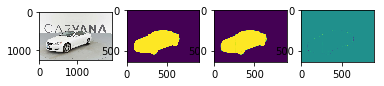

 84%|████████▎ | 851/1018 [39:08<07:37,  2.74s/it]

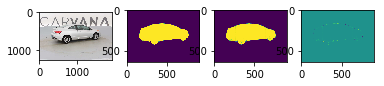

 84%|████████▎ | 852/1018 [39:11<07:31,  2.72s/it]

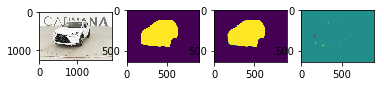

 84%|████████▍ | 853/1018 [39:14<07:36,  2.76s/it]

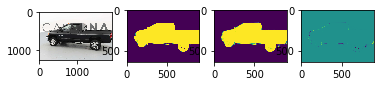

 84%|████████▍ | 854/1018 [39:17<07:33,  2.77s/it]

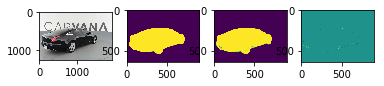

 84%|████████▍ | 855/1018 [39:19<07:30,  2.77s/it]

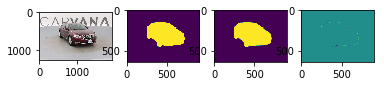

 84%|████████▍ | 856/1018 [39:22<07:24,  2.74s/it]

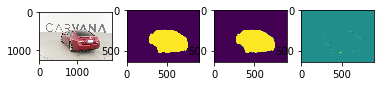

 84%|████████▍ | 857/1018 [39:25<07:17,  2.72s/it]

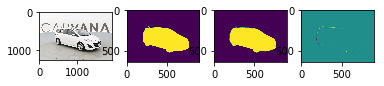

 84%|████████▍ | 858/1018 [39:28<07:19,  2.75s/it]

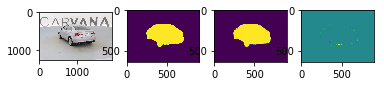

 84%|████████▍ | 859/1018 [39:30<07:15,  2.74s/it]

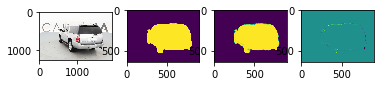

 84%|████████▍ | 860/1018 [39:33<07:10,  2.72s/it]

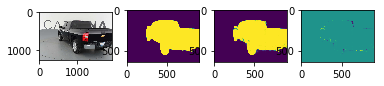

 85%|████████▍ | 861/1018 [39:36<07:09,  2.74s/it]

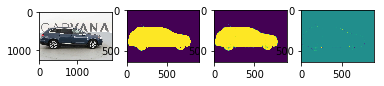

 85%|████████▍ | 862/1018 [39:39<07:10,  2.76s/it]

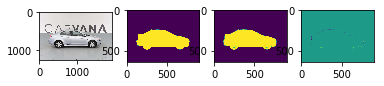

 85%|████████▍ | 863/1018 [39:41<07:06,  2.75s/it]

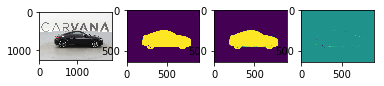

 85%|████████▍ | 864/1018 [39:44<07:02,  2.75s/it]

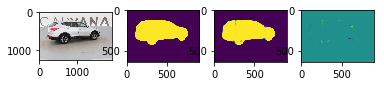

 85%|████████▍ | 865/1018 [39:47<06:58,  2.74s/it]

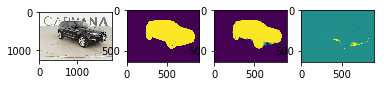

 85%|████████▌ | 866/1018 [39:50<06:59,  2.76s/it]

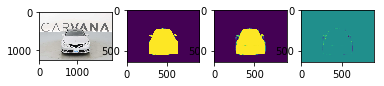

 85%|████████▌ | 867/1018 [39:52<06:55,  2.75s/it]

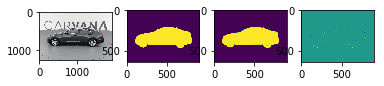

 85%|████████▌ | 868/1018 [39:55<06:49,  2.73s/it]

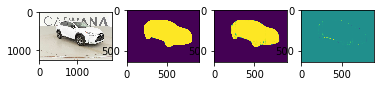

 85%|████████▌ | 869/1018 [39:58<06:47,  2.73s/it]

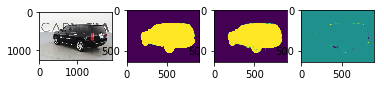

 85%|████████▌ | 870/1018 [40:00<06:45,  2.74s/it]

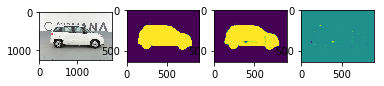

 86%|████████▌ | 871/1018 [40:03<06:50,  2.79s/it]

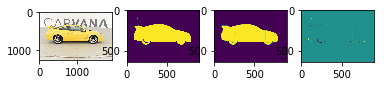

 86%|████████▌ | 872/1018 [40:06<06:47,  2.79s/it]

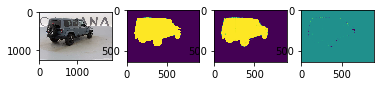

 86%|████████▌ | 873/1018 [40:09<06:45,  2.80s/it]

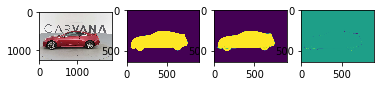

 86%|████████▌ | 874/1018 [40:12<06:40,  2.78s/it]

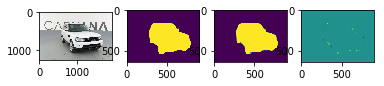

 86%|████████▌ | 875/1018 [40:15<06:41,  2.81s/it]

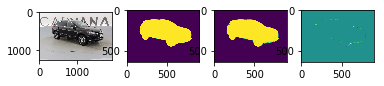

 86%|████████▌ | 876/1018 [40:17<06:36,  2.79s/it]

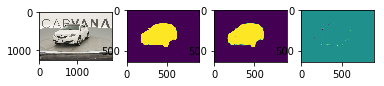

 86%|████████▌ | 877/1018 [40:20<06:29,  2.76s/it]

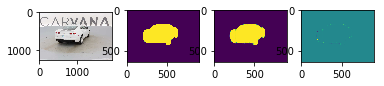

 86%|████████▌ | 878/1018 [40:23<06:24,  2.75s/it]

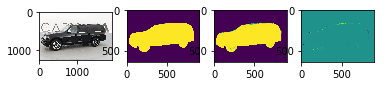

 86%|████████▋ | 879/1018 [40:26<06:25,  2.77s/it]

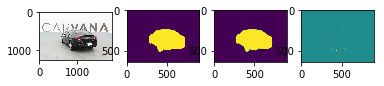

 86%|████████▋ | 880/1018 [40:28<06:20,  2.76s/it]

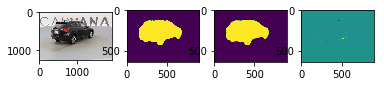

 87%|████████▋ | 881/1018 [40:31<06:16,  2.75s/it]

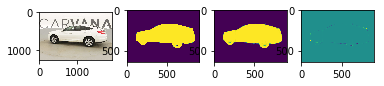

 87%|████████▋ | 882/1018 [40:34<06:15,  2.76s/it]

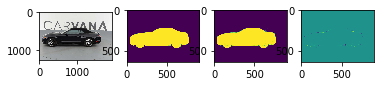

 87%|████████▋ | 883/1018 [40:37<06:11,  2.75s/it]

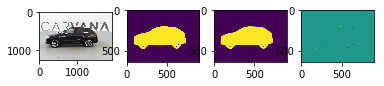

 87%|████████▋ | 884/1018 [40:39<06:14,  2.79s/it]

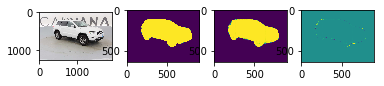

 87%|████████▋ | 885/1018 [40:42<06:07,  2.76s/it]

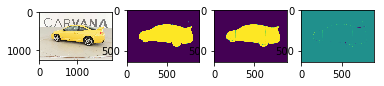

 87%|████████▋ | 886/1018 [40:45<06:01,  2.74s/it]

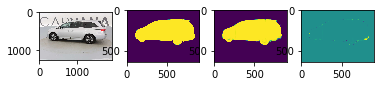

 87%|████████▋ | 887/1018 [40:48<06:00,  2.75s/it]

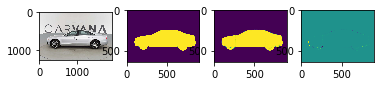

 87%|████████▋ | 888/1018 [40:50<06:01,  2.78s/it]

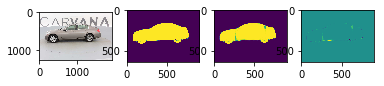

 87%|████████▋ | 889/1018 [40:53<05:58,  2.78s/it]

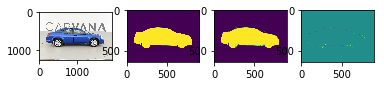

 87%|████████▋ | 890/1018 [40:56<05:54,  2.77s/it]

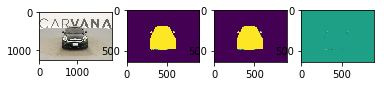

 88%|████████▊ | 891/1018 [40:59<05:52,  2.78s/it]

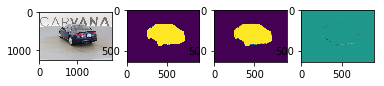

 88%|████████▊ | 892/1018 [41:02<05:53,  2.80s/it]

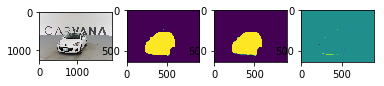

 88%|████████▊ | 893/1018 [41:04<05:47,  2.78s/it]

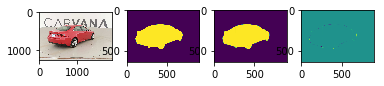

 88%|████████▊ | 894/1018 [41:07<05:43,  2.77s/it]

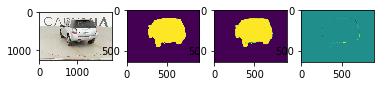

 88%|████████▊ | 895/1018 [41:10<05:37,  2.75s/it]

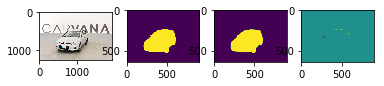

 88%|████████▊ | 896/1018 [41:12<05:35,  2.75s/it]

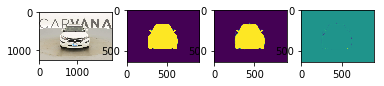

 88%|████████▊ | 897/1018 [41:15<05:35,  2.78s/it]

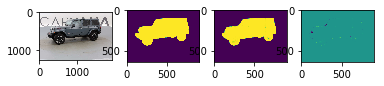

 88%|████████▊ | 898/1018 [41:18<05:32,  2.77s/it]

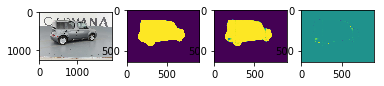

 88%|████████▊ | 899/1018 [41:21<05:31,  2.78s/it]

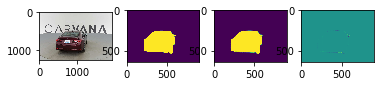

 88%|████████▊ | 900/1018 [41:24<05:24,  2.75s/it]

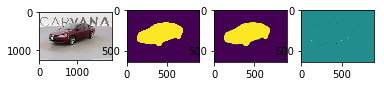

 89%|████████▊ | 901/1018 [41:26<05:23,  2.76s/it]

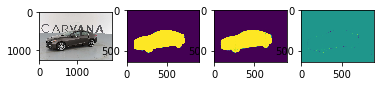

 89%|████████▊ | 902/1018 [41:29<05:20,  2.76s/it]

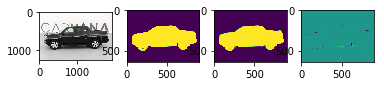

 89%|████████▊ | 903/1018 [41:32<05:15,  2.74s/it]

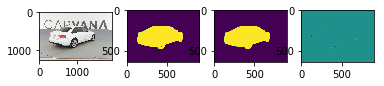

 89%|████████▉ | 904/1018 [41:35<05:12,  2.74s/it]

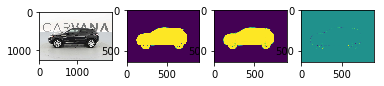

 89%|████████▉ | 905/1018 [41:37<05:12,  2.77s/it]

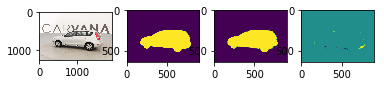

 89%|████████▉ | 906/1018 [41:40<05:08,  2.75s/it]

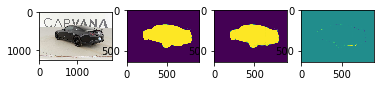

 89%|████████▉ | 907/1018 [41:43<05:05,  2.75s/it]

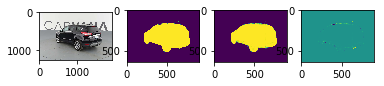

 89%|████████▉ | 908/1018 [41:46<05:04,  2.76s/it]

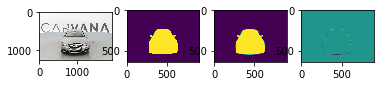

 89%|████████▉ | 909/1018 [41:48<05:02,  2.77s/it]

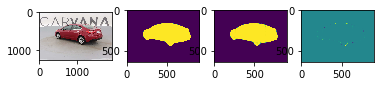

 89%|████████▉ | 910/1018 [41:51<05:01,  2.79s/it]

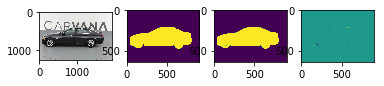

 89%|████████▉ | 911/1018 [41:54<04:56,  2.78s/it]

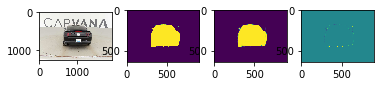

 90%|████████▉ | 912/1018 [41:57<04:54,  2.78s/it]

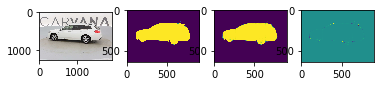

 90%|████████▉ | 913/1018 [42:00<04:51,  2.78s/it]

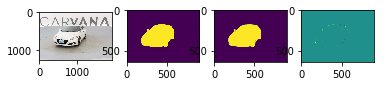

 90%|████████▉ | 914/1018 [42:03<04:53,  2.82s/it]

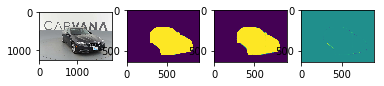

 90%|████████▉ | 915/1018 [42:05<04:50,  2.82s/it]

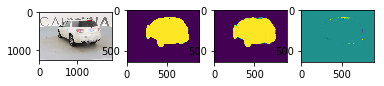

 90%|████████▉ | 916/1018 [42:08<04:44,  2.78s/it]

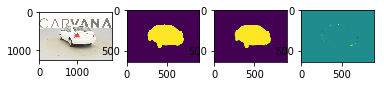

 90%|█████████ | 917/1018 [42:11<04:41,  2.78s/it]

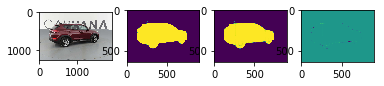

 90%|█████████ | 918/1018 [42:14<04:42,  2.82s/it]

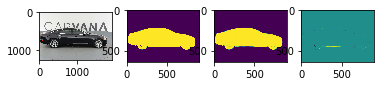

 90%|█████████ | 919/1018 [42:16<04:37,  2.80s/it]

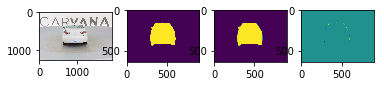

 90%|█████████ | 920/1018 [42:19<04:33,  2.80s/it]

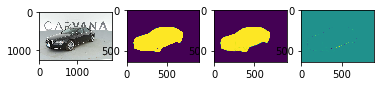

 90%|█████████ | 921/1018 [42:22<04:28,  2.77s/it]

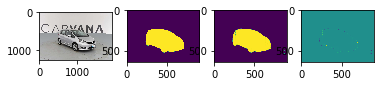

 91%|█████████ | 922/1018 [42:25<04:26,  2.77s/it]

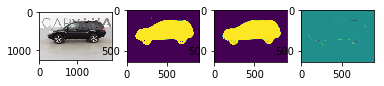

 91%|█████████ | 923/1018 [42:28<04:27,  2.81s/it]

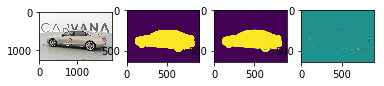

 91%|█████████ | 924/1018 [42:30<04:22,  2.79s/it]

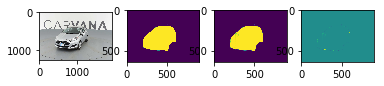

 91%|█████████ | 925/1018 [42:33<04:16,  2.76s/it]

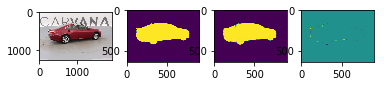

 91%|█████████ | 926/1018 [42:36<04:14,  2.76s/it]

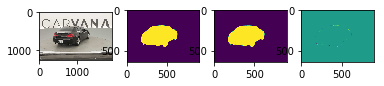

 91%|█████████ | 927/1018 [42:39<04:13,  2.79s/it]

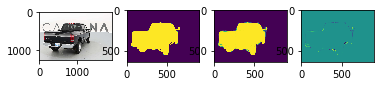

 91%|█████████ | 928/1018 [42:41<04:09,  2.77s/it]

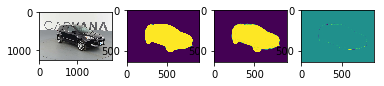

 91%|█████████▏| 929/1018 [42:44<04:05,  2.76s/it]

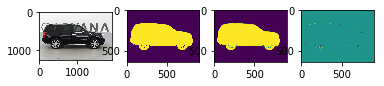

 91%|█████████▏| 930/1018 [42:47<04:03,  2.76s/it]

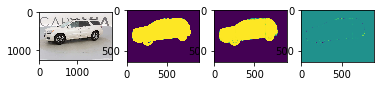

 91%|█████████▏| 931/1018 [42:50<04:04,  2.80s/it]

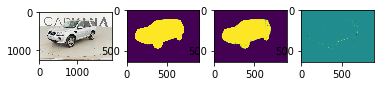

 92%|█████████▏| 932/1018 [42:53<04:01,  2.81s/it]

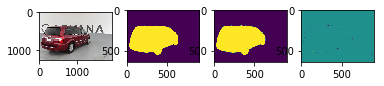

 92%|█████████▏| 933/1018 [42:55<03:56,  2.78s/it]

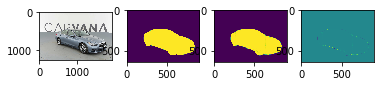

 92%|█████████▏| 934/1018 [42:58<03:52,  2.77s/it]

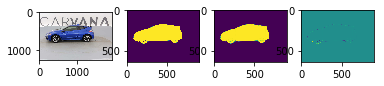

 92%|█████████▏| 935/1018 [43:01<03:49,  2.76s/it]

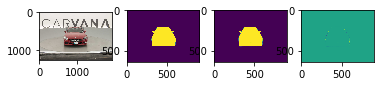

 92%|█████████▏| 936/1018 [43:04<03:49,  2.80s/it]

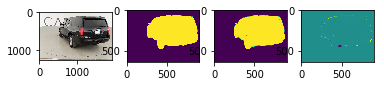

 92%|█████████▏| 937/1018 [43:07<03:46,  2.80s/it]

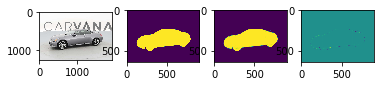

 92%|█████████▏| 938/1018 [43:09<03:40,  2.76s/it]

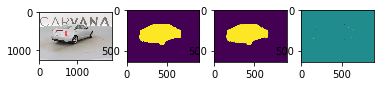

 92%|█████████▏| 939/1018 [43:12<03:38,  2.77s/it]

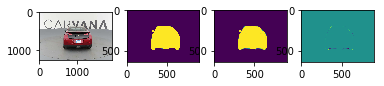

 92%|█████████▏| 940/1018 [43:15<03:37,  2.79s/it]

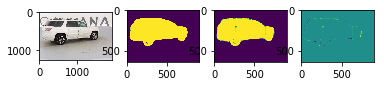

 92%|█████████▏| 941/1018 [43:18<03:32,  2.76s/it]

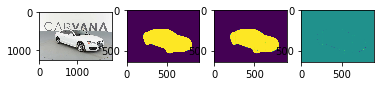

 93%|█████████▎| 942/1018 [43:20<03:30,  2.77s/it]

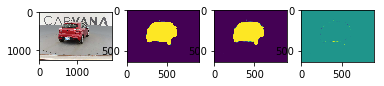

 93%|█████████▎| 943/1018 [43:23<03:25,  2.74s/it]

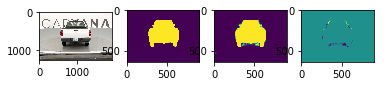

 93%|█████████▎| 944/1018 [43:26<03:26,  2.79s/it]

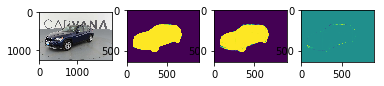

 93%|█████████▎| 945/1018 [43:29<03:21,  2.77s/it]

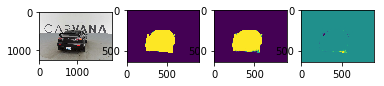

 93%|█████████▎| 946/1018 [43:31<03:18,  2.76s/it]

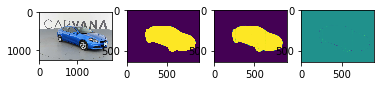

 93%|█████████▎| 947/1018 [43:34<03:14,  2.75s/it]

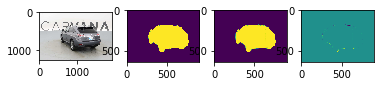

 93%|█████████▎| 948/1018 [43:37<03:12,  2.74s/it]

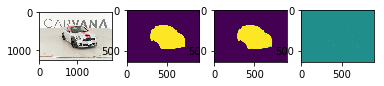

 93%|█████████▎| 949/1018 [43:40<03:12,  2.79s/it]

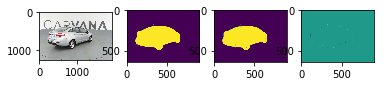

 93%|█████████▎| 950/1018 [43:42<03:09,  2.79s/it]

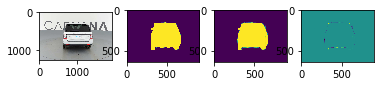

 93%|█████████▎| 951/1018 [43:45<03:05,  2.76s/it]

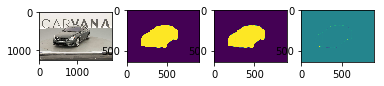

 94%|█████████▎| 952/1018 [43:48<03:02,  2.76s/it]

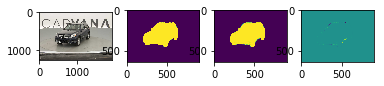

 94%|█████████▎| 953/1018 [43:51<03:01,  2.80s/it]

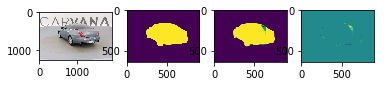

 94%|█████████▎| 954/1018 [43:54<02:57,  2.77s/it]

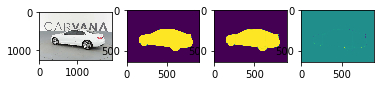

 94%|█████████▍| 955/1018 [43:56<02:54,  2.77s/it]

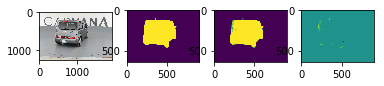

 94%|█████████▍| 956/1018 [43:59<02:50,  2.75s/it]

 94%|█████████▍| 957/1018 [44:02<02:49,  2.79s/it]

 94%|█████████▍| 958/1018 [44:05<02:46,  2.78s/it]

 94%|█████████▍| 959/1018 [44:07<02:43,  2.78s/it]

 94%|█████████▍| 960/1018 [44:10<02:41,  2.78s/it]

 94%|█████████▍| 961/1018 [44:13<02:37,  2.76s/it]

 94%|█████████▍| 962/1018 [44:16<02:36,  2.79s/it]

 95%|█████████▍| 963/1018 [44:19<02:34,  2.81s/it]

 95%|█████████▍| 964/1018 [44:21<02:30,  2.79s/it]

 95%|█████████▍| 965/1018 [44:24<02:25,  2.75s/it]

 95%|█████████▍| 966/1018 [44:27<02:23,  2.76s/it]

 95%|█████████▍| 967/1018 [44:30<02:20,  2.76s/it]

 95%|█████████▌| 968/1018 [44:32<02:17,  2.75s/it]

 95%|█████████▌| 969/1018 [44:35<02:13,  2.72s/it]

 95%|█████████▌| 970/1018 [44:38<02:13,  2.77s/it]

 95%|█████████▌| 971/1018 [44:41<02:09,  2.76s/it]

 95%|█████████▌| 972/1018 [44:43<02:06,  2.75s/it]

 96%|█████████▌| 973/1018 [44:46<02:03,  2.75s/it]

 96%|█████████▌| 974/1018 [44:49<01:59,  2.72s/it]

 96%|█████████▌| 975/1018 [44:52<01:58,  2.75s/it]

 96%|█████████▌| 976/1018 [44:54<01:56,  2.76s/it]

 96%|█████████▌| 977/1018 [44:57<01:53,  2.76s/it]

 96%|█████████▌| 978/1018 [45:00<01:50,  2.76s/it]

 96%|█████████▌| 979/1018 [45:03<01:47,  2.76s/it]

 96%|█████████▋| 980/1018 [45:05<01:45,  2.76s/it]

 96%|█████████▋| 981/1018 [45:08<01:41,  2.74s/it]

 96%|█████████▋| 982/1018 [45:11<01:37,  2.72s/it]

 97%|█████████▋| 983/1018 [45:14<01:36,  2.76s/it]

 97%|█████████▋| 984/1018 [45:16<01:34,  2.77s/it]

 97%|█████████▋| 985/1018 [45:19<01:30,  2.74s/it]

 97%|█████████▋| 986/1018 [45:22<01:28,  2.75s/it]

 97%|█████████▋| 987/1018 [45:25<01:24,  2.74s/it]

 97%|█████████▋| 988/1018 [45:27<01:23,  2.78s/it]

 97%|█████████▋| 989/1018 [45:30<01:19,  2.75s/it]

 97%|█████████▋| 990/1018 [45:33<01:17,  2.76s/it]

 97%|█████████▋| 991/1018 [45:36<01:14,  2.75s/it]

 97%|█████████▋| 992/1018 [45:38<01:11,  2.77s/it]

 98%|█████████▊| 993/1018 [45:41<01:08,  2.73s/it]

 98%|█████████▊| 994/1018 [45:44<01:05,  2.73s/it]

 98%|█████████▊| 995/1018 [45:47<01:03,  2.75s/it]

 98%|█████████▊| 996/1018 [45:49<01:01,  2.79s/it]

 98%|█████████▊| 997/1018 [45:52<00:58,  2.77s/it]

 98%|█████████▊| 998/1018 [45:55<00:54,  2.74s/it]

 98%|█████████▊| 999/1018 [45:58<00:52,  2.75s/it]

 98%|█████████▊| 1000/1018 [46:00<00:49,  2.74s/it]

 98%|█████████▊| 1001/1018 [46:03<00:47,  2.77s/it]

 98%|█████████▊| 1002/1018 [46:06<00:44,  2.76s/it]

 99%|█████████▊| 1003/1018 [46:09<00:41,  2.74s/it]

 99%|█████████▊| 1004/1018 [46:11<00:38,  2.72s/it]

 99%|█████████▊| 1005/1018 [46:14<00:35,  2.77s/it]

 99%|█████████▉| 1006/1018 [46:17<00:33,  2.77s/it]

 99%|█████████▉| 1007/1018 [46:20<00:30,  2.77s/it]

 99%|█████████▉| 1008/1018 [46:22<00:27,  2.74s/it]

 99%|█████████▉| 1009/1018 [46:25<00:25,  2.78s/it]

 99%|█████████▉| 1010/1018 [46:28<00:22,  2.78s/it]

 99%|█████████▉| 1011/1018 [46:31<00:19,  2.76s/it]

 99%|█████████▉| 1012/1018 [46:33<00:16,  2.75s/it]

100%|█████████▉| 1013/1018 [46:36<00:13,  2.76s/it]

100%|█████████▉| 1014/1018 [46:39<00:11,  2.79s/it]

100%|█████████▉| 1015/1018 [46:42<00:08,  2.78s/it]

100%|█████████▉| 1016/1018 [46:45<00:05,  2.75s/it]

100%|█████████▉| 1017/1018 [46:47<00:02,  2.73s/it]

100%|██████████| 1018/1018 [46:50<00:00,  2.78s/it]


In [ ]:
# Calculate the dice coefficient on the validation set. The original image will be predict part by part.
def val_dice_coef2(model, validation_images, data_dir, mask_dir, 
                   pad_width, image_size, input_size, output_size):
    dices = []
    masks_pred = []
    for image in tqdm(validation_images):
        image, mask = read_image_and_mask(data_dir, mask_dir, image)
        mask = imresize(mask, image_size[::-1]) / 255.
        mask_pred = mirror_average_prediction(model, image, 
                                               pad_width, image_size, input_dims, output_dims)
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred[:,:], mask[:,:,0]-mask_pred[:,:])
        dices.append(cal_dice_coef(mask[:,:,0], mask_pred))
    dices = np.array(dices)
    return dices.mean(), mask_pred
mean_dice, mask_pred = val_dice_coef2(model, validation_images, data_dir, mask_dir,
                                      0, image_size, input_dims, output_dims)

In [74]:
mean_dice

0.99117797511751993

In [68]:
def remove_artifacts(mask):
    """
    # Args:
     mask:      2D array
    """
    mask = np.round(mask)
    mask = mask.astype(np.int32)
    label = label_shape(mask, connectivity=2)
    
    (h, w) = mask.shape
    bottom_left = label[h-1,0]
    bottom_right = label[h-1,w-1]
    if bottom_left == bottom_right and bottom_left != 0:
        # Remove bottom blob
        mask[label==bottom_left] = 0
    label[label==bottom_left] = 0
    # Remove other small area
    label_num = label.max()
    areas = [(label == i + 1).sum() for i in range(label_num + 1)]
    areas_max = max(areas)
    # retain the largest blob, remove all other blobs
    for i in range(1, label_num + 1):
        if areas[i-1] != areas_max:
            mask[label==i] = 0
    return mask

ix_ = np.random.randint(0, 1018)
image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_images[ix_])
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

mask_pred_ = predict_on_patch(model, image_, 0, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

mask_processed_ = remove_artifacts(mask_pred_)
plt.figure(figsize=(16, 12))
plt.imshow(mask_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_pred_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_processed_)
plt.show()

In [78]:
validation_image_ = '858841907a4a_02.jpg'

image_, mask_ = read_image_and_mask(data_dir, mask_dir, validation_image_)
show_image_and_mask(image_, mask_)
image_ = imresize(image_, image_size[::-1])
mask_ = imresize(mask_, image_size[::-1])

mask_pred_ = predict_on_patch(model, image_, 0, 'edge',image_size, input_dims, output_dims)
mask_pred_[mask_pred_>0.5] = 1
mask_pred_[mask_pred_<0.5] = 0
show_3_images(mask_, mask_pred_, mask_[:,:,0] / 255. - mask_pred_)

plt.figure(figsize=(16, 12))
plt.imshow(image_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_pred_)
plt.show()
plt.figure(figsize=(16, 12))
plt.imshow(mask_[:,:,0] / 255. - mask_pred_)
plt.show()
# Yellow: indicate fasle negtive, should be mask but fail to detect
# Purper: indicate fasle positve, is not car but labeled as car

In [70]:
# Calculate the dice coefficient on the validation set. The original image will be predict part by part.
# Calculate the dice coefficient on the validation set. The original image will be predict part by part.
def val_dice_coef2(model, validation_images, data_dir, mask_dir, 
                   pad_width, mode, image_size, input_size, output_size):
    dices = []
    masks_pred = []
    for image in tqdm(validation_images):
        image, mask = read_image_and_mask(data_dir, mask_dir, image)
        mask = imresize(mask, image_size[::-1]) / 255.
        mask_pred = mirror_average_prediction(model, image, 
                                               pad_width, image_size, input_dims, output_dims)
        mask_pred = remove_artifacts(mask_pred)
        # Show image, mask, prediction and difference
        show_4_images(image, mask[:,:,0], mask_pred, mask[:,:,0]-mask_pred[:,:])
        dices.append(cal_dice_coef(mask[:,:,0], mask_pred))
    with open(tmp_dir + 'masks_pred-symmetric.pickel', 'wb') as f:
        pickle.dump(masks_pred, f)
    dices = np.array(dices)
    return dices.mean(), mask_pred
mean_dice, mask_pred = val_dice_coef2(model, validation_images, data_dir, mask_dir,
                                      0, 'edge', image_size, input_dims, output_dims)


  0%|          | 0/1018 [00:00<?, ?it/s]


  0%|          | 1/1018 [00:02<47:00,  2.77s/it]

  0%|          | 2/1018 [00:05<46:52,  2.77s/it]

  0%|          | 3/1018 [00:08<46:35,  2.75s/it]

  0%|          | 4/1018 [00:11<46:40,  2.76s/it]

  0%|          | 5/1018 [00:13<46:36,  2.76s/it]

  1%|          | 6/1018 [00:16<46:40,  2.77s/it]

  1%|          | 7/1018 [00:19<46:39,  2.77s/it]

  1%|          | 8/1018 [00:22<46:26,  2.76s/it]

  1%|          | 9/1018 [00:24<46:39,  2.77s/it]

  1%|          | 10/1018 [00:27<46:13,  2.75s/it]

  1%|          | 11/1018 [00:30<46:16,  2.76s/it]

  1%|          | 12/1018 [00:33<46:00,  2.74s/it]

  1%|▏         | 13/1018 [00:35<46:40,  2.79s/it]

  1%|▏         | 14/1018 [00:38<46:22,  2.77s/it]

  1%|▏         | 15/1018 [00:41<46:23,  2.77s/it]

  2%|▏         | 16/1018 [00:44<46:10,  2.76s/it]

KeyboardInterrupt: 

In [77]:
val_batch_size = 32
for i in range(5):
    idx = random.sample(range(1018), 32)
    print (model.evaluate(val_images[idx], val_masks[idx], batch_size=4))

32/32 [==============================] - 44s    
[0.0096099799848161638, 0.99210716038942337]
32/32 [==============================] - 32s    
[0.0086611862061545253, 0.99208315461874008]
32/32 [==============================] - 32s    
[0.0086834862595424056, 0.99218709021806717]
32/32 [==============================] - 32s    
[0.0087706092745065689, 0.9921201691031456]
32/32 [==============================] - 32s    
[0.010245724464766681, 0.99241621792316437]


In [78]:
val_batch_size = 128
for i in range(5):
    idx = random.sample(range(1018), val_batch_size)
    print (model.evaluate(val_images[idx], val_masks[idx], batch_size=4))

128/128 [==============================] - 147s   
[0.0091556776314973831, 0.9917932003736496]
128/128 [==============================] - 153s   
[0.0090488984278636053, 0.99217040836811066]
128/128 [==============================] - 148s   
[0.0089989591797348112, 0.99243416078388691]
128/128 [==============================] - 152s   
[0.0085197681473800912, 0.99259385466575623]
128/128 [==============================] - 138s   
[0.0094432907935697585, 0.99163399077951908]
